In [1]:
import tensorflow as tf
tf.config.threading.set_intra_op_parallelism_threads(6)
tf.config.threading.set_inter_op_parallelism_threads(6)

2025-07-27 22:15:33.475126: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
/Users/andrewplattel/opt/anaconda3/lib/python3.9/site-packages/scipy/__init__.py:155: UserWarning: A NumPy version >=1.18.5 and <1.25.0 is required for this version of SciPy (detected version 1.26.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
print("Intra-op:", tf.config.threading.get_intra_op_parallelism_threads())
print("Inter-op:", tf.config.threading.get_inter_op_parallelism_threads())

Intra-op: 6
Inter-op: 6


In [164]:
%matplotlib inline
from tensorflow import keras
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.metrics import BinaryAccuracy
from sklearn.model_selection import train_test_split
from tensorflow.keras import datasets, layers, models
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import LSTM, Dense, Input, Lambda
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats
import pandas as pd
import time

In [4]:
rawdata = pd.read_csv('hall.csv')
data = rawdata
data.head()

,id,time,gl,Age,BMI,A1C,FBG,ogtt.2hr,insulin,hs.CRP,...,freq_low,freq_moderate,freq_severe,glucotype,Height,Weight,Insulin_rate_dd,perc_cgm_prediabetic_range,perc_cgm_diabetic_range,SSPG
0,1636-69-001,2014-02-03 03:42:12,93.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0
1,1636-69-001,2014-02-03 03:47:12,93.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0
2,1636-69-001,2014-02-03 03:52:12,93.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0
3,1636-69-001,2014-02-03 03:57:12,95.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0
4,1636-69-001,2014-02-03 04:02:12,96.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0


In [5]:
# Convert 'time' to datetime and set it as index
data['time'] = pd.to_datetime(data['time'])
data.set_index('time', inplace=True)
data.head()

,id,gl,Age,BMI,A1C,FBG,ogtt.2hr,insulin,hs.CRP,Tchol,...,freq_low,freq_moderate,freq_severe,glucotype,Height,Weight,Insulin_rate_dd,perc_cgm_prediabetic_range,perc_cgm_diabetic_range,SSPG
time,,,,,,,,,,,,,,,,,,,,,
2014-02-03 03:42:12,1636-69-001,93.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,204.0,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0
2014-02-03 03:47:12,1636-69-001,93.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,204.0,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0
2014-02-03 03:52:12,1636-69-001,93.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,204.0,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0
2014-02-03 03:57:12,1636-69-001,95.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,204.0,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0
2014-02-03 04:02:12,1636-69-001,96.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,204.0,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0


In [6]:
data = data.sort_index() #ensure we order by time
data.head()

,id,gl,Age,BMI,A1C,FBG,ogtt.2hr,insulin,hs.CRP,Tchol,...,freq_low,freq_moderate,freq_severe,glucotype,Height,Weight,Insulin_rate_dd,perc_cgm_prediabetic_range,perc_cgm_diabetic_range,SSPG
time,,,,,,,,,,,,,,,,,,,,,
2014-02-03 03:42:12,1636-69-001,93.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,204.0,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0
2014-02-03 03:47:12,1636-69-001,93.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,204.0,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0
2014-02-03 03:52:12,1636-69-001,93.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,204.0,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0
2014-02-03 03:57:12,1636-69-001,95.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,204.0,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0
2014-02-03 04:02:12,1636-69-001,96.0,59.0,21.7,6.7,109.0,205.0,9.0,0.3,204.0,...,0.147059,0.369748,0.483193,2,176.3,68.0,0.1015,0.190404,0.026211,91.0


In [7]:
#extract the blood glucose variable to train a model on
data_var = data['gl']
data_var.info

# # Normalize the data
scaler = MinMaxScaler(feature_range=(0, 1))
data_var_clean = data_var.dropna()  # Remove NaN values
data_normalized = scaler.fit_transform(data_var_clean.values.reshape(-1, 1))
data_normalized = pd.Series(data_normalized.flatten())
data_normalized

0         0.201521
1         0.201521
2         0.201521
3         0.209125
4         0.212928
            ...   
105412    0.114068
105413    0.091255
105414    0.079848
105415    0.083650
105416    0.098859
Length: 105417, dtype: float64

## Testing the order of operations on how to build the model before scalling

In [8]:
# Create sequences
def create_sequences(data, seq_length):
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data[i:(i + seq_length)].values)
        y.append(data[i + seq_length])
    return np.array(X), np.array(y)

# Set sequence length (e.g., use x time entries to predict the next)
seq_length = 70

X, y = create_sequences(data_normalized, seq_length)

# Reshape X to be [samples, time steps, features]
X = np.reshape(X, (X.shape[0], X.shape[1], 1))

# Split the data into training and testing sets
train_size = int(len(X) * 0.8)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]

In [9]:
# Build the RNN model
def create_model(seq_length_in, seq_length_out):
    inputs = Input(shape=(seq_length_in, 1))
    x = LSTM(50, activation='relu', return_sequences=True)(inputs)
    x = LSTM(50, activation='relu')(x)
    outputs = Dense(seq_length_out)(x)
    model = Model(inputs=inputs, outputs=outputs)
    model.compile(optimizer='adam', loss='mse')
    return model

In [10]:
# Create and compile the model
seq_length_out = 1
model = create_model(seq_length, seq_length_out)

In [11]:
start_time = time.time()
# Train the model (takes time)
history = model.fit(X_train, y_train, epochs=5, batch_size=320, validation_split=0.2, verbose=0)

end_time = time.time()
elapsed_time = end_time - start_time

print(f"Execution time: {elapsed_time} seconds")

Execution time: 186.02215194702148 seconds


In [12]:
start_time = time.time()
# Make predictions
train_predict = model.predict(X_train)
test_predict = model.predict(X_test)
end_time = time.time()
elapsed_time1 = end_time - start_time
print(f"Execution time: {elapsed_time1} seconds")

start_time = time.time()
# Invert predictions to original scale
train_predict = scaler.inverse_transform(train_predict)
y_train_inv = scaler.inverse_transform(y_train.reshape(-1, 1))
test_predict = scaler.inverse_transform(test_predict)
y_test_inv = scaler.inverse_transform(y_test.reshape(-1, 1))
end_time = time.time()
elapsed_time2 = end_time - start_time
print(f"Execution time: {elapsed_time2} seconds")

2634/2634 ━━━━━━━━━━━━━━━━━━━━ 23s 8ms/step
659/659 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step
Execution time: 29.487671852111816 seconds
Execution time: 0.00886392593383789 seconds


In [13]:
start_time = time.time()
# Calculate RMSE
train_rmse = np.sqrt(np.mean((train_predict - y_train_inv)**2))
test_rmse = np.sqrt(np.mean((test_predict - y_test_inv)**2))
end_time = time.time()
elapsed_time3 = end_time - start_time
print(f"Execution time: {elapsed_time3} seconds")

print(f"Train RMSE: {train_rmse} mg/DL")
print(f"Test RMSE: {test_rmse} mg/DL")

Execution time: 0.00877690315246582 seconds
Train RMSE: 14.491917918641693 mg/DL
Test RMSE: 13.411277322809406 mg/DL


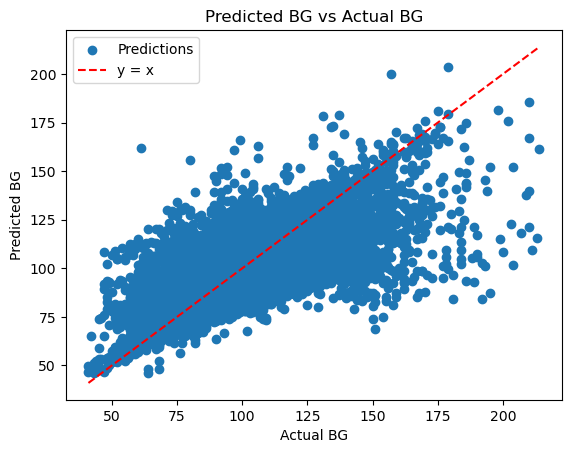

In [14]:
plt.scatter(y_test_inv, test_predict, label='Predictions')
plt.plot([min(y_test_inv), max(y_test_inv)], [min(y_test_inv), max(y_test_inv)], color='red', linestyle='--', label='y = x')
plt.xlabel('Actual BG')
plt.ylabel('Predicted BG')
plt.legend()
plt.title('Predicted BG vs Actual BG')
plt.show()

## Time to scale the model for more intense use

In [15]:
ids = data.id.unique().tolist()
ids[0:5]

['1636-69-001', '1636-69-064', '1636-69-028', '1636-69-053', '1636-69-069']

In [16]:
grouped_data = {f'id_{i}_data': group for i, (id_, group) in enumerate(data.groupby('id'))}

In [177]:
print(ids[26])
grouped_data['id_26_data'] #the associated data to the person that id index

2133-004


,id,gl,Age,BMI,A1C,FBG,ogtt.2hr,insulin,hs.CRP,Tchol,...,freq_low,freq_moderate,freq_severe,glucotype,Height,Weight,Insulin_rate_dd,perc_cgm_prediabetic_range,perc_cgm_diabetic_range,SSPG
time,,,,,,,,,,,,,,,,,,,,,
2016-09-21 00:04:11,2133-004,142.0,54.0,28.09,6.0,145.0,-1.0,11.0,1.6,148.0,...,0.058824,0.117647,0.823529,2,-1.0,-1.0,-1.0,0.155905,0.017363,173.0
2016-09-21 00:09:11,2133-004,142.0,54.0,28.09,6.0,145.0,-1.0,11.0,1.6,148.0,...,0.058824,0.117647,0.823529,2,-1.0,-1.0,-1.0,0.155905,0.017363,173.0
2016-09-21 00:14:11,2133-004,137.0,54.0,28.09,6.0,145.0,-1.0,11.0,1.6,148.0,...,0.058824,0.117647,0.823529,2,-1.0,-1.0,-1.0,0.155905,0.017363,173.0
2016-09-21 00:19:11,2133-004,135.0,54.0,28.09,6.0,145.0,-1.0,11.0,1.6,148.0,...,0.058824,0.117647,0.823529,2,-1.0,-1.0,-1.0,0.155905,0.017363,173.0
2016-09-21 00:24:12,2133-004,132.0,54.0,28.09,6.0,145.0,-1.0,11.0,1.6,148.0,...,0.058824,0.117647,0.823529,2,-1.0,-1.0,-1.0,0.155905,0.017363,173.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-09-27 04:13:39,2133-004,117.0,54.0,28.09,6.0,145.0,-1.0,11.0,1.6,148.0,...,0.058824,0.117647,0.823529,2,-1.0,-1.0,-1.0,0.155905,0.017363,173.0
2016-09-27 04:18:39,2133-004,117.0,54.0,28.09,6.0,145.0,-1.0,11.0,1.6,148.0,...,0.058824,0.117647,0.823529,2,-1.0,-1.0,-1.0,0.155905,0.017363,173.0
2016-09-27 04:23:39,2133-004,116.0,54.0,28.09,6.0,145.0,-1.0,11.0,1.6,148.0,...,0.058824,0.117647,0.823529,2,-1.0,-1.0,-1.0,0.155905,0.017363,173.0


In [18]:
#Creating normalized data from the dictionary

normalized_data = {}

for key, group in grouped_data.items():
    data_var = group['gl']
    data_var_clean = data_var.dropna()

    if len(data_var_clean) > 0:
        scaler = MinMaxScaler(feature_range=(0, 1))
        data_normalized = scaler.fit_transform(data_var_clean.values.reshape(-1, 1))
        normalized_data[key] = pd.Series(data_normalized.flatten(), index=data_var_clean.index)
    else:
        normalized_data[key] = pd.Series([], dtype='float64')
        

In [19]:
normalized_data['id_0_data']

time
2014-02-03 03:42:12    0.155914
2014-02-03 03:47:12    0.155914
2014-02-03 03:52:12    0.155914
2014-02-03 03:57:12    0.166667
2014-02-03 04:02:12    0.172043
                         ...   
2015-04-02 14:48:06    0.274194
2015-04-02 14:53:06    0.268817
2015-04-02 14:58:06    0.284946
2015-04-02 15:03:06    0.306452
2015-04-02 15:08:06    0.295699
Length: 1846, dtype: float64

In [20]:
seq_length_in = 70 # number of datapoints to use to predict the output, in this case 70 (or 350 minutes)
seq_length_out = 1 # number of datapoints to predict per iteration, this case just the next 5 minute interval
data_subset = normalized_data['id_0_data']

model_0 = create_model(seq_length, seq_length_out)

In [21]:


X, y = create_sequences(data_subset, seq_length_in)

# Reshape X to be [samples, time steps, features]
X = np.reshape(X, (X.shape[0], X.shape[1], 1))

# Split the data into training and testing sets
train_size = int(len(X) * 0.8)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]

In [22]:
start_time = time.time()
# Train the model
history = model_0.fit(X_train, y_train, epochs=5, batch_size = (int(len(data_subset)/100)), validation_split=0.2, verbose=0) #batch size is the number of datapoints for the individual divided by 100, 
                                                                                                                            # rounded to the nearest integer

end_time = time.time()
elapsed_time = end_time - start_time

print(f"Execution time: {elapsed_time} seconds")

Execution time: 10.707152128219604 seconds


In [23]:
start_time = time.time()
# Make predictions
train_predict = model_0.predict(X_train)
test_predict = model_0.predict(X_test)
end_time = time.time()
elapsed_time1 = end_time - start_time
print(f"Execution time: {elapsed_time1} seconds")

start_time = time.time()
# Invert predictions to original scale
train_predict = scaler.inverse_transform(train_predict)
y_train_inv = scaler.inverse_transform(y_train.reshape(-1, 1))
test_predict = scaler.inverse_transform(test_predict)
y_test_inv = scaler.inverse_transform(y_test.reshape(-1, 1))
end_time = time.time()
elapsed_time2 = end_time - start_time
print(f"Execution time: {elapsed_time2} seconds")

45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.9860191345214844 seconds
Execution time: 0.0007960796356201172 seconds


In [24]:
start_time = time.time()
# Calculate RMSE
train_rmse = np.sqrt(np.mean((train_predict - y_train_inv)**2))
test_rmse = np.sqrt(np.mean((test_predict - y_test_inv)**2))
end_time = time.time()
elapsed_time3 = end_time - start_time
print(f"Execution time: {elapsed_time3} seconds")

print(f"Train RMSE: {train_rmse} mg/DL")
print(f"Test RMSE: {test_rmse} mg/DL")

Execution time: 0.0003910064697265625 seconds
Train RMSE: 8.434181792616451 mg/DL
Test RMSE: 6.895865944761983 mg/DL


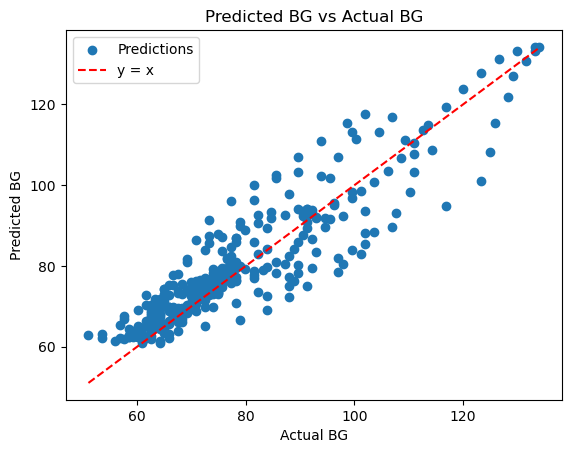

In [25]:
plt.scatter(y_test_inv, test_predict, label='Predictions')
plt.plot([min(y_test_inv), max(y_test_inv)], [min(y_test_inv), max(y_test_inv)], color='red', linestyle='--', label='y = x')
plt.xlabel('Actual BG')
plt.ylabel('Predicted BG')
plt.legend()
plt.title('Predicted BG vs Actual BG')
plt.show()

In [26]:
def create_sequences(data, seq_length_in, seq_length_out):
    X, y = [], []
    for i in range(len(data) - seq_length_in - seq_length_out + 1):
        X.append(data[i:(i + seq_length_in)].values)
        y.append(data[(i + seq_length_in):(i + seq_length_in + seq_length_out)].values)
    return np.array(X), np.array(y)


## Create a function so it's easier to run multiple iterations

In [27]:
# Attempt at making a function that does this all given the subset, seq_in and seq_out

def RNN_indv(data_subset, seq_length_in, seq_length_out):
    """ 
    A model that takes in:\
        data_subset, the data partaining to one id (person from study), 
        seq_length_in,  the number of datapoints to use to predict the output
        seq_length_out, the number of datapoints to predict per iteration (datapoints are 5 min intervals)
        
    Then splits the data into training/testing sets, trains the model, makes predictions based on the seq_length_out,
    calcualtes the RMSE (in the original units), and creates a plot to visualize the accuracy.
    
    """

    model = create_model(seq_length_in, seq_length_out)
    
    #############
    
    X, y = create_sequences(data_subset, seq_length_in, seq_length_out)

    # Reshape X to be [samples, time steps, features]
    X = np.reshape(X, (X.shape[0], X.shape[1], 1))

    # Flatten y to shape (samples, seq_length_out)
    y = y.reshape((y.shape[0], y.shape[1]))


    # Split the data into training and testing sets
    train_size = int(len(X) * 0.8)
    X_train, X_test = X[:train_size], X[train_size:]
    y_train, y_test = y[:train_size], y[train_size:]

    #############
    
    start_time = time.time()
    # Train the model
    history = model.fit(X_train, y_train, epochs=35, batch_size = (int(len(data_subset)/100)), 
                          validation_split=0.2, verbose=0) 
    # batch size is the number of datapoints for the individual divided by 10, rounded to the nearest integer

    end_time = time.time()
    elapsed_time = end_time - start_time

    print(f"Execution time: {elapsed_time} seconds")

    #############
    
    start_time = time.time()
    # Make predictions
    train_predict = model.predict(X_train)
    test_predict = model.predict(X_test)
    end_time = time.time()
    elapsed_time1 = end_time - start_time
    print(f"Execution time: {elapsed_time1} seconds")

    start_time = time.time()
    # Invert predictions to original scale
    train_predict = scaler.inverse_transform(train_predict)
    y_train_inv = scaler.inverse_transform(y_train)
    test_predict = scaler.inverse_transform(test_predict)
    y_test_inv = scaler.inverse_transform(y_test)
    end_time = time.time()
    elapsed_time2 = end_time - start_time
    print(f"Execution time: {elapsed_time2} seconds")

    #############

    start_time = time.time()
    # Calculate RMSE
    train_rmse = np.sqrt(np.mean((train_predict - y_train_inv)**2))
    test_rmse = np.sqrt(np.mean((test_predict - y_test_inv)**2))
    end_time = time.time()
    elapsed_time3 = end_time - start_time
    print(f"Execution time: {elapsed_time3} seconds")
    print("\n")
    print(f"Overall Train RMSE: {train_rmse} mg/DL")
    print(f"Overall Test RMSE: {test_rmse} mg/DL")
    print("\n")
    # Calculate RMSE for each individual forecast timestep
    per_timestep_test_rmse = np.sqrt(np.mean((test_predict - y_test_inv)**2, axis=0))
    per_timestep_train_rmse = np.sqrt(np.mean((train_predict - y_train_inv)**2, axis=0))
   
    # Print the per-timestep train RMSEs
    for i, rmse in enumerate(per_timestep_train_rmse):
        print(f"Train RMSE at t+{i+1}: {rmse:.2f} mg/DL")
    
    print("\n")    
    # Print the per-timestep test RMSEs
    for i, rmse in enumerate(per_timestep_test_rmse):
        print(f"Test RMSE at t+{i+1}: {rmse:.2f} mg/DL")

    #############
    
    # Flatten the predictions and actual values
    y_flat = y_test_inv.flatten()
    pred_flat = test_predict.flatten()

    # Create color labels based on output index
    n_outputs = seq_length_out
    n_sequences = y_test_inv.shape[0]

    # This will repeat [0, 1, ..., n_outputs-1] for each sequence
    color_labels = np.tile(np.arange(n_outputs), n_sequences)

    # Create a colormap
    cmap = plt.get_cmap('viridis', n_outputs)

    # Plot with color mapping
    scatter = plt.scatter(y_flat, pred_flat, c=color_labels, cmap=cmap)
    plt.plot([np.min(y_flat), np.max(y_flat)], [np.min(y_flat), np.max(y_flat)],
             color='red', linestyle='--', label='y = x')

    # Add colorbar with labels
    cbar = plt.colorbar(scatter, ticks=np.arange(n_outputs))
    cbar.set_label('Output Timestep')
    cbar.set_ticklabels([f't+{i+1}' for i in range(n_outputs)])

    plt.xlabel('Actual BG')
    plt.ylabel('Predicted BG')
    plt.title('Predicted BG vs Actual BG (Colored by Forecast Horizon)')
    plt.legend()
    plt.show()
    
    return test_predict, y_test_inv

Execution time: 14.721097946166992 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6433248519897461 seconds
Execution time: 0.0005776882171630859 seconds
Execution time: 0.00016307830810546875 seconds


Overall Train RMSE: 9.697396266139112 mg/DL
Overall Test RMSE: 14.244852198045646 mg/DL


Train RMSE at t+1: 4.82 mg/DL
Train RMSE at t+2: 6.74 mg/DL
Train RMSE at t+3: 8.58 mg/DL
Train RMSE at t+4: 10.57 mg/DL
Train RMSE at t+5: 11.85 mg/DL
Train RMSE at t+6: 13.02 mg/DL


Test RMSE at t+1: 5.25 mg/DL
Test RMSE at t+2: 8.18 mg/DL
Test RMSE at t+3: 11.47 mg/DL
Test RMSE at t+4: 14.81 mg/DL
Test RMSE at t+5: 17.75 mg/DL
Test RMSE at t+6: 21.38 mg/DL


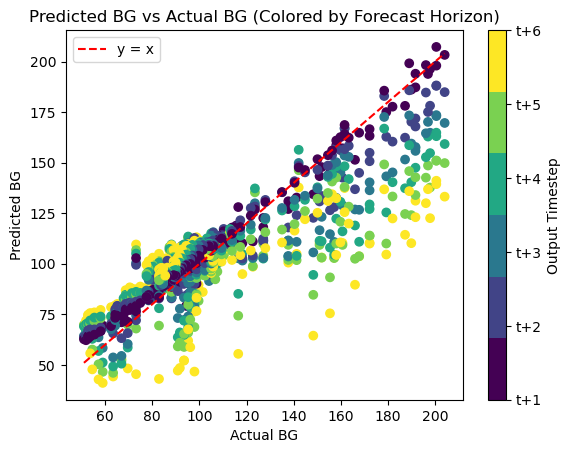

(array([[114.25487 , 113.75629 , 112.63672 , 112.30811 , 109.97957 ,
         110.85521 ],
        [114.224396, 113.70724 , 112.53086 , 112.204185, 109.959694,
         110.83667 ],
        [115.242836, 114.76751 , 113.51902 , 113.10954 , 110.94312 ,
         111.684425],
        ...,
        [ 90.79295 ,  91.12169 ,  91.876015,  93.95044 ,  93.41583 ,
          95.55196 ],
        [ 88.90803 ,  89.130455,  89.84357 ,  92.19615 ,  91.65675 ,
          94.02229 ],
        [ 89.110825,  89.376175,  89.952644,  92.33615 ,  91.8114  ,
          94.083496]], dtype=float32),
 array([[112.02312139, 112.90751445, 113.79190751, 113.79190751,
         113.79190751, 114.67630058],
        [112.90751445, 113.79190751, 113.79190751, 113.79190751,
         114.67630058, 115.56069364],
        [113.79190751, 113.79190751, 113.79190751, 114.67630058,
         115.56069364, 115.56069364],
        ...,
        [ 84.60693642,  84.60693642,  84.60693642,  83.72254335,
          84.60693642,  83.72254335],

In [28]:
seq_length_in = 12 
seq_length_out = 6 
data_subset = normalized_data['id_20_data']

RNN_indv(data_subset, seq_length_in, seq_length_out)


Running model for: id_0_data
Execution time: 58.564422845840454 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8954308032989502 seconds
Execution time: 0.0005500316619873047 seconds
Execution time: 0.0001220703125 seconds


Overall Train RMSE: 9.900586240885847 mg/DL
Overall Test RMSE: 7.094973716375761 mg/DL


Train RMSE at t+1: 4.33 mg/DL
Train RMSE at t+2: 6.38 mg/DL
Train RMSE at t+3: 8.48 mg/DL
Train RMSE at t+4: 9.91 mg/DL
Train RMSE at t+5: 12.46 mg/DL
Train RMSE at t+6: 14.26 mg/DL


Test RMSE at t+1: 3.12 mg/DL
Test RMSE at t+2: 4.47 mg/DL
Test RMSE at t+3: 6.16 mg/DL
Test RMSE at t+4: 7.16 mg/DL
Test RMSE at t+5: 8.85 mg/DL
Test RMSE at t+6: 10.23 mg/DL


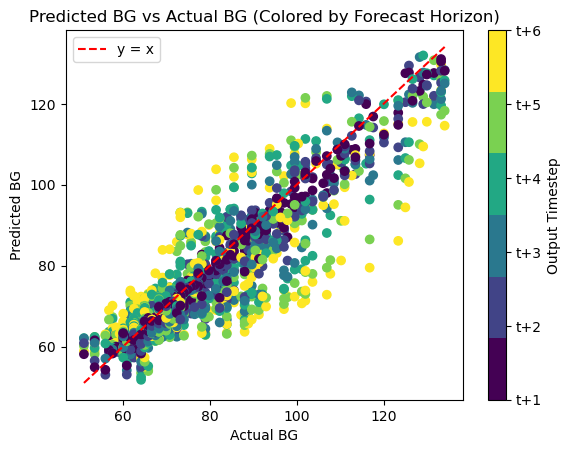


Running model for: id_1_data
Execution time: 56.83130979537964 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 51ms/step
Execution time: 1.1245758533477783 seconds
Execution time: 0.0006070137023925781 seconds
Execution time: 0.00011086463928222656 seconds


Overall Train RMSE: 12.763975172483198 mg/DL
Overall Test RMSE: 18.826685515109748 mg/DL


Train RMSE at t+1: 5.13 mg/DL
Train RMSE at t+2: 7.88 mg/DL
Train RMSE at t+3: 10.68 mg/DL
Train RMSE at t+4: 13.66 mg/DL
Train RMSE at t+5: 16.14 mg/DL
Train RMSE at t+6: 18.11 mg/DL


Test RMSE at t+1: 11.18 mg/DL
Test RMSE at t+2: 14.98 mg/DL
Test RMSE at t+3: 18.17 mg/DL
Test RMSE at t+4: 20.69 mg/DL
Test RMSE at t+5: 22.04 mg/DL
Test RMSE at t+6: 23.10 mg/DL


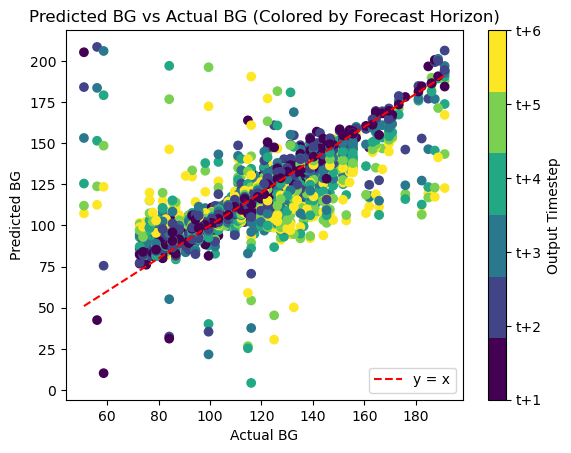


Running model for: id_2_data
Execution time: 55.44075894355774 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.8859801292419434 seconds
Execution time: 0.0005838871002197266 seconds
Execution time: 8.392333984375e-05 seconds


Overall Train RMSE: 10.050142051108038 mg/DL
Overall Test RMSE: 19.782857751978163 mg/DL


Train RMSE at t+1: 7.71 mg/DL
Train RMSE at t+2: 8.90 mg/DL
Train RMSE at t+3: 10.08 mg/DL
Train RMSE at t+4: 10.75 mg/DL
Train RMSE at t+5: 11.05 mg/DL
Train RMSE at t+6: 11.32 mg/DL


Test RMSE at t+1: 14.39 mg/DL
Test RMSE at t+2: 17.10 mg/DL
Test RMSE at t+3: 19.69 mg/DL
Test RMSE at t+4: 21.25 mg/DL
Test RMSE at t+5: 22.10 mg/DL
Test RMSE at t+6: 22.83 mg/DL


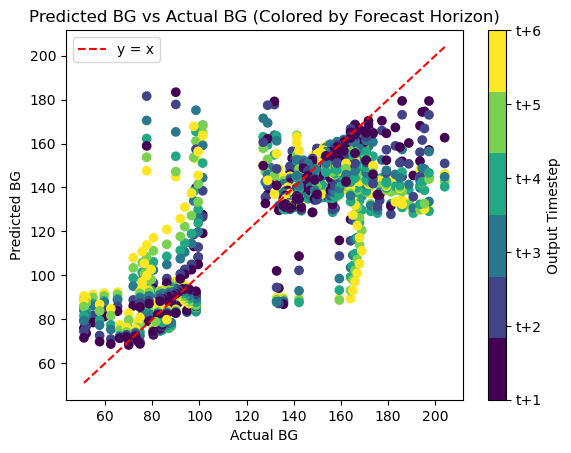


Running model for: id_3_data
Execution time: 65.73585629463196 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 1.020150899887085 seconds
Execution time: 0.0006010532379150391 seconds
Execution time: 8.20159912109375e-05 seconds


Overall Train RMSE: 9.830644029698883 mg/DL
Overall Test RMSE: 9.547988060447478 mg/DL


Train RMSE at t+1: 5.77 mg/DL
Train RMSE at t+2: 7.62 mg/DL
Train RMSE at t+3: 9.35 mg/DL
Train RMSE at t+4: 10.66 mg/DL
Train RMSE at t+5: 11.69 mg/DL
Train RMSE at t+6: 12.28 mg/DL


Test RMSE at t+1: 5.74 mg/DL
Test RMSE at t+2: 7.60 mg/DL
Test RMSE at t+3: 9.05 mg/DL
Test RMSE at t+4: 10.16 mg/DL
Test RMSE at t+5: 11.31 mg/DL
Test RMSE at t+6: 11.97 mg/DL


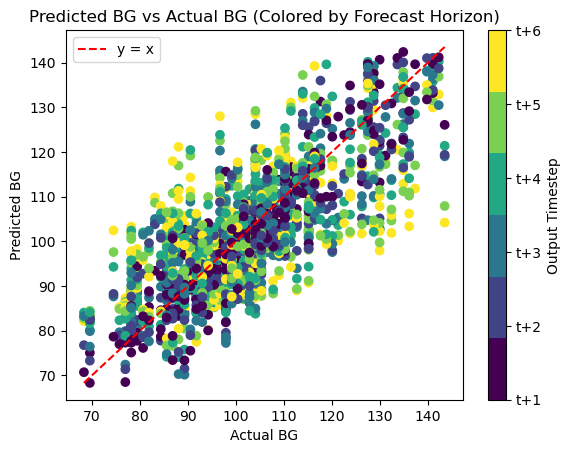


Running model for: id_4_data
Execution time: 61.62102389335632 seconds
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 1.0203120708465576 seconds
Execution time: 0.0011529922485351562 seconds
Execution time: 0.00026607513427734375 seconds


Overall Train RMSE: 11.099187725845745 mg/DL
Overall Test RMSE: 10.01048290850761 mg/DL


Train RMSE at t+1: 5.27 mg/DL
Train RMSE at t+2: 7.91 mg/DL
Train RMSE at t+3: 9.85 mg/DL
Train RMSE at t+4: 11.91 mg/DL
Train RMSE at t+5: 13.61 mg/DL
Train RMSE at t+6: 14.99 mg/DL


Test RMSE at t+1: 4.38 mg/DL
Test RMSE at t+2: 6.73 mg/DL
Test RMSE at t+3: 8.81 mg/DL
Test RMSE at t+4: 10.91 mg/DL
Test RMSE at t+5: 12.22 mg/DL
Test RMSE at t+6: 13.81 mg/DL


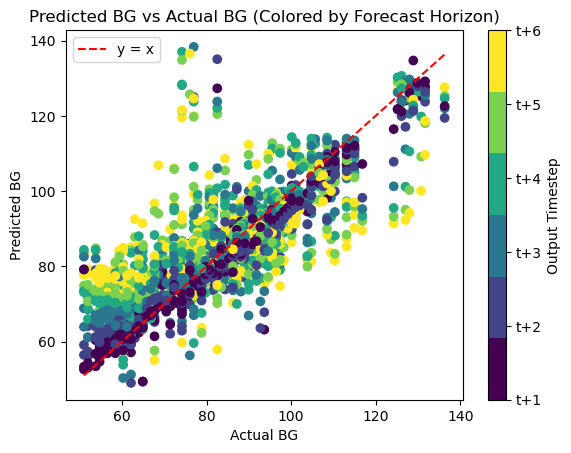


Running model for: id_5_data
Execution time: 61.30432105064392 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9626240730285645 seconds
Execution time: 0.0005691051483154297 seconds
Execution time: 8.916854858398438e-05 seconds


Overall Train RMSE: 15.212611968616024 mg/DL
Overall Test RMSE: 12.389760582840259 mg/DL


Train RMSE at t+1: 7.02 mg/DL
Train RMSE at t+2: 10.51 mg/DL
Train RMSE at t+3: 13.91 mg/DL
Train RMSE at t+4: 16.55 mg/DL
Train RMSE at t+5: 18.79 mg/DL
Train RMSE at t+6: 20.21 mg/DL


Test RMSE at t+1: 6.73 mg/DL
Test RMSE at t+2: 9.14 mg/DL
Test RMSE at t+3: 11.67 mg/DL
Test RMSE at t+4: 13.00 mg/DL
Test RMSE at t+5: 15.20 mg/DL
Test RMSE at t+6: 16.00 mg/DL


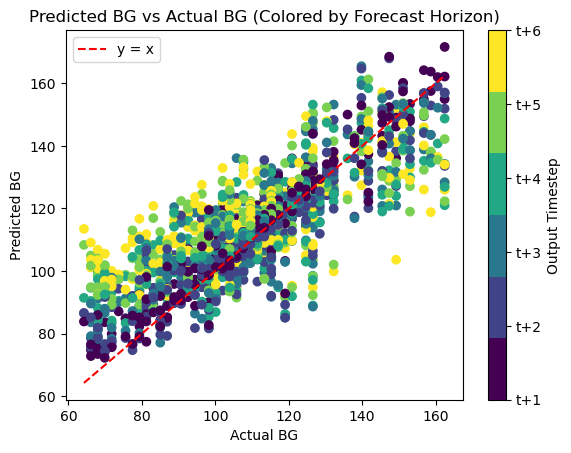


Running model for: id_6_data
Execution time: 59.82891082763672 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 1.0510690212249756 seconds
Execution time: 0.0005781650543212891 seconds
Execution time: 8.416175842285156e-05 seconds


Overall Train RMSE: 11.464505910366112 mg/DL
Overall Test RMSE: 12.331822536894423 mg/DL


Train RMSE at t+1: 8.05 mg/DL
Train RMSE at t+2: 9.60 mg/DL
Train RMSE at t+3: 10.55 mg/DL
Train RMSE at t+4: 12.07 mg/DL
Train RMSE at t+5: 12.86 mg/DL
Train RMSE at t+6: 14.47 mg/DL


Test RMSE at t+1: 9.31 mg/DL
Test RMSE at t+2: 10.58 mg/DL
Test RMSE at t+3: 12.16 mg/DL
Test RMSE at t+4: 13.04 mg/DL
Test RMSE at t+5: 13.53 mg/DL
Test RMSE at t+6: 14.59 mg/DL


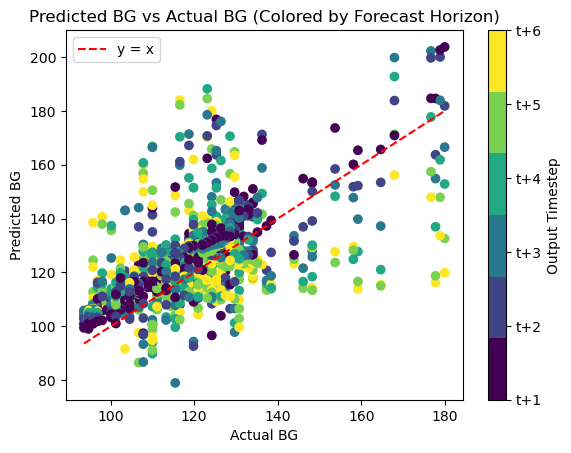


Running model for: id_7_data
Execution time: 57.23943591117859 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.8898119926452637 seconds
Execution time: 0.0005960464477539062 seconds
Execution time: 8.20159912109375e-05 seconds


Overall Train RMSE: 12.710189792336731 mg/DL
Overall Test RMSE: 10.596413650125424 mg/DL


Train RMSE at t+1: 6.42 mg/DL
Train RMSE at t+2: 9.12 mg/DL
Train RMSE at t+3: 11.71 mg/DL
Train RMSE at t+4: 13.80 mg/DL
Train RMSE at t+5: 15.40 mg/DL
Train RMSE at t+6: 16.74 mg/DL


Test RMSE at t+1: 5.64 mg/DL
Test RMSE at t+2: 6.99 mg/DL
Test RMSE at t+3: 9.52 mg/DL
Test RMSE at t+4: 11.64 mg/DL
Test RMSE at t+5: 13.11 mg/DL
Test RMSE at t+6: 13.97 mg/DL


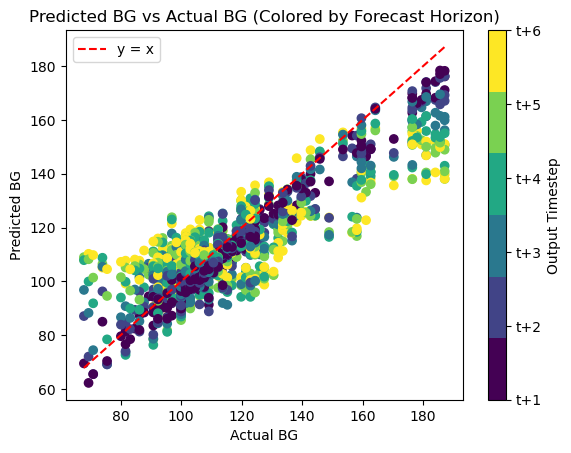


Running model for: id_8_data
Execution time: 56.2462592124939 seconds
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.8301072120666504 seconds
Execution time: 0.0006041526794433594 seconds
Execution time: 7.390975952148438e-05 seconds


Overall Train RMSE: 10.879406695641752 mg/DL
Overall Test RMSE: 9.675346143563461 mg/DL


Train RMSE at t+1: 4.85 mg/DL
Train RMSE at t+2: 7.31 mg/DL
Train RMSE at t+3: 9.72 mg/DL
Train RMSE at t+4: 11.71 mg/DL
Train RMSE at t+5: 13.52 mg/DL
Train RMSE at t+6: 14.79 mg/DL


Test RMSE at t+1: 4.41 mg/DL
Test RMSE at t+2: 6.67 mg/DL
Test RMSE at t+3: 8.78 mg/DL
Test RMSE at t+4: 10.60 mg/DL
Test RMSE at t+5: 11.82 mg/DL
Test RMSE at t+6: 12.98 mg/DL


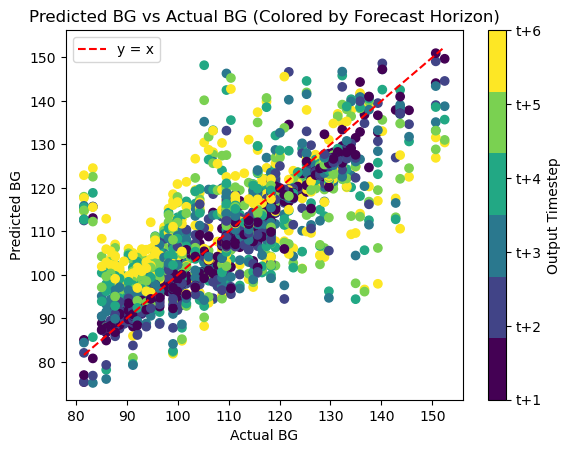


Running model for: id_9_data
Execution time: 56.92694091796875 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8943428993225098 seconds
Execution time: 0.0005619525909423828 seconds
Execution time: 9.012222290039062e-05 seconds


Overall Train RMSE: 11.848520758183172 mg/DL
Overall Test RMSE: 14.557583356932046 mg/DL


Train RMSE at t+1: 5.65 mg/DL
Train RMSE at t+2: 8.37 mg/DL
Train RMSE at t+3: 10.36 mg/DL
Train RMSE at t+4: 12.57 mg/DL
Train RMSE at t+5: 14.53 mg/DL
Train RMSE at t+6: 16.25 mg/DL


Test RMSE at t+1: 7.95 mg/DL
Test RMSE at t+2: 11.12 mg/DL
Test RMSE at t+3: 13.52 mg/DL
Test RMSE at t+4: 15.36 mg/DL
Test RMSE at t+5: 17.27 mg/DL
Test RMSE at t+6: 19.18 mg/DL


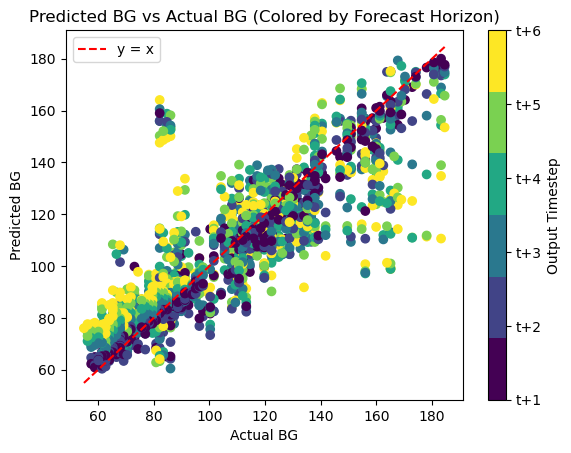


Running model for: id_10_data
Execution time: 56.18606495857239 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8968460559844971 seconds
Execution time: 0.0005719661712646484 seconds
Execution time: 8.106231689453125e-05 seconds


Overall Train RMSE: 11.17140351967398 mg/DL
Overall Test RMSE: 10.42986037092444 mg/DL


Train RMSE at t+1: 4.31 mg/DL
Train RMSE at t+2: 7.17 mg/DL
Train RMSE at t+3: 9.88 mg/DL
Train RMSE at t+4: 12.18 mg/DL
Train RMSE at t+5: 13.95 mg/DL
Train RMSE at t+6: 15.43 mg/DL


Test RMSE at t+1: 3.34 mg/DL
Test RMSE at t+2: 5.71 mg/DL
Test RMSE at t+3: 8.42 mg/DL
Test RMSE at t+4: 11.18 mg/DL
Test RMSE at t+5: 13.41 mg/DL
Test RMSE at t+6: 15.27 mg/DL


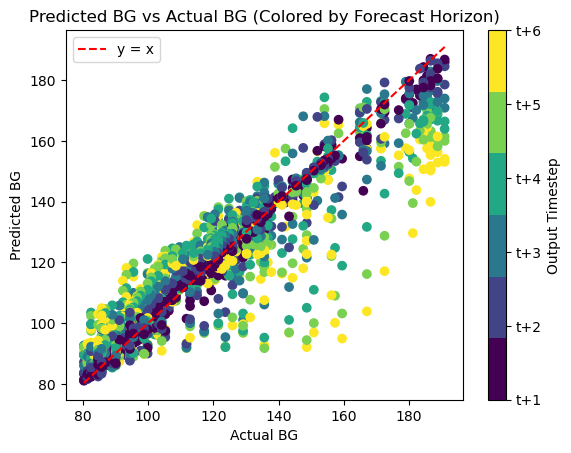


Running model for: id_11_data
Execution time: 54.84839391708374 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 1.2614598274230957 seconds
Execution time: 0.0006573200225830078 seconds
Execution time: 9.298324584960938e-05 seconds


Overall Train RMSE: 10.230566232275978 mg/DL
Overall Test RMSE: 15.997254089482025 mg/DL


Train RMSE at t+1: 5.89 mg/DL
Train RMSE at t+2: 8.09 mg/DL
Train RMSE at t+3: 9.36 mg/DL
Train RMSE at t+4: 10.88 mg/DL
Train RMSE at t+5: 12.14 mg/DL
Train RMSE at t+6: 13.21 mg/DL


Test RMSE at t+1: 9.16 mg/DL
Test RMSE at t+2: 11.97 mg/DL
Test RMSE at t+3: 14.73 mg/DL
Test RMSE at t+4: 17.35 mg/DL
Test RMSE at t+5: 19.10 mg/DL
Test RMSE at t+6: 20.63 mg/DL


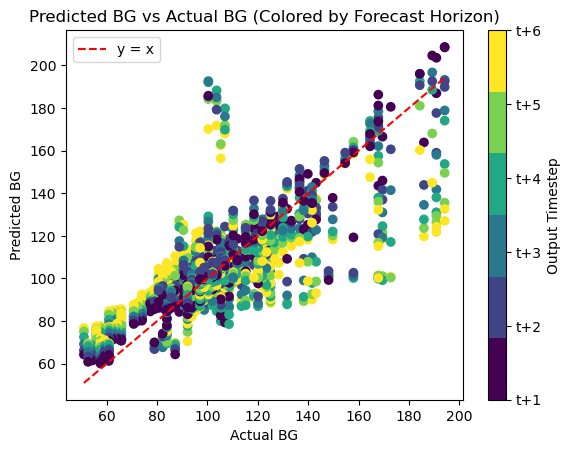


Running model for: id_12_data
Execution time: 56.785337686538696 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9467880725860596 seconds
Execution time: 0.0005619525909423828 seconds
Execution time: 7.987022399902344e-05 seconds


Overall Train RMSE: 10.61794166780731 mg/DL
Overall Test RMSE: 13.539246820659644 mg/DL


Train RMSE at t+1: 7.43 mg/DL
Train RMSE at t+2: 8.92 mg/DL
Train RMSE at t+3: 10.18 mg/DL
Train RMSE at t+4: 11.07 mg/DL
Train RMSE at t+5: 12.15 mg/DL
Train RMSE at t+6: 12.96 mg/DL


Test RMSE at t+1: 9.70 mg/DL
Test RMSE at t+2: 11.30 mg/DL
Test RMSE at t+3: 13.24 mg/DL
Test RMSE at t+4: 14.04 mg/DL
Test RMSE at t+5: 15.41 mg/DL
Test RMSE at t+6: 16.38 mg/DL


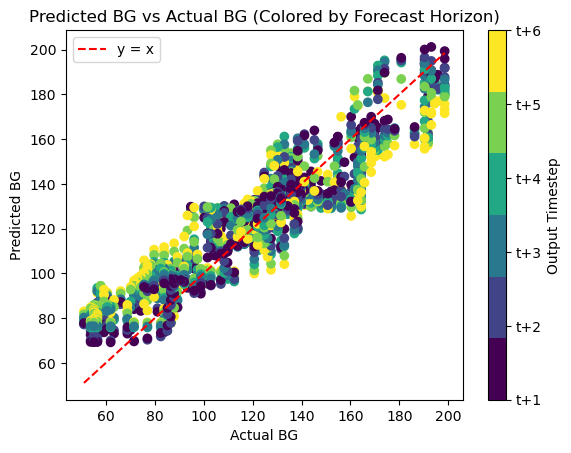


Running model for: id_13_data
Execution time: 61.756101846694946 seconds
58/58 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 1.179854154586792 seconds
Execution time: 0.0006999969482421875 seconds
Execution time: 9.012222290039062e-05 seconds


Overall Train RMSE: 13.67840139065982 mg/DL
Overall Test RMSE: 14.481163362090909 mg/DL


Train RMSE at t+1: 6.94 mg/DL
Train RMSE at t+2: 10.38 mg/DL
Train RMSE at t+3: 12.77 mg/DL
Train RMSE at t+4: 14.88 mg/DL
Train RMSE at t+5: 16.41 mg/DL
Train RMSE at t+6: 17.69 mg/DL


Test RMSE at t+1: 7.30 mg/DL
Test RMSE at t+2: 10.65 mg/DL
Test RMSE at t+3: 13.20 mg/DL
Test RMSE at t+4: 15.94 mg/DL
Test RMSE at t+5: 17.43 mg/DL
Test RMSE at t+6: 18.95 mg/DL


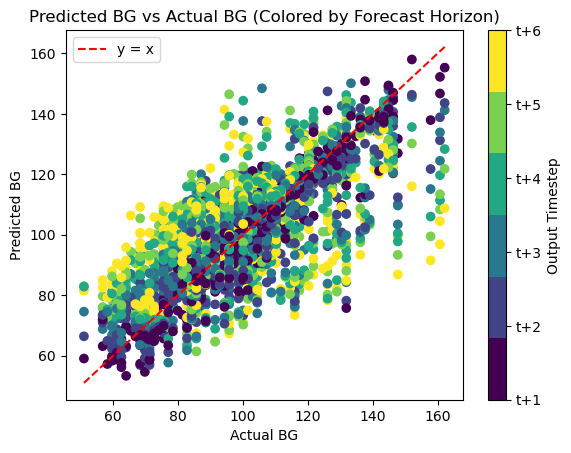


Running model for: id_14_data
Execution time: 67.01617169380188 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.971146821975708 seconds
Execution time: 0.0005662441253662109 seconds
Execution time: 9.131431579589844e-05 seconds


Overall Train RMSE: 11.396372090967507 mg/DL
Overall Test RMSE: 12.369704549550153 mg/DL


Train RMSE at t+1: 5.67 mg/DL
Train RMSE at t+2: 8.31 mg/DL
Train RMSE at t+3: 10.52 mg/DL
Train RMSE at t+4: 12.30 mg/DL
Train RMSE at t+5: 14.12 mg/DL
Train RMSE at t+6: 14.72 mg/DL


Test RMSE at t+1: 5.31 mg/DL
Test RMSE at t+2: 8.15 mg/DL
Test RMSE at t+3: 11.05 mg/DL
Test RMSE at t+4: 13.13 mg/DL
Test RMSE at t+5: 15.38 mg/DL
Test RMSE at t+6: 17.10 mg/DL


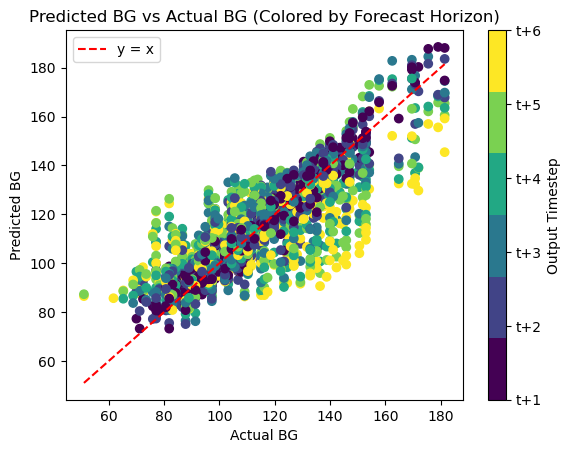


Running model for: id_15_data
Execution time: 61.01661992073059 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9554376602172852 seconds
Execution time: 0.0005838871002197266 seconds
Execution time: 8.416175842285156e-05 seconds


Overall Train RMSE: 11.523645989526429 mg/DL
Overall Test RMSE: 13.864479937575002 mg/DL


Train RMSE at t+1: 7.21 mg/DL
Train RMSE at t+2: 9.57 mg/DL
Train RMSE at t+3: 11.43 mg/DL
Train RMSE at t+4: 12.27 mg/DL
Train RMSE at t+5: 13.38 mg/DL
Train RMSE at t+6: 13.89 mg/DL


Test RMSE at t+1: 8.26 mg/DL
Test RMSE at t+2: 11.44 mg/DL
Test RMSE at t+3: 13.79 mg/DL
Test RMSE at t+4: 14.81 mg/DL
Test RMSE at t+5: 16.12 mg/DL
Test RMSE at t+6: 16.89 mg/DL


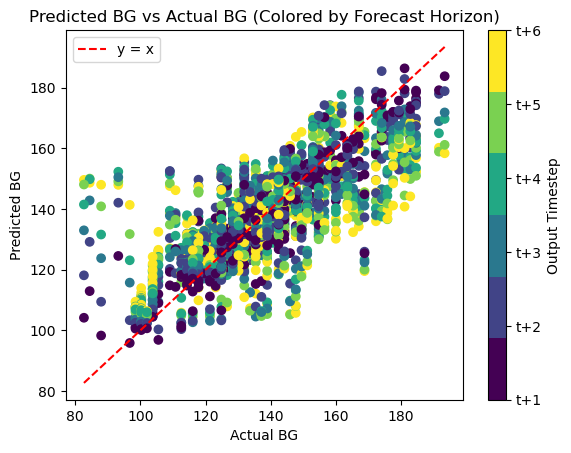


Running model for: id_16_data
Execution time: 62.09619188308716 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Execution time: 0.940532922744751 seconds
Execution time: 0.0010027885437011719 seconds
Execution time: 7.176399230957031e-05 seconds


Overall Train RMSE: 14.160905936912956 mg/DL
Overall Test RMSE: 13.07596621101739 mg/DL


Train RMSE at t+1: 6.80 mg/DL
Train RMSE at t+2: 10.34 mg/DL
Train RMSE at t+3: 13.24 mg/DL
Train RMSE at t+4: 15.43 mg/DL
Train RMSE at t+5: 17.05 mg/DL
Train RMSE at t+6: 18.60 mg/DL


Test RMSE at t+1: 6.00 mg/DL
Test RMSE at t+2: 9.55 mg/DL
Test RMSE at t+3: 12.38 mg/DL
Test RMSE at t+4: 14.42 mg/DL
Test RMSE at t+5: 15.88 mg/DL
Test RMSE at t+6: 16.89 mg/DL


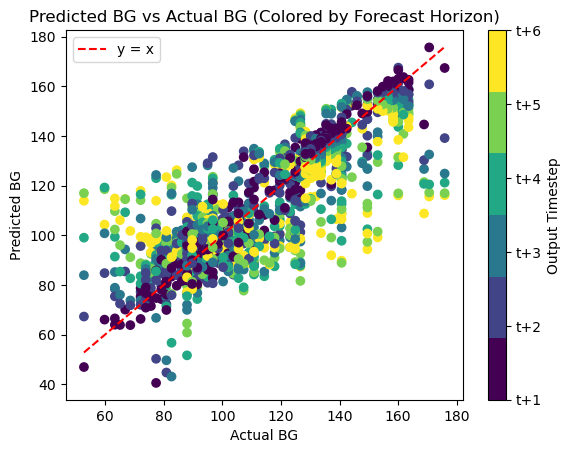


Running model for: id_17_data
Execution time: 57.71462607383728 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.9970848560333252 seconds
Execution time: 0.0005600452423095703 seconds
Execution time: 0.0001227855682373047 seconds


Overall Train RMSE: 14.483684787045322 mg/DL
Overall Test RMSE: 16.411757942471354 mg/DL


Train RMSE at t+1: 8.42 mg/DL
Train RMSE at t+2: 11.44 mg/DL
Train RMSE at t+3: 14.00 mg/DL
Train RMSE at t+4: 15.67 mg/DL
Train RMSE at t+5: 17.14 mg/DL
Train RMSE at t+6: 17.93 mg/DL


Test RMSE at t+1: 11.08 mg/DL
Test RMSE at t+2: 14.19 mg/DL
Test RMSE at t+3: 16.43 mg/DL
Test RMSE at t+4: 17.47 mg/DL
Test RMSE at t+5: 18.53 mg/DL
Test RMSE at t+6: 19.32 mg/DL


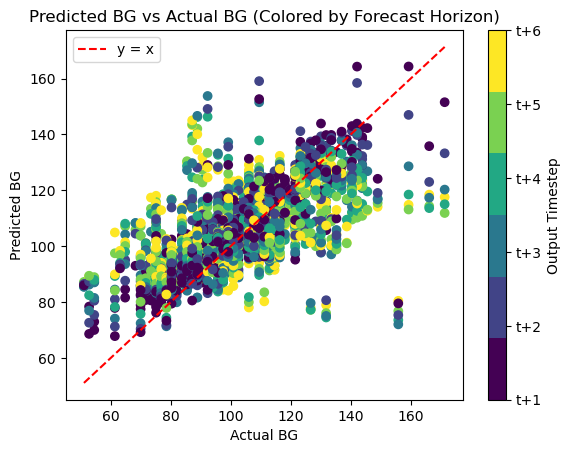


Running model for: id_18_data
Execution time: 64.07944512367249 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.920281171798706 seconds
Execution time: 0.0005660057067871094 seconds
Execution time: 8.988380432128906e-05 seconds


Overall Train RMSE: 13.821324757855738 mg/DL
Overall Test RMSE: 15.978676160187652 mg/DL


Train RMSE at t+1: 7.00 mg/DL
Train RMSE at t+2: 9.92 mg/DL
Train RMSE at t+3: 12.51 mg/DL
Train RMSE at t+4: 15.11 mg/DL
Train RMSE at t+5: 16.77 mg/DL
Train RMSE at t+6: 18.25 mg/DL


Test RMSE at t+1: 6.84 mg/DL
Test RMSE at t+2: 10.10 mg/DL
Test RMSE at t+3: 14.37 mg/DL
Test RMSE at t+4: 17.33 mg/DL
Test RMSE at t+5: 19.82 mg/DL
Test RMSE at t+6: 21.99 mg/DL


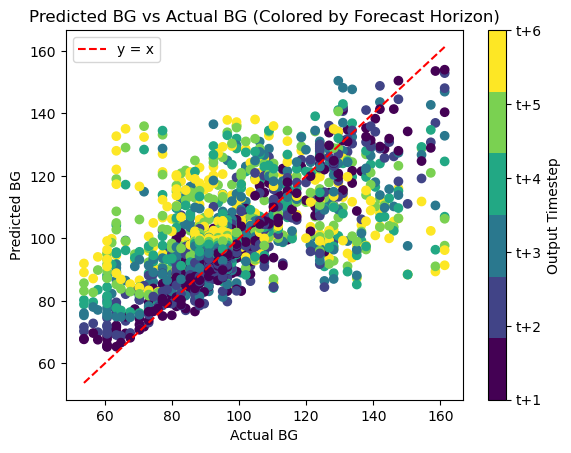


Running model for: id_19_data
Execution time: 59.67766880989075 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9560990333557129 seconds
Execution time: 0.0005676746368408203 seconds
Execution time: 8.320808410644531e-05 seconds


Overall Train RMSE: 14.788921549095027 mg/DL
Overall Test RMSE: 12.255637184942715 mg/DL


Train RMSE at t+1: 6.33 mg/DL
Train RMSE at t+2: 9.64 mg/DL
Train RMSE at t+3: 13.20 mg/DL
Train RMSE at t+4: 16.26 mg/DL
Train RMSE at t+5: 18.46 mg/DL
Train RMSE at t+6: 19.99 mg/DL


Test RMSE at t+1: 6.07 mg/DL
Test RMSE at t+2: 8.88 mg/DL
Test RMSE at t+3: 11.40 mg/DL
Test RMSE at t+4: 13.42 mg/DL
Test RMSE at t+5: 14.90 mg/DL
Test RMSE at t+6: 15.92 mg/DL


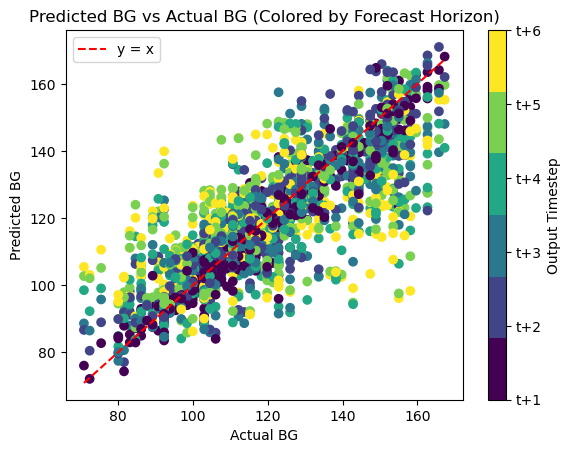


Running model for: id_20_data
Execution time: 57.68052697181702 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9107840061187744 seconds
Execution time: 0.0005540847778320312 seconds
Execution time: 7.987022399902344e-05 seconds


Overall Train RMSE: 9.064181329705024 mg/DL
Overall Test RMSE: 18.141512350862715 mg/DL


Train RMSE at t+1: 5.11 mg/DL
Train RMSE at t+2: 6.06 mg/DL
Train RMSE at t+3: 7.89 mg/DL
Train RMSE at t+4: 9.56 mg/DL
Train RMSE at t+5: 11.07 mg/DL
Train RMSE at t+6: 12.40 mg/DL


Test RMSE at t+1: 6.89 mg/DL
Test RMSE at t+2: 12.16 mg/DL
Test RMSE at t+3: 14.39 mg/DL
Test RMSE at t+4: 19.66 mg/DL
Test RMSE at t+5: 22.66 mg/DL
Test RMSE at t+6: 25.93 mg/DL


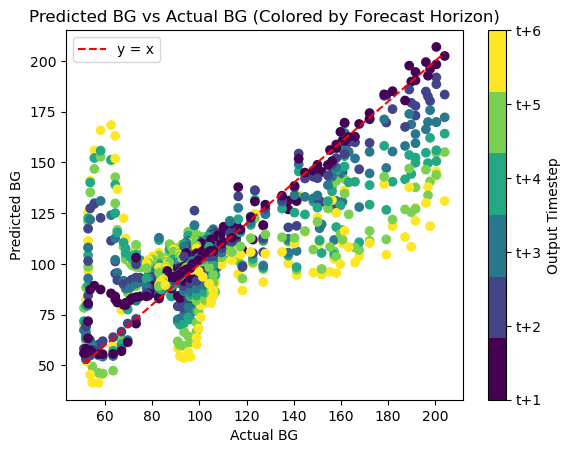


Running model for: id_21_data
Execution time: 57.150097131729126 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.9196829795837402 seconds
Execution time: 0.0005931854248046875 seconds
Execution time: 8.20159912109375e-05 seconds


Overall Train RMSE: 9.010469044654416 mg/DL
Overall Test RMSE: 12.157300066154988 mg/DL


Train RMSE at t+1: 5.59 mg/DL
Train RMSE at t+2: 6.80 mg/DL
Train RMSE at t+3: 8.09 mg/DL
Train RMSE at t+4: 9.34 mg/DL
Train RMSE at t+5: 10.71 mg/DL
Train RMSE at t+6: 11.93 mg/DL


Test RMSE at t+1: 6.92 mg/DL
Test RMSE at t+2: 8.53 mg/DL
Test RMSE at t+3: 10.35 mg/DL
Test RMSE at t+4: 12.77 mg/DL
Test RMSE at t+5: 14.92 mg/DL
Test RMSE at t+6: 16.53 mg/DL


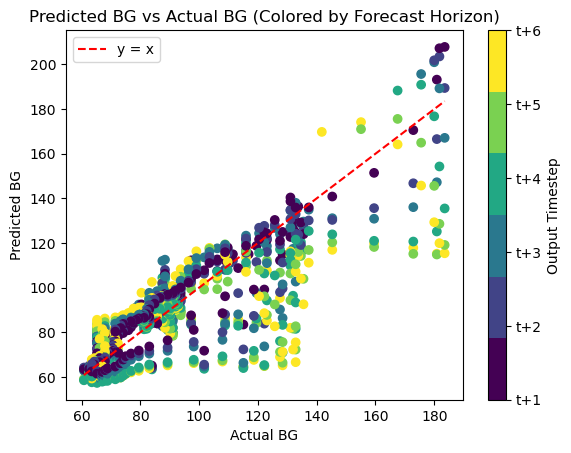


Running model for: id_22_data
Execution time: 45.37564492225647 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.8863937854766846 seconds
Execution time: 0.0005621910095214844 seconds
Execution time: 8.392333984375e-05 seconds


Overall Train RMSE: 13.957903672967888 mg/DL
Overall Test RMSE: 11.230588552807284 mg/DL


Train RMSE at t+1: 9.46 mg/DL
Train RMSE at t+2: 10.65 mg/DL
Train RMSE at t+3: 11.69 mg/DL
Train RMSE at t+4: 14.61 mg/DL
Train RMSE at t+5: 16.57 mg/DL
Train RMSE at t+6: 18.47 mg/DL


Test RMSE at t+1: 8.43 mg/DL
Test RMSE at t+2: 9.36 mg/DL
Test RMSE at t+3: 9.31 mg/DL
Test RMSE at t+4: 11.30 mg/DL
Test RMSE at t+5: 13.03 mg/DL
Test RMSE at t+6: 14.63 mg/DL


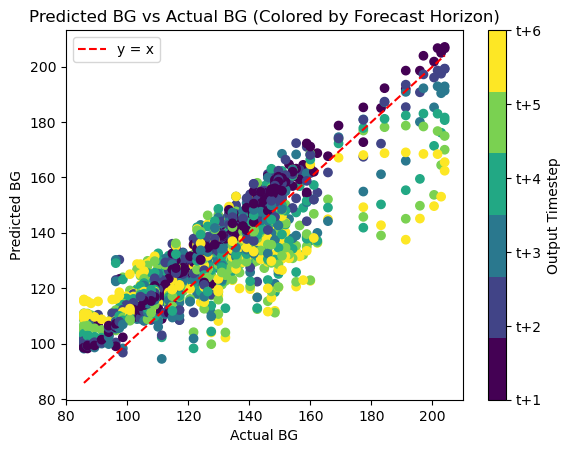


Running model for: id_23_data
Execution time: 55.76450204849243 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8848111629486084 seconds
Execution time: 0.0005538463592529297 seconds
Execution time: 8.20159912109375e-05 seconds


Overall Train RMSE: 6.281989629286621 mg/DL
Overall Test RMSE: 15.745943027261113 mg/DL


Train RMSE at t+1: 3.03 mg/DL
Train RMSE at t+2: 4.60 mg/DL
Train RMSE at t+3: 5.48 mg/DL
Train RMSE at t+4: 6.59 mg/DL
Train RMSE at t+5: 7.63 mg/DL
Train RMSE at t+6: 8.65 mg/DL


Test RMSE at t+1: 7.92 mg/DL
Test RMSE at t+2: 11.98 mg/DL
Test RMSE at t+3: 14.48 mg/DL
Test RMSE at t+4: 17.20 mg/DL
Test RMSE at t+5: 18.56 mg/DL
Test RMSE at t+6: 20.77 mg/DL


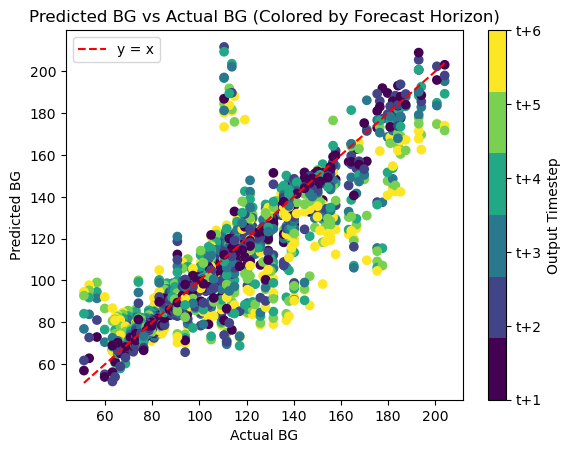


Running model for: id_24_data
Execution time: 56.41133379936218 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8988239765167236 seconds
Execution time: 0.0005860328674316406 seconds
Execution time: 8.106231689453125e-05 seconds


Overall Train RMSE: 10.359525573571199 mg/DL
Overall Test RMSE: 15.195757113905154 mg/DL


Train RMSE at t+1: 5.34 mg/DL
Train RMSE at t+2: 7.88 mg/DL
Train RMSE at t+3: 9.49 mg/DL
Train RMSE at t+4: 10.99 mg/DL
Train RMSE at t+5: 12.42 mg/DL
Train RMSE at t+6: 13.72 mg/DL


Test RMSE at t+1: 7.41 mg/DL
Test RMSE at t+2: 10.95 mg/DL
Test RMSE at t+3: 13.28 mg/DL
Test RMSE at t+4: 15.60 mg/DL
Test RMSE at t+5: 18.65 mg/DL
Test RMSE at t+6: 21.05 mg/DL


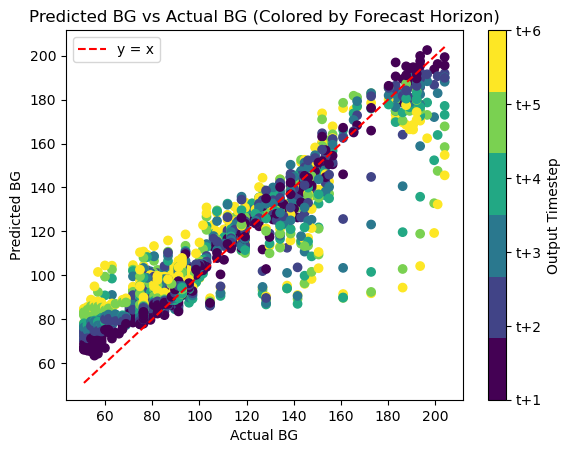


Running model for: id_25_data
Execution time: 64.97768712043762 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
Execution time: 1.0611572265625 seconds
Execution time: 0.0009021759033203125 seconds
Execution time: 0.00019407272338867188 seconds


Overall Train RMSE: 12.680827395019866 mg/DL
Overall Test RMSE: 11.359346394364005 mg/DL


Train RMSE at t+1: 4.44 mg/DL
Train RMSE at t+2: 7.94 mg/DL
Train RMSE at t+3: 10.61 mg/DL
Train RMSE at t+4: 13.18 mg/DL
Train RMSE at t+5: 16.27 mg/DL
Train RMSE at t+6: 18.19 mg/DL


Test RMSE at t+1: 3.40 mg/DL
Test RMSE at t+2: 7.08 mg/DL
Test RMSE at t+3: 9.63 mg/DL
Test RMSE at t+4: 11.87 mg/DL
Test RMSE at t+5: 14.67 mg/DL
Test RMSE at t+6: 16.24 mg/DL


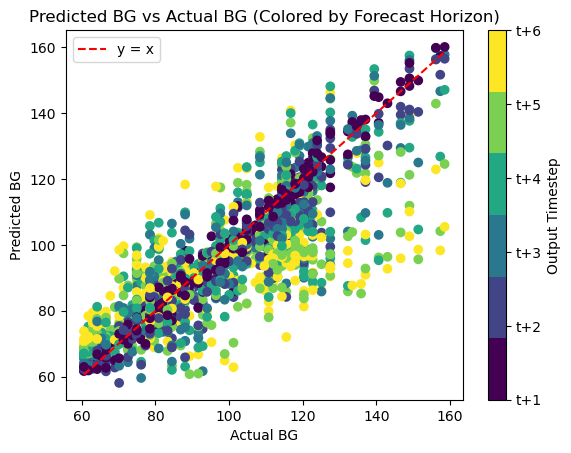


Running model for: id_26_data
Execution time: 54.000240325927734 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
Execution time: 1.0654010772705078 seconds
Execution time: 0.0006570816040039062 seconds
Execution time: 8.392333984375e-05 seconds


Overall Train RMSE: 6.528491823884473 mg/DL
Overall Test RMSE: 5.879206254231887 mg/DL


Train RMSE at t+1: 3.38 mg/DL
Train RMSE at t+2: 4.51 mg/DL
Train RMSE at t+3: 4.99 mg/DL
Train RMSE at t+4: 6.48 mg/DL
Train RMSE at t+5: 8.11 mg/DL
Train RMSE at t+6: 9.55 mg/DL


Test RMSE at t+1: 3.77 mg/DL
Test RMSE at t+2: 4.90 mg/DL
Test RMSE at t+3: 4.90 mg/DL
Test RMSE at t+4: 5.77 mg/DL
Test RMSE at t+5: 6.97 mg/DL
Test RMSE at t+6: 7.96 mg/DL


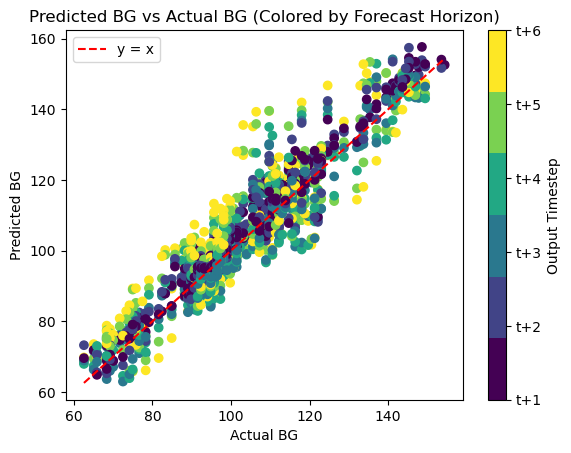


Running model for: id_27_data
Execution time: 56.3672571182251 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.9956040382385254 seconds
Execution time: 0.0007669925689697266 seconds
Execution time: 7.295608520507812e-05 seconds


Overall Train RMSE: 13.485686483316723 mg/DL
Overall Test RMSE: 14.408913499374721 mg/DL


Train RMSE at t+1: 5.46 mg/DL
Train RMSE at t+2: 9.04 mg/DL
Train RMSE at t+3: 11.92 mg/DL
Train RMSE at t+4: 14.68 mg/DL
Train RMSE at t+5: 17.04 mg/DL
Train RMSE at t+6: 18.22 mg/DL


Test RMSE at t+1: 4.47 mg/DL
Test RMSE at t+2: 9.38 mg/DL
Test RMSE at t+3: 12.80 mg/DL
Test RMSE at t+4: 16.34 mg/DL
Test RMSE at t+5: 18.71 mg/DL
Test RMSE at t+6: 18.89 mg/DL


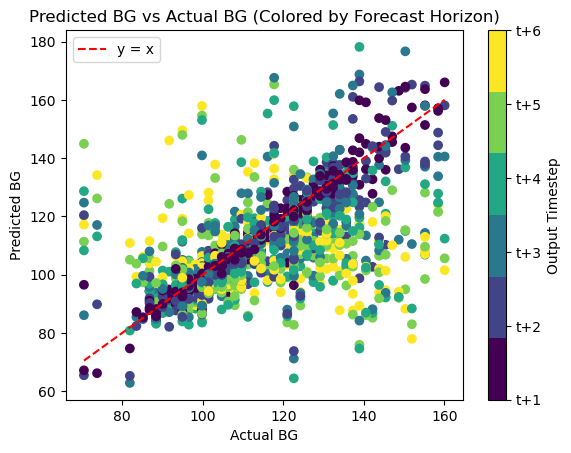


Running model for: id_28_data
Execution time: 55.12768507003784 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 1.0075130462646484 seconds
Execution time: 0.0006041526794433594 seconds
Execution time: 7.486343383789062e-05 seconds


Overall Train RMSE: 11.113429645885098 mg/DL
Overall Test RMSE: 10.430112898007472 mg/DL


Train RMSE at t+1: 4.87 mg/DL
Train RMSE at t+2: 7.70 mg/DL
Train RMSE at t+3: 10.19 mg/DL
Train RMSE at t+4: 12.16 mg/DL
Train RMSE at t+5: 13.69 mg/DL
Train RMSE at t+6: 14.79 mg/DL


Test RMSE at t+1: 4.12 mg/DL
Test RMSE at t+2: 6.71 mg/DL
Test RMSE at t+3: 9.35 mg/DL
Test RMSE at t+4: 11.33 mg/DL
Test RMSE at t+5: 12.84 mg/DL
Test RMSE at t+6: 14.48 mg/DL


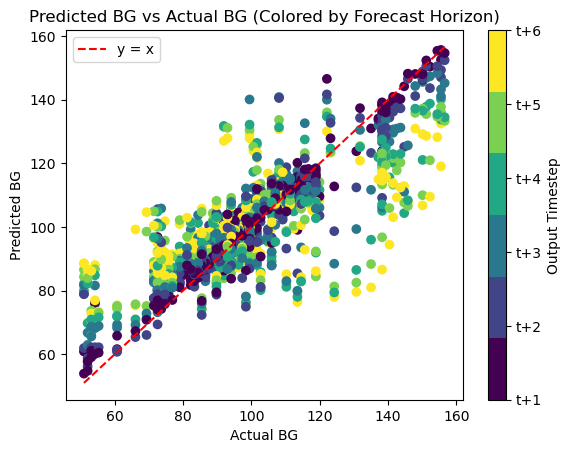


Running model for: id_29_data
Execution time: 62.03872799873352 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.9832730293273926 seconds
Execution time: 0.0005290508270263672 seconds
Execution time: 0.00015997886657714844 seconds


Overall Train RMSE: 14.298241422869285 mg/DL
Overall Test RMSE: 15.851723116392101 mg/DL


Train RMSE at t+1: 7.01 mg/DL
Train RMSE at t+2: 10.29 mg/DL
Train RMSE at t+3: 12.92 mg/DL
Train RMSE at t+4: 16.13 mg/DL
Train RMSE at t+5: 17.70 mg/DL
Train RMSE at t+6: 18.20 mg/DL


Test RMSE at t+1: 6.61 mg/DL
Test RMSE at t+2: 9.80 mg/DL
Test RMSE at t+3: 12.77 mg/DL
Test RMSE at t+4: 18.37 mg/DL
Test RMSE at t+5: 20.49 mg/DL
Test RMSE at t+6: 21.16 mg/DL


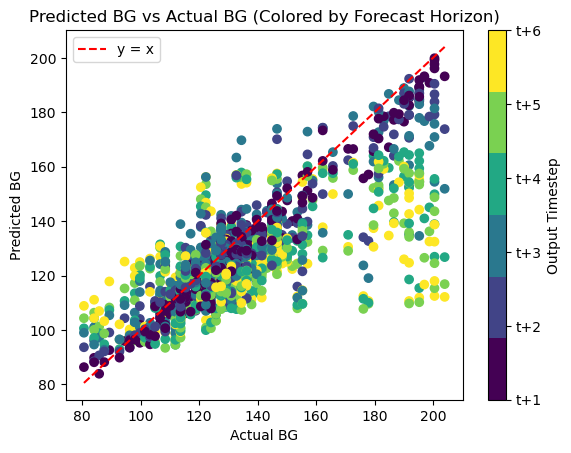


Running model for: id_30_data
Execution time: 61.21173572540283 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9475200176239014 seconds
Execution time: 0.0006170272827148438 seconds
Execution time: 8.392333984375e-05 seconds


Overall Train RMSE: 12.557847376824979 mg/DL
Overall Test RMSE: 12.017152345440298 mg/DL


Train RMSE at t+1: 7.86 mg/DL
Train RMSE at t+2: 9.52 mg/DL
Train RMSE at t+3: 11.65 mg/DL
Train RMSE at t+4: 12.84 mg/DL
Train RMSE at t+5: 15.18 mg/DL
Train RMSE at t+6: 16.20 mg/DL


Test RMSE at t+1: 7.46 mg/DL
Test RMSE at t+2: 8.59 mg/DL
Test RMSE at t+3: 10.59 mg/DL
Test RMSE at t+4: 12.33 mg/DL
Test RMSE at t+5: 14.77 mg/DL
Test RMSE at t+6: 15.96 mg/DL


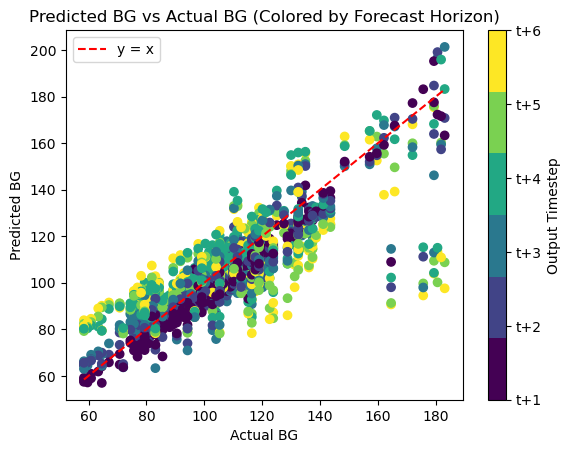


Running model for: id_31_data
Execution time: 60.296228885650635 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 1.0501561164855957 seconds
Execution time: 0.0005280971527099609 seconds
Execution time: 0.0001270771026611328 seconds


Overall Train RMSE: 17.240362679226646 mg/DL
Overall Test RMSE: 11.918488008655176 mg/DL


Train RMSE at t+1: 8.46 mg/DL
Train RMSE at t+2: 12.59 mg/DL
Train RMSE at t+3: 16.33 mg/DL
Train RMSE at t+4: 18.66 mg/DL
Train RMSE at t+5: 21.11 mg/DL
Train RMSE at t+6: 22.20 mg/DL


Test RMSE at t+1: 5.84 mg/DL
Test RMSE at t+2: 8.67 mg/DL
Test RMSE at t+3: 11.16 mg/DL
Test RMSE at t+4: 12.45 mg/DL
Test RMSE at t+5: 14.51 mg/DL
Test RMSE at t+6: 15.91 mg/DL


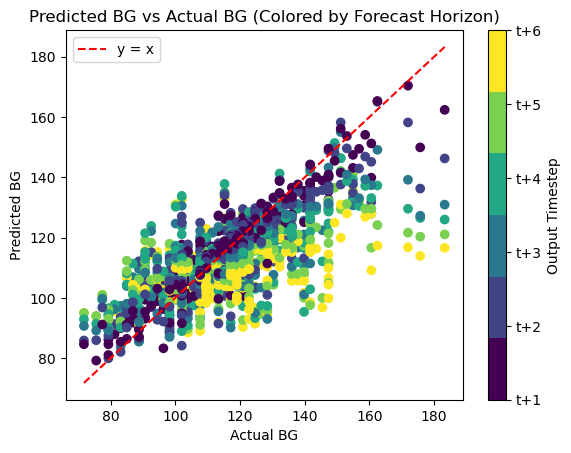


Running model for: id_32_data
Execution time: 58.845032930374146 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9137187004089355 seconds
Execution time: 0.0006411075592041016 seconds
Execution time: 0.00015997886657714844 seconds


Overall Train RMSE: 8.879075704035076 mg/DL
Overall Test RMSE: 13.656335433093515 mg/DL


Train RMSE at t+1: 3.72 mg/DL
Train RMSE at t+2: 6.15 mg/DL
Train RMSE at t+3: 8.01 mg/DL
Train RMSE at t+4: 9.61 mg/DL
Train RMSE at t+5: 10.94 mg/DL
Train RMSE at t+6: 12.05 mg/DL


Test RMSE at t+1: 5.22 mg/DL
Test RMSE at t+2: 8.89 mg/DL
Test RMSE at t+3: 11.79 mg/DL
Test RMSE at t+4: 14.42 mg/DL
Test RMSE at t+5: 16.96 mg/DL
Test RMSE at t+6: 19.44 mg/DL


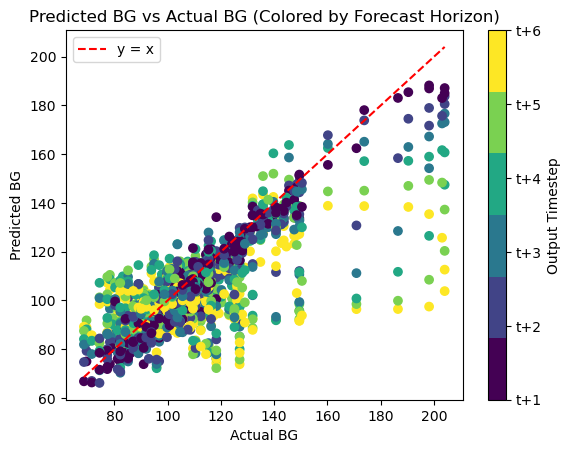


Running model for: id_33_data
Execution time: 55.64479422569275 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 1.822416067123413 seconds
Execution time: 0.0005550384521484375 seconds
Execution time: 8.869171142578125e-05 seconds


Overall Train RMSE: 13.349460073540357 mg/DL
Overall Test RMSE: 14.472473720485274 mg/DL


Train RMSE at t+1: 5.09 mg/DL
Train RMSE at t+2: 8.25 mg/DL
Train RMSE at t+3: 11.74 mg/DL
Train RMSE at t+4: 14.60 mg/DL
Train RMSE at t+5: 16.84 mg/DL
Train RMSE at t+6: 18.45 mg/DL


Test RMSE at t+1: 6.64 mg/DL
Test RMSE at t+2: 10.30 mg/DL
Test RMSE at t+3: 13.74 mg/DL
Test RMSE at t+4: 15.97 mg/DL
Test RMSE at t+5: 17.87 mg/DL
Test RMSE at t+6: 18.53 mg/DL


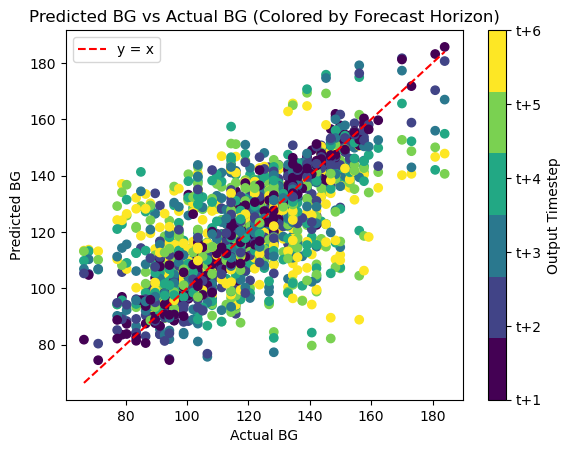


Running model for: id_34_data
Execution time: 56.40265202522278 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9385819435119629 seconds
Execution time: 0.0005719661712646484 seconds
Execution time: 8.392333984375e-05 seconds


Overall Train RMSE: 8.108986027478968 mg/DL
Overall Test RMSE: 14.485331050522346 mg/DL


Train RMSE at t+1: 4.03 mg/DL
Train RMSE at t+2: 5.54 mg/DL
Train RMSE at t+3: 7.29 mg/DL
Train RMSE at t+4: 8.81 mg/DL
Train RMSE at t+5: 9.85 mg/DL
Train RMSE at t+6: 10.95 mg/DL


Test RMSE at t+1: 7.39 mg/DL
Test RMSE at t+2: 10.24 mg/DL
Test RMSE at t+3: 12.81 mg/DL
Test RMSE at t+4: 15.53 mg/DL
Test RMSE at t+5: 17.67 mg/DL
Test RMSE at t+6: 19.54 mg/DL


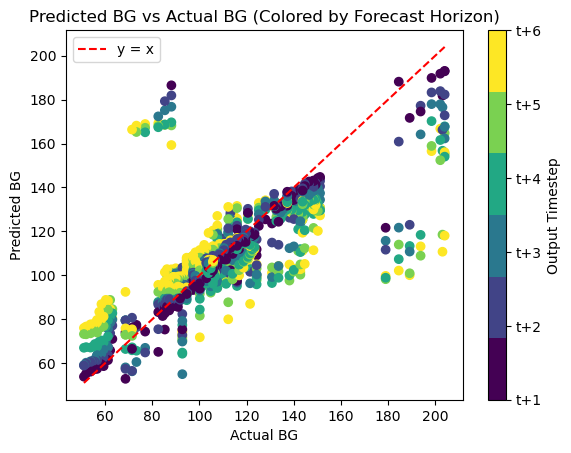


Running model for: id_35_data
Execution time: 55.41203498840332 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.7057068347930908 seconds
Execution time: 0.0005869865417480469 seconds
Execution time: 0.00012993812561035156 seconds


Overall Train RMSE: 8.855052237415885 mg/DL
Overall Test RMSE: 6.947740212907577 mg/DL


Train RMSE at t+1: 4.59 mg/DL
Train RMSE at t+2: 6.55 mg/DL
Train RMSE at t+3: 8.19 mg/DL
Train RMSE at t+4: 9.62 mg/DL
Train RMSE at t+5: 10.53 mg/DL
Train RMSE at t+6: 11.67 mg/DL


Test RMSE at t+1: 3.00 mg/DL
Test RMSE at t+2: 4.73 mg/DL
Test RMSE at t+3: 6.18 mg/DL
Test RMSE at t+4: 7.59 mg/DL
Test RMSE at t+5: 8.47 mg/DL
Test RMSE at t+6: 9.53 mg/DL


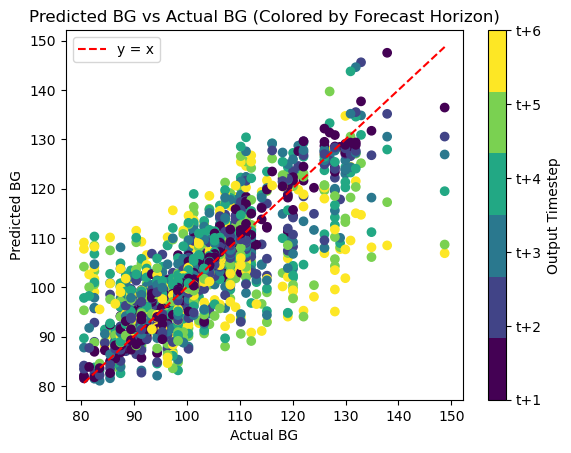


Running model for: id_36_data
Execution time: 56.548285245895386 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.8895242214202881 seconds
Execution time: 0.0006022453308105469 seconds
Execution time: 8.20159912109375e-05 seconds


Overall Train RMSE: 12.477603192918654 mg/DL
Overall Test RMSE: 11.268594610448877 mg/DL


Train RMSE at t+1: 6.50 mg/DL
Train RMSE at t+2: 7.86 mg/DL
Train RMSE at t+3: 10.75 mg/DL
Train RMSE at t+4: 13.06 mg/DL
Train RMSE at t+5: 15.56 mg/DL
Train RMSE at t+6: 17.38 mg/DL


Test RMSE at t+1: 6.04 mg/DL
Test RMSE at t+2: 7.29 mg/DL
Test RMSE at t+3: 9.77 mg/DL
Test RMSE at t+4: 11.78 mg/DL
Test RMSE at t+5: 13.89 mg/DL
Test RMSE at t+6: 15.65 mg/DL


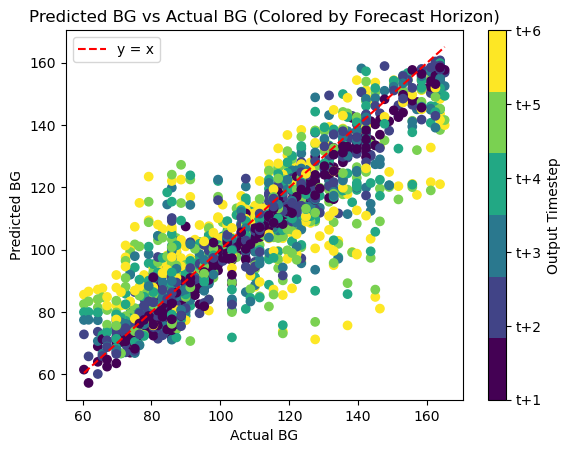


Running model for: id_37_data
Execution time: 45.199755907058716 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.8949177265167236 seconds
Execution time: 0.000598907470703125 seconds
Execution time: 7.891654968261719e-05 seconds


Overall Train RMSE: 6.658643097584014 mg/DL
Overall Test RMSE: 11.256355547826905 mg/DL


Train RMSE at t+1: 3.26 mg/DL
Train RMSE at t+2: 4.73 mg/DL
Train RMSE at t+3: 5.05 mg/DL
Train RMSE at t+4: 6.54 mg/DL
Train RMSE at t+5: 8.30 mg/DL
Train RMSE at t+6: 9.79 mg/DL


Test RMSE at t+1: 4.75 mg/DL
Test RMSE at t+2: 7.52 mg/DL
Test RMSE at t+3: 9.54 mg/DL
Test RMSE at t+4: 11.76 mg/DL
Test RMSE at t+5: 14.05 mg/DL
Test RMSE at t+6: 15.95 mg/DL


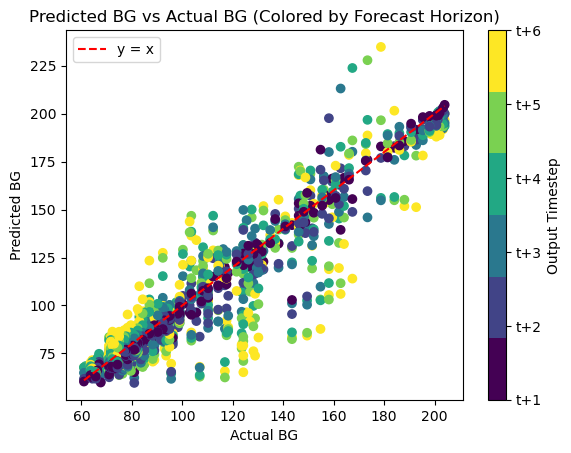


Running model for: id_38_data
Execution time: 57.14836668968201 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.879040002822876 seconds
Execution time: 0.0006673336029052734 seconds
Execution time: 0.00015497207641601562 seconds


Overall Train RMSE: 11.755849278494717 mg/DL
Overall Test RMSE: 10.813536163243258 mg/DL


Train RMSE at t+1: 6.79 mg/DL
Train RMSE at t+2: 8.83 mg/DL
Train RMSE at t+3: 11.46 mg/DL
Train RMSE at t+4: 13.46 mg/DL
Train RMSE at t+5: 13.57 mg/DL
Train RMSE at t+6: 14.45 mg/DL


Test RMSE at t+1: 5.90 mg/DL
Test RMSE at t+2: 7.68 mg/DL
Test RMSE at t+3: 10.58 mg/DL
Test RMSE at t+4: 12.58 mg/DL
Test RMSE at t+5: 12.55 mg/DL
Test RMSE at t+6: 13.42 mg/DL


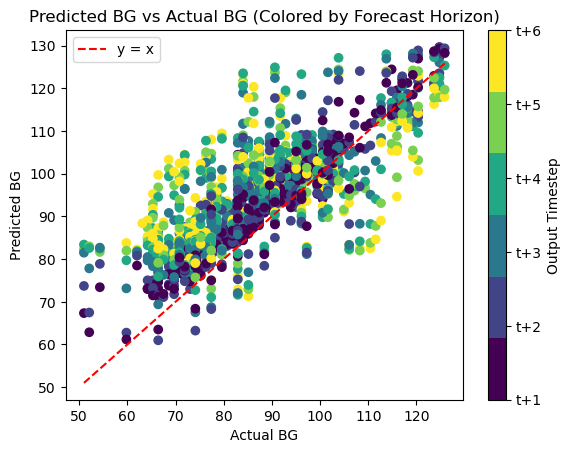


Running model for: id_39_data
Execution time: 55.148951053619385 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8857111930847168 seconds
Execution time: 0.0005970001220703125 seconds
Execution time: 8.511543273925781e-05 seconds


Overall Train RMSE: 11.982439788290732 mg/DL
Overall Test RMSE: 14.747480636331128 mg/DL


Train RMSE at t+1: 6.78 mg/DL
Train RMSE at t+2: 8.55 mg/DL
Train RMSE at t+3: 10.60 mg/DL
Train RMSE at t+4: 13.16 mg/DL
Train RMSE at t+5: 14.20 mg/DL
Train RMSE at t+6: 15.98 mg/DL


Test RMSE at t+1: 7.57 mg/DL
Test RMSE at t+2: 9.94 mg/DL
Test RMSE at t+3: 12.79 mg/DL
Test RMSE at t+4: 15.83 mg/DL
Test RMSE at t+5: 17.92 mg/DL
Test RMSE at t+6: 20.34 mg/DL


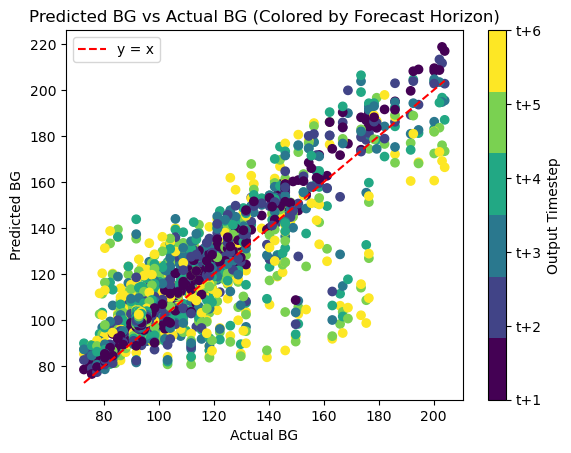


Running model for: id_40_data
Execution time: 58.56669807434082 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.902169942855835 seconds
Execution time: 0.0005939006805419922 seconds
Execution time: 8.130073547363281e-05 seconds


Overall Train RMSE: 9.13113873010336 mg/DL
Overall Test RMSE: 13.065527694376126 mg/DL


Train RMSE at t+1: 4.74 mg/DL
Train RMSE at t+2: 5.86 mg/DL
Train RMSE at t+3: 7.52 mg/DL
Train RMSE at t+4: 9.48 mg/DL
Train RMSE at t+5: 11.15 mg/DL
Train RMSE at t+6: 13.14 mg/DL


Test RMSE at t+1: 5.71 mg/DL
Test RMSE at t+2: 7.07 mg/DL
Test RMSE at t+3: 9.90 mg/DL
Test RMSE at t+4: 13.30 mg/DL
Test RMSE at t+5: 16.57 mg/DL
Test RMSE at t+6: 19.81 mg/DL


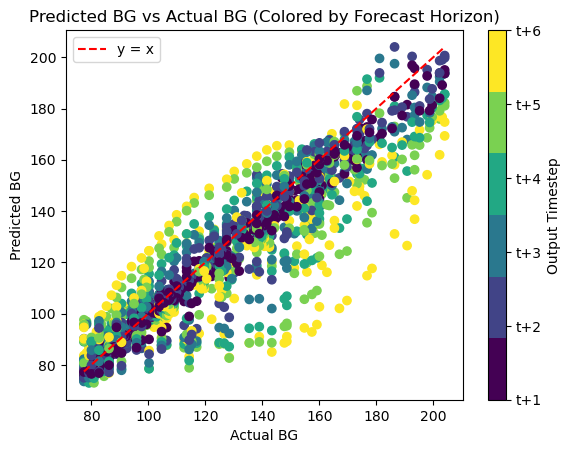


Running model for: id_41_data
Execution time: 57.272562980651855 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.8955650329589844 seconds
Execution time: 0.0005578994750976562 seconds
Execution time: 8.296966552734375e-05 seconds


Overall Train RMSE: 10.094627523769697 mg/DL
Overall Test RMSE: 11.229103696323953 mg/DL


Train RMSE at t+1: 4.22 mg/DL
Train RMSE at t+2: 6.15 mg/DL
Train RMSE at t+3: 8.40 mg/DL
Train RMSE at t+4: 10.64 mg/DL
Train RMSE at t+5: 12.82 mg/DL
Train RMSE at t+6: 14.41 mg/DL


Test RMSE at t+1: 5.15 mg/DL
Test RMSE at t+2: 7.33 mg/DL
Test RMSE at t+3: 9.62 mg/DL
Test RMSE at t+4: 12.01 mg/DL
Test RMSE at t+5: 14.04 mg/DL
Test RMSE at t+6: 15.57 mg/DL


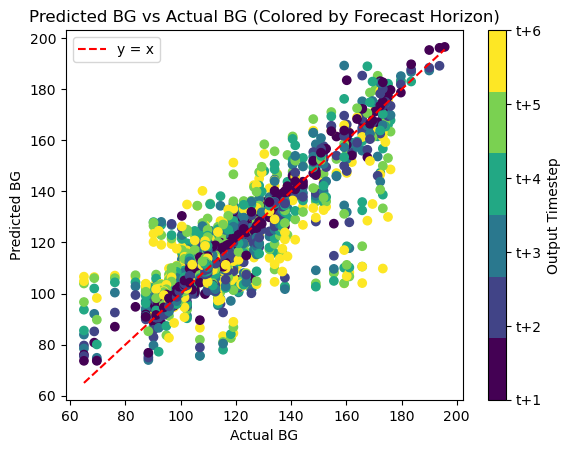


Running model for: id_42_data
Execution time: 56.96516013145447 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.7242450714111328 seconds
Execution time: 0.0005788803100585938 seconds
Execution time: 0.0001270771026611328 seconds


Overall Train RMSE: 12.190382781590731 mg/DL
Overall Test RMSE: 13.64180015762871 mg/DL


Train RMSE at t+1: 5.56 mg/DL
Train RMSE at t+2: 7.89 mg/DL
Train RMSE at t+3: 10.75 mg/DL
Train RMSE at t+4: 13.54 mg/DL
Train RMSE at t+5: 14.81 mg/DL
Train RMSE at t+6: 16.74 mg/DL


Test RMSE at t+1: 5.99 mg/DL
Test RMSE at t+2: 8.68 mg/DL
Test RMSE at t+3: 11.03 mg/DL
Test RMSE at t+4: 15.27 mg/DL
Test RMSE at t+5: 16.48 mg/DL
Test RMSE at t+6: 19.47 mg/DL


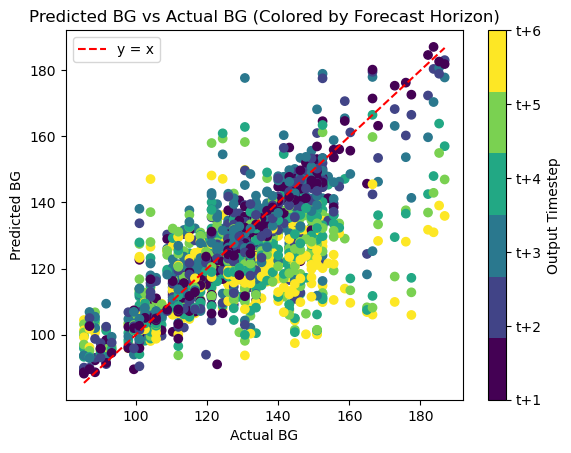


Running model for: id_43_data
Execution time: 45.475390911102295 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8988182544708252 seconds
Execution time: 0.0006291866302490234 seconds
Execution time: 8.606910705566406e-05 seconds


Overall Train RMSE: 10.099891791418802 mg/DL
Overall Test RMSE: 10.010554178574376 mg/DL


Train RMSE at t+1: 4.61 mg/DL
Train RMSE at t+2: 6.78 mg/DL
Train RMSE at t+3: 8.91 mg/DL
Train RMSE at t+4: 10.59 mg/DL
Train RMSE at t+5: 12.55 mg/DL
Train RMSE at t+6: 14.00 mg/DL


Test RMSE at t+1: 4.07 mg/DL
Test RMSE at t+2: 6.40 mg/DL
Test RMSE at t+3: 8.90 mg/DL
Test RMSE at t+4: 10.28 mg/DL
Test RMSE at t+5: 12.76 mg/DL
Test RMSE at t+6: 14.00 mg/DL


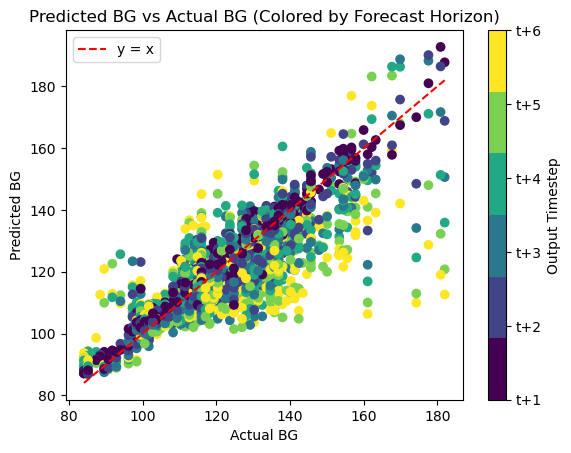


Running model for: id_44_data
Execution time: 61.37549114227295 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
Execution time: 1.0141241550445557 seconds
Execution time: 0.000675201416015625 seconds
Execution time: 8.606910705566406e-05 seconds


Overall Train RMSE: 42.034982566044185 mg/DL
Overall Test RMSE: 7.749968889758783 mg/DL


Train RMSE at t+1: 15.28 mg/DL
Train RMSE at t+2: 14.60 mg/DL
Train RMSE at t+3: 59.90 mg/DL
Train RMSE at t+4: 38.29 mg/DL
Train RMSE at t+5: 56.40 mg/DL
Train RMSE at t+6: 43.83 mg/DL


Test RMSE at t+1: 3.78 mg/DL
Test RMSE at t+2: 5.59 mg/DL
Test RMSE at t+3: 7.19 mg/DL
Test RMSE at t+4: 8.91 mg/DL
Test RMSE at t+5: 9.36 mg/DL
Test RMSE at t+6: 9.81 mg/DL


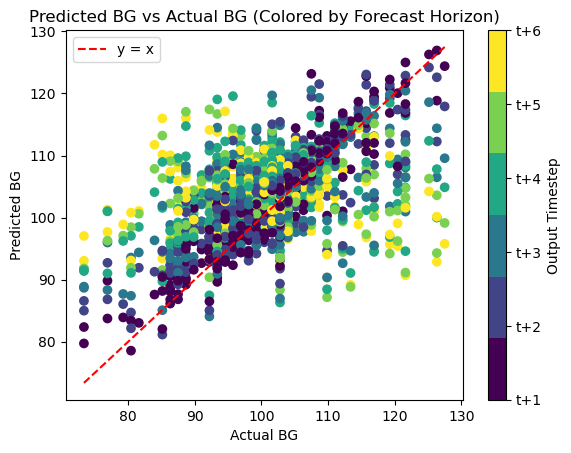


Running model for: id_45_data
Execution time: 63.206169843673706 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.9581019878387451 seconds
Execution time: 0.0006258487701416016 seconds
Execution time: 8.0108642578125e-05 seconds


Overall Train RMSE: 11.87485189247868 mg/DL
Overall Test RMSE: 11.205009412041392 mg/DL


Train RMSE at t+1: 6.72 mg/DL
Train RMSE at t+2: 8.91 mg/DL
Train RMSE at t+3: 10.86 mg/DL
Train RMSE at t+4: 12.86 mg/DL
Train RMSE at t+5: 14.19 mg/DL
Train RMSE at t+6: 15.39 mg/DL


Test RMSE at t+1: 7.05 mg/DL
Test RMSE at t+2: 9.29 mg/DL
Test RMSE at t+3: 10.81 mg/DL
Test RMSE at t+4: 12.45 mg/DL
Test RMSE at t+5: 12.75 mg/DL
Test RMSE at t+6: 13.53 mg/DL


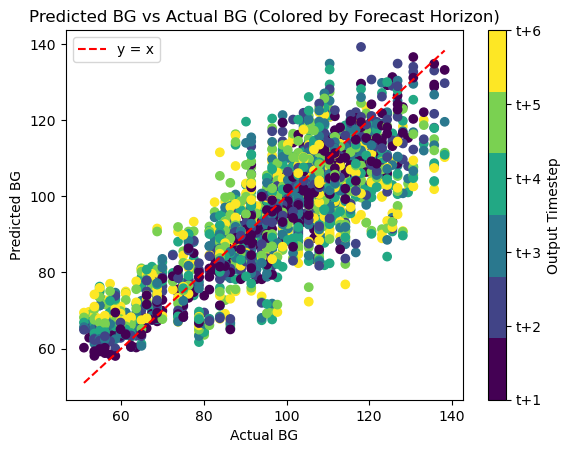


Running model for: id_46_data
Execution time: 62.15011787414551 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 1.050374984741211 seconds
Execution time: 0.0005691051483154297 seconds
Execution time: 0.0001232624053955078 seconds


Overall Train RMSE: 9.717205799804756 mg/DL
Overall Test RMSE: 10.80955006716759 mg/DL


Train RMSE at t+1: 3.52 mg/DL
Train RMSE at t+2: 6.17 mg/DL
Train RMSE at t+3: 8.35 mg/DL
Train RMSE at t+4: 10.13 mg/DL
Train RMSE at t+5: 12.11 mg/DL
Train RMSE at t+6: 14.04 mg/DL


Test RMSE at t+1: 5.09 mg/DL
Test RMSE at t+2: 7.19 mg/DL
Test RMSE at t+3: 9.50 mg/DL
Test RMSE at t+4: 11.24 mg/DL
Test RMSE at t+5: 14.04 mg/DL
Test RMSE at t+6: 14.48 mg/DL


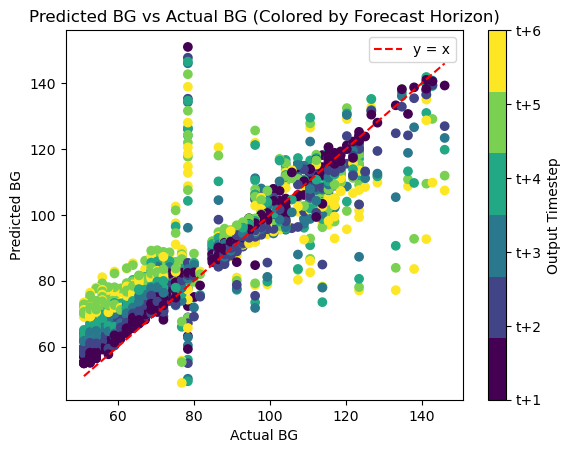


Running model for: id_47_data
Execution time: 63.86368489265442 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 1.016045093536377 seconds
Execution time: 0.0007429122924804688 seconds
Execution time: 0.0001571178436279297 seconds


Overall Train RMSE: 13.567431990731354 mg/DL
Overall Test RMSE: 9.488902695549376 mg/DL


Train RMSE at t+1: 6.37 mg/DL
Train RMSE at t+2: 9.54 mg/DL
Train RMSE at t+3: 12.48 mg/DL
Train RMSE at t+4: 14.93 mg/DL
Train RMSE at t+5: 16.57 mg/DL
Train RMSE at t+6: 17.89 mg/DL


Test RMSE at t+1: 5.06 mg/DL
Test RMSE at t+2: 6.75 mg/DL
Test RMSE at t+3: 8.51 mg/DL
Test RMSE at t+4: 10.12 mg/DL
Test RMSE at t+5: 11.26 mg/DL
Test RMSE at t+6: 12.94 mg/DL


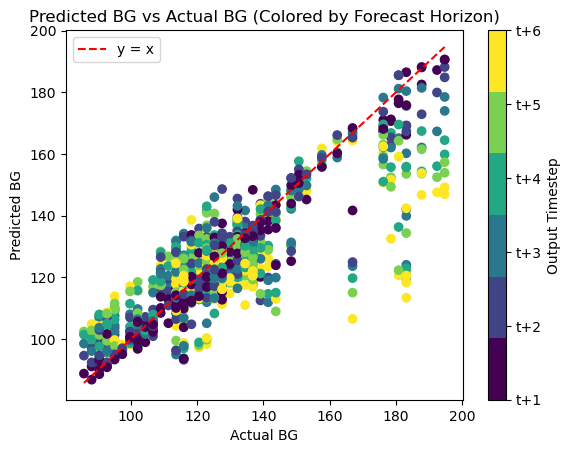


Running model for: id_48_data
Execution time: 56.22195100784302 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.885059118270874 seconds
Execution time: 0.0005860328674316406 seconds
Execution time: 0.00015735626220703125 seconds


Overall Train RMSE: 12.366456138820048 mg/DL
Overall Test RMSE: 8.957484773062228 mg/DL


Train RMSE at t+1: 6.34 mg/DL
Train RMSE at t+2: 9.09 mg/DL
Train RMSE at t+3: 11.62 mg/DL
Train RMSE at t+4: 13.59 mg/DL
Train RMSE at t+5: 14.93 mg/DL
Train RMSE at t+6: 15.88 mg/DL


Test RMSE at t+1: 4.21 mg/DL
Test RMSE at t+2: 6.35 mg/DL
Test RMSE at t+3: 8.26 mg/DL
Test RMSE at t+4: 9.95 mg/DL
Test RMSE at t+5: 10.89 mg/DL
Test RMSE at t+6: 11.72 mg/DL


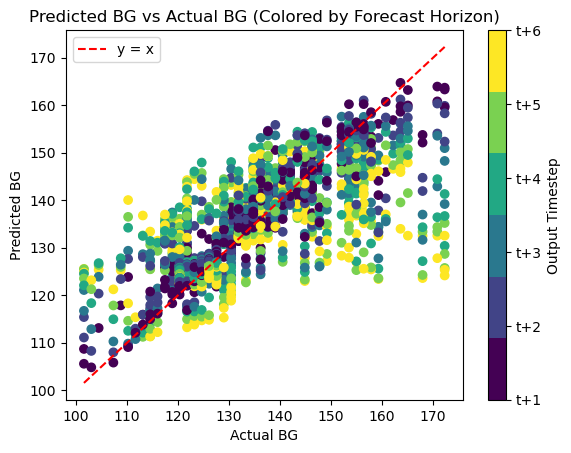


Running model for: id_49_data
Execution time: 56.31463813781738 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8732450008392334 seconds
Execution time: 0.0005869865417480469 seconds
Execution time: 7.987022399902344e-05 seconds


Overall Train RMSE: 14.316474882806178 mg/DL
Overall Test RMSE: 15.701041044798023 mg/DL


Train RMSE at t+1: 5.25 mg/DL
Train RMSE at t+2: 9.33 mg/DL
Train RMSE at t+3: 12.41 mg/DL
Train RMSE at t+4: 14.98 mg/DL
Train RMSE at t+5: 18.55 mg/DL
Train RMSE at t+6: 19.81 mg/DL


Test RMSE at t+1: 6.33 mg/DL
Test RMSE at t+2: 10.29 mg/DL
Test RMSE at t+3: 13.38 mg/DL
Test RMSE at t+4: 16.27 mg/DL
Test RMSE at t+5: 20.12 mg/DL
Test RMSE at t+6: 22.02 mg/DL


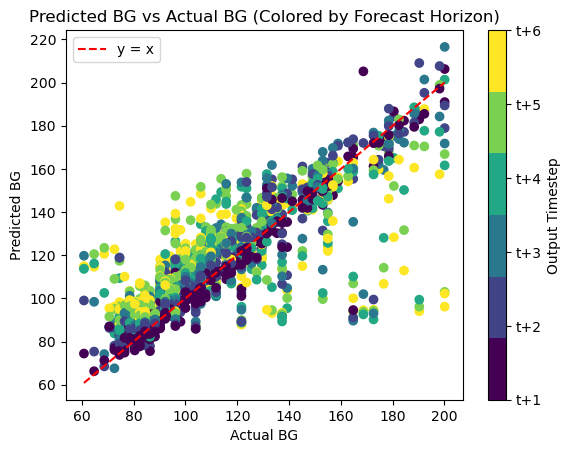


Running model for: id_50_data
Execution time: 57.91926884651184 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.9176528453826904 seconds
Execution time: 0.0004868507385253906 seconds
Execution time: 7.510185241699219e-05 seconds


Overall Train RMSE: 12.580412158587357 mg/DL
Overall Test RMSE: 12.99769136892171 mg/DL


Train RMSE at t+1: 5.59 mg/DL
Train RMSE at t+2: 8.83 mg/DL
Train RMSE at t+3: 11.64 mg/DL
Train RMSE at t+4: 13.77 mg/DL
Train RMSE at t+5: 15.47 mg/DL
Train RMSE at t+6: 16.62 mg/DL


Test RMSE at t+1: 5.03 mg/DL
Test RMSE at t+2: 8.32 mg/DL
Test RMSE at t+3: 12.26 mg/DL
Test RMSE at t+4: 14.51 mg/DL
Test RMSE at t+5: 16.16 mg/DL
Test RMSE at t+6: 17.23 mg/DL


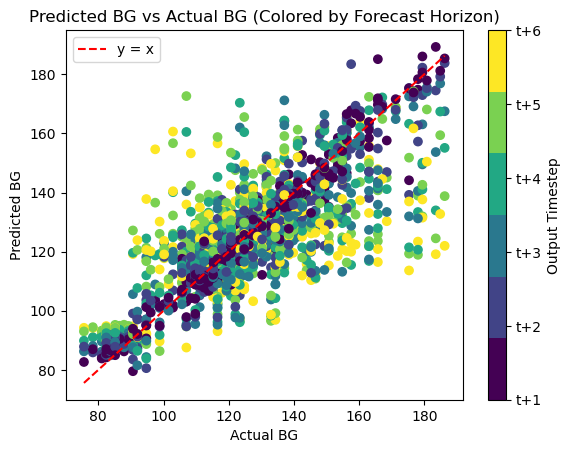


Running model for: id_51_data
Execution time: 54.99471402168274 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.906304121017456 seconds
Execution time: 0.0005810260772705078 seconds
Execution time: 8.893013000488281e-05 seconds


Overall Train RMSE: 10.279699879973634 mg/DL
Overall Test RMSE: 10.950292657075671 mg/DL


Train RMSE at t+1: 5.21 mg/DL
Train RMSE at t+2: 7.83 mg/DL
Train RMSE at t+3: 9.36 mg/DL
Train RMSE at t+4: 10.74 mg/DL
Train RMSE at t+5: 12.30 mg/DL
Train RMSE at t+6: 13.84 mg/DL


Test RMSE at t+1: 6.03 mg/DL
Test RMSE at t+2: 8.76 mg/DL
Test RMSE at t+3: 10.02 mg/DL
Test RMSE at t+4: 11.49 mg/DL
Test RMSE at t+5: 12.73 mg/DL
Test RMSE at t+6: 14.56 mg/DL


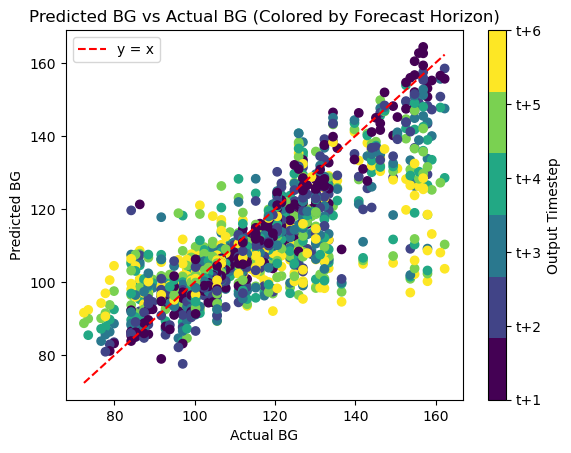


Running model for: id_52_data
Execution time: 56.59146785736084 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9013960361480713 seconds
Execution time: 0.0007250308990478516 seconds
Execution time: 9.012222290039062e-05 seconds


Overall Train RMSE: 10.646181308900493 mg/DL
Overall Test RMSE: 13.485848729526282 mg/DL


Train RMSE at t+1: 6.04 mg/DL
Train RMSE at t+2: 7.36 mg/DL
Train RMSE at t+3: 9.07 mg/DL
Train RMSE at t+4: 11.21 mg/DL
Train RMSE at t+5: 13.06 mg/DL
Train RMSE at t+6: 14.53 mg/DL


Test RMSE at t+1: 5.97 mg/DL
Test RMSE at t+2: 7.93 mg/DL
Test RMSE at t+3: 10.18 mg/DL
Test RMSE at t+4: 14.12 mg/DL
Test RMSE at t+5: 17.29 mg/DL
Test RMSE at t+6: 19.77 mg/DL


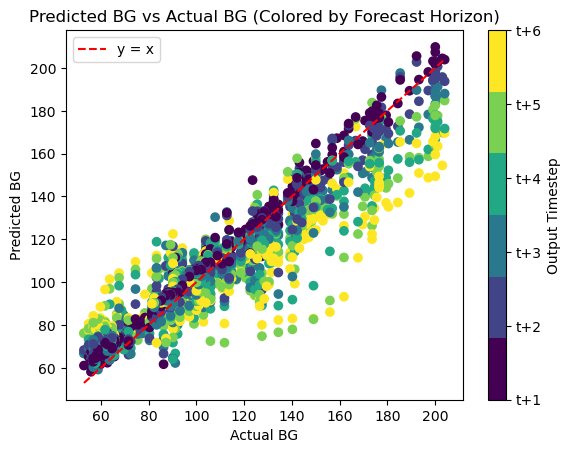


Running model for: id_53_data
Execution time: 58.407732009887695 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Execution time: 0.8916430473327637 seconds
Execution time: 0.0006170272827148438 seconds
Execution time: 0.00016307830810546875 seconds


Overall Train RMSE: 14.484309604962746 mg/DL
Overall Test RMSE: 12.353515777176524 mg/DL


Train RMSE at t+1: 5.50 mg/DL
Train RMSE at t+2: 9.07 mg/DL
Train RMSE at t+3: 12.93 mg/DL
Train RMSE at t+4: 15.62 mg/DL
Train RMSE at t+5: 18.27 mg/DL
Train RMSE at t+6: 20.03 mg/DL


Test RMSE at t+1: 5.35 mg/DL
Test RMSE at t+2: 7.60 mg/DL
Test RMSE at t+3: 11.38 mg/DL
Test RMSE at t+4: 11.96 mg/DL
Test RMSE at t+5: 15.47 mg/DL
Test RMSE at t+6: 17.81 mg/DL


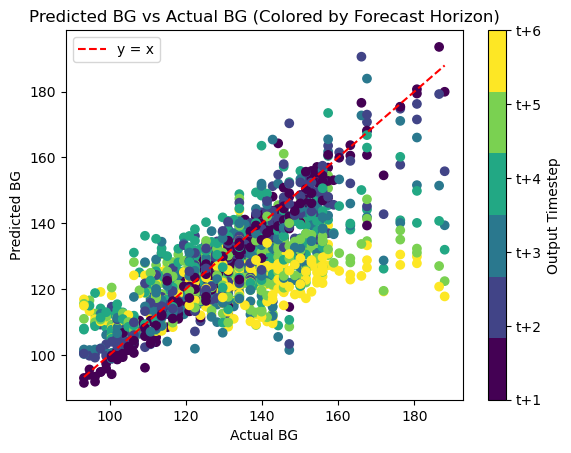


Running model for: id_54_data
Execution time: 46.82839918136597 seconds
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9790740013122559 seconds
Execution time: 0.00072479248046875 seconds
Execution time: 0.00021719932556152344 seconds


Overall Train RMSE: 13.492026665366032 mg/DL
Overall Test RMSE: 12.51290265746306 mg/DL


Train RMSE at t+1: 8.32 mg/DL
Train RMSE at t+2: 9.50 mg/DL
Train RMSE at t+3: 12.08 mg/DL
Train RMSE at t+4: 14.52 mg/DL
Train RMSE at t+5: 16.34 mg/DL
Train RMSE at t+6: 17.58 mg/DL


Test RMSE at t+1: 8.39 mg/DL
Test RMSE at t+2: 9.06 mg/DL
Test RMSE at t+3: 10.93 mg/DL
Test RMSE at t+4: 13.36 mg/DL
Test RMSE at t+5: 14.97 mg/DL
Test RMSE at t+6: 16.27 mg/DL


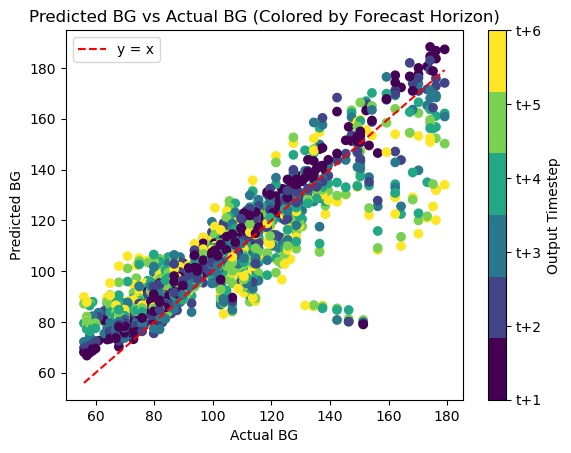


Running model for: id_55_data
Execution time: 59.802314043045044 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9048149585723877 seconds
Execution time: 0.0005409717559814453 seconds
Execution time: 0.00016164779663085938 seconds


Overall Train RMSE: 9.88573102985386 mg/DL
Overall Test RMSE: 10.034845199975027 mg/DL


Train RMSE at t+1: 4.64 mg/DL
Train RMSE at t+2: 6.90 mg/DL
Train RMSE at t+3: 8.87 mg/DL
Train RMSE at t+4: 10.77 mg/DL
Train RMSE at t+5: 11.99 mg/DL
Train RMSE at t+6: 13.37 mg/DL


Test RMSE at t+1: 4.14 mg/DL
Test RMSE at t+2: 6.48 mg/DL
Test RMSE at t+3: 8.81 mg/DL
Test RMSE at t+4: 10.85 mg/DL
Test RMSE at t+5: 12.42 mg/DL
Test RMSE at t+6: 13.99 mg/DL


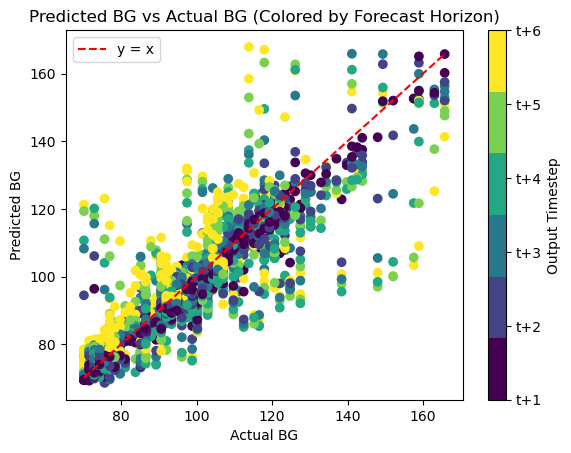


Running model for: id_56_data
Execution time: 57.07210373878479 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8973639011383057 seconds
Execution time: 0.0006020069122314453 seconds
Execution time: 7.987022399902344e-05 seconds


Overall Train RMSE: 11.047628290708435 mg/DL
Overall Test RMSE: 12.693930197562105 mg/DL


Train RMSE at t+1: 5.47 mg/DL
Train RMSE at t+2: 8.24 mg/DL
Train RMSE at t+3: 10.25 mg/DL
Train RMSE at t+4: 12.03 mg/DL
Train RMSE at t+5: 13.38 mg/DL
Train RMSE at t+6: 14.34 mg/DL


Test RMSE at t+1: 5.75 mg/DL
Test RMSE at t+2: 9.10 mg/DL
Test RMSE at t+3: 11.84 mg/DL
Test RMSE at t+4: 13.98 mg/DL
Test RMSE at t+5: 15.48 mg/DL
Test RMSE at t+6: 16.60 mg/DL


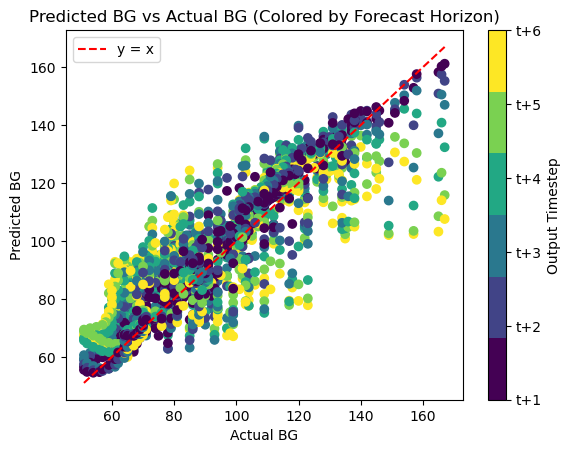

In [29]:
all_preds1 = []
all_truths1 = []
seq_length_in = 70 # Training on 350 mins of data (5.83 hours)
seq_length_out = 6 # 30 mins (~5 min interval each interation)
results1 = {}

for key, subset in normalized_data.items():
    print(f"\nRunning model for: {key}")
    
    try:
        preds, truths = RNN_indv(subset, seq_length_in, seq_length_out)
        all_preds1.append(preds)
        all_truths1.append(truths)
        results1[key] = (preds, truths)
    except Exception as e:
        print(f"Error for {key}: {e}")
        results1[key] = None


In [182]:
# Concatenate all predictions and truths
all_preds_concat1 = np.concatenate(all_preds1, axis=0).flatten()
all_truths_concat1 = np.concatenate(all_truths1, axis=0).flatten()

# Compute overall RMSE and MAE
combined_rmse1 = np.sqrt(mean_squared_error(all_truths_concat1, all_preds_concat1))
combined_mae1 = mean_absolute_error(all_truths_concat1, all_preds_concat1)

print(f"\nCombined RMSE across all IDs: {combined_rmse1:.2f} mg/dL")
print(f"Combined MAE  across all IDs: {combined_mae1:.2f} mg/dL\n")

# Lists to store RMSE and MAE per individual
rmse_per_individual = []
mae_per_individual = []

# Compute per-ID RMSE and MAE
for pred_array, true_array in zip(all_preds1, all_truths1):
    pred_flat = pred_array.flatten()
    true_flat = true_array.flatten()
    
    rmse = np.sqrt(mean_squared_error(true_flat, pred_flat))
    mae = mean_absolute_error(true_flat, pred_flat)
    
    rmse_per_individual.append(rmse)
    mae_per_individual.append(mae)

# Print all 56 RMSEs and MAEs
for i, (rmse, mae) in enumerate(zip(rmse_per_individual, mae_per_individual)):
    print(f"ID {i:2d}: RMSE = {rmse:.2f} mg/dL | MAE = {mae:.2f} mg/dL")

# Summary: min/max RMSE and MAE
print('\n')
print(f'The min RMSE is for ID {np.argmin(rmse_per_individual)} with a value of: {min(rmse_per_individual):.2f}')
print(f'The max RMSE is for ID {np.argmax(rmse_per_individual)} with a value of: {max(rmse_per_individual):.2f}')
print(f'The min MAE  is for ID {np.argmin(mae_per_individual)} with a value of: {min(mae_per_individual):.2f}')
print(f'The max MAE  is for ID {np.argmax(mae_per_individual)} with a value of: {max(mae_per_individual):.2f}')



Combined RMSE across all IDs: 12.82 mg/dL
Combined MAE  across all IDs: 8.45 mg/dL

ID  0: RMSE = 7.09 mg/dL | MAE = 4.68 mg/dL
ID  1: RMSE = 18.83 mg/dL | MAE = 11.36 mg/dL
ID  2: RMSE = 19.78 mg/dL | MAE = 12.41 mg/dL
ID  3: RMSE = 9.55 mg/dL | MAE = 7.32 mg/dL
ID  4: RMSE = 10.01 mg/dL | MAE = 6.64 mg/dL
ID  5: RMSE = 12.39 mg/dL | MAE = 9.24 mg/dL
ID  6: RMSE = 12.33 mg/dL | MAE = 9.11 mg/dL
ID  7: RMSE = 10.60 mg/dL | MAE = 7.16 mg/dL
ID  8: RMSE = 9.68 mg/dL | MAE = 6.91 mg/dL
ID  9: RMSE = 14.56 mg/dL | MAE = 9.36 mg/dL
ID 10: RMSE = 10.43 mg/dL | MAE = 6.81 mg/dL
ID 11: RMSE = 16.00 mg/dL | MAE = 10.36 mg/dL
ID 12: RMSE = 13.54 mg/dL | MAE = 10.48 mg/dL
ID 13: RMSE = 14.48 mg/dL | MAE = 10.58 mg/dL
ID 14: RMSE = 12.37 mg/dL | MAE = 9.01 mg/dL
ID 15: RMSE = 13.86 mg/dL | MAE = 10.10 mg/dL
ID 16: RMSE = 13.08 mg/dL | MAE = 8.50 mg/dL
ID 17: RMSE = 16.41 mg/dL | MAE = 12.10 mg/dL
ID 18: RMSE = 15.98 mg/dL | MAE = 10.74 mg/dL
ID 19: RMSE = 12.26 mg/dL | MAE = 8.69 mg/dL
ID 20: RMS


Running model for: id_0_data
Execution time: 48.54973793029785 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.837116003036499 seconds
Execution time: 0.0005700588226318359 seconds
Execution time: 7.987022399902344e-05 seconds


Overall Train RMSE: 9.134432471166514 mg/DL
Overall Test RMSE: 7.0869058543926835 mg/DL


Train RMSE at t+1: 4.07 mg/DL
Train RMSE at t+2: 5.38 mg/DL
Train RMSE at t+3: 7.18 mg/DL
Train RMSE at t+4: 9.41 mg/DL
Train RMSE at t+5: 11.86 mg/DL
Train RMSE at t+6: 13.20 mg/DL


Test RMSE at t+1: 3.36 mg/DL
Test RMSE at t+2: 4.45 mg/DL
Test RMSE at t+3: 5.83 mg/DL
Test RMSE at t+4: 7.52 mg/DL
Test RMSE at t+5: 8.83 mg/DL
Test RMSE at t+6: 10.09 mg/DL


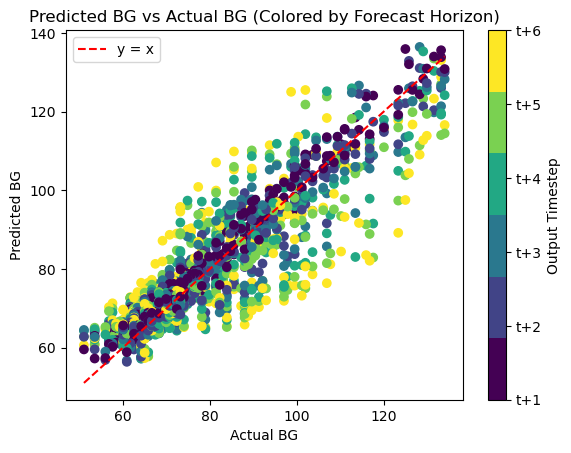


Running model for: id_1_data
Execution time: 49.47828507423401 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8188338279724121 seconds
Execution time: 0.0005872249603271484 seconds
Execution time: 0.00013899803161621094 seconds


Overall Train RMSE: 12.27185479776481 mg/DL
Overall Test RMSE: 18.187133051950436 mg/DL


Train RMSE at t+1: 5.29 mg/DL
Train RMSE at t+2: 7.68 mg/DL
Train RMSE at t+3: 10.55 mg/DL
Train RMSE at t+4: 12.79 mg/DL
Train RMSE at t+5: 15.55 mg/DL
Train RMSE at t+6: 17.32 mg/DL


Test RMSE at t+1: 10.42 mg/DL
Test RMSE at t+2: 14.83 mg/DL
Test RMSE at t+3: 18.05 mg/DL
Test RMSE at t+4: 19.84 mg/DL
Test RMSE at t+5: 21.52 mg/DL
Test RMSE at t+6: 21.77 mg/DL


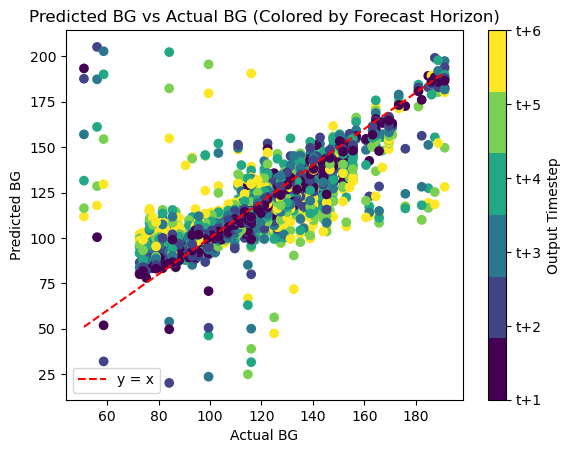


Running model for: id_2_data
Execution time: 48.546815156936646 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8245770931243896 seconds
Execution time: 0.0005886554718017578 seconds
Execution time: 8.511543273925781e-05 seconds


Overall Train RMSE: 8.122246065713522 mg/DL
Overall Test RMSE: 17.154794426069156 mg/DL


Train RMSE at t+1: 4.17 mg/DL
Train RMSE at t+2: 6.01 mg/DL
Train RMSE at t+3: 7.59 mg/DL
Train RMSE at t+4: 8.89 mg/DL
Train RMSE at t+5: 9.94 mg/DL
Train RMSE at t+6: 10.34 mg/DL


Test RMSE at t+1: 9.72 mg/DL
Test RMSE at t+2: 13.60 mg/DL
Test RMSE at t+3: 16.22 mg/DL
Test RMSE at t+4: 18.65 mg/DL
Test RMSE at t+5: 20.12 mg/DL
Test RMSE at t+6: 21.69 mg/DL


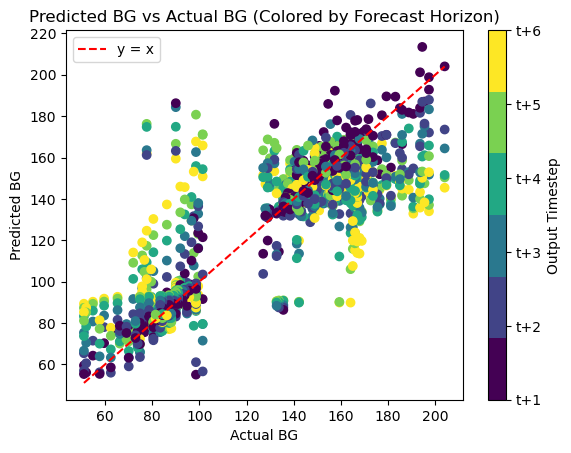


Running model for: id_3_data
Execution time: 50.29539895057678 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8213679790496826 seconds
Execution time: 0.0005462169647216797 seconds
Execution time: 0.00012230873107910156 seconds


Overall Train RMSE: 9.964604521093033 mg/DL
Overall Test RMSE: 10.667214834782124 mg/DL


Train RMSE at t+1: 6.23 mg/DL
Train RMSE at t+2: 8.16 mg/DL
Train RMSE at t+3: 9.66 mg/DL
Train RMSE at t+4: 10.67 mg/DL
Train RMSE at t+5: 11.49 mg/DL
Train RMSE at t+6: 12.29 mg/DL


Test RMSE at t+1: 6.17 mg/DL
Test RMSE at t+2: 8.27 mg/DL
Test RMSE at t+3: 10.08 mg/DL
Test RMSE at t+4: 11.45 mg/DL
Test RMSE at t+5: 12.63 mg/DL
Test RMSE at t+6: 13.56 mg/DL


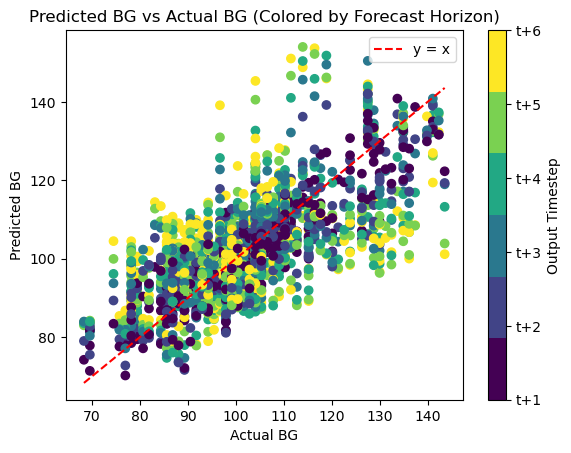


Running model for: id_4_data
Execution time: 50.75205898284912 seconds
53/53 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.9146008491516113 seconds
Execution time: 0.0006098747253417969 seconds
Execution time: 8.606910705566406e-05 seconds


Overall Train RMSE: 11.191476426285238 mg/DL
Overall Test RMSE: 9.814197030782438 mg/DL


Train RMSE at t+1: 5.14 mg/DL
Train RMSE at t+2: 7.70 mg/DL
Train RMSE at t+3: 10.11 mg/DL
Train RMSE at t+4: 12.12 mg/DL
Train RMSE at t+5: 13.68 mg/DL
Train RMSE at t+6: 15.15 mg/DL


Test RMSE at t+1: 4.54 mg/DL
Test RMSE at t+2: 7.08 mg/DL
Test RMSE at t+3: 8.69 mg/DL
Test RMSE at t+4: 10.18 mg/DL
Test RMSE at t+5: 12.22 mg/DL
Test RMSE at t+6: 13.36 mg/DL


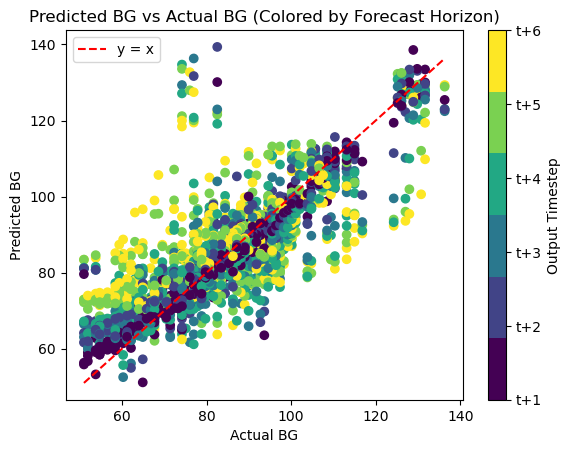


Running model for: id_5_data
Execution time: 48.85940098762512 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8124120235443115 seconds
Execution time: 0.0005612373352050781 seconds
Execution time: 0.00012087821960449219 seconds


Overall Train RMSE: 16.578617343416628 mg/DL
Overall Test RMSE: 12.82396750517587 mg/DL


Train RMSE at t+1: 11.97 mg/DL
Train RMSE at t+2: 13.50 mg/DL
Train RMSE at t+3: 15.28 mg/DL
Train RMSE at t+4: 17.85 mg/DL
Train RMSE at t+5: 18.93 mg/DL
Train RMSE at t+6: 20.33 mg/DL


Test RMSE at t+1: 11.29 mg/DL
Test RMSE at t+2: 11.64 mg/DL
Test RMSE at t+3: 12.36 mg/DL
Test RMSE at t+4: 13.52 mg/DL
Test RMSE at t+5: 13.42 mg/DL
Test RMSE at t+6: 14.42 mg/DL


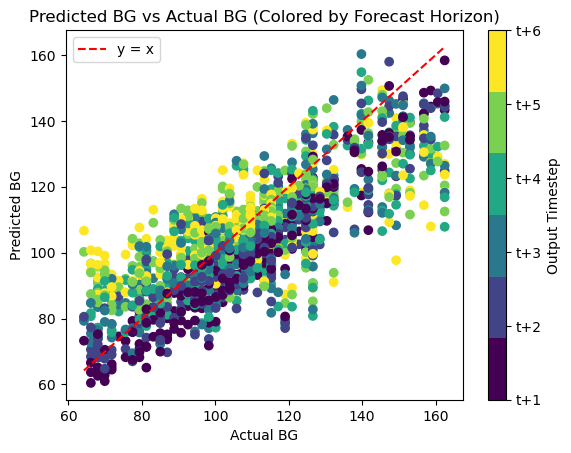


Running model for: id_6_data
Execution time: 39.110739946365356 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.856666088104248 seconds
Execution time: 0.0005910396575927734 seconds
Execution time: 0.00012111663818359375 seconds


Overall Train RMSE: 9.414069673629955 mg/DL
Overall Test RMSE: 11.268502290753512 mg/DL


Train RMSE at t+1: 4.80 mg/DL
Train RMSE at t+2: 6.45 mg/DL
Train RMSE at t+3: 7.94 mg/DL
Train RMSE at t+4: 9.78 mg/DL
Train RMSE at t+5: 11.75 mg/DL
Train RMSE at t+6: 13.06 mg/DL


Test RMSE at t+1: 6.87 mg/DL
Test RMSE at t+2: 8.90 mg/DL
Test RMSE at t+3: 10.33 mg/DL
Test RMSE at t+4: 11.45 mg/DL
Test RMSE at t+5: 13.84 mg/DL
Test RMSE at t+6: 14.36 mg/DL


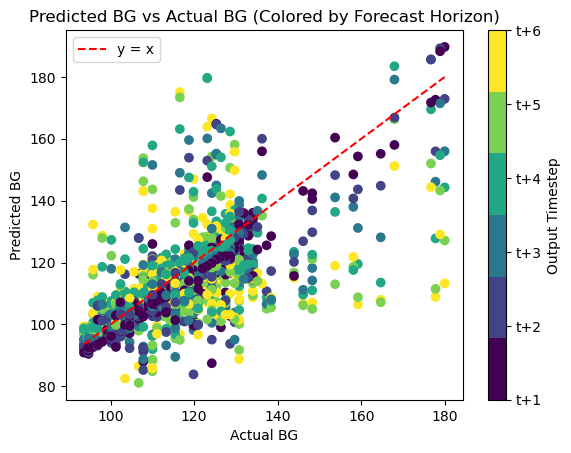


Running model for: id_7_data
Execution time: 47.84198188781738 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8232450485229492 seconds
Execution time: 0.0005371570587158203 seconds
Execution time: 8.273124694824219e-05 seconds


Overall Train RMSE: 12.796524695685331 mg/DL
Overall Test RMSE: 11.925709307415596 mg/DL


Train RMSE at t+1: 6.04 mg/DL
Train RMSE at t+2: 9.25 mg/DL
Train RMSE at t+3: 11.75 mg/DL
Train RMSE at t+4: 14.11 mg/DL
Train RMSE at t+5: 15.58 mg/DL
Train RMSE at t+6: 16.75 mg/DL


Test RMSE at t+1: 4.81 mg/DL
Test RMSE at t+2: 8.27 mg/DL
Test RMSE at t+3: 10.59 mg/DL
Test RMSE at t+4: 13.44 mg/DL
Test RMSE at t+5: 14.83 mg/DL
Test RMSE at t+6: 15.78 mg/DL


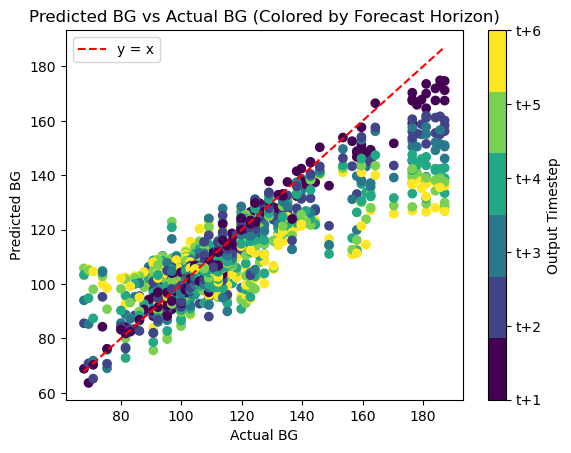


Running model for: id_8_data
Execution time: 48.19960808753967 seconds
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.7692480087280273 seconds
Execution time: 0.0006299018859863281 seconds
Execution time: 7.796287536621094e-05 seconds


Overall Train RMSE: 10.665960559705606 mg/DL
Overall Test RMSE: 9.566320213940225 mg/DL


Train RMSE at t+1: 4.30 mg/DL
Train RMSE at t+2: 7.23 mg/DL
Train RMSE at t+3: 9.40 mg/DL
Train RMSE at t+4: 11.62 mg/DL
Train RMSE at t+5: 13.25 mg/DL
Train RMSE at t+6: 14.60 mg/DL


Test RMSE at t+1: 3.94 mg/DL
Test RMSE at t+2: 6.62 mg/DL
Test RMSE at t+3: 8.62 mg/DL
Test RMSE at t+4: 10.50 mg/DL
Test RMSE at t+5: 11.83 mg/DL
Test RMSE at t+6: 12.85 mg/DL


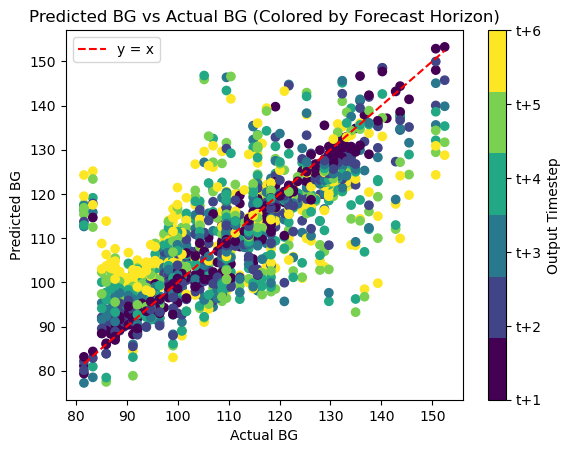


Running model for: id_9_data
Execution time: 50.49827790260315 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8372890949249268 seconds
Execution time: 0.0006017684936523438 seconds
Execution time: 0.0001652240753173828 seconds


Overall Train RMSE: 11.939792713730121 mg/DL
Overall Test RMSE: 14.88718070977394 mg/DL


Train RMSE at t+1: 5.12 mg/DL
Train RMSE at t+2: 8.12 mg/DL
Train RMSE at t+3: 10.49 mg/DL
Train RMSE at t+4: 12.59 mg/DL
Train RMSE at t+5: 15.04 mg/DL
Train RMSE at t+6: 16.38 mg/DL


Test RMSE at t+1: 7.65 mg/DL
Test RMSE at t+2: 10.95 mg/DL
Test RMSE at t+3: 13.79 mg/DL
Test RMSE at t+4: 15.67 mg/DL
Test RMSE at t+5: 18.17 mg/DL
Test RMSE at t+6: 19.64 mg/DL


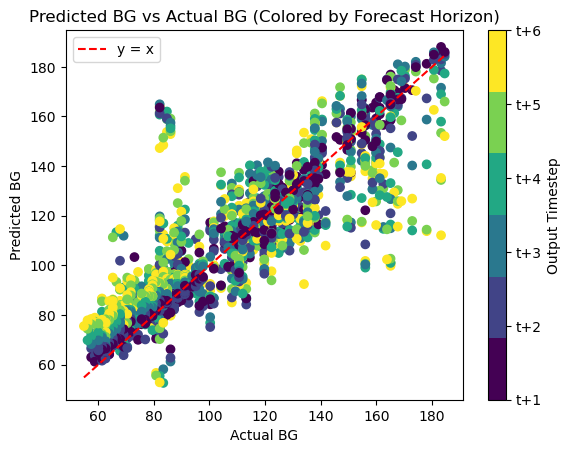


Running model for: id_10_data
Execution time: 48.433873891830444 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8304660320281982 seconds
Execution time: 0.0006227493286132812 seconds
Execution time: 8.511543273925781e-05 seconds


Overall Train RMSE: 11.424405247246286 mg/DL
Overall Test RMSE: 11.617649179075784 mg/DL


Train RMSE at t+1: 5.10 mg/DL
Train RMSE at t+2: 7.78 mg/DL
Train RMSE at t+3: 9.87 mg/DL
Train RMSE at t+4: 12.16 mg/DL
Train RMSE at t+5: 14.11 mg/DL
Train RMSE at t+6: 15.87 mg/DL


Test RMSE at t+1: 4.49 mg/DL
Test RMSE at t+2: 7.37 mg/DL
Test RMSE at t+3: 8.92 mg/DL
Test RMSE at t+4: 12.12 mg/DL
Test RMSE at t+5: 14.52 mg/DL
Test RMSE at t+6: 17.26 mg/DL


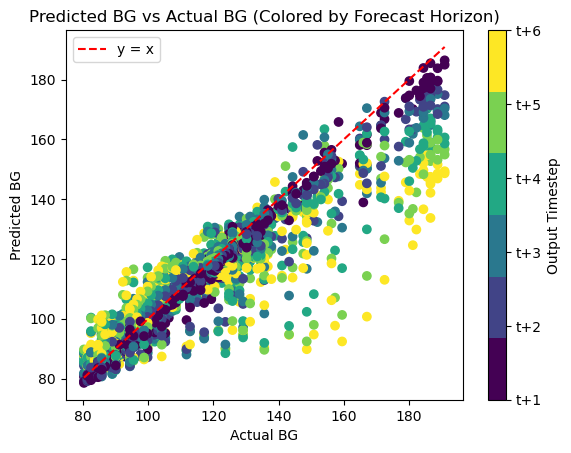


Running model for: id_11_data
Execution time: 48.34617304801941 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8324320316314697 seconds
Execution time: 0.0006089210510253906 seconds
Execution time: 0.00013327598571777344 seconds


Overall Train RMSE: 9.778108505915913 mg/DL
Overall Test RMSE: 15.252915846796489 mg/DL


Train RMSE at t+1: 5.15 mg/DL
Train RMSE at t+2: 7.09 mg/DL
Train RMSE at t+3: 9.17 mg/DL
Train RMSE at t+4: 10.34 mg/DL
Train RMSE at t+5: 11.63 mg/DL
Train RMSE at t+6: 13.06 mg/DL


Test RMSE at t+1: 7.88 mg/DL
Test RMSE at t+2: 11.03 mg/DL
Test RMSE at t+3: 14.20 mg/DL
Test RMSE at t+4: 16.09 mg/DL
Test RMSE at t+5: 18.41 mg/DL
Test RMSE at t+6: 20.32 mg/DL


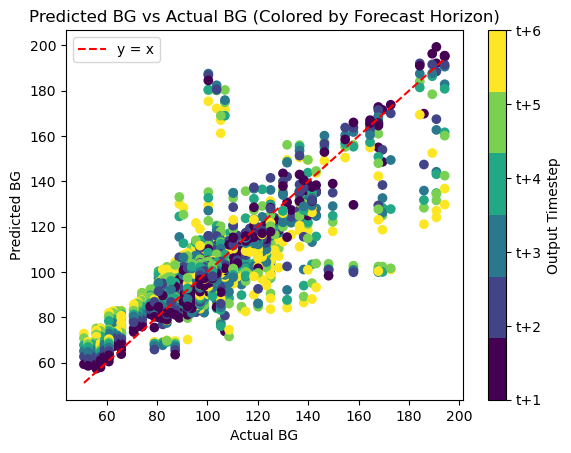


Running model for: id_12_data
Execution time: 51.59305191040039 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8477611541748047 seconds
Execution time: 0.0006167888641357422 seconds
Execution time: 0.0001621246337890625 seconds


Overall Train RMSE: 9.459001894069086 mg/DL
Overall Test RMSE: 12.109371496383455 mg/DL


Train RMSE at t+1: 4.96 mg/DL
Train RMSE at t+2: 7.23 mg/DL
Train RMSE at t+3: 8.59 mg/DL
Train RMSE at t+4: 10.24 mg/DL
Train RMSE at t+5: 11.51 mg/DL
Train RMSE at t+6: 12.20 mg/DL


Test RMSE at t+1: 7.04 mg/DL
Test RMSE at t+2: 9.53 mg/DL
Test RMSE at t+3: 11.22 mg/DL
Test RMSE at t+4: 12.51 mg/DL
Test RMSE at t+5: 14.52 mg/DL
Test RMSE at t+6: 15.68 mg/DL


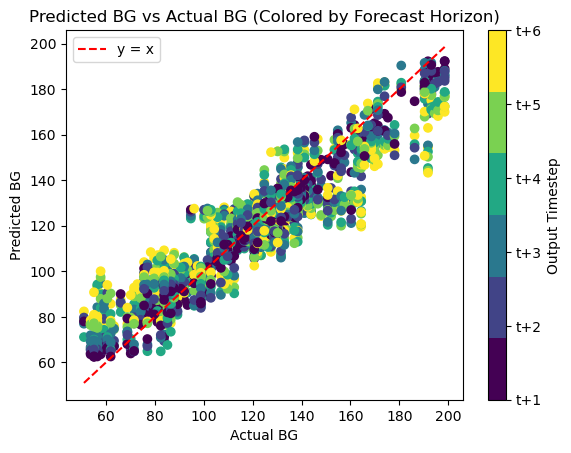


Running model for: id_13_data
Execution time: 50.55896806716919 seconds
58/58 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.9680509567260742 seconds
Execution time: 0.0006299018859863281 seconds
Execution time: 9.131431579589844e-05 seconds


Overall Train RMSE: 13.616848006563353 mg/DL
Overall Test RMSE: 14.52110974124456 mg/DL


Train RMSE at t+1: 6.49 mg/DL
Train RMSE at t+2: 10.07 mg/DL
Train RMSE at t+3: 12.45 mg/DL
Train RMSE at t+4: 14.83 mg/DL
Train RMSE at t+5: 16.72 mg/DL
Train RMSE at t+6: 17.74 mg/DL


Test RMSE at t+1: 6.92 mg/DL
Test RMSE at t+2: 10.49 mg/DL
Test RMSE at t+3: 13.04 mg/DL
Test RMSE at t+4: 15.70 mg/DL
Test RMSE at t+5: 18.08 mg/DL
Test RMSE at t+6: 19.07 mg/DL


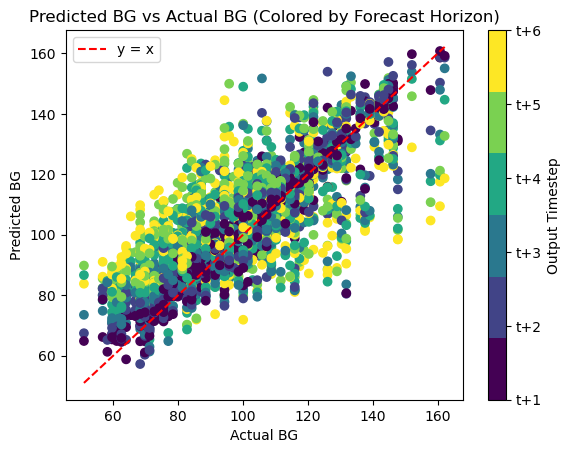


Running model for: id_14_data
Execution time: 51.28586006164551 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8404960632324219 seconds
Execution time: 0.0005750656127929688 seconds
Execution time: 0.00012803077697753906 seconds


Overall Train RMSE: 10.890507047035326 mg/DL
Overall Test RMSE: 12.590398734315032 mg/DL


Train RMSE at t+1: 5.59 mg/DL
Train RMSE at t+2: 7.89 mg/DL
Train RMSE at t+3: 10.06 mg/DL
Train RMSE at t+4: 11.84 mg/DL
Train RMSE at t+5: 13.15 mg/DL
Train RMSE at t+6: 14.27 mg/DL


Test RMSE at t+1: 5.72 mg/DL
Test RMSE at t+2: 8.50 mg/DL
Test RMSE at t+3: 11.16 mg/DL
Test RMSE at t+4: 13.60 mg/DL
Test RMSE at t+5: 15.48 mg/DL
Test RMSE at t+6: 17.23 mg/DL


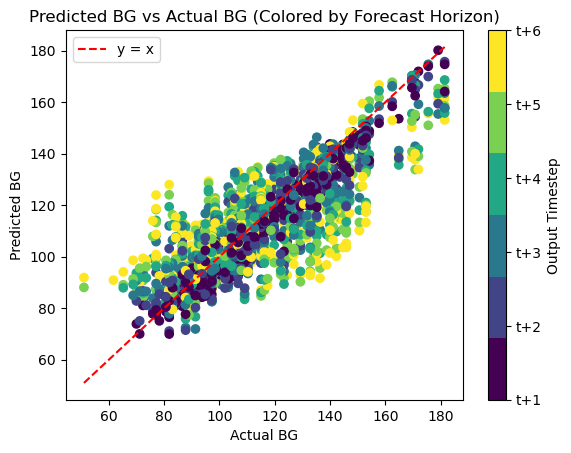


Running model for: id_15_data
Execution time: 39.27518582344055 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8438420295715332 seconds
Execution time: 0.0006010532379150391 seconds
Execution time: 8.392333984375e-05 seconds


Overall Train RMSE: 11.548630643326241 mg/DL
Overall Test RMSE: 14.100216096663841 mg/DL


Train RMSE at t+1: 7.45 mg/DL
Train RMSE at t+2: 9.85 mg/DL
Train RMSE at t+3: 11.25 mg/DL
Train RMSE at t+4: 12.54 mg/DL
Train RMSE at t+5: 13.44 mg/DL
Train RMSE at t+6: 13.53 mg/DL


Test RMSE at t+1: 8.86 mg/DL
Test RMSE at t+2: 11.83 mg/DL
Test RMSE at t+3: 13.59 mg/DL
Test RMSE at t+4: 15.33 mg/DL
Test RMSE at t+5: 16.54 mg/DL
Test RMSE at t+6: 16.77 mg/DL


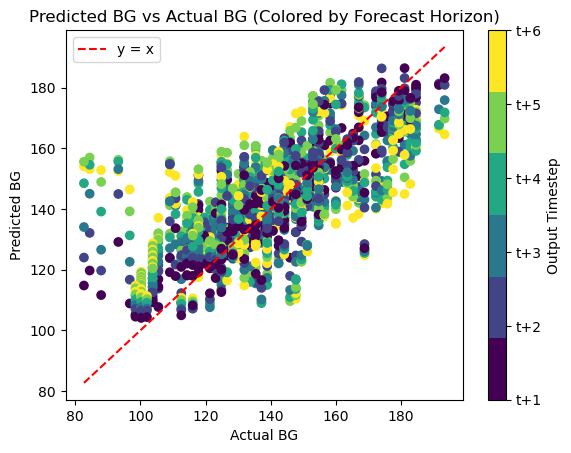


Running model for: id_16_data
Execution time: 49.46529793739319 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.811290979385376 seconds
Execution time: 0.0005459785461425781 seconds
Execution time: 7.796287536621094e-05 seconds


Overall Train RMSE: 14.542284710013503 mg/DL
Overall Test RMSE: 12.683473786677013 mg/DL


Train RMSE at t+1: 6.34 mg/DL
Train RMSE at t+2: 10.37 mg/DL
Train RMSE at t+3: 13.45 mg/DL
Train RMSE at t+4: 15.98 mg/DL
Train RMSE at t+5: 17.81 mg/DL
Train RMSE at t+6: 19.18 mg/DL


Test RMSE at t+1: 5.51 mg/DL
Test RMSE at t+2: 9.19 mg/DL
Test RMSE at t+3: 11.89 mg/DL
Test RMSE at t+4: 13.93 mg/DL
Test RMSE at t+5: 15.39 mg/DL
Test RMSE at t+6: 16.68 mg/DL


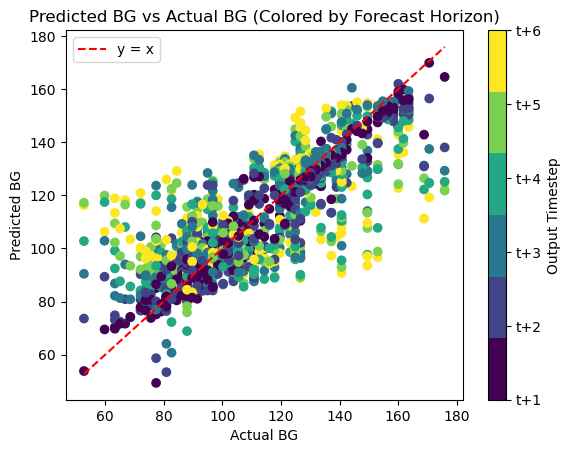


Running model for: id_17_data
Execution time: 47.640987157821655 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Execution time: 0.843919038772583 seconds
Execution time: 0.0006756782531738281 seconds
Execution time: 0.00011301040649414062 seconds


Overall Train RMSE: 13.735954369492106 mg/DL
Overall Test RMSE: 16.010881903921486 mg/DL


Train RMSE at t+1: 7.27 mg/DL
Train RMSE at t+2: 10.43 mg/DL
Train RMSE at t+3: 13.01 mg/DL
Train RMSE at t+4: 14.94 mg/DL
Train RMSE at t+5: 16.48 mg/DL
Train RMSE at t+6: 17.50 mg/DL


Test RMSE at t+1: 9.88 mg/DL
Test RMSE at t+2: 13.17 mg/DL
Test RMSE at t+3: 15.69 mg/DL
Test RMSE at t+4: 17.49 mg/DL
Test RMSE at t+5: 18.46 mg/DL
Test RMSE at t+6: 19.34 mg/DL


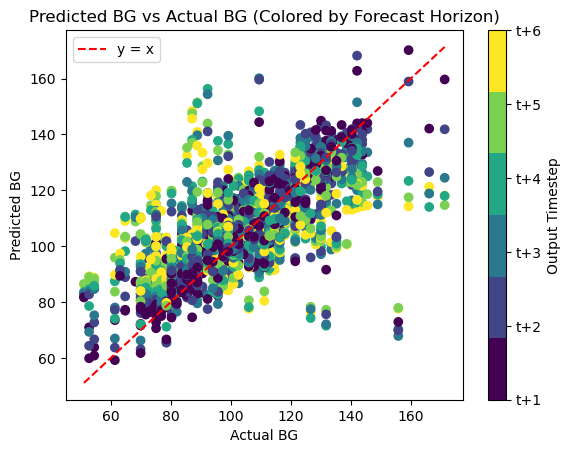


Running model for: id_18_data
Execution time: 51.431950092315674 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9064269065856934 seconds
Execution time: 0.0005550384521484375 seconds
Execution time: 0.0001270771026611328 seconds


Overall Train RMSE: 15.321129831555675 mg/DL
Overall Test RMSE: 16.26448591616855 mg/DL


Train RMSE at t+1: 8.48 mg/DL
Train RMSE at t+2: 11.75 mg/DL
Train RMSE at t+3: 14.81 mg/DL
Train RMSE at t+4: 16.00 mg/DL
Train RMSE at t+5: 18.33 mg/DL
Train RMSE at t+6: 19.67 mg/DL


Test RMSE at t+1: 7.51 mg/DL
Test RMSE at t+2: 11.63 mg/DL
Test RMSE at t+3: 15.38 mg/DL
Test RMSE at t+4: 17.01 mg/DL
Test RMSE at t+5: 19.87 mg/DL
Test RMSE at t+6: 21.79 mg/DL


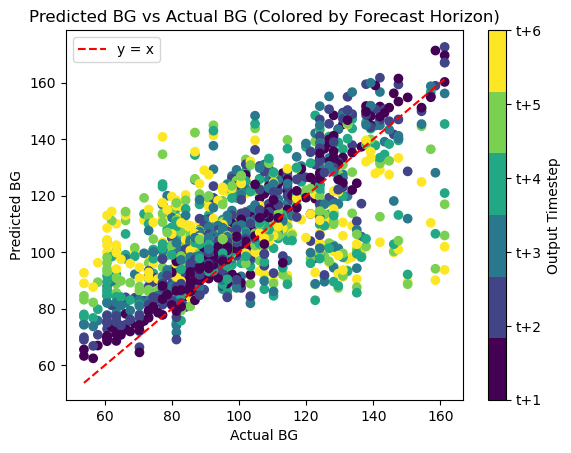


Running model for: id_19_data
Execution time: 57.988524198532104 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.925482988357544 seconds
Execution time: 0.0006253719329833984 seconds
Execution time: 0.0001671314239501953 seconds


Overall Train RMSE: 15.162050877032858 mg/DL
Overall Test RMSE: 12.052453720305488 mg/DL


Train RMSE at t+1: 6.41 mg/DL
Train RMSE at t+2: 9.93 mg/DL
Train RMSE at t+3: 13.60 mg/DL
Train RMSE at t+4: 16.54 mg/DL
Train RMSE at t+5: 18.75 mg/DL
Train RMSE at t+6: 20.72 mg/DL


Test RMSE at t+1: 6.17 mg/DL
Test RMSE at t+2: 9.05 mg/DL
Test RMSE at t+3: 11.15 mg/DL
Test RMSE at t+4: 12.79 mg/DL
Test RMSE at t+5: 14.58 mg/DL
Test RMSE at t+6: 15.84 mg/DL


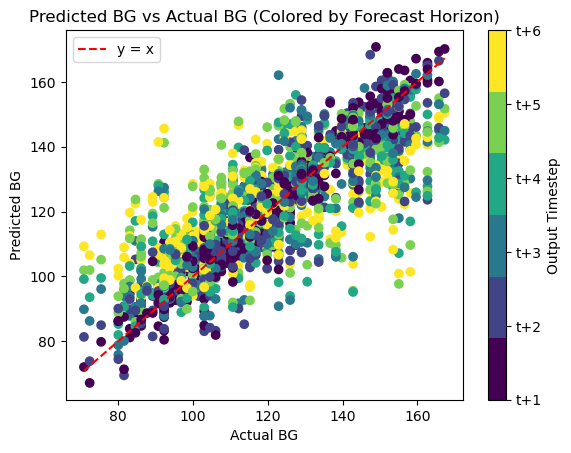


Running model for: id_20_data
Execution time: 54.25607705116272 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.9252550601959229 seconds
Execution time: 0.0006148815155029297 seconds
Execution time: 0.0001308917999267578 seconds


Overall Train RMSE: 10.582660939841954 mg/DL
Overall Test RMSE: 17.959764265480157 mg/DL


Train RMSE at t+1: 8.14 mg/DL
Train RMSE at t+2: 9.17 mg/DL
Train RMSE at t+3: 9.39 mg/DL
Train RMSE at t+4: 10.71 mg/DL
Train RMSE at t+5: 12.45 mg/DL
Train RMSE at t+6: 12.80 mg/DL


Test RMSE at t+1: 10.60 mg/DL
Test RMSE at t+2: 12.89 mg/DL
Test RMSE at t+3: 15.66 mg/DL
Test RMSE at t+4: 18.83 mg/DL
Test RMSE at t+5: 22.05 mg/DL
Test RMSE at t+6: 23.89 mg/DL


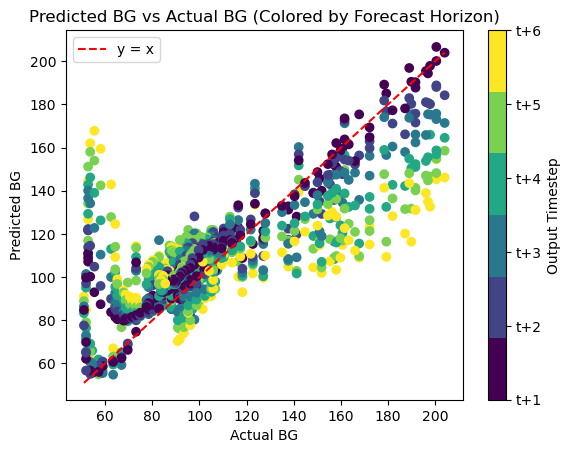


Running model for: id_21_data
Execution time: 55.342833042144775 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9169619083404541 seconds
Execution time: 0.0005629062652587891 seconds
Execution time: 7.987022399902344e-05 seconds


Overall Train RMSE: 9.76561289123174 mg/DL
Overall Test RMSE: 10.896545515383444 mg/DL


Train RMSE at t+1: 4.52 mg/DL
Train RMSE at t+2: 5.84 mg/DL
Train RMSE at t+3: 9.88 mg/DL
Train RMSE at t+4: 11.03 mg/DL
Train RMSE at t+5: 11.10 mg/DL
Train RMSE at t+6: 13.24 mg/DL


Test RMSE at t+1: 4.51 mg/DL
Test RMSE at t+2: 6.74 mg/DL
Test RMSE at t+3: 10.46 mg/DL
Test RMSE at t+4: 11.94 mg/DL
Test RMSE at t+5: 12.94 mg/DL
Test RMSE at t+6: 15.08 mg/DL


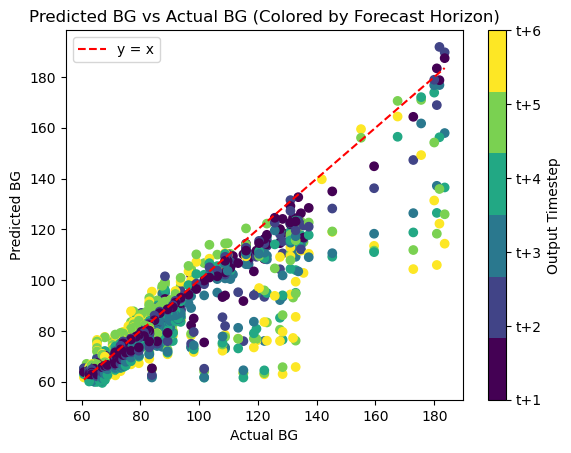


Running model for: id_22_data
Execution time: 52.17289209365845 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8185470104217529 seconds
Execution time: 0.0005621910095214844 seconds
Execution time: 0.00013303756713867188 seconds


Overall Train RMSE: 12.835019722374762 mg/DL
Overall Test RMSE: 10.285707509725032 mg/DL


Train RMSE at t+1: 4.34 mg/DL
Train RMSE at t+2: 7.39 mg/DL
Train RMSE at t+3: 10.83 mg/DL
Train RMSE at t+4: 13.65 mg/DL
Train RMSE at t+5: 16.18 mg/DL
Train RMSE at t+6: 18.69 mg/DL


Test RMSE at t+1: 3.54 mg/DL
Test RMSE at t+2: 6.13 mg/DL
Test RMSE at t+3: 9.15 mg/DL
Test RMSE at t+4: 10.66 mg/DL
Test RMSE at t+5: 12.96 mg/DL
Test RMSE at t+6: 14.81 mg/DL


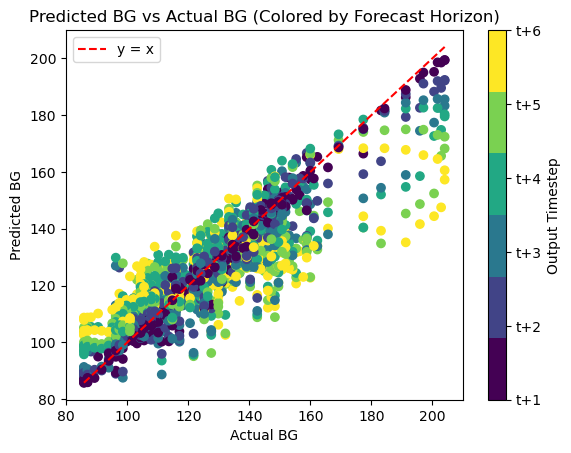


Running model for: id_23_data
Execution time: 47.93632102012634 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.861677885055542 seconds
Execution time: 0.0006470680236816406 seconds
Execution time: 8.487701416015625e-05 seconds


Overall Train RMSE: 6.948741627475966 mg/DL
Overall Test RMSE: 16.13311822271052 mg/DL


Train RMSE at t+1: 3.81 mg/DL
Train RMSE at t+2: 5.35 mg/DL
Train RMSE at t+3: 6.60 mg/DL
Train RMSE at t+4: 7.58 mg/DL
Train RMSE at t+5: 8.25 mg/DL
Train RMSE at t+6: 8.81 mg/DL


Test RMSE at t+1: 10.16 mg/DL
Test RMSE at t+2: 12.76 mg/DL
Test RMSE at t+3: 15.04 mg/DL
Test RMSE at t+4: 16.97 mg/DL
Test RMSE at t+5: 19.58 mg/DL
Test RMSE at t+6: 19.96 mg/DL


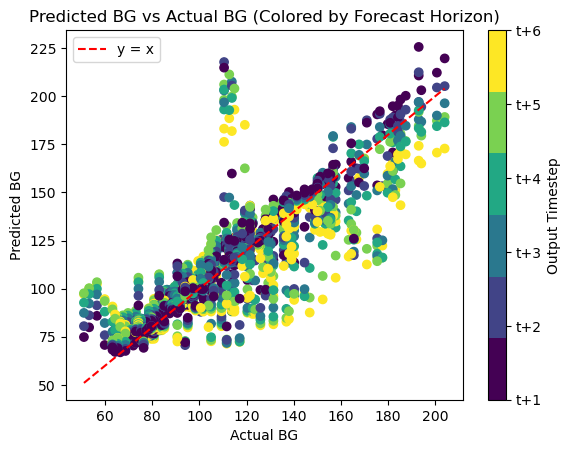


Running model for: id_24_data
Execution time: 54.94261312484741 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
Execution time: 1.0547349452972412 seconds
Execution time: 0.0019791126251220703 seconds
Execution time: 0.0002970695495605469 seconds


Overall Train RMSE: 10.537202883865772 mg/DL
Overall Test RMSE: 15.459696306675669 mg/DL


Train RMSE at t+1: 7.00 mg/DL
Train RMSE at t+2: 7.92 mg/DL
Train RMSE at t+3: 9.42 mg/DL
Train RMSE at t+4: 10.98 mg/DL
Train RMSE at t+5: 12.45 mg/DL
Train RMSE at t+6: 13.79 mg/DL


Test RMSE at t+1: 8.45 mg/DL
Test RMSE at t+2: 10.20 mg/DL
Test RMSE at t+3: 12.50 mg/DL
Test RMSE at t+4: 16.16 mg/DL
Test RMSE at t+5: 18.53 mg/DL
Test RMSE at t+6: 22.31 mg/DL


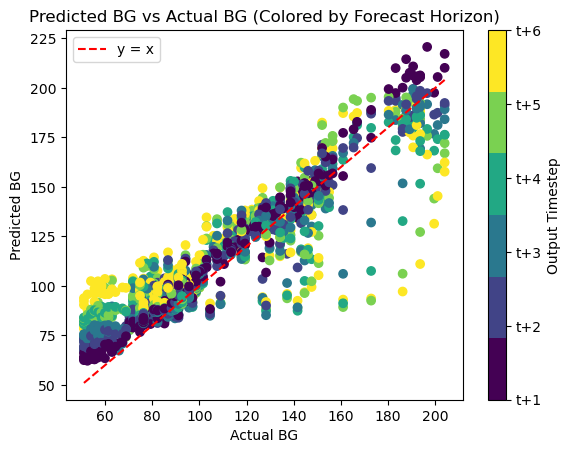


Running model for: id_25_data
Execution time: 49.140942096710205 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8264439105987549 seconds
Execution time: 0.0005860328674316406 seconds
Execution time: 0.00012683868408203125 seconds


Overall Train RMSE: 12.707764686953048 mg/DL
Overall Test RMSE: 11.596144226527436 mg/DL


Train RMSE at t+1: 4.25 mg/DL
Train RMSE at t+2: 7.20 mg/DL
Train RMSE at t+3: 10.77 mg/DL
Train RMSE at t+4: 13.58 mg/DL
Train RMSE at t+5: 15.85 mg/DL
Train RMSE at t+6: 18.63 mg/DL


Test RMSE at t+1: 3.37 mg/DL
Test RMSE at t+2: 6.43 mg/DL
Test RMSE at t+3: 9.91 mg/DL
Test RMSE at t+4: 12.47 mg/DL
Test RMSE at t+5: 14.52 mg/DL
Test RMSE at t+6: 17.02 mg/DL


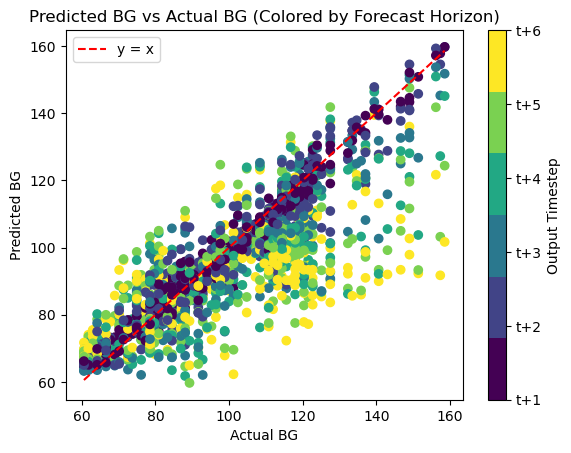


Running model for: id_26_data
Execution time: 49.10180306434631 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8292038440704346 seconds
Execution time: 0.0005848407745361328 seconds
Execution time: 0.00012636184692382812 seconds


Overall Train RMSE: 6.592241824138961 mg/DL
Overall Test RMSE: 6.396241016201396 mg/DL


Train RMSE at t+1: 2.35 mg/DL
Train RMSE at t+2: 3.64 mg/DL
Train RMSE at t+3: 5.10 mg/DL
Train RMSE at t+4: 6.72 mg/DL
Train RMSE at t+5: 8.45 mg/DL
Train RMSE at t+6: 9.97 mg/DL


Test RMSE at t+1: 2.96 mg/DL
Test RMSE at t+2: 4.30 mg/DL
Test RMSE at t+3: 5.25 mg/DL
Test RMSE at t+4: 6.58 mg/DL
Test RMSE at t+5: 7.80 mg/DL
Test RMSE at t+6: 9.30 mg/DL


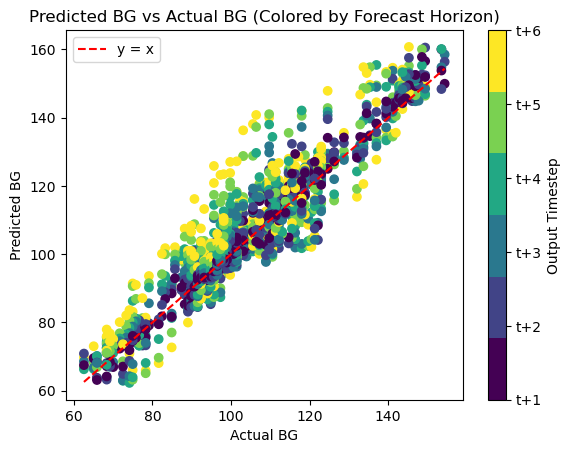


Running model for: id_27_data
Execution time: 52.11151695251465 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8264870643615723 seconds
Execution time: 0.0005700588226318359 seconds
Execution time: 0.00012803077697753906 seconds


Overall Train RMSE: 14.782041053520159 mg/DL
Overall Test RMSE: 16.050851441330057 mg/DL


Train RMSE at t+1: 7.07 mg/DL
Train RMSE at t+2: 10.09 mg/DL
Train RMSE at t+3: 12.96 mg/DL
Train RMSE at t+4: 16.53 mg/DL
Train RMSE at t+5: 18.13 mg/DL
Train RMSE at t+6: 19.73 mg/DL


Test RMSE at t+1: 7.07 mg/DL
Test RMSE at t+2: 10.42 mg/DL
Test RMSE at t+3: 14.33 mg/DL
Test RMSE at t+4: 18.74 mg/DL
Test RMSE at t+5: 19.88 mg/DL
Test RMSE at t+6: 20.87 mg/DL


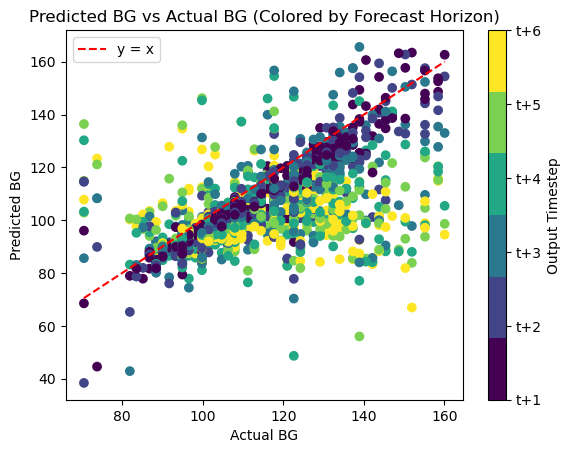


Running model for: id_28_data
Execution time: 50.17729616165161 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8351922035217285 seconds
Execution time: 0.0005640983581542969 seconds
Execution time: 8.392333984375e-05 seconds


Overall Train RMSE: 11.599553912226375 mg/DL
Overall Test RMSE: 10.913763235615555 mg/DL


Train RMSE at t+1: 5.58 mg/DL
Train RMSE at t+2: 8.47 mg/DL
Train RMSE at t+3: 11.42 mg/DL
Train RMSE at t+4: 12.43 mg/DL
Train RMSE at t+5: 13.94 mg/DL
Train RMSE at t+6: 15.01 mg/DL


Test RMSE at t+1: 4.92 mg/DL
Test RMSE at t+2: 7.76 mg/DL
Test RMSE at t+3: 10.78 mg/DL
Test RMSE at t+4: 11.56 mg/DL
Test RMSE at t+5: 13.04 mg/DL
Test RMSE at t+6: 14.50 mg/DL


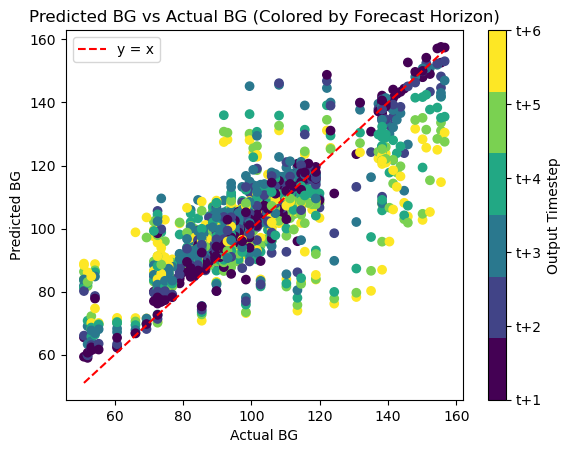


Running model for: id_29_data
Execution time: 50.50900387763977 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8676528930664062 seconds
Execution time: 0.0006220340728759766 seconds
Execution time: 8.821487426757812e-05 seconds


Overall Train RMSE: 14.205320744532258 mg/DL
Overall Test RMSE: 14.211744567754204 mg/DL


Train RMSE at t+1: 6.65 mg/DL
Train RMSE at t+2: 10.53 mg/DL
Train RMSE at t+3: 13.55 mg/DL
Train RMSE at t+4: 15.55 mg/DL
Train RMSE at t+5: 17.31 mg/DL
Train RMSE at t+6: 18.18 mg/DL


Test RMSE at t+1: 5.17 mg/DL
Test RMSE at t+2: 9.43 mg/DL
Test RMSE at t+3: 12.92 mg/DL
Test RMSE at t+4: 15.27 mg/DL
Test RMSE at t+5: 17.91 mg/DL
Test RMSE at t+6: 19.39 mg/DL


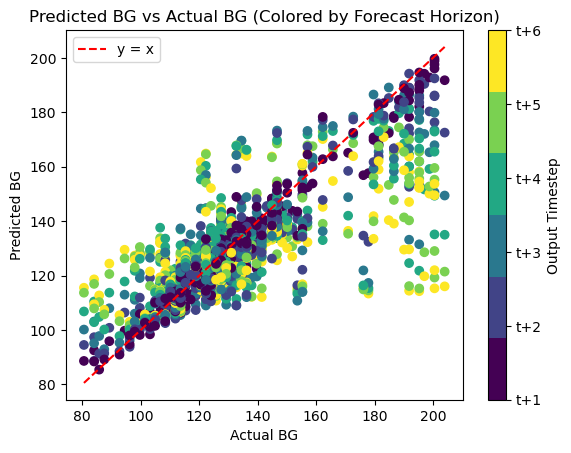


Running model for: id_30_data
Execution time: 49.738116979599 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8096470832824707 seconds
Execution time: 0.00057220458984375 seconds
Execution time: 8.869171142578125e-05 seconds


Overall Train RMSE: 12.56789633960561 mg/DL
Overall Test RMSE: 12.035814966321377 mg/DL


Train RMSE at t+1: 5.99 mg/DL
Train RMSE at t+2: 8.78 mg/DL
Train RMSE at t+3: 11.66 mg/DL
Train RMSE at t+4: 13.81 mg/DL
Train RMSE at t+5: 15.46 mg/DL
Train RMSE at t+6: 16.40 mg/DL


Test RMSE at t+1: 5.33 mg/DL
Test RMSE at t+2: 7.93 mg/DL
Test RMSE at t+3: 10.83 mg/DL
Test RMSE at t+4: 12.94 mg/DL
Test RMSE at t+5: 14.87 mg/DL
Test RMSE at t+6: 16.50 mg/DL


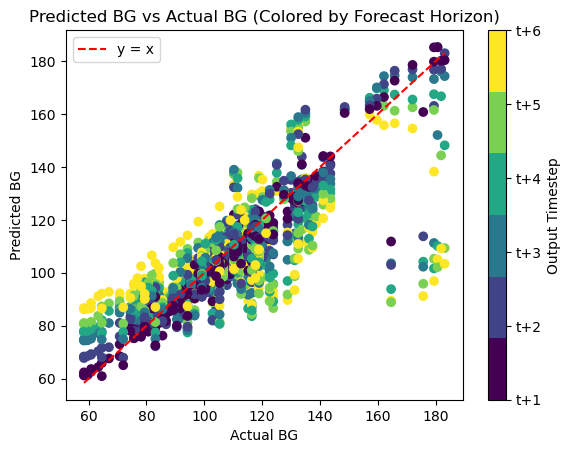


Running model for: id_31_data
Execution time: 48.151931047439575 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8417868614196777 seconds
Execution time: 0.000598907470703125 seconds
Execution time: 8.797645568847656e-05 seconds


Overall Train RMSE: 16.241189027059754 mg/DL
Overall Test RMSE: 10.65566864817938 mg/DL


Train RMSE at t+1: 7.02 mg/DL
Train RMSE at t+2: 11.65 mg/DL
Train RMSE at t+3: 15.21 mg/DL
Train RMSE at t+4: 17.86 mg/DL
Train RMSE at t+5: 19.94 mg/DL
Train RMSE at t+6: 21.21 mg/DL


Test RMSE at t+1: 5.10 mg/DL
Test RMSE at t+2: 8.05 mg/DL
Test RMSE at t+3: 10.16 mg/DL
Test RMSE at t+4: 11.76 mg/DL
Test RMSE at t+5: 12.84 mg/DL
Test RMSE at t+6: 13.57 mg/DL


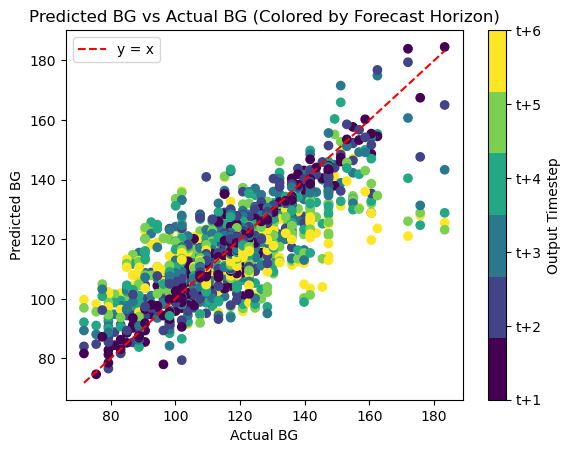


Running model for: id_32_data
Execution time: 48.78445887565613 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8663249015808105 seconds
Execution time: 0.0006036758422851562 seconds
Execution time: 0.00013494491577148438 seconds


Overall Train RMSE: 9.551815567204216 mg/DL
Overall Test RMSE: 14.410789534845767 mg/DL


Train RMSE at t+1: 6.35 mg/DL
Train RMSE at t+2: 7.06 mg/DL
Train RMSE at t+3: 8.62 mg/DL
Train RMSE at t+4: 9.97 mg/DL
Train RMSE at t+5: 11.68 mg/DL
Train RMSE at t+6: 12.12 mg/DL


Test RMSE at t+1: 8.01 mg/DL
Test RMSE at t+2: 9.87 mg/DL
Test RMSE at t+3: 12.81 mg/DL
Test RMSE at t+4: 15.18 mg/DL
Test RMSE at t+5: 18.33 mg/DL
Test RMSE at t+6: 18.82 mg/DL


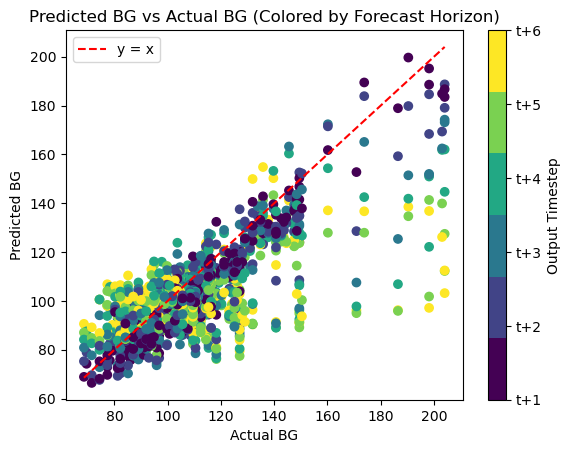


Running model for: id_33_data
Execution time: 48.67668104171753 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.857990026473999 seconds
Execution time: 0.0005810260772705078 seconds
Execution time: 0.00013184547424316406 seconds


Overall Train RMSE: 13.92889463325676 mg/DL
Overall Test RMSE: 14.758296087025272 mg/DL


Train RMSE at t+1: 5.79 mg/DL
Train RMSE at t+2: 9.33 mg/DL
Train RMSE at t+3: 12.62 mg/DL
Train RMSE at t+4: 15.06 mg/DL
Train RMSE at t+5: 17.43 mg/DL
Train RMSE at t+6: 18.81 mg/DL


Test RMSE at t+1: 7.16 mg/DL
Test RMSE at t+2: 11.32 mg/DL
Test RMSE at t+3: 14.51 mg/DL
Test RMSE at t+4: 16.28 mg/DL
Test RMSE at t+5: 17.73 mg/DL
Test RMSE at t+6: 18.38 mg/DL


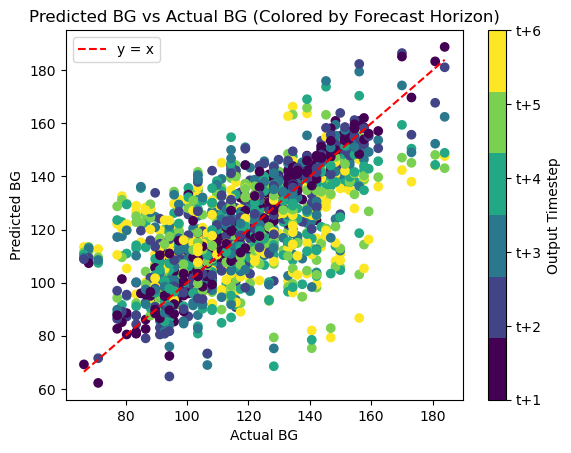


Running model for: id_34_data
Execution time: 50.76148986816406 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9713480472564697 seconds
Execution time: 0.0007159709930419922 seconds
Execution time: 0.0002040863037109375 seconds


Overall Train RMSE: 8.19753940415544 mg/DL
Overall Test RMSE: 14.959292100159196 mg/DL


Train RMSE at t+1: 3.84 mg/DL
Train RMSE at t+2: 5.94 mg/DL
Train RMSE at t+3: 7.55 mg/DL
Train RMSE at t+4: 8.94 mg/DL
Train RMSE at t+5: 10.00 mg/DL
Train RMSE at t+6: 10.78 mg/DL


Test RMSE at t+1: 7.84 mg/DL
Test RMSE at t+2: 11.01 mg/DL
Test RMSE at t+3: 13.52 mg/DL
Test RMSE at t+4: 15.65 mg/DL
Test RMSE at t+5: 18.23 mg/DL
Test RMSE at t+6: 19.99 mg/DL


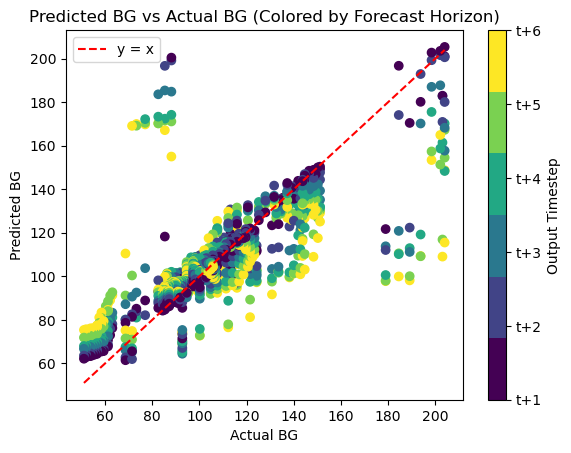


Running model for: id_35_data
Execution time: 49.45977711677551 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8361749649047852 seconds
Execution time: 0.0005743503570556641 seconds
Execution time: 8.296966552734375e-05 seconds


Overall Train RMSE: 10.801934793570194 mg/DL
Overall Test RMSE: 6.959582081239669 mg/DL


Train RMSE at t+1: 5.41 mg/DL
Train RMSE at t+2: 7.98 mg/DL
Train RMSE at t+3: 9.70 mg/DL
Train RMSE at t+4: 11.61 mg/DL
Train RMSE at t+5: 13.03 mg/DL
Train RMSE at t+6: 14.43 mg/DL


Test RMSE at t+1: 3.21 mg/DL
Test RMSE at t+2: 4.92 mg/DL
Test RMSE at t+3: 6.10 mg/DL
Test RMSE at t+4: 7.63 mg/DL
Test RMSE at t+5: 8.49 mg/DL
Test RMSE at t+6: 9.42 mg/DL


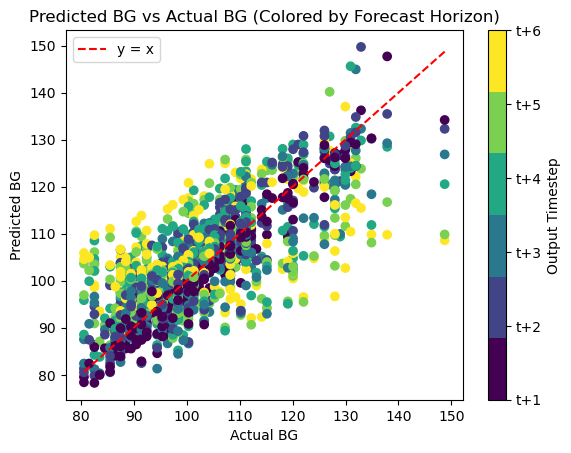


Running model for: id_36_data
Execution time: 51.25111699104309 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8349900245666504 seconds
Execution time: 0.0005807876586914062 seconds
Execution time: 8.511543273925781e-05 seconds


Overall Train RMSE: 12.595157435382502 mg/DL
Overall Test RMSE: 10.865313661659126 mg/DL


Train RMSE at t+1: 4.60 mg/DL
Train RMSE at t+2: 7.67 mg/DL
Train RMSE at t+3: 10.59 mg/DL
Train RMSE at t+4: 13.34 mg/DL
Train RMSE at t+5: 15.84 mg/DL
Train RMSE at t+6: 18.19 mg/DL


Test RMSE at t+1: 3.91 mg/DL
Test RMSE at t+2: 6.90 mg/DL
Test RMSE at t+3: 9.39 mg/DL
Test RMSE at t+4: 11.57 mg/DL
Test RMSE at t+5: 13.58 mg/DL
Test RMSE at t+6: 15.46 mg/DL


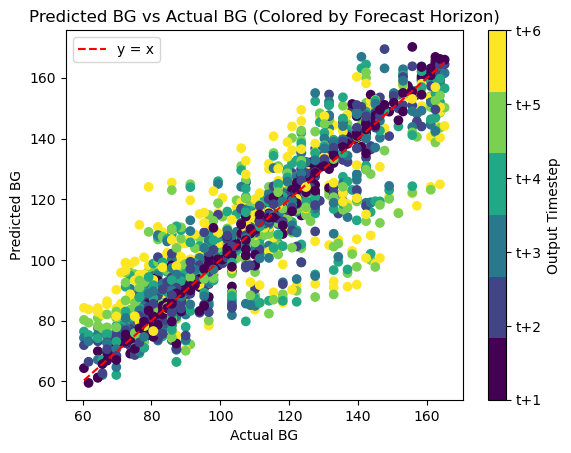


Running model for: id_37_data
Execution time: 49.2759690284729 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.824199914932251 seconds
Execution time: 0.0005447864532470703 seconds
Execution time: 0.00013899803161621094 seconds


Overall Train RMSE: 6.51816563438307 mg/DL
Overall Test RMSE: 12.595618235767105 mg/DL


Train RMSE at t+1: 2.84 mg/DL
Train RMSE at t+2: 4.13 mg/DL
Train RMSE at t+3: 5.20 mg/DL
Train RMSE at t+4: 6.72 mg/DL
Train RMSE at t+5: 8.03 mg/DL
Train RMSE at t+6: 9.65 mg/DL


Test RMSE at t+1: 6.55 mg/DL
Test RMSE at t+2: 8.31 mg/DL
Test RMSE at t+3: 11.13 mg/DL
Test RMSE at t+4: 13.67 mg/DL
Test RMSE at t+5: 15.44 mg/DL
Test RMSE at t+6: 17.05 mg/DL


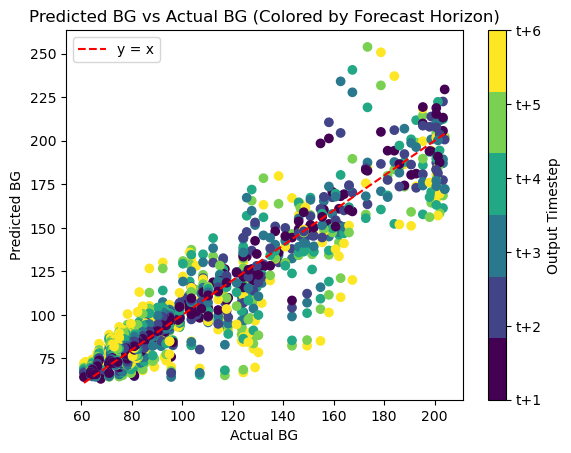


Running model for: id_38_data
Execution time: 47.722491979599 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.822037935256958 seconds
Execution time: 0.0006041526794433594 seconds
Execution time: 0.00017380714416503906 seconds


Overall Train RMSE: 11.128855055843815 mg/DL
Overall Test RMSE: 10.1398571942034 mg/DL


Train RMSE at t+1: 6.07 mg/DL
Train RMSE at t+2: 8.26 mg/DL
Train RMSE at t+3: 10.01 mg/DL
Train RMSE at t+4: 12.23 mg/DL
Train RMSE at t+5: 13.53 mg/DL
Train RMSE at t+6: 14.31 mg/DL


Test RMSE at t+1: 5.62 mg/DL
Test RMSE at t+2: 7.41 mg/DL
Test RMSE at t+3: 8.79 mg/DL
Test RMSE at t+4: 11.26 mg/DL
Test RMSE at t+5: 12.46 mg/DL
Test RMSE at t+6: 13.08 mg/DL


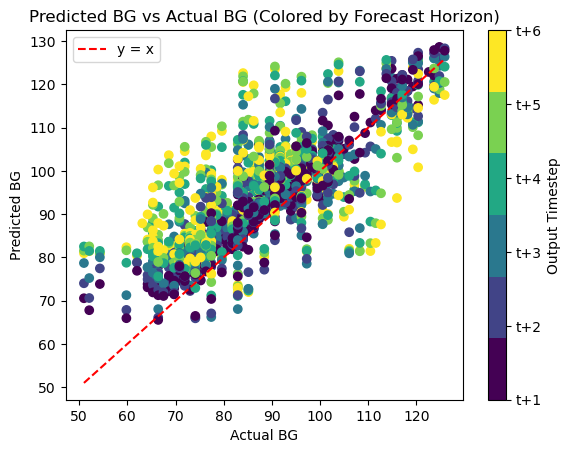


Running model for: id_39_data
Execution time: 54.05120587348938 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Execution time: 0.900933027267456 seconds
Execution time: 0.0004980564117431641 seconds
Execution time: 0.000141143798828125 seconds


Overall Train RMSE: 11.147276177314826 mg/DL
Overall Test RMSE: 13.513170368014935 mg/DL


Train RMSE at t+1: 4.17 mg/DL
Train RMSE at t+2: 6.78 mg/DL
Train RMSE at t+3: 9.40 mg/DL
Train RMSE at t+4: 11.76 mg/DL
Train RMSE at t+5: 14.12 mg/DL
Train RMSE at t+6: 16.01 mg/DL


Test RMSE at t+1: 4.78 mg/DL
Test RMSE at t+2: 8.03 mg/DL
Test RMSE at t+3: 11.23 mg/DL
Test RMSE at t+4: 14.27 mg/DL
Test RMSE at t+5: 17.19 mg/DL
Test RMSE at t+6: 19.58 mg/DL


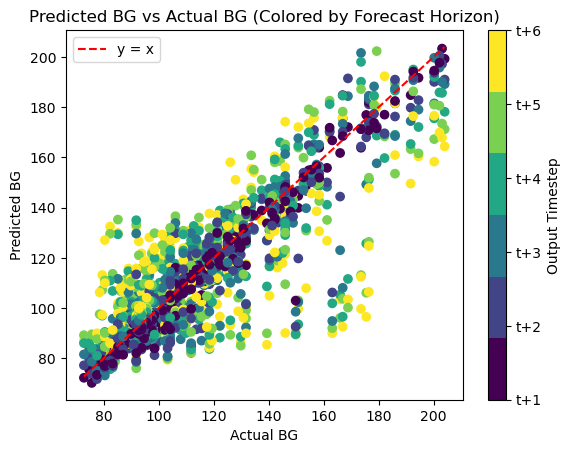


Running model for: id_40_data
Execution time: 55.369072675704956 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9102039337158203 seconds
Execution time: 0.0006430149078369141 seconds
Execution time: 8.20159912109375e-05 seconds


Overall Train RMSE: 9.412318768524056 mg/DL
Overall Test RMSE: 12.15073897703496 mg/DL


Train RMSE at t+1: 4.01 mg/DL
Train RMSE at t+2: 6.07 mg/DL
Train RMSE at t+3: 8.13 mg/DL
Train RMSE at t+4: 9.74 mg/DL
Train RMSE at t+5: 11.83 mg/DL
Train RMSE at t+6: 13.33 mg/DL


Test RMSE at t+1: 4.12 mg/DL
Test RMSE at t+2: 7.10 mg/DL
Test RMSE at t+3: 10.14 mg/DL
Test RMSE at t+4: 12.36 mg/DL
Test RMSE at t+5: 15.63 mg/DL
Test RMSE at t+6: 17.85 mg/DL


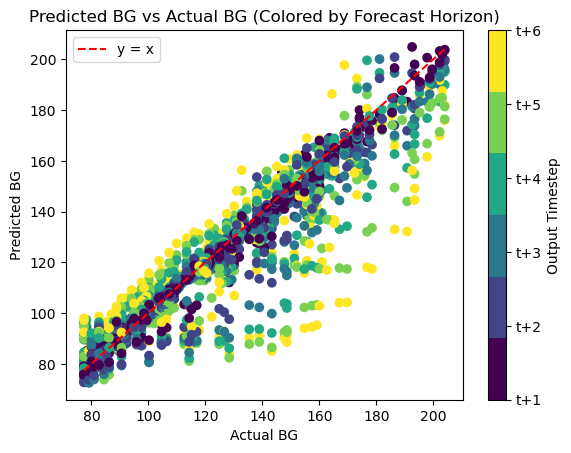


Running model for: id_41_data
Execution time: 53.63836860656738 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9054431915283203 seconds
Execution time: 0.0006139278411865234 seconds
Execution time: 8.702278137207031e-05 seconds


Overall Train RMSE: 9.955635853819105 mg/DL
Overall Test RMSE: 11.054361992242493 mg/DL


Train RMSE at t+1: 3.68 mg/DL
Train RMSE at t+2: 6.23 mg/DL
Train RMSE at t+3: 8.32 mg/DL
Train RMSE at t+4: 10.58 mg/DL
Train RMSE at t+5: 12.61 mg/DL
Train RMSE at t+6: 14.22 mg/DL


Test RMSE at t+1: 4.70 mg/DL
Test RMSE at t+2: 7.32 mg/DL
Test RMSE at t+3: 9.66 mg/DL
Test RMSE at t+4: 11.76 mg/DL
Test RMSE at t+5: 13.70 mg/DL
Test RMSE at t+6: 15.44 mg/DL


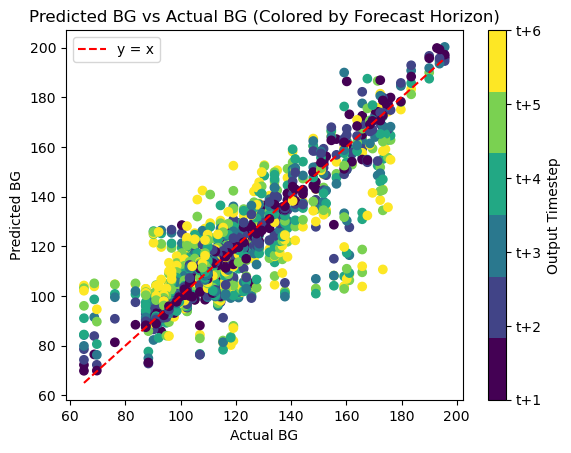


Running model for: id_42_data
Execution time: 55.49065279960632 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9259800910949707 seconds
Execution time: 0.0007352828979492188 seconds
Execution time: 9.107589721679688e-05 seconds


Overall Train RMSE: 12.054060246503537 mg/DL
Overall Test RMSE: 13.161316534169213 mg/DL


Train RMSE at t+1: 5.46 mg/DL
Train RMSE at t+2: 8.25 mg/DL
Train RMSE at t+3: 10.61 mg/DL
Train RMSE at t+4: 13.28 mg/DL
Train RMSE at t+5: 14.82 mg/DL
Train RMSE at t+6: 16.30 mg/DL


Test RMSE at t+1: 5.93 mg/DL
Test RMSE at t+2: 9.10 mg/DL
Test RMSE at t+3: 11.26 mg/DL
Test RMSE at t+4: 14.71 mg/DL
Test RMSE at t+5: 15.96 mg/DL
Test RMSE at t+6: 17.99 mg/DL


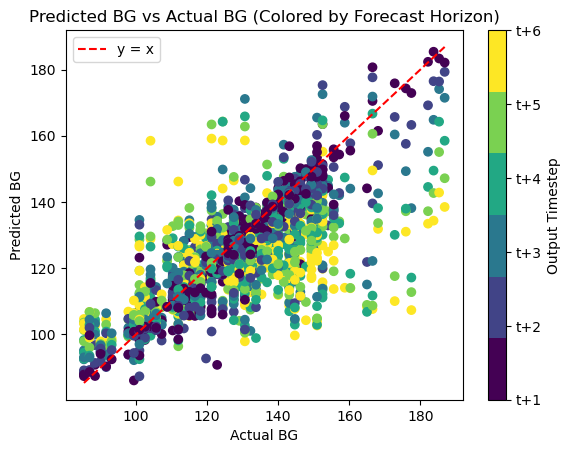


Running model for: id_43_data
Execution time: 51.297353982925415 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.823239803314209 seconds
Execution time: 0.0005869865417480469 seconds
Execution time: 0.00012803077697753906 seconds


Overall Train RMSE: 10.727793068397192 mg/DL
Overall Test RMSE: 10.633632748259457 mg/DL


Train RMSE at t+1: 4.09 mg/DL
Train RMSE at t+2: 6.60 mg/DL
Train RMSE at t+3: 9.04 mg/DL
Train RMSE at t+4: 11.96 mg/DL
Train RMSE at t+5: 13.14 mg/DL
Train RMSE at t+6: 15.26 mg/DL


Test RMSE at t+1: 3.65 mg/DL
Test RMSE at t+2: 6.27 mg/DL
Test RMSE at t+3: 8.62 mg/DL
Test RMSE at t+4: 12.28 mg/DL
Test RMSE at t+5: 12.90 mg/DL
Test RMSE at t+6: 15.31 mg/DL


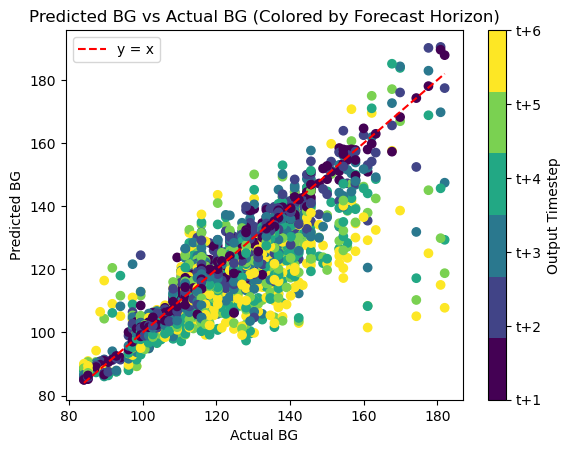


Running model for: id_44_data
Execution time: 39.13556480407715 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Execution time: 0.8460540771484375 seconds
Execution time: 0.0005440711975097656 seconds
Execution time: 7.915496826171875e-05 seconds


Overall Train RMSE: 10.791857855504023 mg/DL
Overall Test RMSE: 7.580821292380152 mg/DL


Train RMSE at t+1: 5.84 mg/DL
Train RMSE at t+2: 8.52 mg/DL
Train RMSE at t+3: 10.19 mg/DL
Train RMSE at t+4: 11.47 mg/DL
Train RMSE at t+5: 12.89 mg/DL
Train RMSE at t+6: 13.81 mg/DL


Test RMSE at t+1: 4.17 mg/DL
Test RMSE at t+2: 5.88 mg/DL
Test RMSE at t+3: 7.24 mg/DL
Test RMSE at t+4: 8.12 mg/DL
Test RMSE at t+5: 9.04 mg/DL
Test RMSE at t+6: 9.63 mg/DL


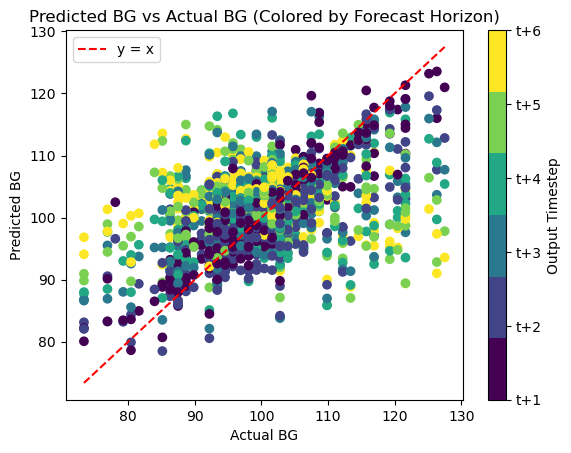


Running model for: id_45_data
Execution time: 48.89266920089722 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8218448162078857 seconds
Execution time: 0.0008258819580078125 seconds
Execution time: 0.00013685226440429688 seconds


Overall Train RMSE: 11.442889117597844 mg/DL
Overall Test RMSE: 10.844197839453146 mg/DL


Train RMSE at t+1: 5.76 mg/DL
Train RMSE at t+2: 8.38 mg/DL
Train RMSE at t+3: 10.66 mg/DL
Train RMSE at t+4: 12.35 mg/DL
Train RMSE at t+5: 13.82 mg/DL
Train RMSE at t+6: 15.00 mg/DL


Test RMSE at t+1: 6.56 mg/DL
Test RMSE at t+2: 8.66 mg/DL
Test RMSE at t+3: 10.51 mg/DL
Test RMSE at t+4: 11.90 mg/DL
Test RMSE at t+5: 12.65 mg/DL
Test RMSE at t+6: 13.25 mg/DL


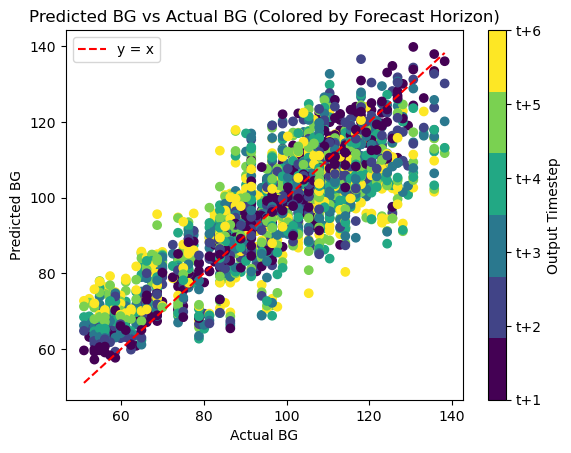


Running model for: id_46_data
Execution time: 48.52531814575195 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8763430118560791 seconds
Execution time: 0.0006341934204101562 seconds
Execution time: 0.00013589859008789062 seconds


Overall Train RMSE: 10.254916944877994 mg/DL
Overall Test RMSE: 11.430599131645282 mg/DL


Train RMSE at t+1: 5.47 mg/DL
Train RMSE at t+2: 6.88 mg/DL
Train RMSE at t+3: 8.30 mg/DL
Train RMSE at t+4: 10.73 mg/DL
Train RMSE at t+5: 12.94 mg/DL
Train RMSE at t+6: 14.22 mg/DL


Test RMSE at t+1: 5.95 mg/DL
Test RMSE at t+2: 7.70 mg/DL
Test RMSE at t+3: 10.08 mg/DL
Test RMSE at t+4: 12.10 mg/DL
Test RMSE at t+5: 14.04 mg/DL
Test RMSE at t+6: 15.62 mg/DL


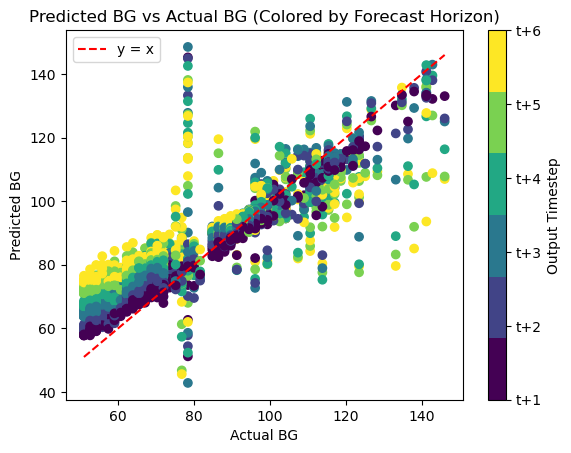


Running model for: id_47_data
Execution time: 48.72565484046936 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Execution time: 0.8324389457702637 seconds
Execution time: 0.0005710124969482422 seconds
Execution time: 8.320808410644531e-05 seconds


Overall Train RMSE: 13.697730158511524 mg/DL
Overall Test RMSE: 9.614556569381296 mg/DL


Train RMSE at t+1: 6.71 mg/DL
Train RMSE at t+2: 9.94 mg/DL
Train RMSE at t+3: 12.79 mg/DL
Train RMSE at t+4: 14.97 mg/DL
Train RMSE at t+5: 16.61 mg/DL
Train RMSE at t+6: 17.85 mg/DL


Test RMSE at t+1: 5.20 mg/DL
Test RMSE at t+2: 7.31 mg/DL
Test RMSE at t+3: 9.20 mg/DL
Test RMSE at t+4: 10.26 mg/DL
Test RMSE at t+5: 11.31 mg/DL
Test RMSE at t+6: 12.51 mg/DL


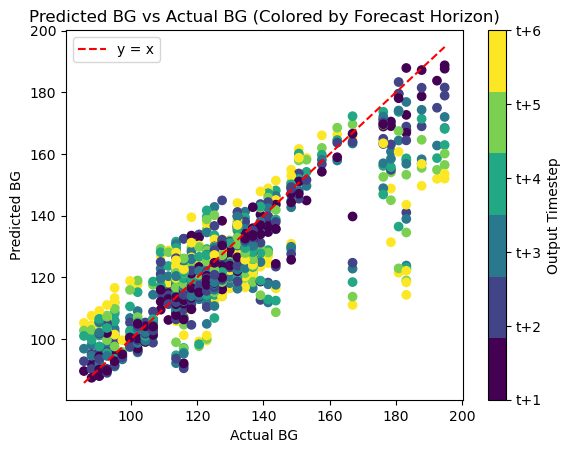


Running model for: id_48_data
Execution time: 48.34282088279724 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8337321281433105 seconds
Execution time: 0.0005679130554199219 seconds
Execution time: 0.00012993812561035156 seconds


Overall Train RMSE: 12.990170930478032 mg/DL
Overall Test RMSE: 9.389862465541942 mg/DL


Train RMSE at t+1: 6.39 mg/DL
Train RMSE at t+2: 10.04 mg/DL
Train RMSE at t+3: 12.78 mg/DL
Train RMSE at t+4: 14.38 mg/DL
Train RMSE at t+5: 15.47 mg/DL
Train RMSE at t+6: 16.17 mg/DL


Test RMSE at t+1: 4.14 mg/DL
Test RMSE at t+2: 7.24 mg/DL
Test RMSE at t+3: 9.09 mg/DL
Test RMSE at t+4: 10.52 mg/DL
Test RMSE at t+5: 11.16 mg/DL
Test RMSE at t+6: 11.90 mg/DL


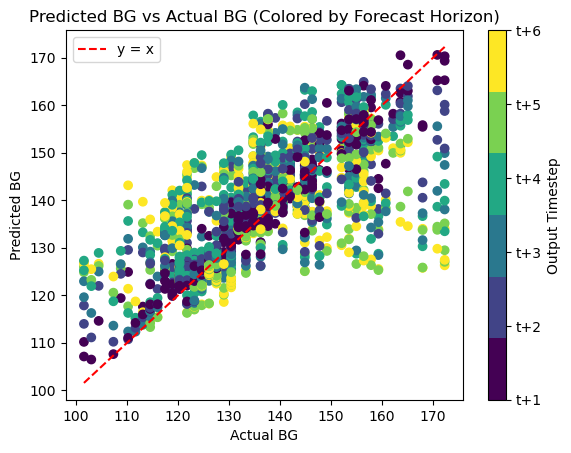


Running model for: id_49_data
Execution time: 50.36275815963745 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9015491008758545 seconds
Execution time: 0.0019059181213378906 seconds
Execution time: 0.0002560615539550781 seconds


Overall Train RMSE: 12.861667041456442 mg/DL
Overall Test RMSE: 15.495619925853227 mg/DL


Train RMSE at t+1: 5.45 mg/DL
Train RMSE at t+2: 8.64 mg/DL
Train RMSE at t+3: 11.42 mg/DL
Train RMSE at t+4: 13.90 mg/DL
Train RMSE at t+5: 15.91 mg/DL
Train RMSE at t+6: 17.64 mg/DL


Test RMSE at t+1: 6.66 mg/DL
Test RMSE at t+2: 10.23 mg/DL
Test RMSE at t+3: 13.29 mg/DL
Test RMSE at t+4: 16.37 mg/DL
Test RMSE at t+5: 19.40 mg/DL
Test RMSE at t+6: 21.70 mg/DL


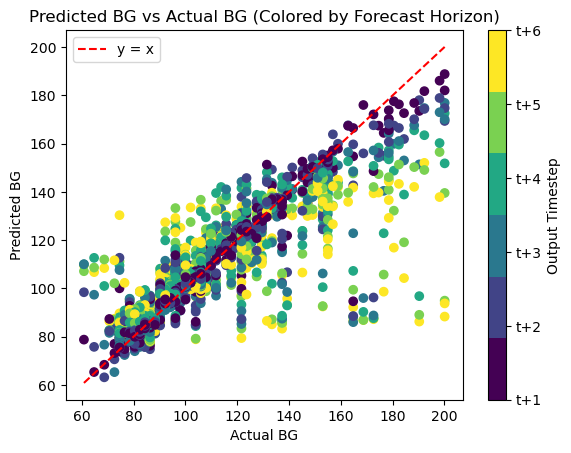


Running model for: id_50_data
Execution time: 50.056636810302734 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8715147972106934 seconds
Execution time: 0.0005886554718017578 seconds
Execution time: 0.00017189979553222656 seconds


Overall Train RMSE: 12.631664810939514 mg/DL
Overall Test RMSE: 13.633329397393998 mg/DL


Train RMSE at t+1: 6.23 mg/DL
Train RMSE at t+2: 9.12 mg/DL
Train RMSE at t+3: 11.89 mg/DL
Train RMSE at t+4: 13.88 mg/DL
Train RMSE at t+5: 15.33 mg/DL
Train RMSE at t+6: 16.31 mg/DL


Test RMSE at t+1: 6.11 mg/DL
Test RMSE at t+2: 9.21 mg/DL
Test RMSE at t+3: 12.85 mg/DL
Test RMSE at t+4: 15.01 mg/DL
Test RMSE at t+5: 16.73 mg/DL
Test RMSE at t+6: 17.96 mg/DL


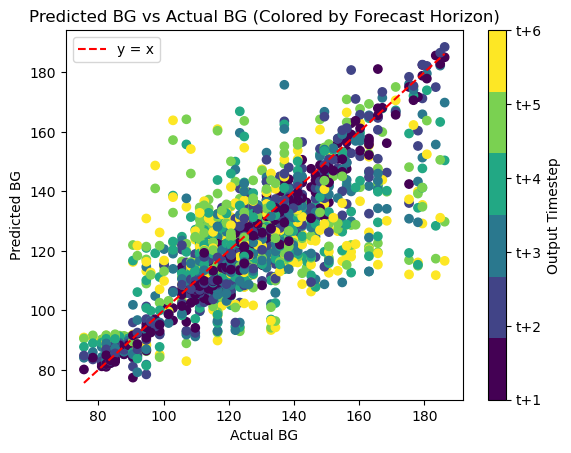


Running model for: id_51_data
Execution time: 49.77797818183899 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9764878749847412 seconds
Execution time: 0.0005941390991210938 seconds
Execution time: 0.0001380443572998047 seconds


Overall Train RMSE: 9.856358962356685 mg/DL
Overall Test RMSE: 9.500583883909492 mg/DL


Train RMSE at t+1: 4.47 mg/DL
Train RMSE at t+2: 6.82 mg/DL
Train RMSE at t+3: 9.11 mg/DL
Train RMSE at t+4: 10.86 mg/DL
Train RMSE at t+5: 11.91 mg/DL
Train RMSE at t+6: 13.18 mg/DL


Test RMSE at t+1: 4.60 mg/DL
Test RMSE at t+2: 6.79 mg/DL
Test RMSE at t+3: 8.45 mg/DL
Test RMSE at t+4: 10.08 mg/DL
Test RMSE at t+5: 11.66 mg/DL
Test RMSE at t+6: 12.86 mg/DL


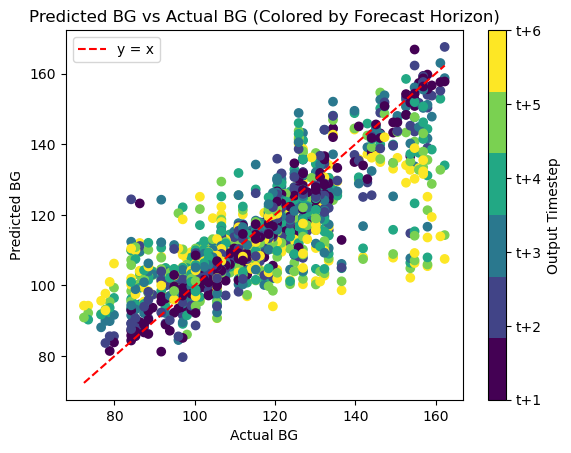


Running model for: id_52_data
Execution time: 57.011411905288696 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.938040018081665 seconds
Execution time: 0.0005853176116943359 seconds
Execution time: 9.489059448242188e-05 seconds


Overall Train RMSE: 10.59968697022858 mg/DL
Overall Test RMSE: 13.59279483196927 mg/DL


Train RMSE at t+1: 6.44 mg/DL
Train RMSE at t+2: 7.53 mg/DL
Train RMSE at t+3: 9.11 mg/DL
Train RMSE at t+4: 10.87 mg/DL
Train RMSE at t+5: 12.75 mg/DL
Train RMSE at t+6: 14.56 mg/DL


Test RMSE at t+1: 6.83 mg/DL
Test RMSE at t+2: 8.45 mg/DL
Test RMSE at t+3: 9.79 mg/DL
Test RMSE at t+4: 13.25 mg/DL
Test RMSE at t+5: 17.11 mg/DL
Test RMSE at t+6: 20.64 mg/DL


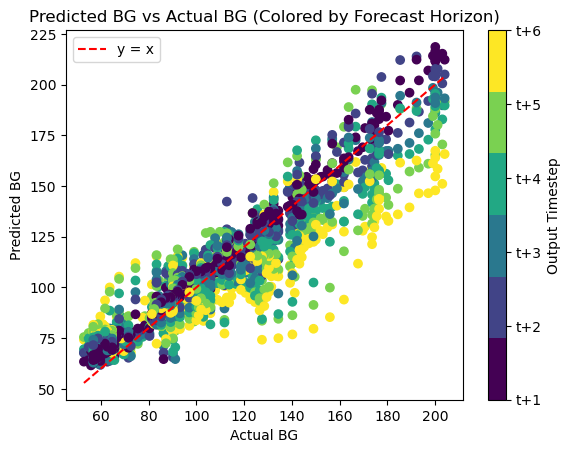


Running model for: id_53_data
Execution time: 54.63478207588196 seconds
43/43 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Execution time: 0.8991010189056396 seconds
Execution time: 0.0007650852203369141 seconds
Execution time: 0.00014019012451171875 seconds


Overall Train RMSE: 14.210008359628748 mg/DL
Overall Test RMSE: 11.740815597716914 mg/DL


Train RMSE at t+1: 6.33 mg/DL
Train RMSE at t+2: 9.29 mg/DL
Train RMSE at t+3: 12.64 mg/DL
Train RMSE at t+4: 15.39 mg/DL
Train RMSE at t+5: 17.97 mg/DL
Train RMSE at t+6: 19.11 mg/DL


Test RMSE at t+1: 6.06 mg/DL
Test RMSE at t+2: 7.96 mg/DL
Test RMSE at t+3: 10.61 mg/DL
Test RMSE at t+4: 12.72 mg/DL
Test RMSE at t+5: 14.49 mg/DL
Test RMSE at t+6: 15.58 mg/DL


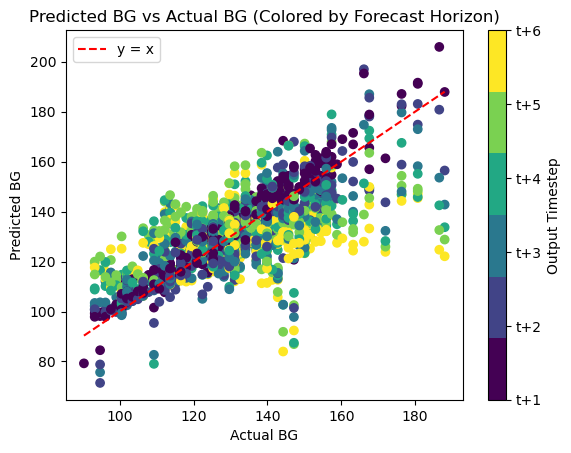


Running model for: id_54_data
Execution time: 53.93568515777588 seconds
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9603679180145264 seconds
Execution time: 0.0006051063537597656 seconds
Execution time: 0.0001652240753173828 seconds


Overall Train RMSE: 13.22546341262736 mg/DL
Overall Test RMSE: 12.61803338695906 mg/DL


Train RMSE at t+1: 5.73 mg/DL
Train RMSE at t+2: 9.17 mg/DL
Train RMSE at t+3: 12.25 mg/DL
Train RMSE at t+4: 14.59 mg/DL
Train RMSE at t+5: 16.32 mg/DL
Train RMSE at t+6: 17.42 mg/DL


Test RMSE at t+1: 5.75 mg/DL
Test RMSE at t+2: 8.74 mg/DL
Test RMSE at t+3: 11.53 mg/DL
Test RMSE at t+4: 13.71 mg/DL
Test RMSE at t+5: 15.59 mg/DL
Test RMSE at t+6: 16.78 mg/DL


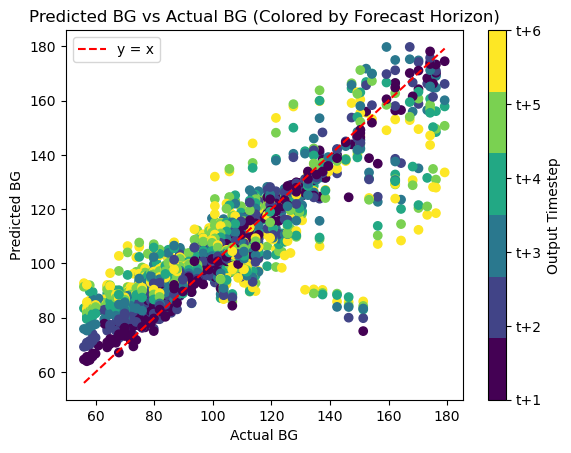


Running model for: id_55_data
Execution time: 55.59878396987915 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.8576509952545166 seconds
Execution time: 0.00061798095703125 seconds
Execution time: 0.00012803077697753906 seconds


Overall Train RMSE: 10.132375601341217 mg/DL
Overall Test RMSE: 10.282971417403957 mg/DL


Train RMSE at t+1: 4.86 mg/DL
Train RMSE at t+2: 7.03 mg/DL
Train RMSE at t+3: 9.27 mg/DL
Train RMSE at t+4: 10.95 mg/DL
Train RMSE at t+5: 12.41 mg/DL
Train RMSE at t+6: 13.52 mg/DL


Test RMSE at t+1: 4.28 mg/DL
Test RMSE at t+2: 6.58 mg/DL
Test RMSE at t+3: 9.17 mg/DL
Test RMSE at t+4: 11.20 mg/DL
Test RMSE at t+5: 12.81 mg/DL
Test RMSE at t+6: 14.11 mg/DL


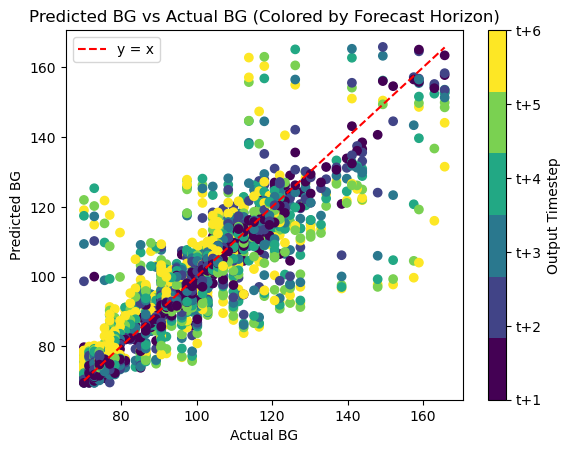


Running model for: id_56_data
Execution time: 57.23619818687439 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
Execution time: 0.9418270587921143 seconds
Execution time: 0.0005729198455810547 seconds
Execution time: 8.296966552734375e-05 seconds


Overall Train RMSE: 11.53907587307681 mg/DL
Overall Test RMSE: 13.032274717913046 mg/DL


Train RMSE at t+1: 4.98 mg/DL
Train RMSE at t+2: 8.26 mg/DL
Train RMSE at t+3: 10.84 mg/DL
Train RMSE at t+4: 12.49 mg/DL
Train RMSE at t+5: 14.32 mg/DL
Train RMSE at t+6: 15.08 mg/DL


Test RMSE at t+1: 5.86 mg/DL
Test RMSE at t+2: 9.29 mg/DL
Test RMSE at t+3: 12.34 mg/DL
Test RMSE at t+4: 14.03 mg/DL
Test RMSE at t+5: 15.63 mg/DL
Test RMSE at t+6: 17.46 mg/DL


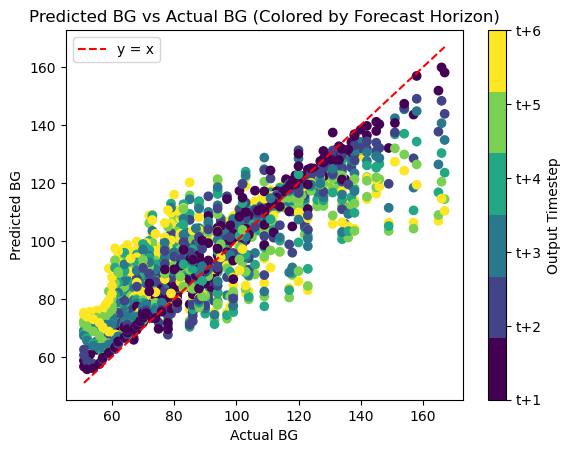

In [31]:
all_preds2 = []
all_truths2 = []
seq_length_in = 60 # Training on 300 mins of data (5 hours)
seq_length_out = 6 # 30 mins (~5 min interval each interation)
results2 = {}

for key, subset in normalized_data.items():
    print(f"\nRunning model for: {key}")
    
    try:
        preds, truths = RNN_indv(subset, seq_length_in, seq_length_out)
        all_preds2.append(preds)
        all_truths2.append(truths)
        results2[key] = (preds, truths)
    except Exception as e:
        print(f"Error for {key}: {e}")
        results2[key] = None


In [181]:
# Concatenate all predictions and truths
all_preds_concat2 = np.concatenate(all_preds2, axis=0).flatten()
all_truths_concat2 = np.concatenate(all_truths2, axis=0).flatten()

# Compute overall RMSE and MAE
combined_rmse2 = np.sqrt(mean_squared_error(all_truths_concat2, all_preds_concat2))
combined_mae2 = mean_absolute_error(all_truths_concat2, all_preds_concat2)

print(f"\nCombined RMSE across all IDs: {combined_rmse2:.2f} mg/dL")
print(f"Combined MAE  across all IDs: {combined_mae2:.2f} mg/dL\n")

# Lists to store RMSE and MAE per individual
rmse_per_individual = []
mae_per_individual = []

# Compute per-ID RMSE and MAE
for pred_array, true_array in zip(all_preds2, all_truths2):
    pred_flat = pred_array.flatten()
    true_flat = true_array.flatten()
    
    rmse = np.sqrt(mean_squared_error(true_flat, pred_flat))
    mae = mean_absolute_error(true_flat, pred_flat)
    
    rmse_per_individual.append(rmse)
    mae_per_individual.append(mae)

# Print all 56 RMSEs and MAEs
for i, (rmse, mae) in enumerate(zip(rmse_per_individual, mae_per_individual)):
    print(f"ID {i:2d}: RMSE = {rmse:.2f} mg/dL | MAE = {mae:.2f} mg/dL")

# Summary: min/max RMSE and MAE
print('\n')
print(f'The min RMSE is for ID {np.argmin(rmse_per_individual)} with a value of: {min(rmse_per_individual):.2f}')
print(f'The max RMSE is for ID {np.argmax(rmse_per_individual)} with a value of: {max(rmse_per_individual):.2f}')
print(f'The min MAE  is for ID {np.argmin(mae_per_individual)} with a value of: {min(mae_per_individual):.2f}')
print(f'The max MAE  is for ID {np.argmax(mae_per_individual)} with a value of: {max(mae_per_individual):.2f}')



Combined RMSE across all IDs: 12.70 mg/dL
Combined MAE  across all IDs: 8.32 mg/dL

ID  0: RMSE = 7.09 mg/dL | MAE = 4.86 mg/dL
ID  1: RMSE = 18.19 mg/dL | MAE = 11.05 mg/dL
ID  2: RMSE = 17.15 mg/dL | MAE = 10.51 mg/dL
ID  3: RMSE = 10.67 mg/dL | MAE = 8.11 mg/dL
ID  4: RMSE = 9.81 mg/dL | MAE = 6.49 mg/dL
ID  5: RMSE = 12.82 mg/dL | MAE = 9.92 mg/dL
ID  6: RMSE = 11.27 mg/dL | MAE = 7.35 mg/dL
ID  7: RMSE = 11.93 mg/dL | MAE = 7.60 mg/dL
ID  8: RMSE = 9.57 mg/dL | MAE = 6.76 mg/dL
ID  9: RMSE = 14.89 mg/dL | MAE = 9.79 mg/dL
ID 10: RMSE = 11.62 mg/dL | MAE = 7.21 mg/dL
ID 11: RMSE = 15.25 mg/dL | MAE = 9.69 mg/dL
ID 12: RMSE = 12.11 mg/dL | MAE = 9.04 mg/dL
ID 13: RMSE = 14.52 mg/dL | MAE = 10.96 mg/dL
ID 14: RMSE = 12.59 mg/dL | MAE = 9.17 mg/dL
ID 15: RMSE = 14.10 mg/dL | MAE = 10.37 mg/dL
ID 16: RMSE = 12.68 mg/dL | MAE = 8.27 mg/dL
ID 17: RMSE = 16.01 mg/dL | MAE = 11.48 mg/dL
ID 18: RMSE = 16.26 mg/dL | MAE = 12.50 mg/dL
ID 19: RMSE = 12.05 mg/dL | MAE = 8.60 mg/dL
ID 20: RMSE 


Running model for: id_0_data
Execution time: 26.958310842514038 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.7195909023284912 seconds
Execution time: 0.0009069442749023438 seconds
Execution time: 0.00018310546875 seconds


Overall Train RMSE: 8.919583351218614 mg/DL
Overall Test RMSE: 7.444172863969002 mg/DL


Train RMSE at t+1: 3.85 mg/DL
Train RMSE at t+2: 5.59 mg/DL
Train RMSE at t+3: 7.43 mg/DL
Train RMSE at t+4: 9.35 mg/DL
Train RMSE at t+5: 11.26 mg/DL
Train RMSE at t+6: 12.73 mg/DL


Test RMSE at t+1: 3.31 mg/DL
Test RMSE at t+2: 4.44 mg/DL
Test RMSE at t+3: 6.14 mg/DL
Test RMSE at t+4: 7.87 mg/DL
Test RMSE at t+5: 9.20 mg/DL
Test RMSE at t+6: 10.84 mg/DL


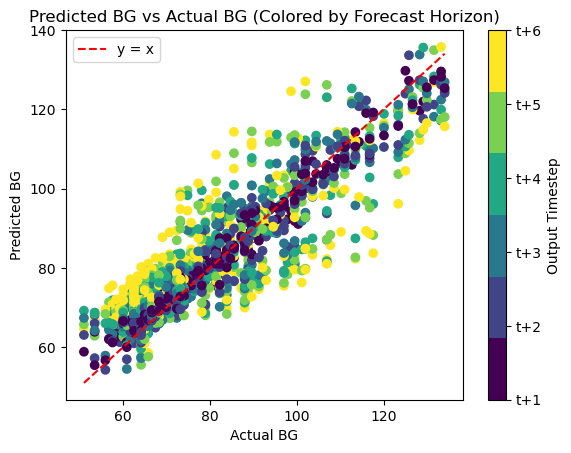


Running model for: id_1_data
Execution time: 27.108065128326416 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.7049117088317871 seconds
Execution time: 0.00074005126953125 seconds
Execution time: 0.00015211105346679688 seconds


Overall Train RMSE: 12.257854159181228 mg/DL
Overall Test RMSE: 17.39788047105271 mg/DL


Train RMSE at t+1: 4.74 mg/DL
Train RMSE at t+2: 7.76 mg/DL
Train RMSE at t+3: 10.34 mg/DL
Train RMSE at t+4: 12.97 mg/DL
Train RMSE at t+5: 15.45 mg/DL
Train RMSE at t+6: 17.47 mg/DL


Test RMSE at t+1: 9.23 mg/DL
Test RMSE at t+2: 13.81 mg/DL
Test RMSE at t+3: 17.25 mg/DL
Test RMSE at t+4: 18.81 mg/DL
Test RMSE at t+5: 20.26 mg/DL
Test RMSE at t+6: 21.87 mg/DL


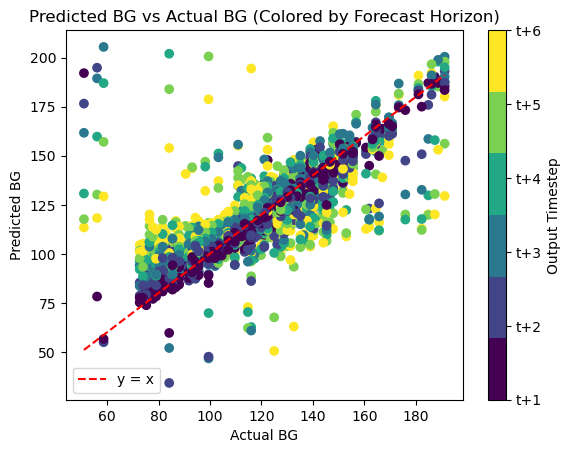


Running model for: id_2_data
Execution time: 29.23233389854431 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.7147030830383301 seconds
Execution time: 0.0006310939788818359 seconds
Execution time: 0.00015807151794433594 seconds


Overall Train RMSE: 7.857487464323328 mg/DL
Overall Test RMSE: 20.503170414860165 mg/DL


Train RMSE at t+1: 4.34 mg/DL
Train RMSE at t+2: 5.93 mg/DL
Train RMSE at t+3: 7.32 mg/DL
Train RMSE at t+4: 8.59 mg/DL
Train RMSE at t+5: 9.47 mg/DL
Train RMSE at t+6: 9.97 mg/DL


Test RMSE at t+1: 15.66 mg/DL
Test RMSE at t+2: 19.63 mg/DL
Test RMSE at t+3: 19.34 mg/DL
Test RMSE at t+4: 20.12 mg/DL
Test RMSE at t+5: 23.11 mg/DL
Test RMSE at t+6: 24.05 mg/DL


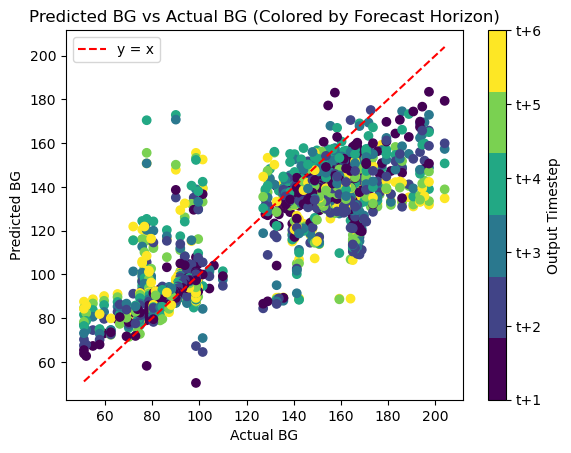


Running model for: id_3_data
Execution time: 22.450911045074463 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6914019584655762 seconds
Execution time: 0.00055694580078125 seconds
Execution time: 8.20159912109375e-05 seconds


Overall Train RMSE: 10.266028015674276 mg/DL
Overall Test RMSE: 9.575249491096828 mg/DL


Train RMSE at t+1: 5.78 mg/DL
Train RMSE at t+2: 7.98 mg/DL
Train RMSE at t+3: 9.92 mg/DL
Train RMSE at t+4: 11.15 mg/DL
Train RMSE at t+5: 12.10 mg/DL
Train RMSE at t+6: 12.89 mg/DL


Test RMSE at t+1: 5.51 mg/DL
Test RMSE at t+2: 7.52 mg/DL
Test RMSE at t+3: 9.16 mg/DL
Test RMSE at t+4: 10.22 mg/DL
Test RMSE at t+5: 11.32 mg/DL
Test RMSE at t+6: 12.11 mg/DL


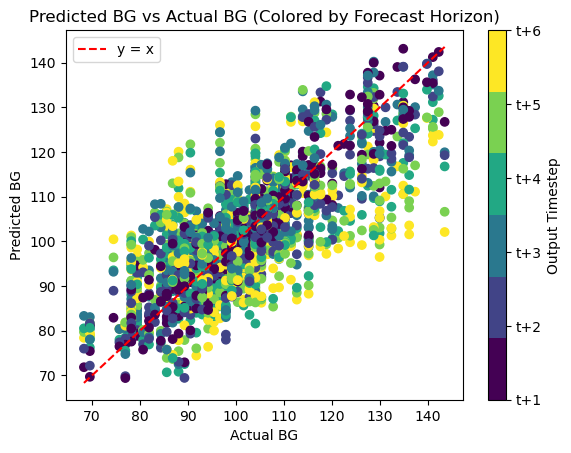


Running model for: id_4_data
Execution time: 27.57988691329956 seconds
54/54 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.7562010288238525 seconds
Execution time: 0.0007581710815429688 seconds
Execution time: 0.0001049041748046875 seconds


Overall Train RMSE: 11.152093985197052 mg/DL
Overall Test RMSE: 9.870794341611834 mg/DL


Train RMSE at t+1: 5.04 mg/DL
Train RMSE at t+2: 7.97 mg/DL
Train RMSE at t+3: 9.87 mg/DL
Train RMSE at t+4: 11.97 mg/DL
Train RMSE at t+5: 13.71 mg/DL
Train RMSE at t+6: 15.11 mg/DL


Test RMSE at t+1: 4.71 mg/DL
Test RMSE at t+2: 7.54 mg/DL
Test RMSE at t+3: 9.09 mg/DL
Test RMSE at t+4: 10.30 mg/DL
Test RMSE at t+5: 12.03 mg/DL
Test RMSE at t+6: 13.12 mg/DL


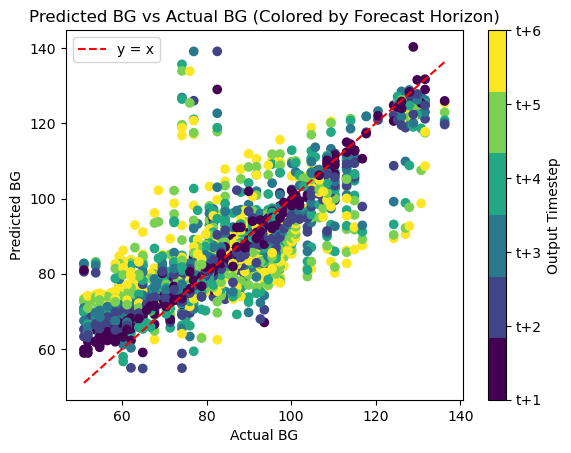


Running model for: id_5_data
Execution time: 26.91746211051941 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.7048141956329346 seconds
Execution time: 0.0006656646728515625 seconds
Execution time: 9.131431579589844e-05 seconds


Overall Train RMSE: 14.850965015541698 mg/DL
Overall Test RMSE: 12.292225267898392 mg/DL


Train RMSE at t+1: 6.28 mg/DL
Train RMSE at t+2: 10.06 mg/DL
Train RMSE at t+3: 14.09 mg/DL
Train RMSE at t+4: 16.31 mg/DL
Train RMSE at t+5: 18.12 mg/DL
Train RMSE at t+6: 19.74 mg/DL


Test RMSE at t+1: 6.49 mg/DL
Test RMSE at t+2: 9.39 mg/DL
Test RMSE at t+3: 12.27 mg/DL
Test RMSE at t+4: 13.60 mg/DL
Test RMSE at t+5: 14.36 mg/DL
Test RMSE at t+6: 15.31 mg/DL


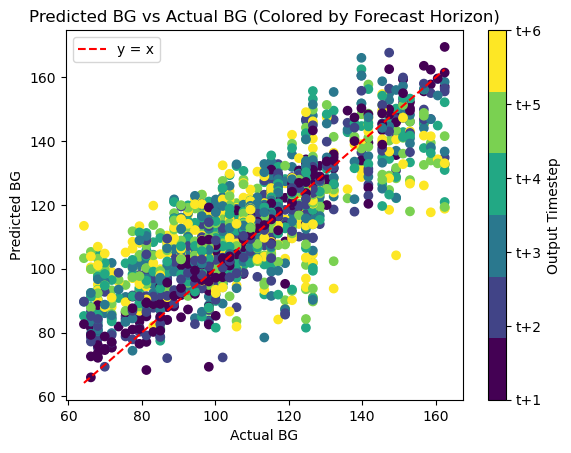


Running model for: id_6_data
Execution time: 25.571537017822266 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6953840255737305 seconds
Execution time: 0.0006771087646484375 seconds
Execution time: 0.0001850128173828125 seconds


Overall Train RMSE: 9.477779449237024 mg/DL
Overall Test RMSE: 10.905233012955387 mg/DL


Train RMSE at t+1: 3.73 mg/DL
Train RMSE at t+2: 5.89 mg/DL
Train RMSE at t+3: 7.99 mg/DL
Train RMSE at t+4: 10.05 mg/DL
Train RMSE at t+5: 11.97 mg/DL
Train RMSE at t+6: 13.50 mg/DL


Test RMSE at t+1: 5.32 mg/DL
Test RMSE at t+2: 7.83 mg/DL
Test RMSE at t+3: 10.04 mg/DL
Test RMSE at t+4: 12.01 mg/DL
Test RMSE at t+5: 13.44 mg/DL
Test RMSE at t+6: 14.09 mg/DL


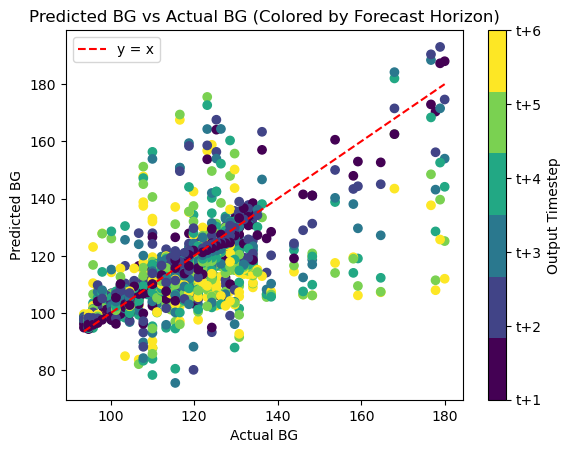


Running model for: id_7_data
Execution time: 23.299540042877197 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6623082160949707 seconds
Execution time: 0.0006139278411865234 seconds
Execution time: 0.00016880035400390625 seconds


Overall Train RMSE: 13.97822128708026 mg/DL
Overall Test RMSE: 13.038182757751098 mg/DL


Train RMSE at t+1: 9.38 mg/DL
Train RMSE at t+2: 11.71 mg/DL
Train RMSE at t+3: 13.48 mg/DL
Train RMSE at t+4: 14.61 mg/DL
Train RMSE at t+5: 16.02 mg/DL
Train RMSE at t+6: 17.19 mg/DL


Test RMSE at t+1: 10.10 mg/DL
Test RMSE at t+2: 11.26 mg/DL
Test RMSE at t+3: 12.68 mg/DL
Test RMSE at t+4: 13.05 mg/DL
Test RMSE at t+5: 14.57 mg/DL
Test RMSE at t+6: 15.74 mg/DL


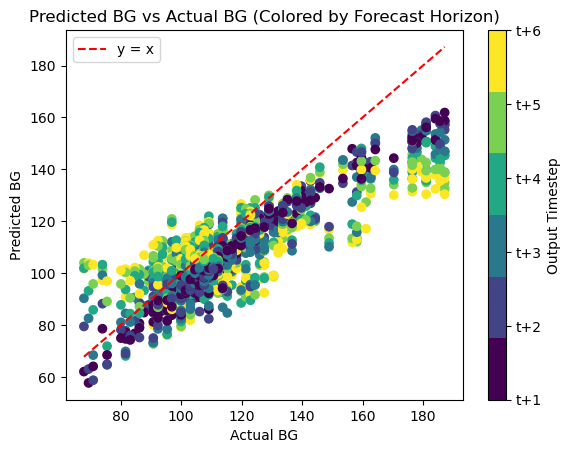


Running model for: id_8_data
Execution time: 22.71846914291382 seconds
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.601362943649292 seconds
Execution time: 0.0005741119384765625 seconds
Execution time: 0.00013113021850585938 seconds


Overall Train RMSE: 10.911206806872185 mg/DL
Overall Test RMSE: 9.604058924932968 mg/DL


Train RMSE at t+1: 4.35 mg/DL
Train RMSE at t+2: 7.13 mg/DL
Train RMSE at t+3: 9.50 mg/DL
Train RMSE at t+4: 11.88 mg/DL
Train RMSE at t+5: 13.68 mg/DL
Train RMSE at t+6: 15.03 mg/DL


Test RMSE at t+1: 4.03 mg/DL
Test RMSE at t+2: 6.46 mg/DL
Test RMSE at t+3: 8.72 mg/DL
Test RMSE at t+4: 10.79 mg/DL
Test RMSE at t+5: 11.93 mg/DL
Test RMSE at t+6: 12.67 mg/DL


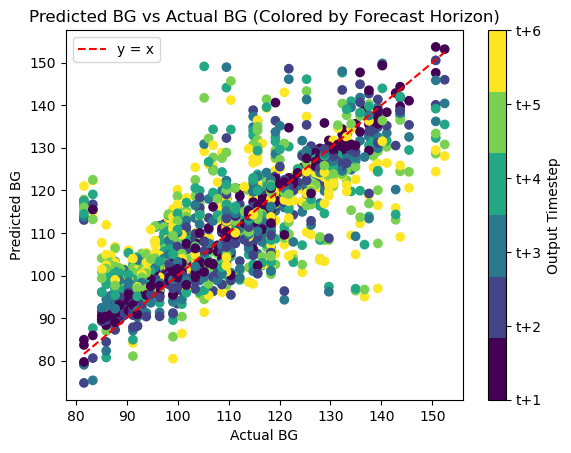


Running model for: id_9_data
Execution time: 24.64575695991516 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.732048749923706 seconds
Execution time: 0.0006182193756103516 seconds
Execution time: 0.00016880035400390625 seconds


Overall Train RMSE: 11.694506565630991 mg/DL
Overall Test RMSE: 14.293989351512664 mg/DL


Train RMSE at t+1: 5.13 mg/DL
Train RMSE at t+2: 7.85 mg/DL
Train RMSE at t+3: 10.27 mg/DL
Train RMSE at t+4: 12.57 mg/DL
Train RMSE at t+5: 14.37 mg/DL
Train RMSE at t+6: 16.20 mg/DL


Test RMSE at t+1: 7.27 mg/DL
Test RMSE at t+2: 10.47 mg/DL
Test RMSE at t+3: 13.21 mg/DL
Test RMSE at t+4: 15.20 mg/DL
Test RMSE at t+5: 17.03 mg/DL
Test RMSE at t+6: 19.18 mg/DL


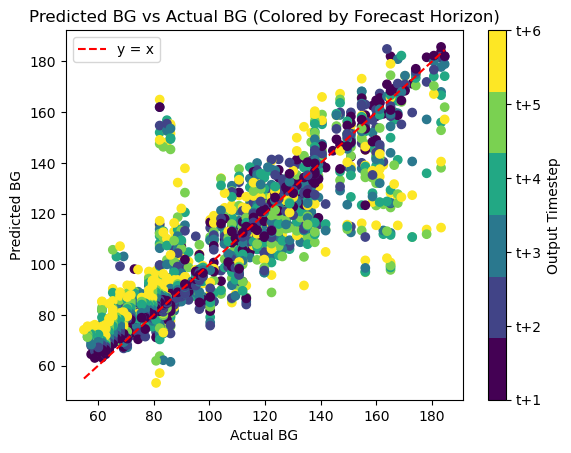


Running model for: id_10_data
Execution time: 27.35472297668457 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6908910274505615 seconds
Execution time: 0.0005996227264404297 seconds
Execution time: 0.00013780593872070312 seconds


Overall Train RMSE: 11.763340543483677 mg/DL
Overall Test RMSE: 11.261099219062617 mg/DL


Train RMSE at t+1: 4.84 mg/DL
Train RMSE at t+2: 7.71 mg/DL
Train RMSE at t+3: 10.07 mg/DL
Train RMSE at t+4: 12.78 mg/DL
Train RMSE at t+5: 14.92 mg/DL
Train RMSE at t+6: 16.13 mg/DL


Test RMSE at t+1: 3.59 mg/DL
Test RMSE at t+2: 6.42 mg/DL
Test RMSE at t+3: 8.95 mg/DL
Test RMSE at t+4: 11.96 mg/DL
Test RMSE at t+5: 14.55 mg/DL
Test RMSE at t+6: 16.49 mg/DL


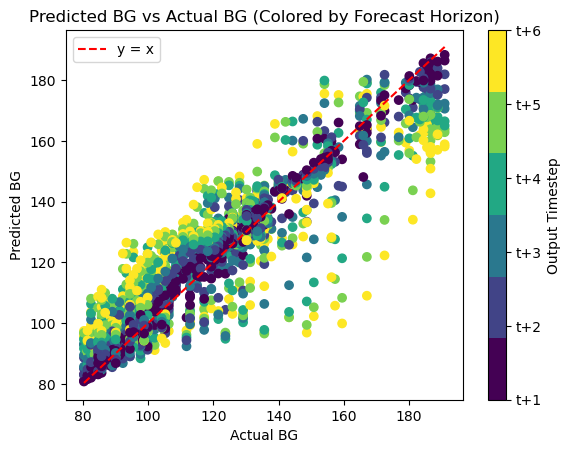


Running model for: id_11_data
Execution time: 24.90079402923584 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6344420909881592 seconds
Execution time: 0.0006849765777587891 seconds
Execution time: 0.00015687942504882812 seconds


Overall Train RMSE: 10.660632470027991 mg/DL
Overall Test RMSE: 15.9120688109815 mg/DL


Train RMSE at t+1: 6.76 mg/DL
Train RMSE at t+2: 8.51 mg/DL
Train RMSE at t+3: 9.75 mg/DL
Train RMSE at t+4: 11.29 mg/DL
Train RMSE at t+5: 12.44 mg/DL
Train RMSE at t+6: 13.66 mg/DL


Test RMSE at t+1: 9.49 mg/DL
Test RMSE at t+2: 12.50 mg/DL
Test RMSE at t+3: 14.43 mg/DL
Test RMSE at t+4: 16.84 mg/DL
Test RMSE at t+5: 19.22 mg/DL
Test RMSE at t+6: 20.29 mg/DL


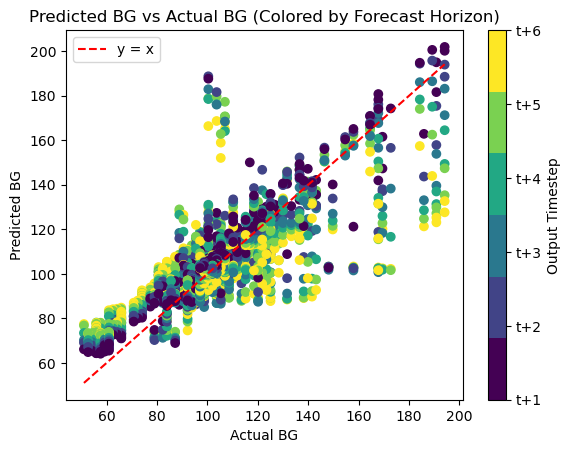


Running model for: id_12_data
Execution time: 23.089863777160645 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.9034252166748047 seconds
Execution time: 0.0006389617919921875 seconds
Execution time: 0.00016880035400390625 seconds


Overall Train RMSE: 9.08913849414196 mg/DL
Overall Test RMSE: 11.766621182675419 mg/DL


Train RMSE at t+1: 4.39 mg/DL
Train RMSE at t+2: 6.70 mg/DL
Train RMSE at t+3: 8.42 mg/DL
Train RMSE at t+4: 9.98 mg/DL
Train RMSE at t+5: 10.98 mg/DL
Train RMSE at t+6: 11.86 mg/DL


Test RMSE at t+1: 7.06 mg/DL
Test RMSE at t+2: 9.61 mg/DL
Test RMSE at t+3: 11.03 mg/DL
Test RMSE at t+4: 12.28 mg/DL
Test RMSE at t+5: 13.98 mg/DL
Test RMSE at t+6: 14.85 mg/DL


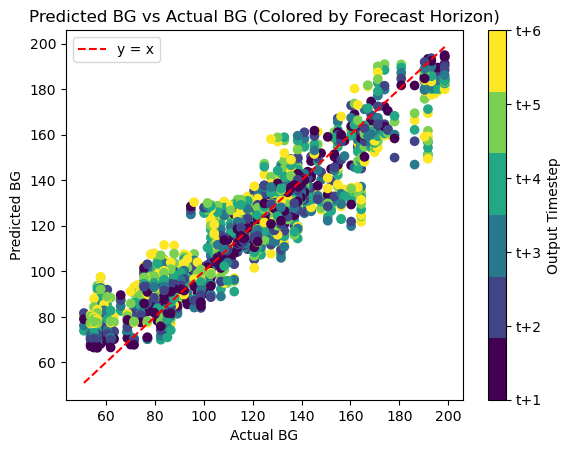


Running model for: id_13_data
Execution time: 23.35417604446411 seconds
59/59 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6965999603271484 seconds
Execution time: 0.0006399154663085938 seconds
Execution time: 0.00013589859008789062 seconds


Overall Train RMSE: 14.607847524970119 mg/DL
Overall Test RMSE: 15.971574780006694 mg/DL


Train RMSE at t+1: 8.01 mg/DL
Train RMSE at t+2: 11.44 mg/DL
Train RMSE at t+3: 13.37 mg/DL
Train RMSE at t+4: 15.81 mg/DL
Train RMSE at t+5: 17.26 mg/DL
Train RMSE at t+6: 18.93 mg/DL


Test RMSE at t+1: 8.31 mg/DL
Test RMSE at t+2: 12.21 mg/DL
Test RMSE at t+3: 14.35 mg/DL
Test RMSE at t+4: 17.36 mg/DL
Test RMSE at t+5: 18.98 mg/DL
Test RMSE at t+6: 21.09 mg/DL


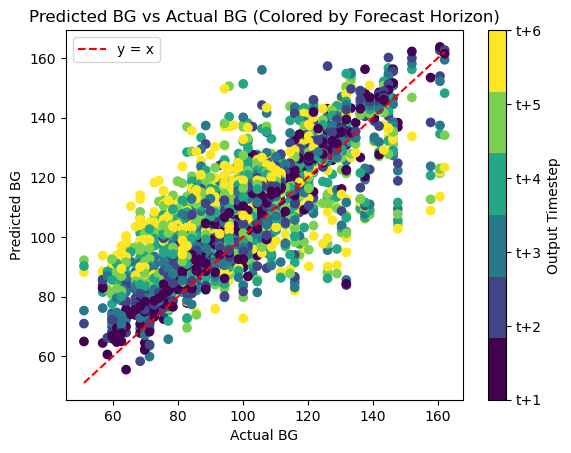


Running model for: id_14_data
Execution time: 22.705697059631348 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.633051872253418 seconds
Execution time: 0.00057220458984375 seconds
Execution time: 0.00015997886657714844 seconds


Overall Train RMSE: 11.339770434574936 mg/DL
Overall Test RMSE: 12.286510438166856 mg/DL


Train RMSE at t+1: 7.15 mg/DL
Train RMSE at t+2: 8.52 mg/DL
Train RMSE at t+3: 10.46 mg/DL
Train RMSE at t+4: 11.95 mg/DL
Train RMSE at t+5: 13.41 mg/DL
Train RMSE at t+6: 14.69 mg/DL


Test RMSE at t+1: 6.82 mg/DL
Test RMSE at t+2: 8.38 mg/DL
Test RMSE at t+3: 10.73 mg/DL
Test RMSE at t+4: 12.95 mg/DL
Test RMSE at t+5: 15.00 mg/DL
Test RMSE at t+6: 16.77 mg/DL


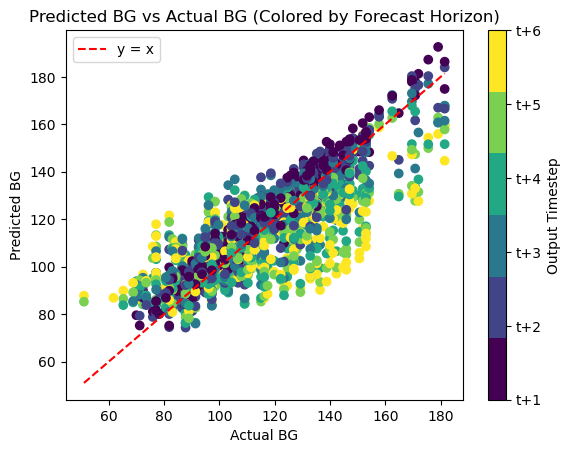


Running model for: id_15_data
Execution time: 23.392385005950928 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6380031108856201 seconds
Execution time: 0.0007050037384033203 seconds
Execution time: 0.000186920166015625 seconds


Overall Train RMSE: 11.620082903397948 mg/DL
Overall Test RMSE: 13.058643109082933 mg/DL


Train RMSE at t+1: 6.74 mg/DL
Train RMSE at t+2: 9.61 mg/DL
Train RMSE at t+3: 11.41 mg/DL
Train RMSE at t+4: 12.59 mg/DL
Train RMSE at t+5: 13.56 mg/DL
Train RMSE at t+6: 14.14 mg/DL


Test RMSE at t+1: 7.17 mg/DL
Test RMSE at t+2: 10.47 mg/DL
Test RMSE at t+3: 12.72 mg/DL
Test RMSE at t+4: 14.14 mg/DL
Test RMSE at t+5: 15.39 mg/DL
Test RMSE at t+6: 16.23 mg/DL


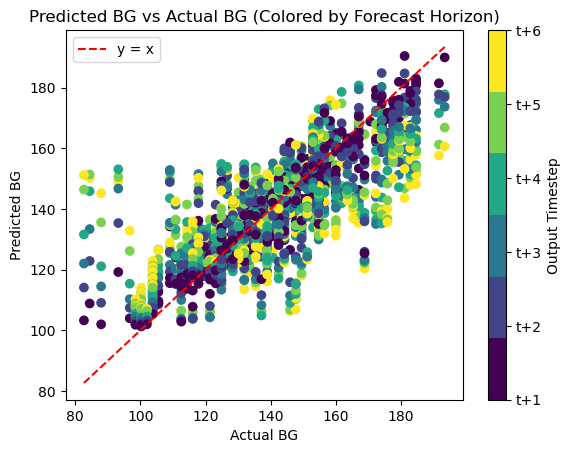


Running model for: id_16_data
Execution time: 23.577494144439697 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6100790500640869 seconds
Execution time: 0.0006520748138427734 seconds
Execution time: 0.00017905235290527344 seconds


Overall Train RMSE: 14.0623992191833 mg/DL
Overall Test RMSE: 12.602529193453535 mg/DL


Train RMSE at t+1: 5.91 mg/DL
Train RMSE at t+2: 9.78 mg/DL
Train RMSE at t+3: 12.91 mg/DL
Train RMSE at t+4: 15.45 mg/DL
Train RMSE at t+5: 17.51 mg/DL
Train RMSE at t+6: 18.54 mg/DL


Test RMSE at t+1: 5.02 mg/DL
Test RMSE at t+2: 8.53 mg/DL
Test RMSE at t+3: 11.47 mg/DL
Test RMSE at t+4: 13.87 mg/DL
Test RMSE at t+5: 15.85 mg/DL
Test RMSE at t+6: 16.73 mg/DL


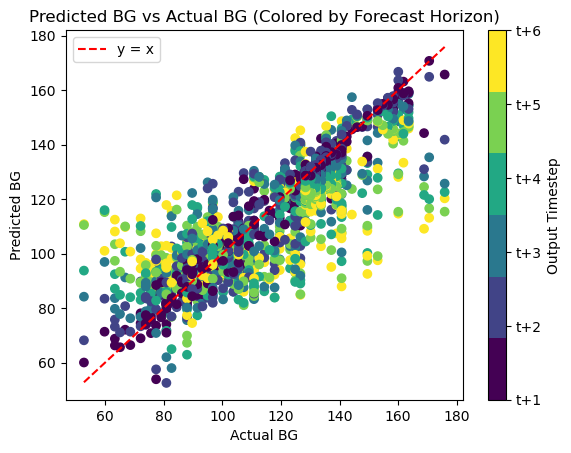


Running model for: id_17_data
Execution time: 23.934705018997192 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6381030082702637 seconds
Execution time: 0.0006241798400878906 seconds
Execution time: 0.00016689300537109375 seconds


Overall Train RMSE: 13.758664483735833 mg/DL
Overall Test RMSE: 15.266101858993549 mg/DL


Train RMSE at t+1: 7.00 mg/DL
Train RMSE at t+2: 10.27 mg/DL
Train RMSE at t+3: 13.16 mg/DL
Train RMSE at t+4: 14.95 mg/DL
Train RMSE at t+5: 16.56 mg/DL
Train RMSE at t+6: 17.62 mg/DL


Test RMSE at t+1: 8.72 mg/DL
Test RMSE at t+2: 12.26 mg/DL
Test RMSE at t+3: 14.75 mg/DL
Test RMSE at t+4: 16.77 mg/DL
Test RMSE at t+5: 17.89 mg/DL
Test RMSE at t+6: 18.79 mg/DL


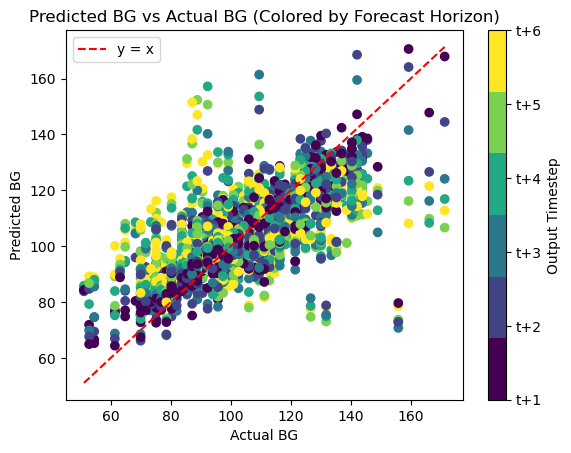


Running model for: id_18_data
Execution time: 23.43932604789734 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6205830574035645 seconds
Execution time: 0.0007269382476806641 seconds
Execution time: 0.00015473365783691406 seconds


Overall Train RMSE: 15.352223702572616 mg/DL
Overall Test RMSE: 14.382736634903283 mg/DL


Train RMSE at t+1: 8.33 mg/DL
Train RMSE at t+2: 12.05 mg/DL
Train RMSE at t+3: 13.43 mg/DL
Train RMSE at t+4: 16.54 mg/DL
Train RMSE at t+5: 18.56 mg/DL
Train RMSE at t+6: 20.03 mg/DL


Test RMSE at t+1: 6.95 mg/DL
Test RMSE at t+2: 10.96 mg/DL
Test RMSE at t+3: 12.84 mg/DL
Test RMSE at t+4: 15.41 mg/DL
Test RMSE at t+5: 17.41 mg/DL
Test RMSE at t+6: 19.17 mg/DL


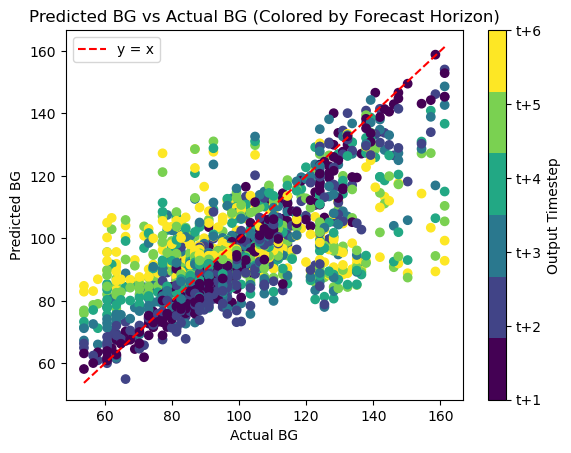


Running model for: id_19_data
Execution time: 24.50697684288025 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6617379188537598 seconds
Execution time: 0.0007638931274414062 seconds
Execution time: 0.0001537799835205078 seconds


Overall Train RMSE: 14.828238999845677 mg/DL
Overall Test RMSE: 12.38041619307742 mg/DL


Train RMSE at t+1: 6.03 mg/DL
Train RMSE at t+2: 9.83 mg/DL
Train RMSE at t+3: 13.16 mg/DL
Train RMSE at t+4: 16.18 mg/DL
Train RMSE at t+5: 18.40 mg/DL
Train RMSE at t+6: 20.32 mg/DL


Test RMSE at t+1: 6.04 mg/DL
Test RMSE at t+2: 9.20 mg/DL
Test RMSE at t+3: 11.72 mg/DL
Test RMSE at t+4: 13.36 mg/DL
Test RMSE at t+5: 14.95 mg/DL
Test RMSE at t+6: 16.09 mg/DL


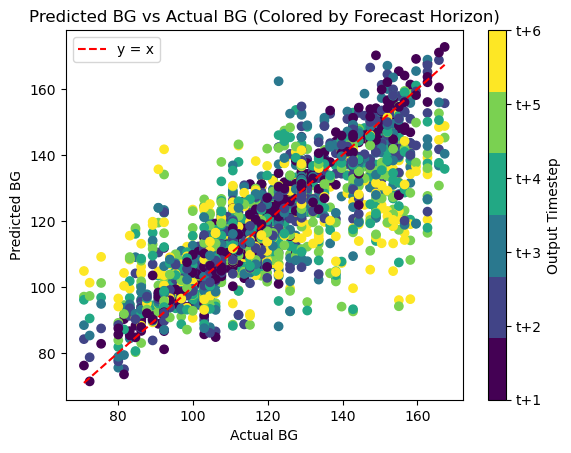


Running model for: id_20_data
Execution time: 22.926799774169922 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6709940433502197 seconds
Execution time: 0.0008099079132080078 seconds
Execution time: 0.00017309188842773438 seconds


Overall Train RMSE: 9.955336163848886 mg/DL
Overall Test RMSE: 23.035772396923534 mg/DL


Train RMSE at t+1: 3.78 mg/DL
Train RMSE at t+2: 6.14 mg/DL
Train RMSE at t+3: 9.33 mg/DL
Train RMSE at t+4: 10.48 mg/DL
Train RMSE at t+5: 12.62 mg/DL
Train RMSE at t+6: 13.66 mg/DL


Test RMSE at t+1: 19.40 mg/DL
Test RMSE at t+2: 11.14 mg/DL
Test RMSE at t+3: 17.09 mg/DL
Test RMSE at t+4: 22.47 mg/DL
Test RMSE at t+5: 25.16 mg/DL
Test RMSE at t+6: 35.41 mg/DL


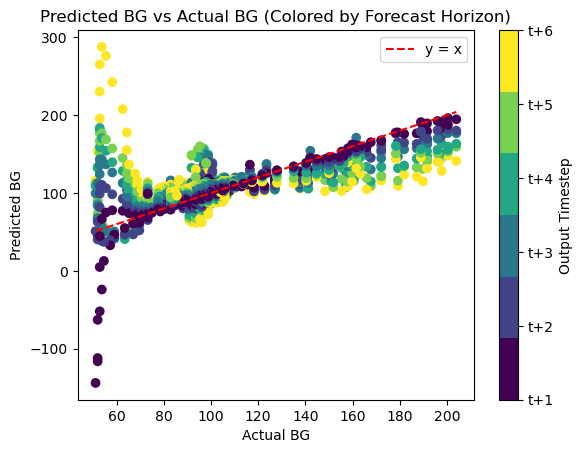


Running model for: id_21_data
Execution time: 25.508461236953735 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.63649582862854 seconds
Execution time: 0.0009899139404296875 seconds
Execution time: 0.0003178119659423828 seconds


Overall Train RMSE: 8.85948233690847 mg/DL
Overall Test RMSE: 11.409789177122295 mg/DL


Train RMSE at t+1: 3.61 mg/DL
Train RMSE at t+2: 6.05 mg/DL
Train RMSE at t+3: 7.05 mg/DL
Train RMSE at t+4: 8.98 mg/DL
Train RMSE at t+5: 11.35 mg/DL
Train RMSE at t+6: 12.73 mg/DL


Test RMSE at t+1: 4.40 mg/DL
Test RMSE at t+2: 6.92 mg/DL
Test RMSE at t+3: 8.89 mg/DL
Test RMSE at t+4: 11.63 mg/DL
Test RMSE at t+5: 14.79 mg/DL
Test RMSE at t+6: 16.76 mg/DL


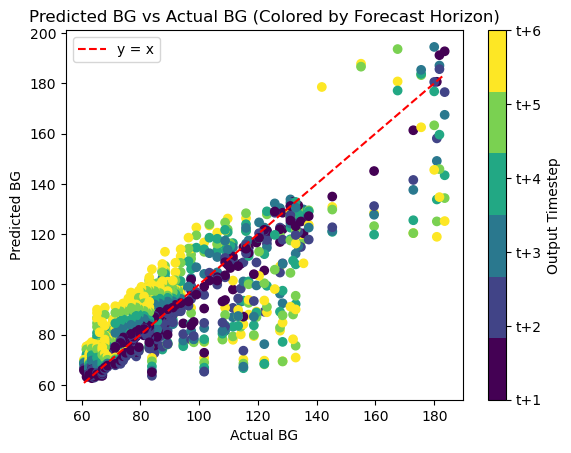


Running model for: id_22_data
Execution time: 23.330395936965942 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.634166955947876 seconds
Execution time: 0.0006029605865478516 seconds
Execution time: 8.58306884765625e-05 seconds


Overall Train RMSE: 14.482301801119652 mg/DL
Overall Test RMSE: 13.456217144940297 mg/DL


Train RMSE at t+1: 6.85 mg/DL
Train RMSE at t+2: 9.05 mg/DL
Train RMSE at t+3: 12.29 mg/DL
Train RMSE at t+4: 15.17 mg/DL
Train RMSE at t+5: 18.22 mg/DL
Train RMSE at t+6: 20.40 mg/DL


Test RMSE at t+1: 6.97 mg/DL
Test RMSE at t+2: 8.74 mg/DL
Test RMSE at t+3: 11.42 mg/DL
Test RMSE at t+4: 13.78 mg/DL
Test RMSE at t+5: 16.86 mg/DL
Test RMSE at t+6: 18.89 mg/DL


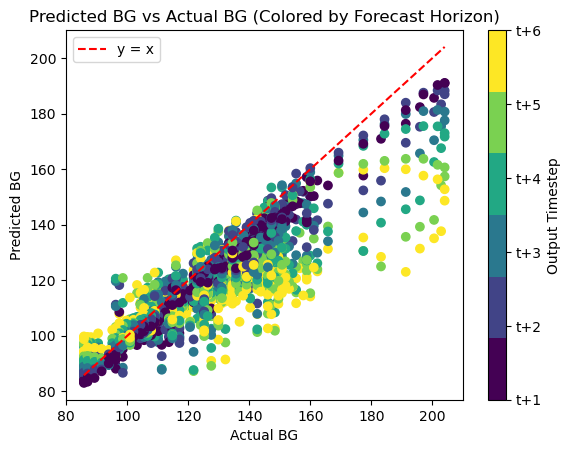


Running model for: id_23_data
Execution time: 23.448221921920776 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6315572261810303 seconds
Execution time: 0.0006608963012695312 seconds
Execution time: 0.00018286705017089844 seconds


Overall Train RMSE: 6.681447471128512 mg/DL
Overall Test RMSE: 17.060472418207002 mg/DL


Train RMSE at t+1: 3.53 mg/DL
Train RMSE at t+2: 4.89 mg/DL
Train RMSE at t+3: 6.13 mg/DL
Train RMSE at t+4: 7.21 mg/DL
Train RMSE at t+5: 8.09 mg/DL
Train RMSE at t+6: 8.74 mg/DL


Test RMSE at t+1: 12.62 mg/DL
Test RMSE at t+2: 13.46 mg/DL
Test RMSE at t+3: 15.97 mg/DL
Test RMSE at t+4: 17.71 mg/DL
Test RMSE at t+5: 19.79 mg/DL
Test RMSE at t+6: 21.11 mg/DL


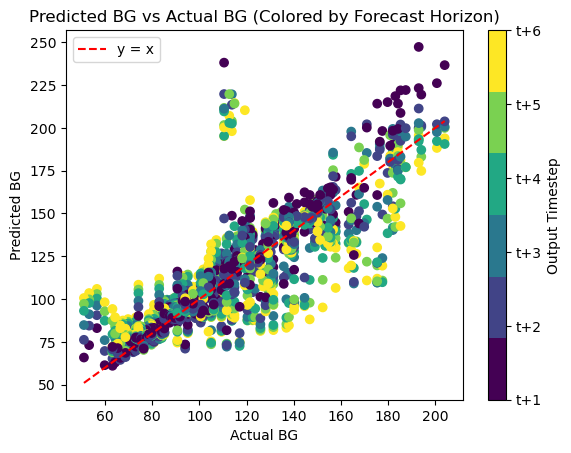


Running model for: id_24_data
Execution time: 22.464777946472168 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6351470947265625 seconds
Execution time: 0.0006210803985595703 seconds
Execution time: 0.000164031982421875 seconds


Overall Train RMSE: 10.127154076913119 mg/DL
Overall Test RMSE: 13.42328285658247 mg/DL


Train RMSE at t+1: 4.85 mg/DL
Train RMSE at t+2: 7.09 mg/DL
Train RMSE at t+3: 9.22 mg/DL
Train RMSE at t+4: 10.86 mg/DL
Train RMSE at t+5: 12.39 mg/DL
Train RMSE at t+6: 13.61 mg/DL


Test RMSE at t+1: 4.67 mg/DL
Test RMSE at t+2: 7.75 mg/DL
Test RMSE at t+3: 11.40 mg/DL
Test RMSE at t+4: 14.54 mg/DL
Test RMSE at t+5: 16.97 mg/DL
Test RMSE at t+6: 19.23 mg/DL


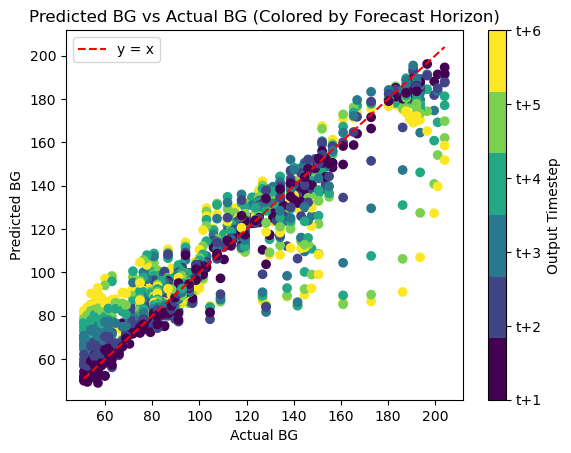


Running model for: id_25_data
Execution time: 22.294253826141357 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6191139221191406 seconds
Execution time: 0.0007092952728271484 seconds
Execution time: 0.0001800060272216797 seconds


Overall Train RMSE: 12.294613816519337 mg/DL
Overall Test RMSE: 11.145758690216333 mg/DL


Train RMSE at t+1: 4.57 mg/DL
Train RMSE at t+2: 7.43 mg/DL
Train RMSE at t+3: 10.25 mg/DL
Train RMSE at t+4: 13.12 mg/DL
Train RMSE at t+5: 15.54 mg/DL
Train RMSE at t+6: 17.67 mg/DL


Test RMSE at t+1: 3.77 mg/DL
Test RMSE at t+2: 6.64 mg/DL
Test RMSE at t+3: 9.43 mg/DL
Test RMSE at t+4: 12.02 mg/DL
Test RMSE at t+5: 14.05 mg/DL
Test RMSE at t+6: 16.01 mg/DL


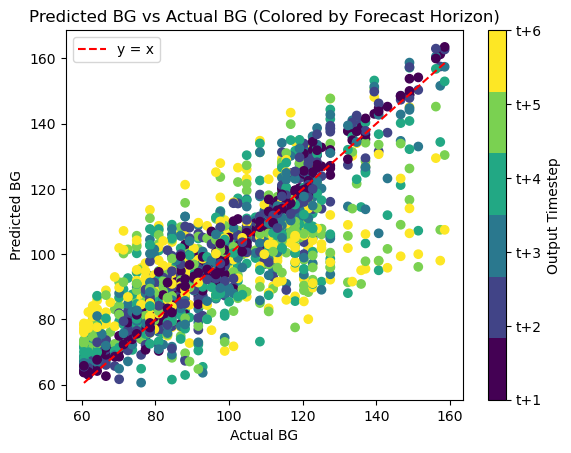


Running model for: id_26_data
Execution time: 22.845870971679688 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6154239177703857 seconds
Execution time: 0.0007658004760742188 seconds
Execution time: 8.797645568847656e-05 seconds


Overall Train RMSE: 7.329839188658275 mg/DL
Overall Test RMSE: 6.724514133034174 mg/DL


Train RMSE at t+1: 3.62 mg/DL
Train RMSE at t+2: 4.33 mg/DL
Train RMSE at t+3: 6.41 mg/DL
Train RMSE at t+4: 7.62 mg/DL
Train RMSE at t+5: 8.98 mg/DL
Train RMSE at t+6: 10.52 mg/DL


Test RMSE at t+1: 4.12 mg/DL
Test RMSE at t+2: 4.77 mg/DL
Test RMSE at t+3: 6.25 mg/DL
Test RMSE at t+4: 7.32 mg/DL
Test RMSE at t+5: 7.88 mg/DL
Test RMSE at t+6: 8.76 mg/DL


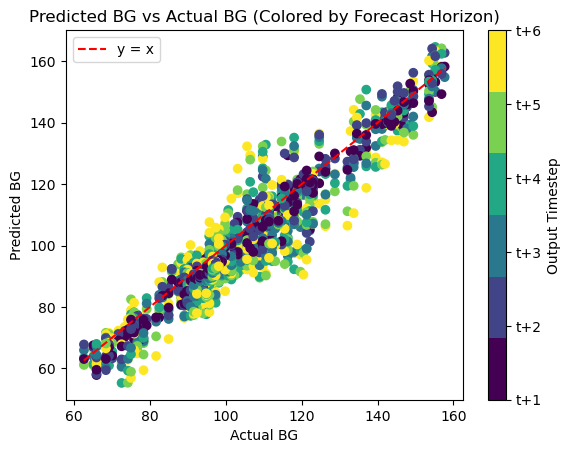


Running model for: id_27_data
Execution time: 22.35015606880188 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6143298149108887 seconds
Execution time: 0.0005819797515869141 seconds
Execution time: 0.0001590251922607422 seconds


Overall Train RMSE: 13.452642655026583 mg/DL
Overall Test RMSE: 12.929456976981735 mg/DL


Train RMSE at t+1: 6.60 mg/DL
Train RMSE at t+2: 9.52 mg/DL
Train RMSE at t+3: 11.81 mg/DL
Train RMSE at t+4: 14.51 mg/DL
Train RMSE at t+5: 16.49 mg/DL
Train RMSE at t+6: 18.15 mg/DL


Test RMSE at t+1: 5.40 mg/DL
Test RMSE at t+2: 8.58 mg/DL
Test RMSE at t+3: 12.05 mg/DL
Test RMSE at t+4: 14.54 mg/DL
Test RMSE at t+5: 16.26 mg/DL
Test RMSE at t+6: 16.72 mg/DL


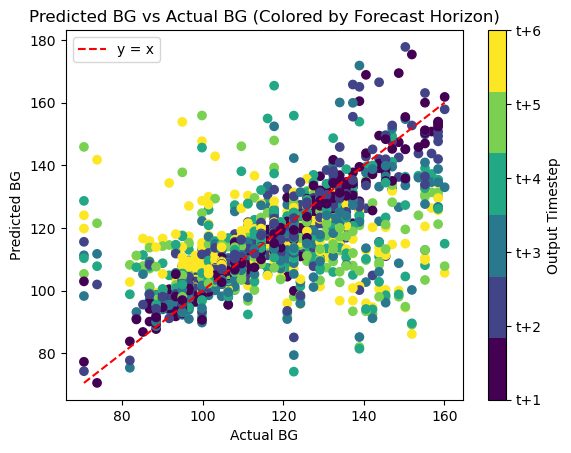


Running model for: id_28_data
Execution time: 22.462426900863647 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6538140773773193 seconds
Execution time: 0.0006380081176757812 seconds
Execution time: 0.000164031982421875 seconds


Overall Train RMSE: 11.514148890452761 mg/DL
Overall Test RMSE: 10.388028624829845 mg/DL


Train RMSE at t+1: 5.50 mg/DL
Train RMSE at t+2: 8.33 mg/DL
Train RMSE at t+3: 10.58 mg/DL
Train RMSE at t+4: 12.68 mg/DL
Train RMSE at t+5: 14.02 mg/DL
Train RMSE at t+6: 15.06 mg/DL


Test RMSE at t+1: 4.47 mg/DL
Test RMSE at t+2: 7.02 mg/DL
Test RMSE at t+3: 9.19 mg/DL
Test RMSE at t+4: 11.23 mg/DL
Test RMSE at t+5: 12.83 mg/DL
Test RMSE at t+6: 14.24 mg/DL


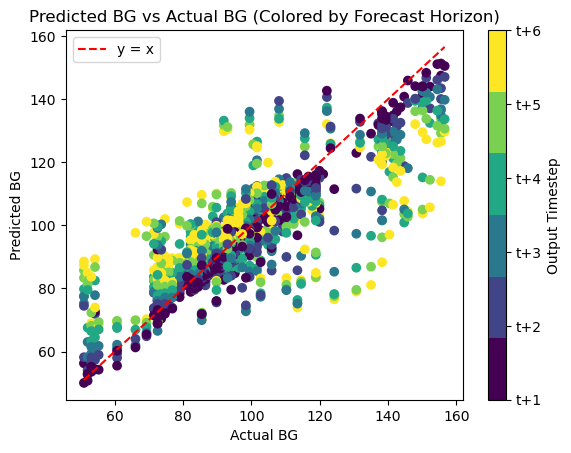


Running model for: id_29_data
Execution time: 21.80002784729004 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6235058307647705 seconds
Execution time: 0.0007710456848144531 seconds
Execution time: 0.00015473365783691406 seconds


Overall Train RMSE: 14.193767830116615 mg/DL
Overall Test RMSE: 14.118285742066252 mg/DL


Train RMSE at t+1: 6.71 mg/DL
Train RMSE at t+2: 10.40 mg/DL
Train RMSE at t+3: 13.44 mg/DL
Train RMSE at t+4: 15.57 mg/DL
Train RMSE at t+5: 17.24 mg/DL
Train RMSE at t+6: 18.31 mg/DL


Test RMSE at t+1: 5.59 mg/DL
Test RMSE at t+2: 9.14 mg/DL
Test RMSE at t+3: 12.29 mg/DL
Test RMSE at t+4: 15.60 mg/DL
Test RMSE at t+5: 17.54 mg/DL
Test RMSE at t+6: 19.47 mg/DL


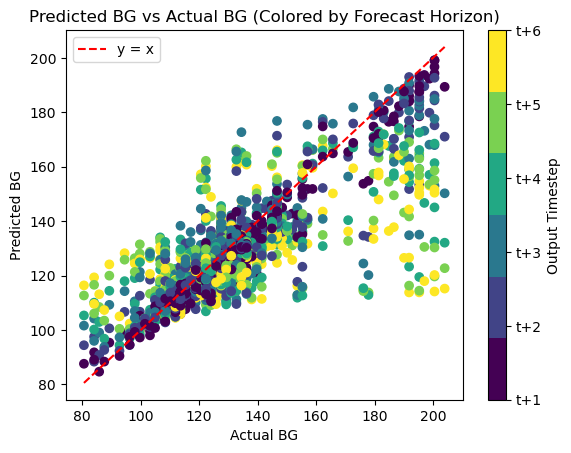


Running model for: id_30_data
Execution time: 22.396466970443726 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6152501106262207 seconds
Execution time: 0.0007259845733642578 seconds
Execution time: 0.00017881393432617188 seconds


Overall Train RMSE: 12.516617371440406 mg/DL
Overall Test RMSE: 12.128542084686613 mg/DL


Train RMSE at t+1: 5.78 mg/DL
Train RMSE at t+2: 8.90 mg/DL
Train RMSE at t+3: 11.33 mg/DL
Train RMSE at t+4: 13.60 mg/DL
Train RMSE at t+5: 15.49 mg/DL
Train RMSE at t+6: 16.56 mg/DL


Test RMSE at t+1: 5.00 mg/DL
Test RMSE at t+2: 8.12 mg/DL
Test RMSE at t+3: 10.48 mg/DL
Test RMSE at t+4: 12.95 mg/DL
Test RMSE at t+5: 15.40 mg/DL
Test RMSE at t+6: 16.64 mg/DL


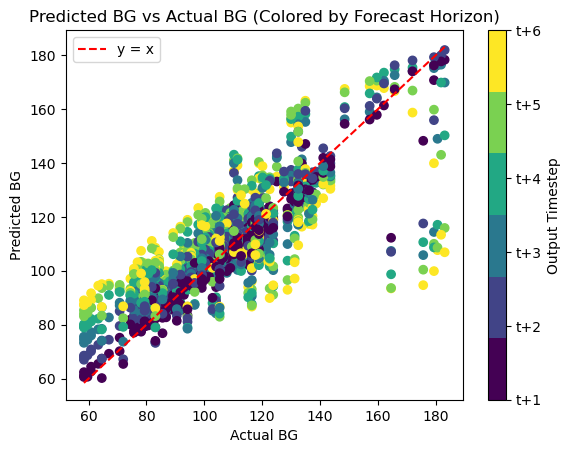


Running model for: id_31_data
Execution time: 22.176979064941406 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6194329261779785 seconds
Execution time: 0.0006930828094482422 seconds
Execution time: 0.00015401840209960938 seconds


Overall Train RMSE: 16.87561477615427 mg/DL
Overall Test RMSE: 12.583875626964426 mg/DL


Train RMSE at t+1: 8.32 mg/DL
Train RMSE at t+2: 12.13 mg/DL
Train RMSE at t+3: 15.43 mg/DL
Train RMSE at t+4: 18.25 mg/DL
Train RMSE at t+5: 20.81 mg/DL
Train RMSE at t+6: 22.09 mg/DL


Test RMSE at t+1: 7.16 mg/DL
Test RMSE at t+2: 9.17 mg/DL
Test RMSE at t+3: 11.22 mg/DL
Test RMSE at t+4: 12.89 mg/DL
Test RMSE at t+5: 15.60 mg/DL
Test RMSE at t+6: 16.72 mg/DL


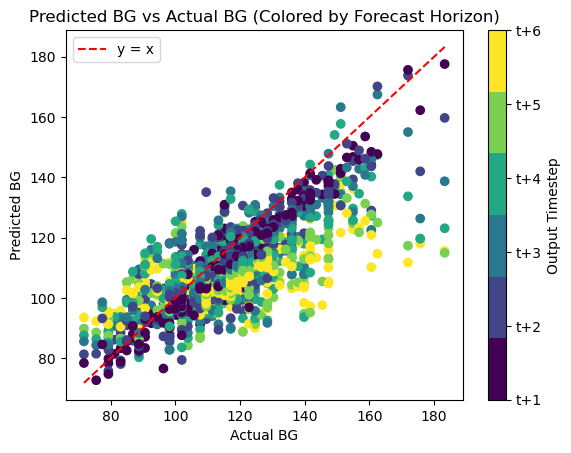


Running model for: id_32_data
Execution time: 18.271042108535767 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6332569122314453 seconds
Execution time: 0.0006880760192871094 seconds
Execution time: 0.0001480579376220703 seconds


Overall Train RMSE: 9.251570550390598 mg/DL
Overall Test RMSE: 12.616944668524113 mg/DL


Train RMSE at t+1: 3.90 mg/DL
Train RMSE at t+2: 6.23 mg/DL
Train RMSE at t+3: 8.12 mg/DL
Train RMSE at t+4: 9.94 mg/DL
Train RMSE at t+5: 11.60 mg/DL
Train RMSE at t+6: 12.66 mg/DL


Test RMSE at t+1: 5.12 mg/DL
Test RMSE at t+2: 8.00 mg/DL
Test RMSE at t+3: 10.86 mg/DL
Test RMSE at t+4: 13.63 mg/DL
Test RMSE at t+5: 16.01 mg/DL
Test RMSE at t+6: 17.46 mg/DL


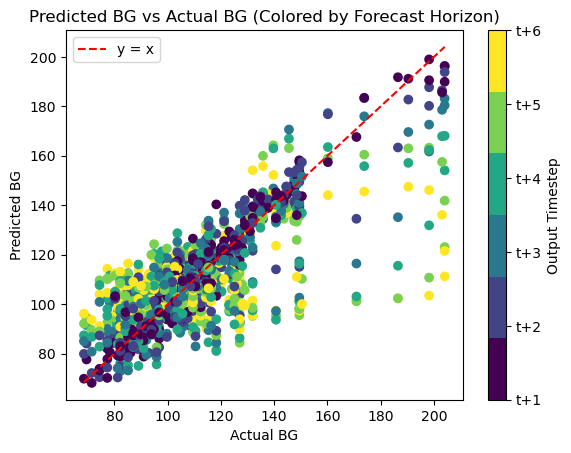


Running model for: id_33_data
Execution time: 22.372828245162964 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6590299606323242 seconds
Execution time: 0.0006039142608642578 seconds
Execution time: 0.00017523765563964844 seconds


Overall Train RMSE: 14.950329470243199 mg/DL
Overall Test RMSE: 15.024178517233034 mg/DL


Train RMSE at t+1: 7.48 mg/DL
Train RMSE at t+2: 10.16 mg/DL
Train RMSE at t+3: 13.38 mg/DL
Train RMSE at t+4: 16.85 mg/DL
Train RMSE at t+5: 18.01 mg/DL
Train RMSE at t+6: 19.87 mg/DL


Test RMSE at t+1: 7.89 mg/DL
Test RMSE at t+2: 11.24 mg/DL
Test RMSE at t+3: 14.32 mg/DL
Test RMSE at t+4: 16.68 mg/DL
Test RMSE at t+5: 17.90 mg/DL
Test RMSE at t+6: 19.03 mg/DL


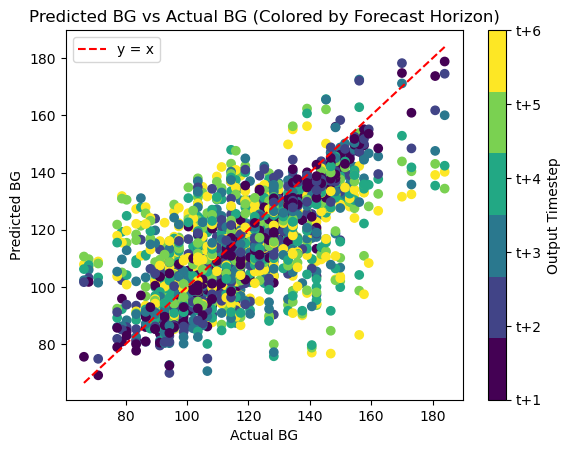


Running model for: id_34_data
Execution time: 18.79086399078369 seconds
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6495018005371094 seconds
Execution time: 0.0007069110870361328 seconds
Execution time: 0.00016379356384277344 seconds


Overall Train RMSE: 8.589097249013864 mg/DL
Overall Test RMSE: 14.684123745006424 mg/DL


Train RMSE at t+1: 4.84 mg/DL
Train RMSE at t+2: 6.53 mg/DL
Train RMSE at t+3: 8.04 mg/DL
Train RMSE at t+4: 9.22 mg/DL
Train RMSE at t+5: 10.27 mg/DL
Train RMSE at t+6: 11.02 mg/DL


Test RMSE at t+1: 7.73 mg/DL
Test RMSE at t+2: 10.91 mg/DL
Test RMSE at t+3: 13.04 mg/DL
Test RMSE at t+4: 15.50 mg/DL
Test RMSE at t+5: 17.84 mg/DL
Test RMSE at t+6: 19.66 mg/DL


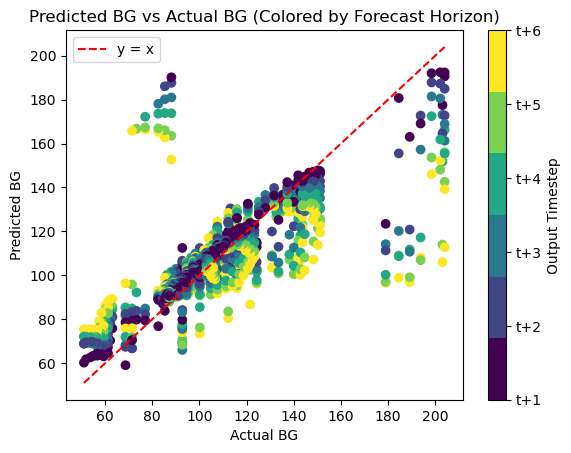


Running model for: id_35_data
Execution time: 22.387444019317627 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6171791553497314 seconds
Execution time: 0.0007560253143310547 seconds
Execution time: 0.00015997886657714844 seconds


Overall Train RMSE: 10.423803963716082 mg/DL
Overall Test RMSE: 7.314779227023865 mg/DL


Train RMSE at t+1: 5.73 mg/DL
Train RMSE at t+2: 7.81 mg/DL
Train RMSE at t+3: 9.49 mg/DL
Train RMSE at t+4: 11.42 mg/DL
Train RMSE at t+5: 12.44 mg/DL
Train RMSE at t+6: 13.53 mg/DL


Test RMSE at t+1: 3.48 mg/DL
Test RMSE at t+2: 5.31 mg/DL
Test RMSE at t+3: 6.62 mg/DL
Test RMSE at t+4: 8.27 mg/DL
Test RMSE at t+5: 8.77 mg/DL
Test RMSE at t+6: 9.57 mg/DL


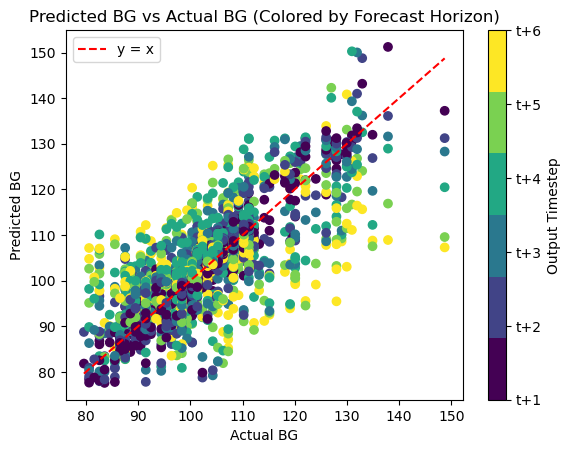


Running model for: id_36_data
Execution time: 22.83544397354126 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.653278112411499 seconds
Execution time: 0.0008580684661865234 seconds
Execution time: 0.0001647472381591797 seconds


Overall Train RMSE: 12.076797861616479 mg/DL
Overall Test RMSE: 10.647109032287906 mg/DL


Train RMSE at t+1: 4.59 mg/DL
Train RMSE at t+2: 7.43 mg/DL
Train RMSE at t+3: 10.19 mg/DL
Train RMSE at t+4: 12.79 mg/DL
Train RMSE at t+5: 15.25 mg/DL
Train RMSE at t+6: 17.29 mg/DL


Test RMSE at t+1: 4.01 mg/DL
Test RMSE at t+2: 6.65 mg/DL
Test RMSE at t+3: 9.35 mg/DL
Test RMSE at t+4: 11.52 mg/DL
Test RMSE at t+5: 13.40 mg/DL
Test RMSE at t+6: 14.84 mg/DL


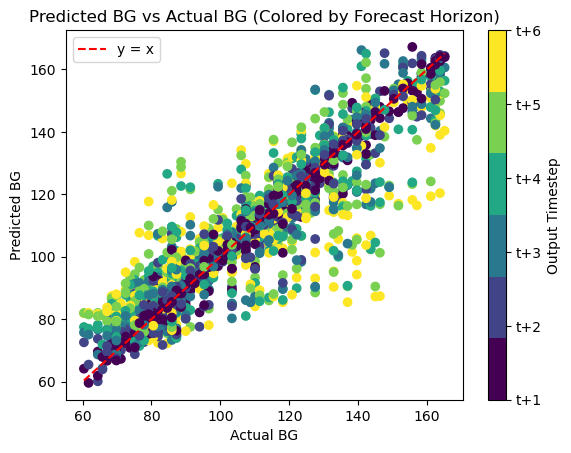


Running model for: id_37_data
Execution time: 22.480469942092896 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.61733078956604 seconds
Execution time: 0.0005753040313720703 seconds
Execution time: 0.0001628398895263672 seconds


Overall Train RMSE: 6.961612684256254 mg/DL
Overall Test RMSE: 12.337724790893693 mg/DL


Train RMSE at t+1: 3.15 mg/DL
Train RMSE at t+2: 4.87 mg/DL
Train RMSE at t+3: 6.10 mg/DL
Train RMSE at t+4: 7.18 mg/DL
Train RMSE at t+5: 8.48 mg/DL
Train RMSE at t+6: 9.82 mg/DL


Test RMSE at t+1: 5.10 mg/DL
Test RMSE at t+2: 8.13 mg/DL
Test RMSE at t+3: 10.96 mg/DL
Test RMSE at t+4: 13.06 mg/DL
Test RMSE at t+5: 15.38 mg/DL
Test RMSE at t+6: 17.14 mg/DL


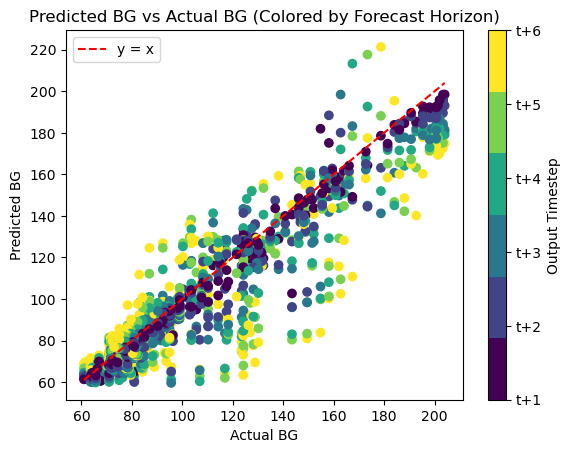


Running model for: id_38_data
Execution time: 21.631289958953857 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6198830604553223 seconds
Execution time: 0.0005748271942138672 seconds
Execution time: 0.00016498565673828125 seconds


Overall Train RMSE: 11.313216020280061 mg/DL
Overall Test RMSE: 10.281920986750963 mg/DL


Train RMSE at t+1: 6.00 mg/DL
Train RMSE at t+2: 8.22 mg/DL
Train RMSE at t+3: 10.14 mg/DL
Train RMSE at t+4: 12.63 mg/DL
Train RMSE at t+5: 13.65 mg/DL
Train RMSE at t+6: 14.69 mg/DL


Test RMSE at t+1: 5.16 mg/DL
Test RMSE at t+2: 7.17 mg/DL
Test RMSE at t+3: 9.03 mg/DL
Test RMSE at t+4: 11.25 mg/DL
Test RMSE at t+5: 12.53 mg/DL
Test RMSE at t+6: 13.83 mg/DL


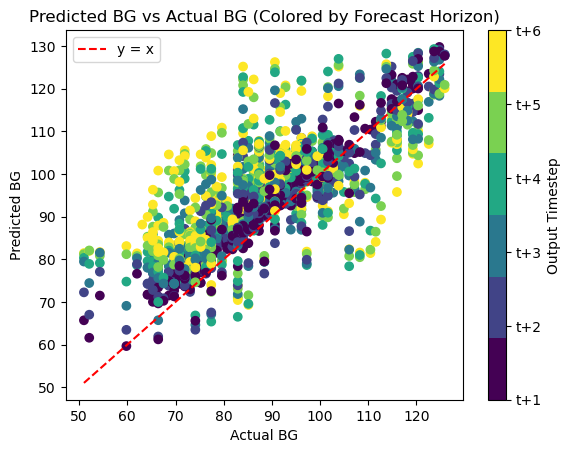


Running model for: id_39_data
Execution time: 21.918495178222656 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6206729412078857 seconds
Execution time: 0.0008358955383300781 seconds
Execution time: 0.00016617774963378906 seconds


Overall Train RMSE: 11.11176265961263 mg/DL
Overall Test RMSE: 13.867132728651029 mg/DL


Train RMSE at t+1: 4.85 mg/DL
Train RMSE at t+2: 6.84 mg/DL
Train RMSE at t+3: 9.33 mg/DL
Train RMSE at t+4: 11.72 mg/DL
Train RMSE at t+5: 13.84 mg/DL
Train RMSE at t+6: 15.96 mg/DL


Test RMSE at t+1: 5.46 mg/DL
Test RMSE at t+2: 8.20 mg/DL
Test RMSE at t+3: 11.39 mg/DL
Test RMSE at t+4: 14.36 mg/DL
Test RMSE at t+5: 17.53 mg/DL
Test RMSE at t+6: 20.33 mg/DL


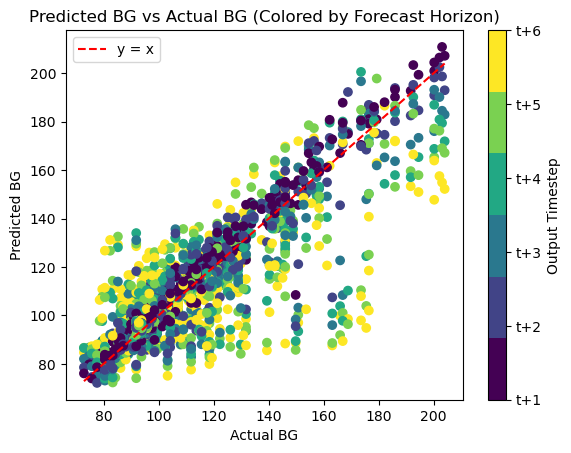


Running model for: id_40_data
Execution time: 22.90097212791443 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6368978023529053 seconds
Execution time: 0.0006639957427978516 seconds
Execution time: 0.0001552104949951172 seconds


Overall Train RMSE: 9.2768984274057 mg/DL
Overall Test RMSE: 10.992039477063063 mg/DL


Train RMSE at t+1: 5.97 mg/DL
Train RMSE at t+2: 6.94 mg/DL
Train RMSE at t+3: 7.55 mg/DL
Train RMSE at t+4: 8.92 mg/DL
Train RMSE at t+5: 10.89 mg/DL
Train RMSE at t+6: 13.32 mg/DL


Test RMSE at t+1: 5.82 mg/DL
Test RMSE at t+2: 7.06 mg/DL
Test RMSE at t+3: 8.35 mg/DL
Test RMSE at t+4: 10.94 mg/DL
Test RMSE at t+5: 13.54 mg/DL
Test RMSE at t+6: 16.39 mg/DL


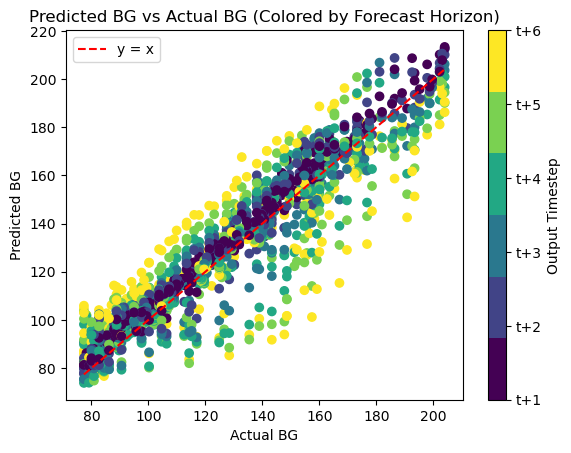


Running model for: id_41_data
Execution time: 26.147284030914307 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6902928352355957 seconds
Execution time: 0.0007290840148925781 seconds
Execution time: 0.00019097328186035156 seconds


Overall Train RMSE: 11.134273191360828 mg/DL
Overall Test RMSE: 12.981463292952565 mg/DL


Train RMSE at t+1: 8.79 mg/DL
Train RMSE at t+2: 8.15 mg/DL
Train RMSE at t+3: 9.96 mg/DL
Train RMSE at t+4: 11.06 mg/DL
Train RMSE at t+5: 13.21 mg/DL
Train RMSE at t+6: 14.29 mg/DL


Test RMSE at t+1: 9.70 mg/DL
Test RMSE at t+2: 9.35 mg/DL
Test RMSE at t+3: 11.68 mg/DL
Test RMSE at t+4: 13.04 mg/DL
Test RMSE at t+5: 15.41 mg/DL
Test RMSE at t+6: 16.91 mg/DL


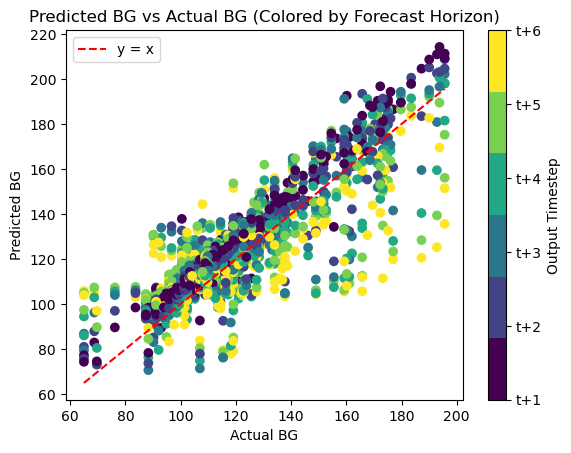


Running model for: id_42_data
Execution time: 27.40709400177002 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.693793773651123 seconds
Execution time: 0.0006878376007080078 seconds
Execution time: 0.00015497207641601562 seconds


Overall Train RMSE: 12.524890402952805 mg/DL
Overall Test RMSE: 12.917384761378793 mg/DL


Train RMSE at t+1: 8.71 mg/DL
Train RMSE at t+2: 10.75 mg/DL
Train RMSE at t+3: 10.89 mg/DL
Train RMSE at t+4: 13.09 mg/DL
Train RMSE at t+5: 14.57 mg/DL
Train RMSE at t+6: 15.74 mg/DL


Test RMSE at t+1: 9.68 mg/DL
Test RMSE at t+2: 11.43 mg/DL
Test RMSE at t+3: 11.04 mg/DL
Test RMSE at t+4: 13.19 mg/DL
Test RMSE at t+5: 14.75 mg/DL
Test RMSE at t+6: 16.23 mg/DL


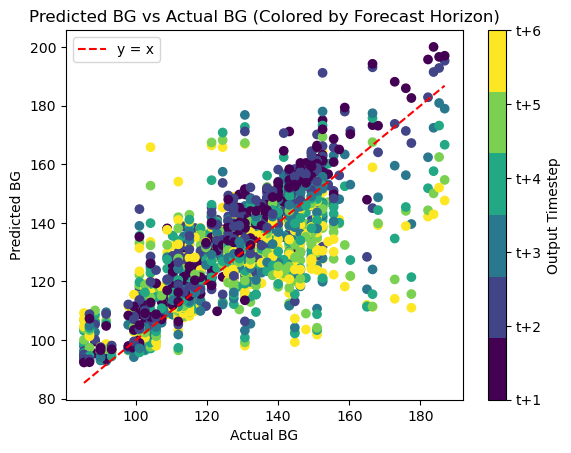


Running model for: id_43_data
Execution time: 24.961369037628174 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 3.3605759143829346 seconds
Execution time: 0.0006792545318603516 seconds
Execution time: 0.0002319812774658203 seconds


Overall Train RMSE: 10.132504147845374 mg/DL
Overall Test RMSE: 9.622685752751194 mg/DL


Train RMSE at t+1: 4.40 mg/DL
Train RMSE at t+2: 7.21 mg/DL
Train RMSE at t+3: 8.80 mg/DL
Train RMSE at t+4: 10.79 mg/DL
Train RMSE at t+5: 12.55 mg/DL
Train RMSE at t+6: 13.90 mg/DL


Test RMSE at t+1: 3.81 mg/DL
Test RMSE at t+2: 6.64 mg/DL
Test RMSE at t+3: 8.51 mg/DL
Test RMSE at t+4: 10.17 mg/DL
Test RMSE at t+5: 12.23 mg/DL
Test RMSE at t+6: 13.10 mg/DL


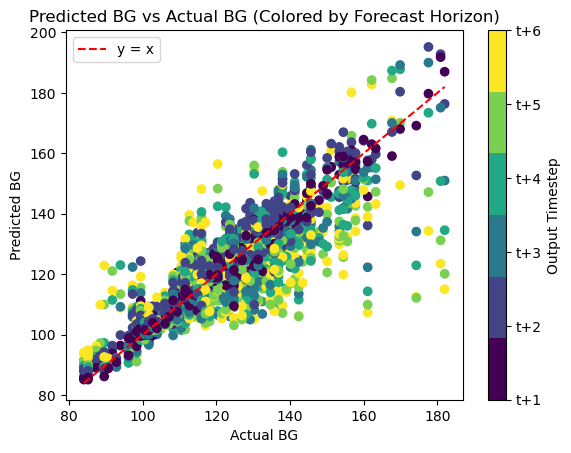


Running model for: id_44_data
Execution time: 26.03053307533264 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.7347609996795654 seconds
Execution time: 0.0006160736083984375 seconds
Execution time: 0.00012683868408203125 seconds


Overall Train RMSE: 11.140292907448123 mg/DL
Overall Test RMSE: 7.321275956017194 mg/DL


Train RMSE at t+1: 5.81 mg/DL
Train RMSE at t+2: 8.00 mg/DL
Train RMSE at t+3: 10.40 mg/DL
Train RMSE at t+4: 11.95 mg/DL
Train RMSE at t+5: 13.31 mg/DL
Train RMSE at t+6: 14.79 mg/DL


Test RMSE at t+1: 4.12 mg/DL
Test RMSE at t+2: 5.48 mg/DL
Test RMSE at t+3: 6.79 mg/DL
Test RMSE at t+4: 8.16 mg/DL
Test RMSE at t+5: 8.63 mg/DL
Test RMSE at t+6: 9.36 mg/DL


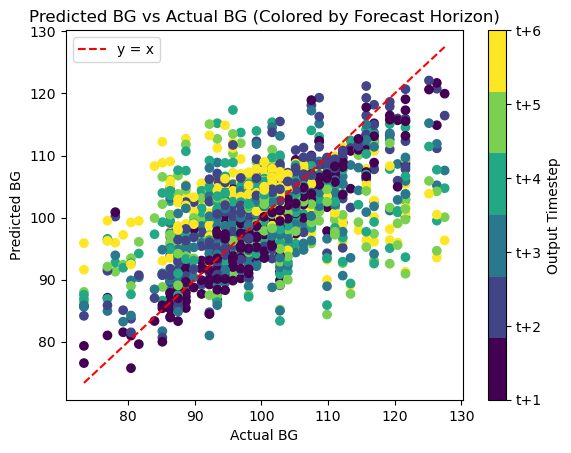


Running model for: id_45_data
Execution time: 25.827649116516113 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6886711120605469 seconds
Execution time: 0.0007810592651367188 seconds
Execution time: 9.799003601074219e-05 seconds


Overall Train RMSE: 11.409537975667575 mg/DL
Overall Test RMSE: 10.857738820289418 mg/DL


Train RMSE at t+1: 5.91 mg/DL
Train RMSE at t+2: 8.52 mg/DL
Train RMSE at t+3: 10.63 mg/DL
Train RMSE at t+4: 12.28 mg/DL
Train RMSE at t+5: 13.66 mg/DL
Train RMSE at t+6: 14.94 mg/DL


Test RMSE at t+1: 6.83 mg/DL
Test RMSE at t+2: 8.93 mg/DL
Test RMSE at t+3: 10.68 mg/DL
Test RMSE at t+4: 11.82 mg/DL
Test RMSE at t+5: 12.57 mg/DL
Test RMSE at t+6: 13.01 mg/DL


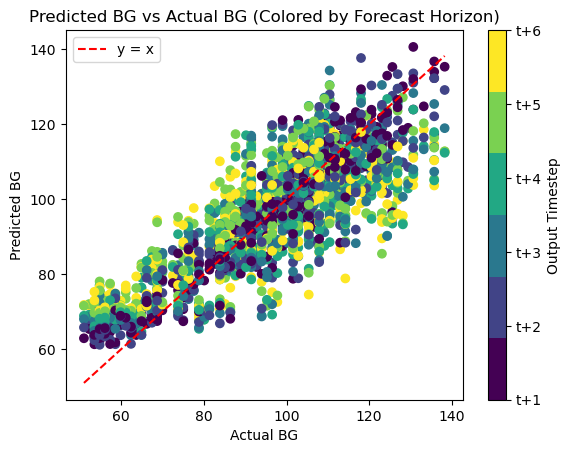


Running model for: id_46_data
Execution time: 25.8104829788208 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6912047863006592 seconds
Execution time: 0.0005772113800048828 seconds
Execution time: 8.511543273925781e-05 seconds


Overall Train RMSE: 9.522740882987819 mg/DL
Overall Test RMSE: 11.517152467817532 mg/DL


Train RMSE at t+1: 3.94 mg/DL
Train RMSE at t+2: 6.11 mg/DL
Train RMSE at t+3: 8.11 mg/DL
Train RMSE at t+4: 10.16 mg/DL
Train RMSE at t+5: 11.90 mg/DL
Train RMSE at t+6: 13.44 mg/DL


Test RMSE at t+1: 5.84 mg/DL
Test RMSE at t+2: 7.62 mg/DL
Test RMSE at t+3: 9.70 mg/DL
Test RMSE at t+4: 11.81 mg/DL
Test RMSE at t+5: 14.48 mg/DL
Test RMSE at t+6: 16.14 mg/DL


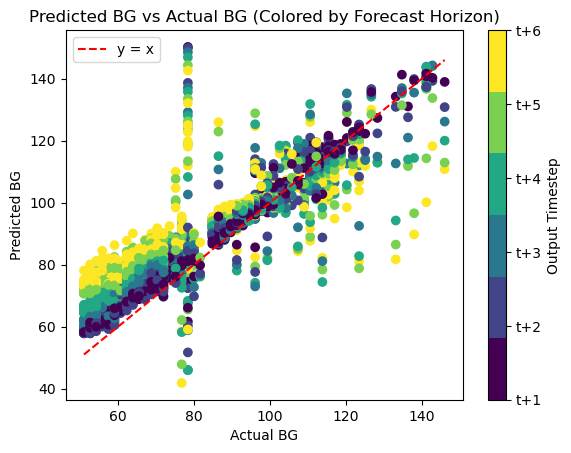


Running model for: id_47_data
Execution time: 25.31452488899231 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6878759860992432 seconds
Execution time: 0.0006468296051025391 seconds
Execution time: 0.00012493133544921875 seconds


Overall Train RMSE: 13.637181829735441 mg/DL
Overall Test RMSE: 9.622354624791333 mg/DL


Train RMSE at t+1: 6.18 mg/DL
Train RMSE at t+2: 9.73 mg/DL
Train RMSE at t+3: 12.45 mg/DL
Train RMSE at t+4: 15.12 mg/DL
Train RMSE at t+5: 16.76 mg/DL
Train RMSE at t+6: 17.84 mg/DL


Test RMSE at t+1: 4.80 mg/DL
Test RMSE at t+2: 6.80 mg/DL
Test RMSE at t+3: 8.60 mg/DL
Test RMSE at t+4: 10.61 mg/DL
Test RMSE at t+5: 11.67 mg/DL
Test RMSE at t+6: 12.79 mg/DL


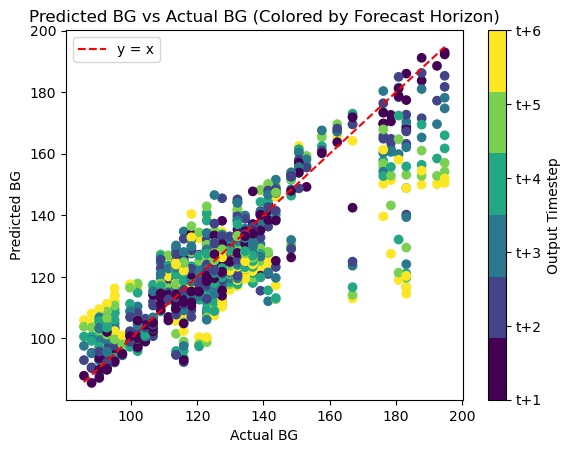


Running model for: id_48_data
Execution time: 25.140933752059937 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.6983039379119873 seconds
Execution time: 0.0006418228149414062 seconds
Execution time: 8.606910705566406e-05 seconds


Overall Train RMSE: 12.38447277981102 mg/DL
Overall Test RMSE: 9.213801449194063 mg/DL


Train RMSE at t+1: 5.69 mg/DL
Train RMSE at t+2: 8.85 mg/DL
Train RMSE at t+3: 11.49 mg/DL
Train RMSE at t+4: 13.62 mg/DL
Train RMSE at t+5: 15.36 mg/DL
Train RMSE at t+6: 16.00 mg/DL


Test RMSE at t+1: 4.13 mg/DL
Test RMSE at t+2: 6.39 mg/DL
Test RMSE at t+3: 8.33 mg/DL
Test RMSE at t+4: 10.06 mg/DL
Test RMSE at t+5: 11.62 mg/DL
Test RMSE at t+6: 12.07 mg/DL


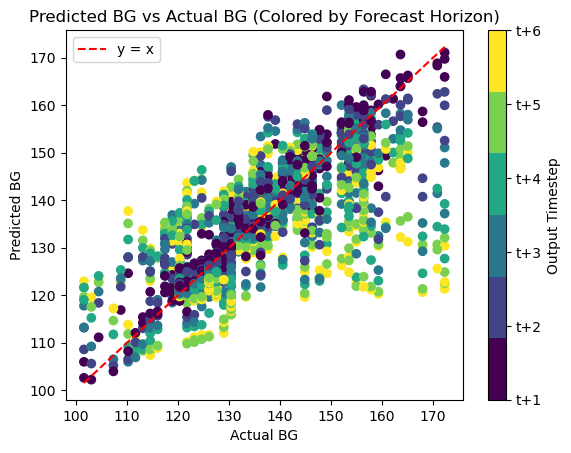


Running model for: id_49_data
Execution time: 23.571378231048584 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.5981490612030029 seconds
Execution time: 0.0007679462432861328 seconds
Execution time: 9.679794311523438e-05 seconds


Overall Train RMSE: 13.437067656746992 mg/DL
Overall Test RMSE: 14.922553718184936 mg/DL


Train RMSE at t+1: 5.23 mg/DL
Train RMSE at t+2: 8.53 mg/DL
Train RMSE at t+3: 11.82 mg/DL
Train RMSE at t+4: 14.24 mg/DL
Train RMSE at t+5: 16.92 mg/DL
Train RMSE at t+6: 18.83 mg/DL


Test RMSE at t+1: 6.38 mg/DL
Test RMSE at t+2: 9.55 mg/DL
Test RMSE at t+3: 12.81 mg/DL
Test RMSE at t+4: 15.49 mg/DL
Test RMSE at t+5: 18.70 mg/DL
Test RMSE at t+6: 21.23 mg/DL


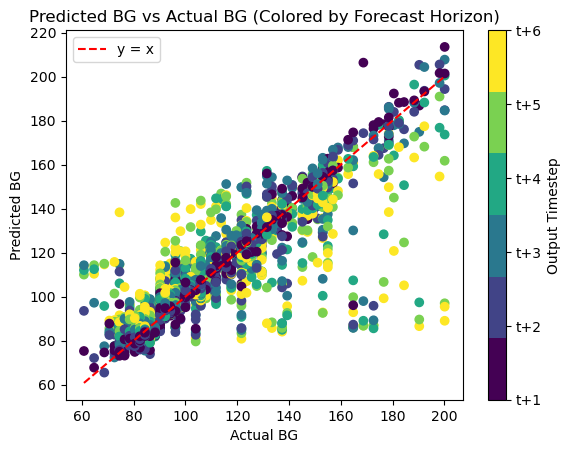


Running model for: id_50_data
Execution time: 22.86609983444214 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6374619007110596 seconds
Execution time: 0.0005700588226318359 seconds
Execution time: 0.0001289844512939453 seconds


Overall Train RMSE: 13.634026828043007 mg/DL
Overall Test RMSE: 13.367627366767367 mg/DL


Train RMSE at t+1: 8.55 mg/DL
Train RMSE at t+2: 9.83 mg/DL
Train RMSE at t+3: 12.78 mg/DL
Train RMSE at t+4: 14.46 mg/DL
Train RMSE at t+5: 16.25 mg/DL
Train RMSE at t+6: 17.58 mg/DL


Test RMSE at t+1: 8.47 mg/DL
Test RMSE at t+2: 9.05 mg/DL
Test RMSE at t+3: 12.43 mg/DL
Test RMSE at t+4: 14.30 mg/DL
Test RMSE at t+5: 16.16 mg/DL
Test RMSE at t+6: 17.27 mg/DL


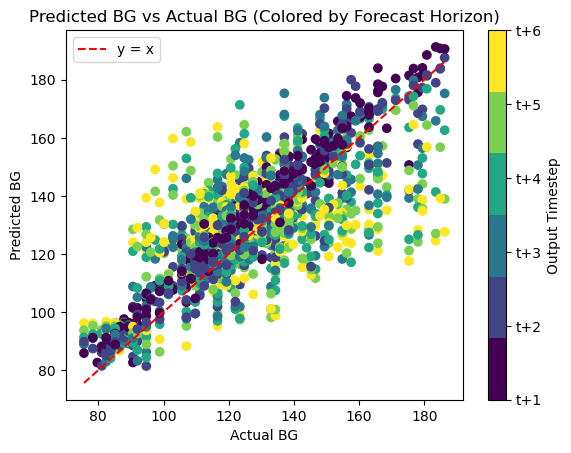


Running model for: id_51_data
Execution time: 18.287994861602783 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Execution time: 0.6256980895996094 seconds
Execution time: 0.0006411075592041016 seconds
Execution time: 0.0001289844512939453 seconds


Overall Train RMSE: 9.980683251899103 mg/DL
Overall Test RMSE: 9.679057186665307 mg/DL


Train RMSE at t+1: 4.54 mg/DL
Train RMSE at t+2: 6.93 mg/DL
Train RMSE at t+3: 9.06 mg/DL
Train RMSE at t+4: 10.63 mg/DL
Train RMSE at t+5: 12.34 mg/DL
Train RMSE at t+6: 13.48 mg/DL


Test RMSE at t+1: 4.18 mg/DL
Test RMSE at t+2: 6.77 mg/DL
Test RMSE at t+3: 8.69 mg/DL
Test RMSE at t+4: 10.08 mg/DL
Test RMSE at t+5: 12.05 mg/DL
Test RMSE at t+6: 13.29 mg/DL


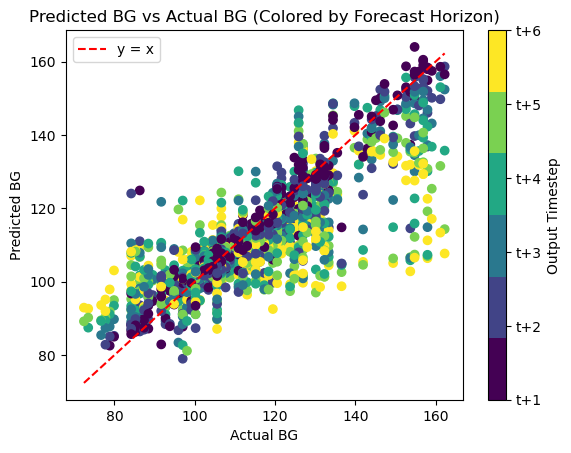


Running model for: id_52_data
Execution time: 22.381464958190918 seconds
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6227402687072754 seconds
Execution time: 0.0008029937744140625 seconds
Execution time: 0.0001659393310546875 seconds


Overall Train RMSE: 10.410446806646888 mg/DL
Overall Test RMSE: 13.1335962863227 mg/DL


Train RMSE at t+1: 4.17 mg/DL
Train RMSE at t+2: 6.69 mg/DL
Train RMSE at t+3: 9.04 mg/DL
Train RMSE at t+4: 10.99 mg/DL
Train RMSE at t+5: 13.04 mg/DL
Train RMSE at t+6: 14.69 mg/DL


Test RMSE at t+1: 4.13 mg/DL
Test RMSE at t+2: 7.08 mg/DL
Test RMSE at t+3: 10.30 mg/DL
Test RMSE at t+4: 13.52 mg/DL
Test RMSE at t+5: 16.77 mg/DL
Test RMSE at t+6: 19.95 mg/DL


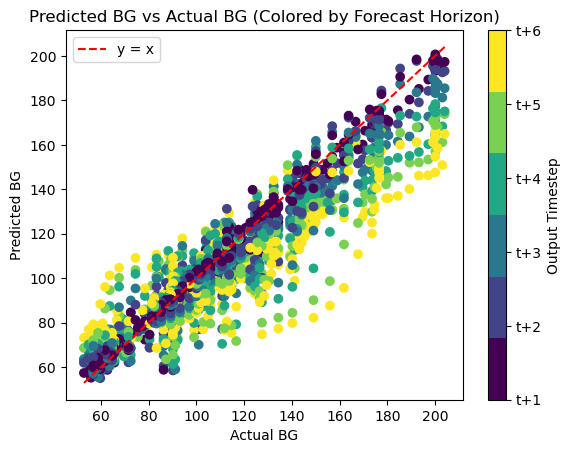


Running model for: id_53_data
Execution time: 22.714410066604614 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6154916286468506 seconds
Execution time: 0.0007739067077636719 seconds
Execution time: 0.00019288063049316406 seconds


Overall Train RMSE: 15.714796090050463 mg/DL
Overall Test RMSE: 15.202444155668635 mg/DL


Train RMSE at t+1: 9.77 mg/DL
Train RMSE at t+2: 11.03 mg/DL
Train RMSE at t+3: 14.37 mg/DL
Train RMSE at t+4: 16.79 mg/DL
Train RMSE at t+5: 18.71 mg/DL
Train RMSE at t+6: 20.64 mg/DL


Test RMSE at t+1: 10.83 mg/DL
Test RMSE at t+2: 11.44 mg/DL
Test RMSE at t+3: 14.38 mg/DL
Test RMSE at t+4: 15.91 mg/DL
Test RMSE at t+5: 17.15 mg/DL
Test RMSE at t+6: 19.61 mg/DL


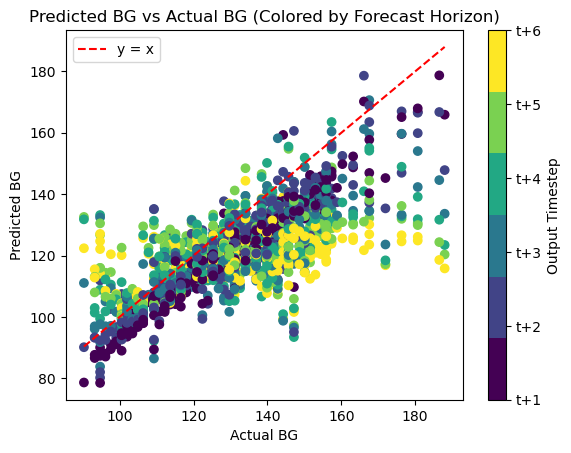


Running model for: id_54_data
Execution time: 22.225181102752686 seconds
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6477482318878174 seconds
Execution time: 0.0008058547973632812 seconds
Execution time: 0.0002071857452392578 seconds


Overall Train RMSE: 13.929195507455335 mg/DL
Overall Test RMSE: 12.575439024970672 mg/DL


Train RMSE at t+1: 7.04 mg/DL
Train RMSE at t+2: 9.94 mg/DL
Train RMSE at t+3: 12.51 mg/DL
Train RMSE at t+4: 15.25 mg/DL
Train RMSE at t+5: 17.01 mg/DL
Train RMSE at t+6: 18.37 mg/DL


Test RMSE at t+1: 6.67 mg/DL
Test RMSE at t+2: 9.04 mg/DL
Test RMSE at t+3: 11.19 mg/DL
Test RMSE at t+4: 13.45 mg/DL
Test RMSE at t+5: 15.22 mg/DL
Test RMSE at t+6: 16.88 mg/DL


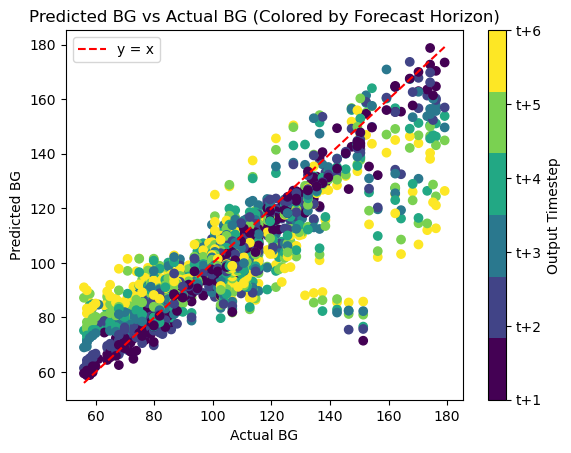


Running model for: id_55_data
Execution time: 22.667662143707275 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6288151741027832 seconds
Execution time: 0.0007309913635253906 seconds
Execution time: 0.0001590251922607422 seconds


Overall Train RMSE: 10.330804626914235 mg/DL
Overall Test RMSE: 9.894961049768664 mg/DL


Train RMSE at t+1: 4.51 mg/DL
Train RMSE at t+2: 6.96 mg/DL
Train RMSE at t+3: 9.21 mg/DL
Train RMSE at t+4: 11.04 mg/DL
Train RMSE at t+5: 12.77 mg/DL
Train RMSE at t+6: 14.20 mg/DL


Test RMSE at t+1: 3.84 mg/DL
Test RMSE at t+2: 6.24 mg/DL
Test RMSE at t+3: 8.73 mg/DL
Test RMSE at t+4: 10.64 mg/DL
Test RMSE at t+5: 12.38 mg/DL
Test RMSE at t+6: 13.83 mg/DL


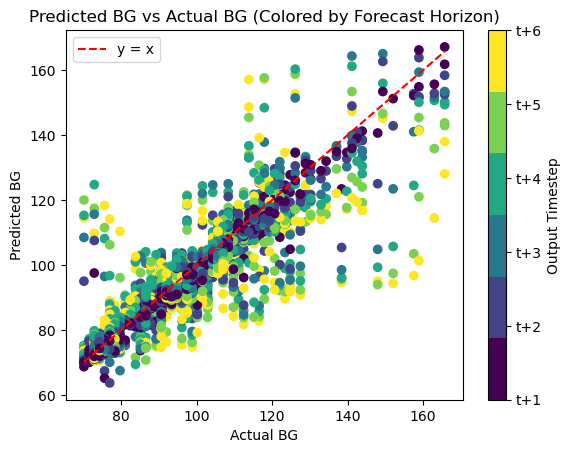


Running model for: id_56_data
Execution time: 18.45245862007141 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.6378769874572754 seconds
Execution time: 0.0005669593811035156 seconds
Execution time: 0.00017118453979492188 seconds


Overall Train RMSE: 10.93984328561483 mg/DL
Overall Test RMSE: 12.12540636393778 mg/DL


Train RMSE at t+1: 4.42 mg/DL
Train RMSE at t+2: 7.44 mg/DL
Train RMSE at t+3: 10.17 mg/DL
Train RMSE at t+4: 12.07 mg/DL
Train RMSE at t+5: 13.53 mg/DL
Train RMSE at t+6: 14.52 mg/DL


Test RMSE at t+1: 4.60 mg/DL
Test RMSE at t+2: 7.81 mg/DL
Test RMSE at t+3: 10.94 mg/DL
Test RMSE at t+4: 13.24 mg/DL
Test RMSE at t+5: 15.14 mg/DL
Test RMSE at t+6: 16.61 mg/DL


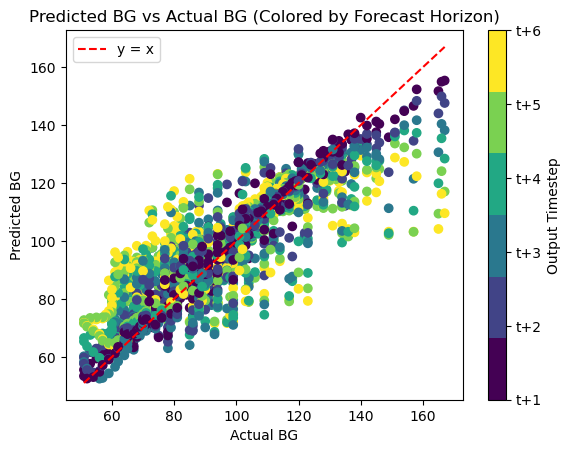

In [33]:
all_preds3 = []
all_truths3 = []
seq_length_in = 24 # Training on 120 mins of data (2 hours)
seq_length_out = 6 # 30 mins (~5 min interval each interation)
results3 = {}

for key, subset in normalized_data.items():
    print(f"\nRunning model for: {key}")
    
    try:
        preds, truths = RNN_indv(subset, seq_length_in, seq_length_out)
        all_preds3.append(preds)
        all_truths3.append(truths)
        results3[key] = (preds, truths)
    except Exception as e:
        print(f"Error for {key}: {e}")
        results3[key] = None


In [180]:
# Concatenate all predictions and truths
all_preds_concat3 = np.concatenate(all_preds3, axis=0).flatten()
all_truths_concat3 = np.concatenate(all_truths3, axis=0).flatten()

# Compute overall RMSE and MAE
combined_rmse3 = np.sqrt(mean_squared_error(all_truths_concat3, all_preds_concat3))
combined_mae3 = mean_absolute_error(all_truths_concat3, all_preds_concat3)

print(f"\nCombined RMSE across all IDs: {combined_rmse3:.2f} mg/dL")
print(f"Combined MAE  across all IDs: {combined_mae3:.2f} mg/dL\n")

# Lists to store RMSE and MAE per individual
rmse_per_individual = []
mae_per_individual = []

# Compute per-ID RMSE and MAE
for pred_array, true_array in zip(all_preds3, all_truths3):
    pred_flat = pred_array.flatten()
    true_flat = true_array.flatten()
    
    rmse = np.sqrt(mean_squared_error(true_flat, pred_flat))
    mae = mean_absolute_error(true_flat, pred_flat)
    
    rmse_per_individual.append(rmse)
    mae_per_individual.append(mae)

# Print all 56 RMSEs and MAEs
for i, (rmse, mae) in enumerate(zip(rmse_per_individual, mae_per_individual)):
    print(f"ID {i:2d}: RMSE = {rmse:.2f} mg/dL | MAE = {mae:.2f} mg/dL")

# Summary: min/max RMSE and MAE
print('\n')
print(f'The min RMSE is for ID {np.argmin(rmse_per_individual)} with a value of: {min(rmse_per_individual):.2f}')
print(f'The max RMSE is for ID {np.argmax(rmse_per_individual)} with a value of: {max(rmse_per_individual):.2f}')
print(f'The min MAE  is for ID {np.argmin(mae_per_individual)} with a value of: {min(mae_per_individual):.2f}')
print(f'The max MAE  is for ID {np.argmax(mae_per_individual)} with a value of: {max(mae_per_individual):.2f}')



Combined RMSE across all IDs: 12.84 mg/dL
Combined MAE  across all IDs: 8.44 mg/dL

ID  0: RMSE = 7.44 mg/dL | MAE = 5.54 mg/dL
ID  1: RMSE = 17.40 mg/dL | MAE = 10.71 mg/dL
ID  2: RMSE = 20.50 mg/dL | MAE = 14.35 mg/dL
ID  3: RMSE = 9.58 mg/dL | MAE = 7.28 mg/dL
ID  4: RMSE = 9.87 mg/dL | MAE = 6.68 mg/dL
ID  5: RMSE = 12.29 mg/dL | MAE = 9.19 mg/dL
ID  6: RMSE = 10.91 mg/dL | MAE = 6.70 mg/dL
ID  7: RMSE = 13.04 mg/dL | MAE = 9.52 mg/dL
ID  8: RMSE = 9.60 mg/dL | MAE = 6.83 mg/dL
ID  9: RMSE = 14.29 mg/dL | MAE = 9.12 mg/dL
ID 10: RMSE = 11.26 mg/dL | MAE = 8.26 mg/dL
ID 11: RMSE = 15.91 mg/dL | MAE = 10.70 mg/dL
ID 12: RMSE = 11.77 mg/dL | MAE = 8.85 mg/dL
ID 13: RMSE = 15.97 mg/dL | MAE = 12.63 mg/dL
ID 14: RMSE = 12.29 mg/dL | MAE = 8.98 mg/dL
ID 15: RMSE = 13.06 mg/dL | MAE = 9.35 mg/dL
ID 16: RMSE = 12.60 mg/dL | MAE = 8.36 mg/dL
ID 17: RMSE = 15.27 mg/dL | MAE = 10.92 mg/dL
ID 18: RMSE = 14.38 mg/dL | MAE = 9.92 mg/dL
ID 19: RMSE = 12.38 mg/dL | MAE = 8.60 mg/dL
ID 20: RMSE = 


Running model for: id_0_data
Execution time: 12.6473970413208 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5881669521331787 seconds
Execution time: 0.0006020069122314453 seconds
Execution time: 0.0001380443572998047 seconds


Overall Train RMSE: 8.913581060702924 mg/DL
Overall Test RMSE: 7.693591106708841 mg/DL


Train RMSE at t+1: 4.13 mg/DL
Train RMSE at t+2: 5.23 mg/DL
Train RMSE at t+3: 7.18 mg/DL
Train RMSE at t+4: 9.60 mg/DL
Train RMSE at t+5: 11.36 mg/DL
Train RMSE at t+6: 12.63 mg/DL


Test RMSE at t+1: 3.43 mg/DL
Test RMSE at t+2: 4.17 mg/DL
Test RMSE at t+3: 5.99 mg/DL
Test RMSE at t+4: 8.38 mg/DL
Test RMSE at t+5: 9.84 mg/DL
Test RMSE at t+6: 11.09 mg/DL


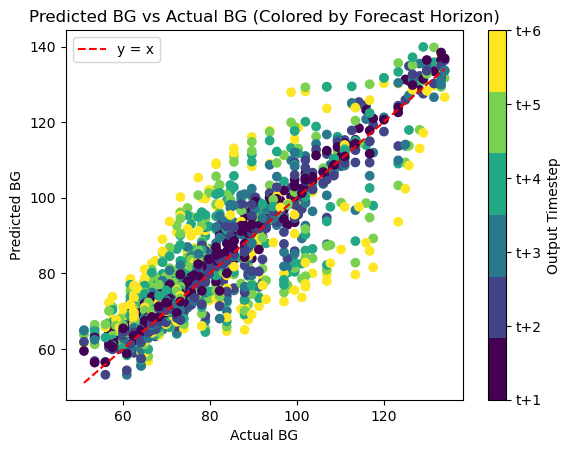


Running model for: id_1_data
Execution time: 15.114711999893188 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5600149631500244 seconds
Execution time: 0.0006470680236816406 seconds
Execution time: 9.179115295410156e-05 seconds


Overall Train RMSE: 12.512771393246899 mg/DL
Overall Test RMSE: 17.539543637887032 mg/DL


Train RMSE at t+1: 4.88 mg/DL
Train RMSE at t+2: 8.24 mg/DL
Train RMSE at t+3: 10.67 mg/DL
Train RMSE at t+4: 13.30 mg/DL
Train RMSE at t+5: 15.62 mg/DL
Train RMSE at t+6: 17.69 mg/DL


Test RMSE at t+1: 9.57 mg/DL
Test RMSE at t+2: 14.18 mg/DL
Test RMSE at t+3: 16.90 mg/DL
Test RMSE at t+4: 18.84 mg/DL
Test RMSE at t+5: 20.77 mg/DL
Test RMSE at t+6: 21.93 mg/DL


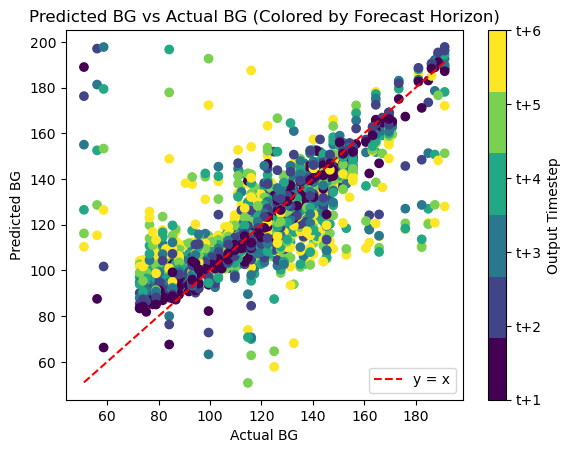


Running model for: id_2_data
Execution time: 14.90549898147583 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5539107322692871 seconds
Execution time: 0.0006749629974365234 seconds
Execution time: 9.107589721679688e-05 seconds


Overall Train RMSE: 8.076921756708067 mg/DL
Overall Test RMSE: 17.04248139723138 mg/DL


Train RMSE at t+1: 3.95 mg/DL
Train RMSE at t+2: 5.86 mg/DL
Train RMSE at t+3: 7.41 mg/DL
Train RMSE at t+4: 8.79 mg/DL
Train RMSE at t+5: 9.81 mg/DL
Train RMSE at t+6: 10.63 mg/DL


Test RMSE at t+1: 9.87 mg/DL
Test RMSE at t+2: 13.10 mg/DL
Test RMSE at t+3: 16.13 mg/DL
Test RMSE at t+4: 18.63 mg/DL
Test RMSE at t+5: 20.10 mg/DL
Test RMSE at t+6: 21.51 mg/DL


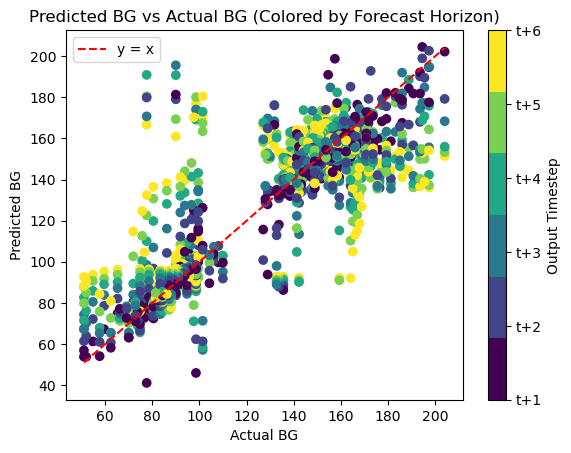


Running model for: id_3_data
Execution time: 15.196372032165527 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5587503910064697 seconds
Execution time: 0.0006451606750488281 seconds
Execution time: 8.702278137207031e-05 seconds


Overall Train RMSE: 10.120584908061227 mg/DL
Overall Test RMSE: 9.381126168366832 mg/DL


Train RMSE at t+1: 5.65 mg/DL
Train RMSE at t+2: 7.65 mg/DL
Train RMSE at t+3: 9.47 mg/DL
Train RMSE at t+4: 10.97 mg/DL
Train RMSE at t+5: 12.14 mg/DL
Train RMSE at t+6: 12.92 mg/DL


Test RMSE at t+1: 5.72 mg/DL
Test RMSE at t+2: 7.42 mg/DL
Test RMSE at t+3: 8.75 mg/DL
Test RMSE at t+4: 9.97 mg/DL
Test RMSE at t+5: 11.14 mg/DL
Test RMSE at t+6: 11.84 mg/DL


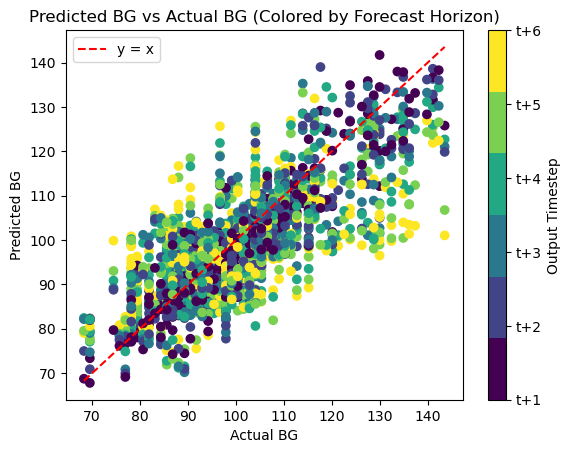


Running model for: id_4_data
Execution time: 15.290265083312988 seconds
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5812041759490967 seconds
Execution time: 0.0007219314575195312 seconds
Execution time: 0.0002071857452392578 seconds


Overall Train RMSE: 11.878325681076188 mg/DL
Overall Test RMSE: 9.663083251073235 mg/DL


Train RMSE at t+1: 5.19 mg/DL
Train RMSE at t+2: 7.58 mg/DL
Train RMSE at t+3: 11.41 mg/DL
Train RMSE at t+4: 12.86 mg/DL
Train RMSE at t+5: 14.27 mg/DL
Train RMSE at t+6: 16.22 mg/DL


Test RMSE at t+1: 4.71 mg/DL
Test RMSE at t+2: 6.81 mg/DL
Test RMSE at t+3: 8.82 mg/DL
Test RMSE at t+4: 10.32 mg/DL
Test RMSE at t+5: 11.81 mg/DL
Test RMSE at t+6: 12.96 mg/DL


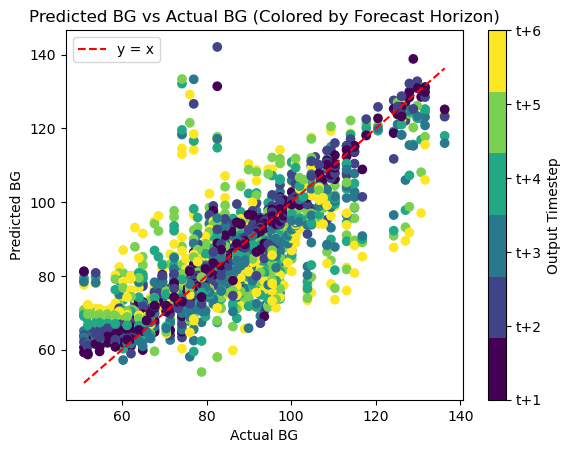


Running model for: id_5_data
Execution time: 15.10288691520691 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5635890960693359 seconds
Execution time: 0.0005970001220703125 seconds
Execution time: 8.487701416015625e-05 seconds


Overall Train RMSE: 14.922526500639796 mg/DL
Overall Test RMSE: 11.700163559626706 mg/DL


Train RMSE at t+1: 6.99 mg/DL
Train RMSE at t+2: 10.46 mg/DL
Train RMSE at t+3: 13.76 mg/DL
Train RMSE at t+4: 16.07 mg/DL
Train RMSE at t+5: 18.28 mg/DL
Train RMSE at t+6: 19.89 mg/DL


Test RMSE at t+1: 6.67 mg/DL
Test RMSE at t+2: 9.23 mg/DL
Test RMSE at t+3: 11.35 mg/DL
Test RMSE at t+4: 12.75 mg/DL
Test RMSE at t+5: 13.66 mg/DL
Test RMSE at t+6: 14.62 mg/DL


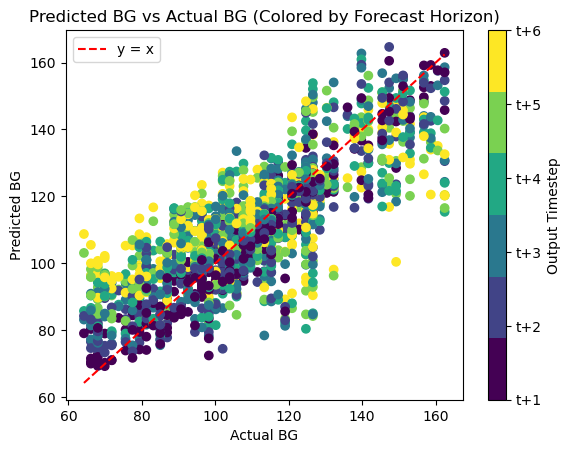


Running model for: id_6_data
Execution time: 15.138405799865723 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5589210987091064 seconds
Execution time: 0.0005440711975097656 seconds
Execution time: 0.00016927719116210938 seconds


Overall Train RMSE: 9.835546611439684 mg/DL
Overall Test RMSE: 10.583125405779654 mg/DL


Train RMSE at t+1: 4.75 mg/DL
Train RMSE at t+2: 6.44 mg/DL
Train RMSE at t+3: 8.47 mg/DL
Train RMSE at t+4: 10.42 mg/DL
Train RMSE at t+5: 12.13 mg/DL
Train RMSE at t+6: 13.74 mg/DL


Test RMSE at t+1: 5.90 mg/DL
Test RMSE at t+2: 7.74 mg/DL
Test RMSE at t+3: 9.70 mg/DL
Test RMSE at t+4: 11.62 mg/DL
Test RMSE at t+5: 12.70 mg/DL
Test RMSE at t+6: 13.68 mg/DL


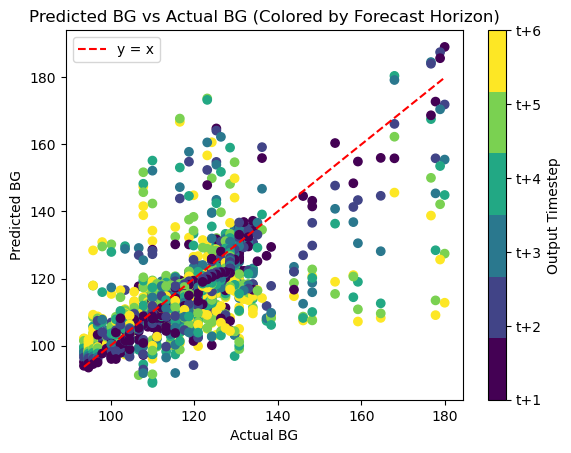


Running model for: id_7_data
Execution time: 14.726606130599976 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5585329532623291 seconds
Execution time: 0.0005786418914794922 seconds
Execution time: 8.606910705566406e-05 seconds


Overall Train RMSE: 14.17623140621529 mg/DL
Overall Test RMSE: 10.649737566020159 mg/DL


Train RMSE at t+1: 9.44 mg/DL
Train RMSE at t+2: 10.13 mg/DL
Train RMSE at t+3: 13.10 mg/DL
Train RMSE at t+4: 15.40 mg/DL
Train RMSE at t+5: 16.86 mg/DL
Train RMSE at t+6: 17.92 mg/DL


Test RMSE at t+1: 8.49 mg/DL
Test RMSE at t+2: 7.02 mg/DL
Test RMSE at t+3: 9.42 mg/DL
Test RMSE at t+4: 11.32 mg/DL
Test RMSE at t+5: 12.68 mg/DL
Test RMSE at t+6: 13.46 mg/DL


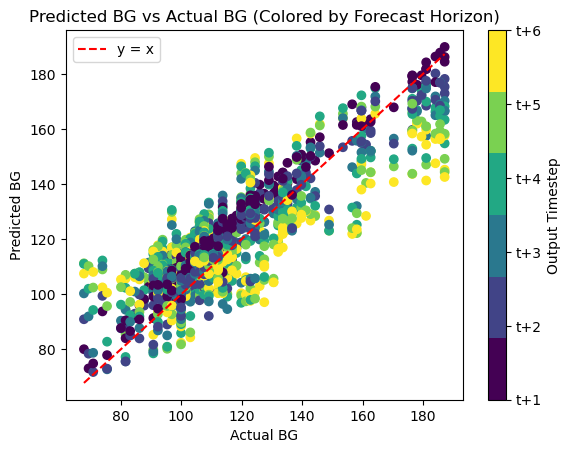


Running model for: id_8_data
Execution time: 15.08035683631897 seconds
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5463550090789795 seconds
Execution time: 0.0006928443908691406 seconds
Execution time: 7.987022399902344e-05 seconds


Overall Train RMSE: 11.865006543472456 mg/DL
Overall Test RMSE: 9.856293594572396 mg/DL


Train RMSE at t+1: 4.93 mg/DL
Train RMSE at t+2: 7.94 mg/DL
Train RMSE at t+3: 10.95 mg/DL
Train RMSE at t+4: 12.98 mg/DL
Train RMSE at t+5: 14.59 mg/DL
Train RMSE at t+6: 16.00 mg/DL


Test RMSE at t+1: 4.31 mg/DL
Test RMSE at t+2: 6.95 mg/DL
Test RMSE at t+3: 9.25 mg/DL
Test RMSE at t+4: 10.96 mg/DL
Test RMSE at t+5: 11.97 mg/DL
Test RMSE at t+6: 12.92 mg/DL


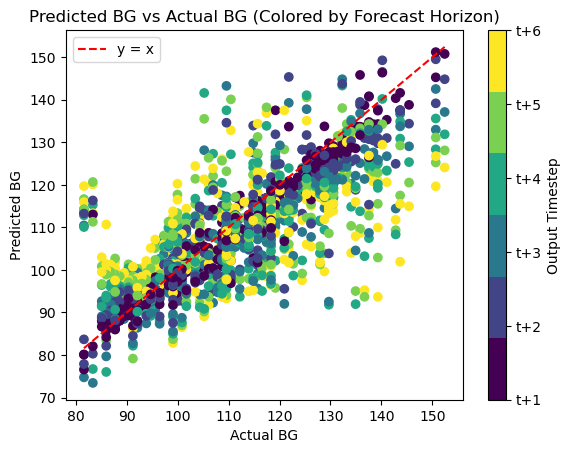


Running model for: id_9_data
Execution time: 15.234620809555054 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Execution time: 0.5659921169281006 seconds
Execution time: 0.0005371570587158203 seconds
Execution time: 0.0001392364501953125 seconds


Overall Train RMSE: 11.658591247090422 mg/DL
Overall Test RMSE: 14.283516072642591 mg/DL


Train RMSE at t+1: 5.33 mg/DL
Train RMSE at t+2: 7.77 mg/DL
Train RMSE at t+3: 10.31 mg/DL
Train RMSE at t+4: 12.43 mg/DL
Train RMSE at t+5: 14.45 mg/DL
Train RMSE at t+6: 16.04 mg/DL


Test RMSE at t+1: 7.70 mg/DL
Test RMSE at t+2: 10.72 mg/DL
Test RMSE at t+3: 13.24 mg/DL
Test RMSE at t+4: 15.24 mg/DL
Test RMSE at t+5: 16.95 mg/DL
Test RMSE at t+6: 18.85 mg/DL


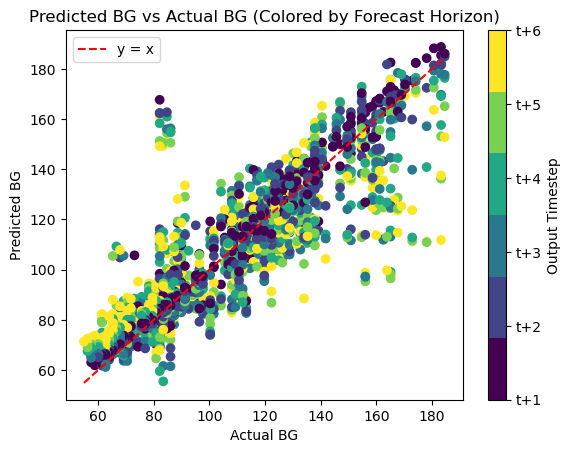


Running model for: id_10_data
Execution time: 15.05483627319336 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5759837627410889 seconds
Execution time: 0.0005900859832763672 seconds
Execution time: 0.00016379356384277344 seconds


Overall Train RMSE: 11.404426971011109 mg/DL
Overall Test RMSE: 10.608651703098149 mg/DL


Train RMSE at t+1: 5.02 mg/DL
Train RMSE at t+2: 7.64 mg/DL
Train RMSE at t+3: 10.13 mg/DL
Train RMSE at t+4: 12.44 mg/DL
Train RMSE at t+5: 14.10 mg/DL
Train RMSE at t+6: 15.51 mg/DL


Test RMSE at t+1: 3.86 mg/DL
Test RMSE at t+2: 6.05 mg/DL
Test RMSE at t+3: 8.61 mg/DL
Test RMSE at t+4: 11.25 mg/DL
Test RMSE at t+5: 13.48 mg/DL
Test RMSE at t+6: 15.52 mg/DL


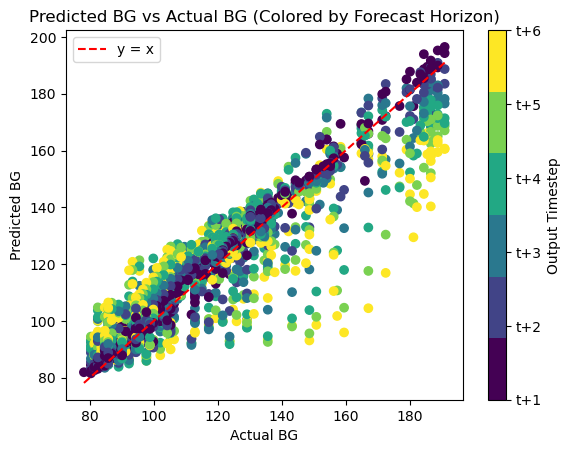


Running model for: id_11_data
Execution time: 14.60257625579834 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.555279016494751 seconds
Execution time: 0.0005829334259033203 seconds
Execution time: 8.296966552734375e-05 seconds


Overall Train RMSE: 10.486745301464143 mg/DL
Overall Test RMSE: 15.660012652043527 mg/DL


Train RMSE at t+1: 6.88 mg/DL
Train RMSE at t+2: 8.06 mg/DL
Train RMSE at t+3: 9.29 mg/DL
Train RMSE at t+4: 10.78 mg/DL
Train RMSE at t+5: 12.63 mg/DL
Train RMSE at t+6: 13.62 mg/DL


Test RMSE at t+1: 8.46 mg/DL
Test RMSE at t+2: 11.00 mg/DL
Test RMSE at t+3: 14.53 mg/DL
Test RMSE at t+4: 16.60 mg/DL
Test RMSE at t+5: 19.33 mg/DL
Test RMSE at t+6: 20.45 mg/DL


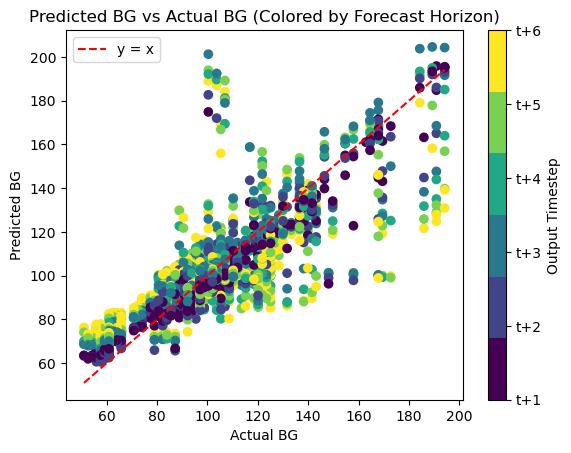


Running model for: id_12_data
Execution time: 18.653607845306396 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6065471172332764 seconds
Execution time: 0.0006008148193359375 seconds
Execution time: 0.00012421607971191406 seconds


Overall Train RMSE: 9.801587810288568 mg/DL
Overall Test RMSE: 11.949909891362324 mg/DL


Train RMSE at t+1: 5.28 mg/DL
Train RMSE at t+2: 7.41 mg/DL
Train RMSE at t+3: 9.27 mg/DL
Train RMSE at t+4: 10.49 mg/DL
Train RMSE at t+5: 11.64 mg/DL
Train RMSE at t+6: 12.73 mg/DL


Test RMSE at t+1: 7.66 mg/DL
Test RMSE at t+2: 9.60 mg/DL
Test RMSE at t+3: 11.58 mg/DL
Test RMSE at t+4: 12.64 mg/DL
Test RMSE at t+5: 13.76 mg/DL
Test RMSE at t+6: 14.92 mg/DL


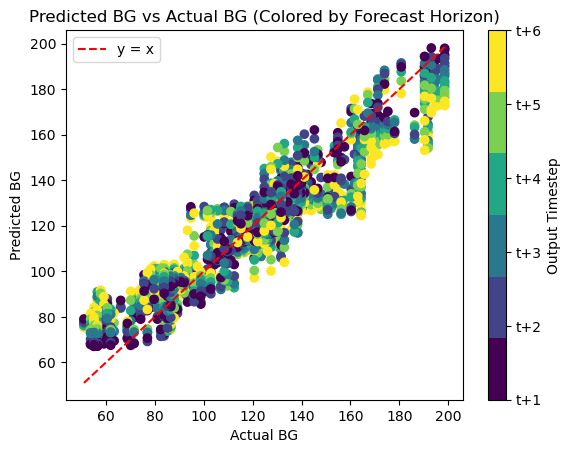


Running model for: id_13_data
Execution time: 15.570828914642334 seconds
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6134028434753418 seconds
Execution time: 0.0007333755493164062 seconds
Execution time: 0.00015497207641601562 seconds


Overall Train RMSE: 13.686074897718562 mg/DL
Overall Test RMSE: 14.61816260899298 mg/DL


Train RMSE at t+1: 6.97 mg/DL
Train RMSE at t+2: 10.15 mg/DL
Train RMSE at t+3: 12.60 mg/DL
Train RMSE at t+4: 14.80 mg/DL
Train RMSE at t+5: 16.56 mg/DL
Train RMSE at t+6: 17.89 mg/DL


Test RMSE at t+1: 7.61 mg/DL
Test RMSE at t+2: 10.87 mg/DL
Test RMSE at t+3: 13.40 mg/DL
Test RMSE at t+4: 15.43 mg/DL
Test RMSE at t+5: 17.70 mg/DL
Test RMSE at t+6: 19.37 mg/DL


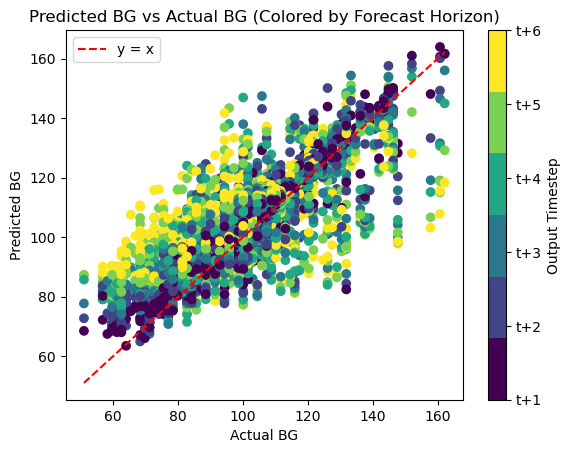


Running model for: id_14_data
Execution time: 15.404428005218506 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Execution time: 0.5673279762268066 seconds
Execution time: 0.0004940032958984375 seconds
Execution time: 0.00014281272888183594 seconds


Overall Train RMSE: 10.99009773907638 mg/DL
Overall Test RMSE: 12.254330693109294 mg/DL


Train RMSE at t+1: 5.07 mg/DL
Train RMSE at t+2: 7.83 mg/DL
Train RMSE at t+3: 10.05 mg/DL
Train RMSE at t+4: 11.85 mg/DL
Train RMSE at t+5: 13.54 mg/DL
Train RMSE at t+6: 14.59 mg/DL


Test RMSE at t+1: 4.77 mg/DL
Test RMSE at t+2: 8.08 mg/DL
Test RMSE at t+3: 10.46 mg/DL
Test RMSE at t+4: 13.19 mg/DL
Test RMSE at t+5: 15.49 mg/DL
Test RMSE at t+6: 17.02 mg/DL


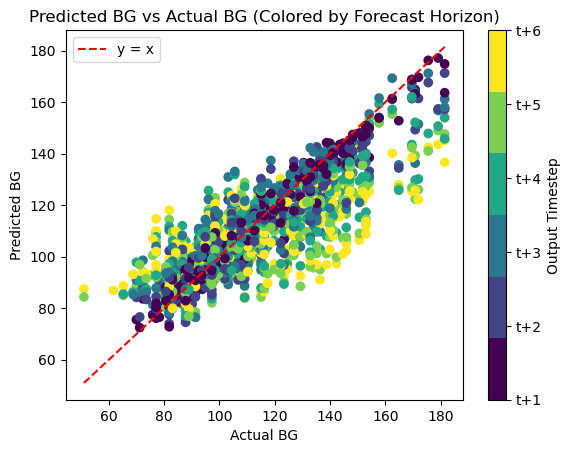


Running model for: id_15_data
Execution time: 15.1282217502594 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5589158535003662 seconds
Execution time: 0.00055694580078125 seconds
Execution time: 0.00012803077697753906 seconds


Overall Train RMSE: 12.4279328572829 mg/DL
Overall Test RMSE: 13.789110604649714 mg/DL


Train RMSE at t+1: 7.86 mg/DL
Train RMSE at t+2: 10.27 mg/DL
Train RMSE at t+3: 12.53 mg/DL
Train RMSE at t+4: 13.54 mg/DL
Train RMSE at t+5: 14.26 mg/DL
Train RMSE at t+6: 14.69 mg/DL


Test RMSE at t+1: 8.38 mg/DL
Test RMSE at t+2: 11.14 mg/DL
Test RMSE at t+3: 13.81 mg/DL
Test RMSE at t+4: 14.99 mg/DL
Test RMSE at t+5: 15.95 mg/DL
Test RMSE at t+6: 16.63 mg/DL


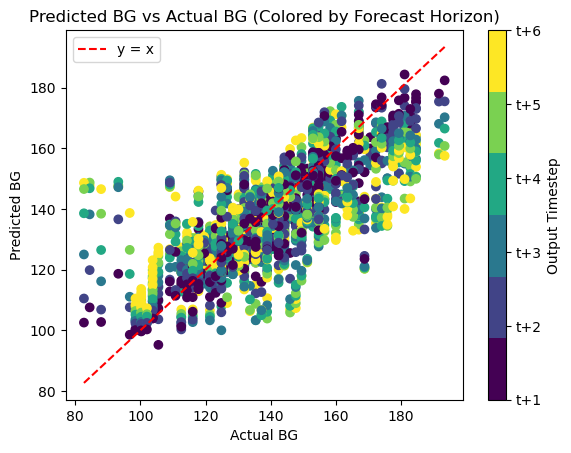


Running model for: id_16_data
Execution time: 15.177798748016357 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5648880004882812 seconds
Execution time: 0.0004248619079589844 seconds
Execution time: 0.0003190040588378906 seconds


Overall Train RMSE: 14.356754770421752 mg/DL
Overall Test RMSE: 12.49294797069921 mg/DL


Train RMSE at t+1: 6.20 mg/DL
Train RMSE at t+2: 10.24 mg/DL
Train RMSE at t+3: 13.49 mg/DL
Train RMSE at t+4: 15.81 mg/DL
Train RMSE at t+5: 17.49 mg/DL
Train RMSE at t+6: 18.86 mg/DL


Test RMSE at t+1: 5.36 mg/DL
Test RMSE at t+2: 8.96 mg/DL
Test RMSE at t+3: 11.84 mg/DL
Test RMSE at t+4: 13.78 mg/DL
Test RMSE at t+5: 15.15 mg/DL
Test RMSE at t+6: 16.37 mg/DL


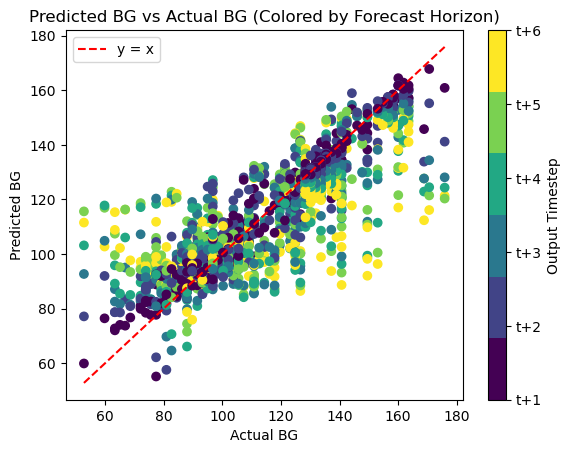


Running model for: id_17_data
Execution time: 14.738535165786743 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5626013278961182 seconds
Execution time: 0.0007510185241699219 seconds
Execution time: 0.00014710426330566406 seconds


Overall Train RMSE: 14.43606087521039 mg/DL
Overall Test RMSE: 15.262927933636794 mg/DL


Train RMSE at t+1: 9.05 mg/DL
Train RMSE at t+2: 11.63 mg/DL
Train RMSE at t+3: 14.52 mg/DL
Train RMSE at t+4: 15.04 mg/DL
Train RMSE at t+5: 16.50 mg/DL
Train RMSE at t+6: 17.99 mg/DL


Test RMSE at t+1: 9.53 mg/DL
Test RMSE at t+2: 12.24 mg/DL
Test RMSE at t+3: 14.89 mg/DL
Test RMSE at t+4: 16.53 mg/DL
Test RMSE at t+5: 17.74 mg/DL
Test RMSE at t+6: 18.64 mg/DL


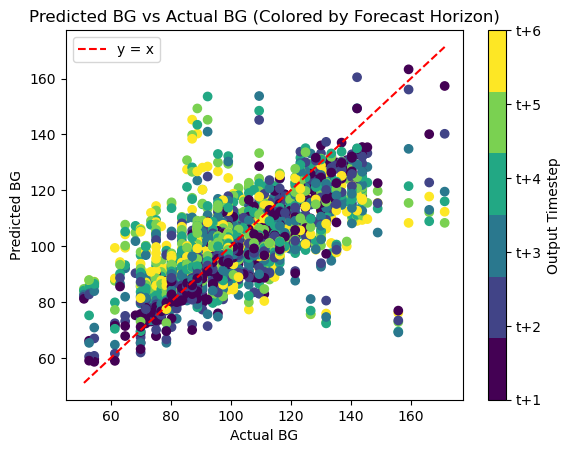


Running model for: id_18_data
Execution time: 15.032634019851685 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5484058856964111 seconds
Execution time: 0.0005629062652587891 seconds
Execution time: 8.296966552734375e-05 seconds


Overall Train RMSE: 14.242001174102773 mg/DL
Overall Test RMSE: 14.493946373041927 mg/DL


Train RMSE at t+1: 9.09 mg/DL
Train RMSE at t+2: 10.39 mg/DL
Train RMSE at t+3: 12.52 mg/DL
Train RMSE at t+4: 15.14 mg/DL
Train RMSE at t+5: 17.19 mg/DL
Train RMSE at t+6: 18.58 mg/DL


Test RMSE at t+1: 8.03 mg/DL
Test RMSE at t+2: 9.70 mg/DL
Test RMSE at t+3: 12.74 mg/DL
Test RMSE at t+4: 15.59 mg/DL
Test RMSE at t+5: 17.86 mg/DL
Test RMSE at t+6: 19.43 mg/DL


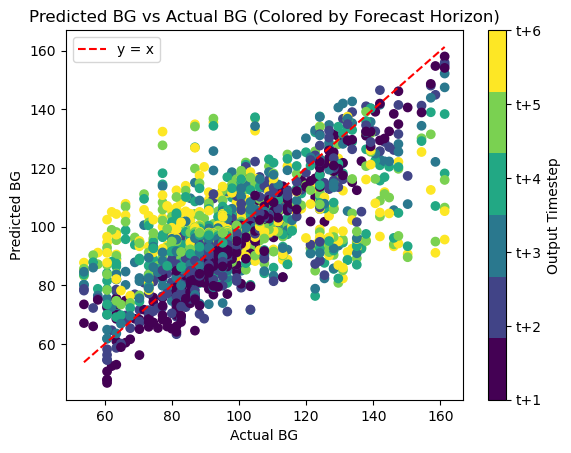


Running model for: id_19_data
Execution time: 15.422569274902344 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.564115047454834 seconds
Execution time: 0.0006020069122314453 seconds
Execution time: 9.298324584960938e-05 seconds


Overall Train RMSE: 15.005942708037159 mg/DL
Overall Test RMSE: 12.333876031276269 mg/DL


Train RMSE at t+1: 6.25 mg/DL
Train RMSE at t+2: 10.47 mg/DL
Train RMSE at t+3: 13.54 mg/DL
Train RMSE at t+4: 16.35 mg/DL
Train RMSE at t+5: 18.44 mg/DL
Train RMSE at t+6: 20.29 mg/DL


Test RMSE at t+1: 6.03 mg/DL
Test RMSE at t+2: 9.78 mg/DL
Test RMSE at t+3: 11.79 mg/DL
Test RMSE at t+4: 13.53 mg/DL
Test RMSE at t+5: 14.47 mg/DL
Test RMSE at t+6: 15.79 mg/DL


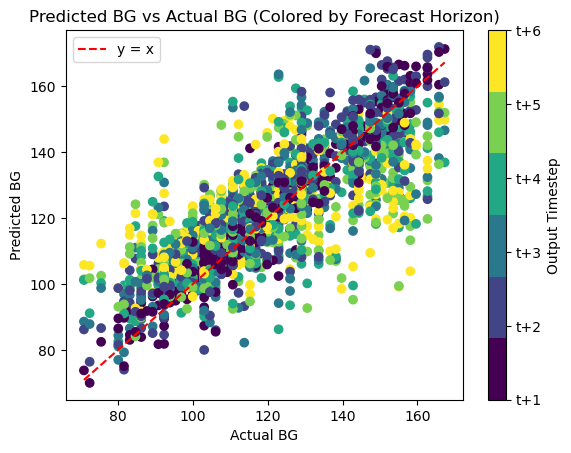


Running model for: id_20_data
Execution time: 12.569715976715088 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5577449798583984 seconds
Execution time: 0.0006930828094482422 seconds
Execution time: 0.00014209747314453125 seconds


Overall Train RMSE: 9.636089652307314 mg/DL
Overall Test RMSE: 13.264662082462563 mg/DL


Train RMSE at t+1: 3.75 mg/DL
Train RMSE at t+2: 6.29 mg/DL
Train RMSE at t+3: 8.37 mg/DL
Train RMSE at t+4: 10.47 mg/DL
Train RMSE at t+5: 12.21 mg/DL
Train RMSE at t+6: 13.22 mg/DL


Test RMSE at t+1: 4.70 mg/DL
Test RMSE at t+2: 7.57 mg/DL
Test RMSE at t+3: 10.72 mg/DL
Test RMSE at t+4: 13.99 mg/DL
Test RMSE at t+5: 17.55 mg/DL
Test RMSE at t+6: 18.91 mg/DL


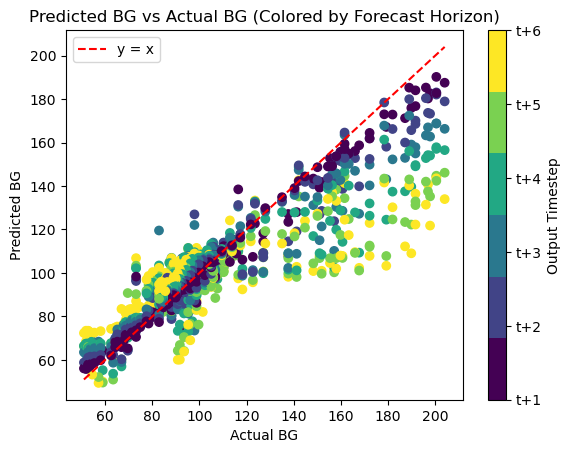


Running model for: id_21_data
Execution time: 15.036998987197876 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5465230941772461 seconds
Execution time: 0.0005638599395751953 seconds
Execution time: 8.606910705566406e-05 seconds


Overall Train RMSE: 8.857027858379613 mg/DL
Overall Test RMSE: 10.955677330337434 mg/DL


Train RMSE at t+1: 3.93 mg/DL
Train RMSE at t+2: 6.31 mg/DL
Train RMSE at t+3: 7.86 mg/DL
Train RMSE at t+4: 9.38 mg/DL
Train RMSE at t+5: 10.89 mg/DL
Train RMSE at t+6: 12.13 mg/DL


Test RMSE at t+1: 4.34 mg/DL
Test RMSE at t+2: 7.17 mg/DL
Test RMSE at t+3: 9.29 mg/DL
Test RMSE at t+4: 11.55 mg/DL
Test RMSE at t+5: 13.73 mg/DL
Test RMSE at t+6: 15.55 mg/DL


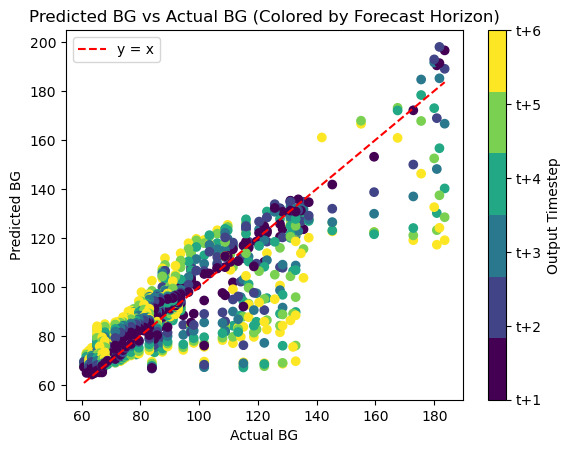


Running model for: id_22_data
Execution time: 14.926699161529541 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.557117223739624 seconds
Execution time: 0.0005667209625244141 seconds
Execution time: 8.702278137207031e-05 seconds


Overall Train RMSE: 13.576427632032951 mg/DL
Overall Test RMSE: 11.798712055403556 mg/DL


Train RMSE at t+1: 4.34 mg/DL
Train RMSE at t+2: 8.13 mg/DL
Train RMSE at t+3: 11.14 mg/DL
Train RMSE at t+4: 14.43 mg/DL
Train RMSE at t+5: 16.88 mg/DL
Train RMSE at t+6: 20.09 mg/DL


Test RMSE at t+1: 3.40 mg/DL
Test RMSE at t+2: 7.02 mg/DL
Test RMSE at t+3: 9.55 mg/DL
Test RMSE at t+4: 12.40 mg/DL
Test RMSE at t+5: 14.32 mg/DL
Test RMSE at t+6: 18.01 mg/DL


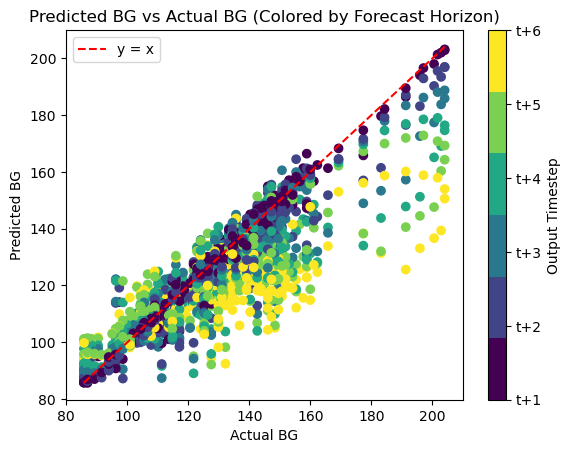


Running model for: id_23_data
Execution time: 14.874755859375 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.569634199142456 seconds
Execution time: 0.000766754150390625 seconds
Execution time: 8.797645568847656e-05 seconds


Overall Train RMSE: 6.5666070955426274 mg/DL
Overall Test RMSE: 16.723831829826604 mg/DL


Train RMSE at t+1: 3.46 mg/DL
Train RMSE at t+2: 4.83 mg/DL
Train RMSE at t+3: 6.07 mg/DL
Train RMSE at t+4: 7.03 mg/DL
Train RMSE at t+5: 7.92 mg/DL
Train RMSE at t+6: 8.63 mg/DL


Test RMSE at t+1: 10.21 mg/DL
Test RMSE at t+2: 13.10 mg/DL
Test RMSE at t+3: 15.43 mg/DL
Test RMSE at t+4: 17.80 mg/DL
Test RMSE at t+5: 19.79 mg/DL
Test RMSE at t+6: 21.35 mg/DL


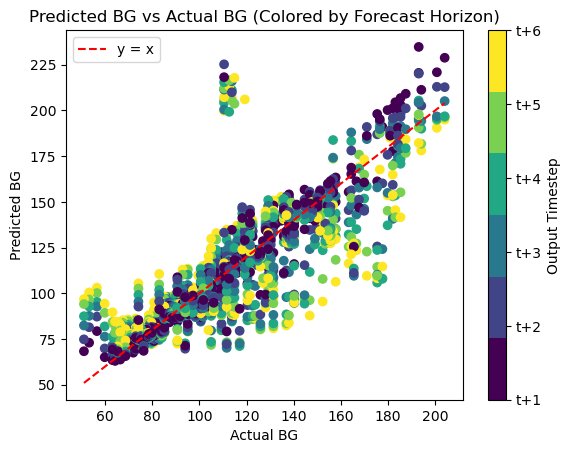


Running model for: id_24_data
Execution time: 14.734010696411133 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5680577754974365 seconds
Execution time: 0.0007538795471191406 seconds
Execution time: 9.799003601074219e-05 seconds


Overall Train RMSE: 10.284047890241641 mg/DL
Overall Test RMSE: 13.676842625958773 mg/DL


Train RMSE at t+1: 5.30 mg/DL
Train RMSE at t+2: 7.35 mg/DL
Train RMSE at t+3: 9.31 mg/DL
Train RMSE at t+4: 11.06 mg/DL
Train RMSE at t+5: 12.71 mg/DL
Train RMSE at t+6: 13.48 mg/DL


Test RMSE at t+1: 5.34 mg/DL
Test RMSE at t+2: 8.40 mg/DL
Test RMSE at t+3: 11.53 mg/DL
Test RMSE at t+4: 15.02 mg/DL
Test RMSE at t+5: 17.38 mg/DL
Test RMSE at t+6: 19.04 mg/DL


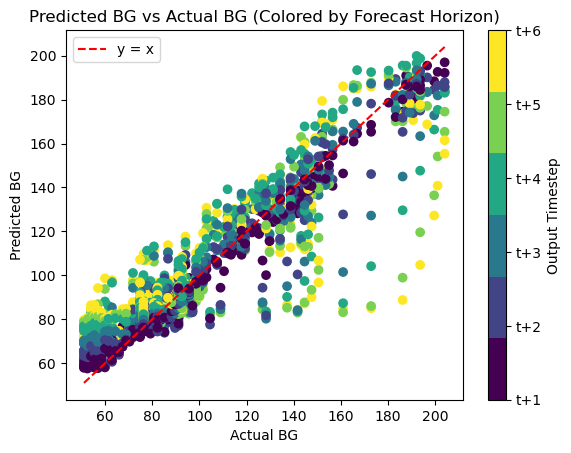


Running model for: id_25_data
Execution time: 14.720551252365112 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5528709888458252 seconds
Execution time: 0.0006320476531982422 seconds
Execution time: 8.392333984375e-05 seconds


Overall Train RMSE: 12.677086222798861 mg/DL
Overall Test RMSE: 11.209621021657698 mg/DL


Train RMSE at t+1: 4.25 mg/DL
Train RMSE at t+2: 7.99 mg/DL
Train RMSE at t+3: 10.77 mg/DL
Train RMSE at t+4: 13.60 mg/DL
Train RMSE at t+5: 15.97 mg/DL
Train RMSE at t+6: 18.07 mg/DL


Test RMSE at t+1: 3.44 mg/DL
Test RMSE at t+2: 7.10 mg/DL
Test RMSE at t+3: 9.74 mg/DL
Test RMSE at t+4: 12.17 mg/DL
Test RMSE at t+5: 14.13 mg/DL
Test RMSE at t+6: 15.78 mg/DL


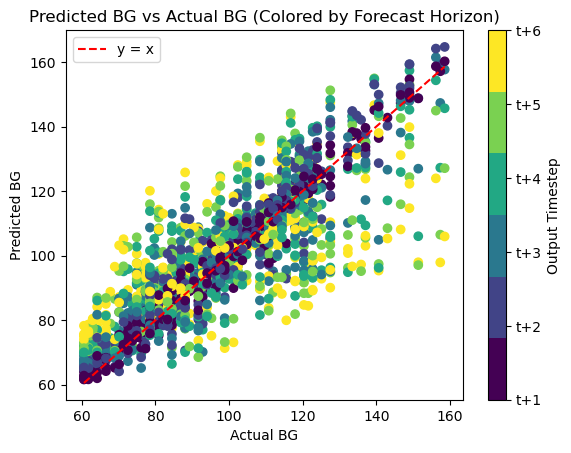


Running model for: id_26_data
Execution time: 15.173349142074585 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5434927940368652 seconds
Execution time: 0.0008127689361572266 seconds
Execution time: 0.00010013580322265625 seconds


Overall Train RMSE: 7.509465771401568 mg/DL
Overall Test RMSE: 6.432845600763675 mg/DL


Train RMSE at t+1: 4.76 mg/DL
Train RMSE at t+2: 4.89 mg/DL
Train RMSE at t+3: 6.70 mg/DL
Train RMSE at t+4: 7.90 mg/DL
Train RMSE at t+5: 8.83 mg/DL
Train RMSE at t+6: 10.32 mg/DL


Test RMSE at t+1: 4.98 mg/DL
Test RMSE at t+2: 4.95 mg/DL
Test RMSE at t+3: 6.24 mg/DL
Test RMSE at t+4: 6.84 mg/DL
Test RMSE at t+5: 7.03 mg/DL
Test RMSE at t+6: 7.98 mg/DL


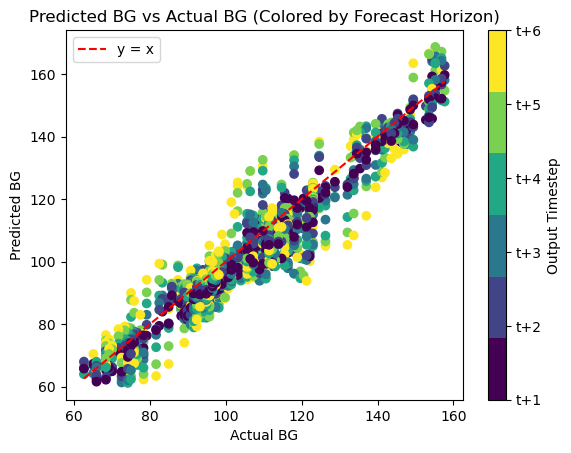


Running model for: id_27_data
Execution time: 15.349546909332275 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.3760111331939697 seconds
Execution time: 0.0005550384521484375 seconds
Execution time: 8.487701416015625e-05 seconds


Overall Train RMSE: 13.25687096372049 mg/DL
Overall Test RMSE: 13.406779537081874 mg/DL


Train RMSE at t+1: 6.48 mg/DL
Train RMSE at t+2: 8.84 mg/DL
Train RMSE at t+3: 11.84 mg/DL
Train RMSE at t+4: 14.30 mg/DL
Train RMSE at t+5: 16.43 mg/DL
Train RMSE at t+6: 17.88 mg/DL


Test RMSE at t+1: 5.89 mg/DL
Test RMSE at t+2: 8.35 mg/DL
Test RMSE at t+3: 12.02 mg/DL
Test RMSE at t+4: 15.14 mg/DL
Test RMSE at t+5: 16.72 mg/DL
Test RMSE at t+6: 17.92 mg/DL


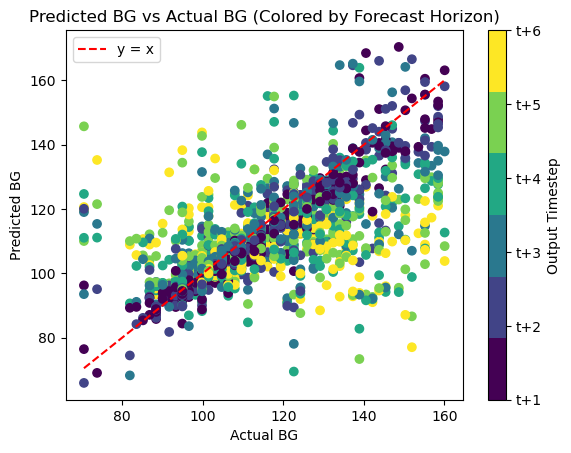


Running model for: id_28_data
Execution time: 15.324822187423706 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5781660079956055 seconds
Execution time: 0.0006878376007080078 seconds
Execution time: 0.00014090538024902344 seconds


Overall Train RMSE: 11.820515781810547 mg/DL
Overall Test RMSE: 10.746570079325519 mg/DL


Train RMSE at t+1: 5.94 mg/DL
Train RMSE at t+2: 8.60 mg/DL
Train RMSE at t+3: 10.95 mg/DL
Train RMSE at t+4: 12.85 mg/DL
Train RMSE at t+5: 14.39 mg/DL
Train RMSE at t+6: 15.40 mg/DL


Test RMSE at t+1: 5.23 mg/DL
Test RMSE at t+2: 7.51 mg/DL
Test RMSE at t+3: 9.67 mg/DL
Test RMSE at t+4: 11.57 mg/DL
Test RMSE at t+5: 13.23 mg/DL
Test RMSE at t+6: 14.39 mg/DL


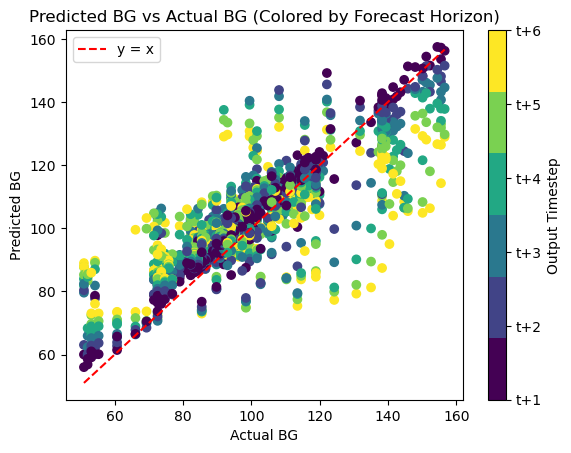


Running model for: id_29_data
Execution time: 14.77639389038086 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5488920211791992 seconds
Execution time: 0.0007328987121582031 seconds
Execution time: 0.000102996826171875 seconds


Overall Train RMSE: 14.120935390860913 mg/DL
Overall Test RMSE: 13.970983462492525 mg/DL


Train RMSE at t+1: 6.31 mg/DL
Train RMSE at t+2: 10.46 mg/DL
Train RMSE at t+3: 13.16 mg/DL
Train RMSE at t+4: 15.54 mg/DL
Train RMSE at t+5: 17.33 mg/DL
Train RMSE at t+6: 18.23 mg/DL


Test RMSE at t+1: 4.49 mg/DL
Test RMSE at t+2: 8.40 mg/DL
Test RMSE at t+3: 12.22 mg/DL
Test RMSE at t+4: 15.27 mg/DL
Test RMSE at t+5: 17.86 mg/DL
Test RMSE at t+6: 19.47 mg/DL


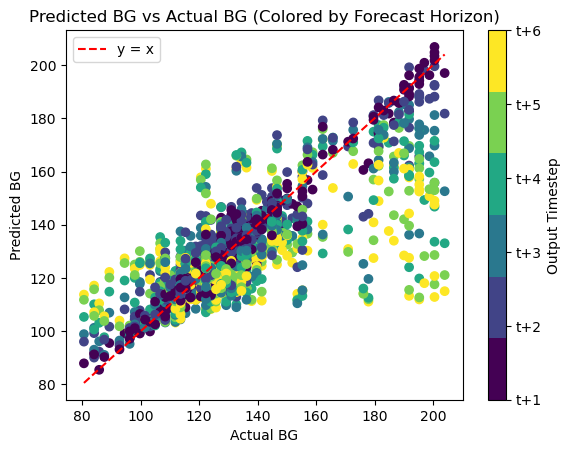


Running model for: id_30_data
Execution time: 15.150752067565918 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5598530769348145 seconds
Execution time: 0.0005502700805664062 seconds
Execution time: 8.177757263183594e-05 seconds


Overall Train RMSE: 13.06844771549605 mg/DL
Overall Test RMSE: 11.729470595709872 mg/DL


Train RMSE at t+1: 7.95 mg/DL
Train RMSE at t+2: 9.66 mg/DL
Train RMSE at t+3: 12.49 mg/DL
Train RMSE at t+4: 13.94 mg/DL
Train RMSE at t+5: 15.31 mg/DL
Train RMSE at t+6: 16.84 mg/DL


Test RMSE at t+1: 6.92 mg/DL
Test RMSE at t+2: 8.25 mg/DL
Test RMSE at t+3: 10.48 mg/DL
Test RMSE at t+4: 12.28 mg/DL
Test RMSE at t+5: 14.07 mg/DL
Test RMSE at t+6: 15.84 mg/DL


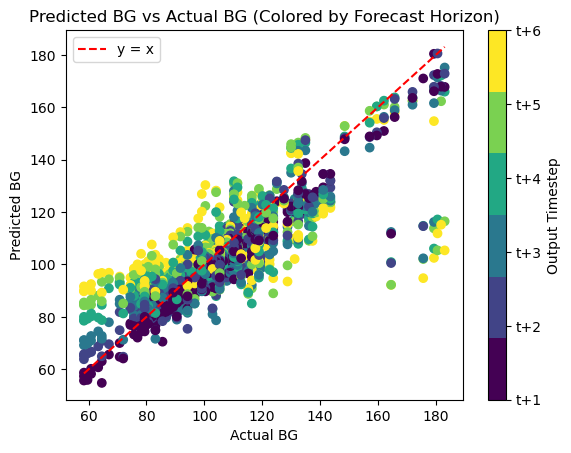


Running model for: id_31_data
Execution time: 15.023430347442627 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5549430847167969 seconds
Execution time: 0.0005950927734375 seconds
Execution time: 0.0001678466796875 seconds


Overall Train RMSE: 16.442304689559585 mg/DL
Overall Test RMSE: 10.588902654239677 mg/DL


Train RMSE at t+1: 7.47 mg/DL
Train RMSE at t+2: 11.96 mg/DL
Train RMSE at t+3: 15.34 mg/DL
Train RMSE at t+4: 18.11 mg/DL
Train RMSE at t+5: 19.96 mg/DL
Train RMSE at t+6: 21.49 mg/DL


Test RMSE at t+1: 5.06 mg/DL
Test RMSE at t+2: 8.19 mg/DL
Test RMSE at t+3: 10.21 mg/DL
Test RMSE at t+4: 11.58 mg/DL
Test RMSE at t+5: 12.71 mg/DL
Test RMSE at t+6: 13.43 mg/DL


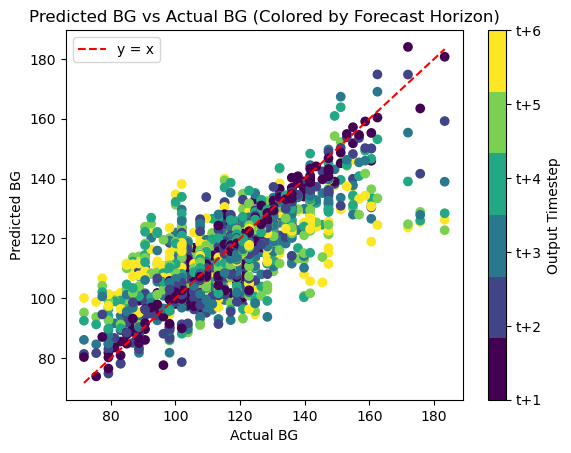


Running model for: id_32_data
Execution time: 14.986451864242554 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5684211254119873 seconds
Execution time: 0.0006039142608642578 seconds
Execution time: 8.916854858398438e-05 seconds


Overall Train RMSE: 8.786650257285979 mg/DL
Overall Test RMSE: 13.004424670407333 mg/DL


Train RMSE at t+1: 3.86 mg/DL
Train RMSE at t+2: 5.74 mg/DL
Train RMSE at t+3: 7.90 mg/DL
Train RMSE at t+4: 9.59 mg/DL
Train RMSE at t+5: 10.91 mg/DL
Train RMSE at t+6: 11.91 mg/DL


Test RMSE at t+1: 5.66 mg/DL
Test RMSE at t+2: 8.10 mg/DL
Test RMSE at t+3: 11.55 mg/DL
Test RMSE at t+4: 13.80 mg/DL
Test RMSE at t+5: 16.27 mg/DL
Test RMSE at t+6: 18.13 mg/DL


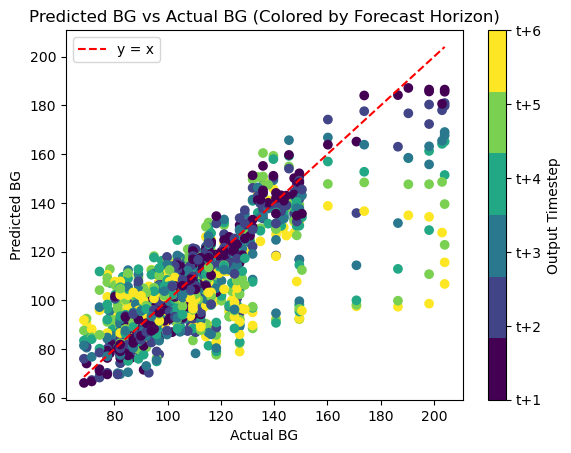


Running model for: id_33_data
Execution time: 14.927071809768677 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5541651248931885 seconds
Execution time: 0.0005958080291748047 seconds
Execution time: 8.702278137207031e-05 seconds


Overall Train RMSE: 13.628181369917131 mg/DL
Overall Test RMSE: 14.593079664559822 mg/DL


Train RMSE at t+1: 4.94 mg/DL
Train RMSE at t+2: 8.64 mg/DL
Train RMSE at t+3: 11.90 mg/DL
Train RMSE at t+4: 14.92 mg/DL
Train RMSE at t+5: 17.24 mg/DL
Train RMSE at t+6: 18.82 mg/DL


Test RMSE at t+1: 6.31 mg/DL
Test RMSE at t+2: 10.50 mg/DL
Test RMSE at t+3: 13.91 mg/DL
Test RMSE at t+4: 16.19 mg/DL
Test RMSE at t+5: 17.88 mg/DL
Test RMSE at t+6: 18.77 mg/DL


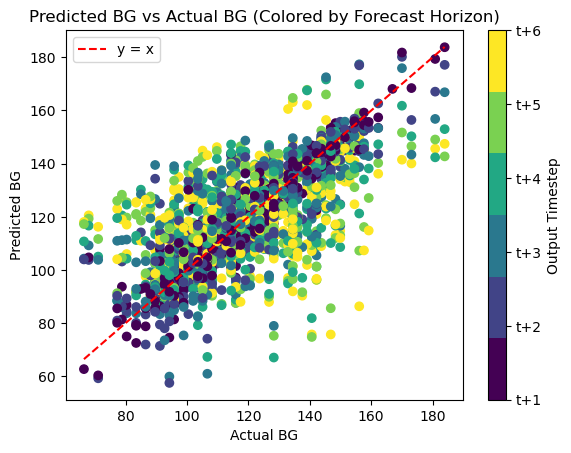


Running model for: id_34_data
Execution time: 15.084595918655396 seconds
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5700898170471191 seconds
Execution time: 0.0007531642913818359 seconds
Execution time: 0.0001838207244873047 seconds


Overall Train RMSE: 8.573466578391994 mg/DL
Overall Test RMSE: 14.228430717340164 mg/DL


Train RMSE at t+1: 4.10 mg/DL
Train RMSE at t+2: 6.24 mg/DL
Train RMSE at t+3: 8.00 mg/DL
Train RMSE at t+4: 9.48 mg/DL
Train RMSE at t+5: 10.41 mg/DL
Train RMSE at t+6: 11.09 mg/DL


Test RMSE at t+1: 7.59 mg/DL
Test RMSE at t+2: 10.39 mg/DL
Test RMSE at t+3: 13.06 mg/DL
Test RMSE at t+4: 15.39 mg/DL
Test RMSE at t+5: 17.30 mg/DL
Test RMSE at t+6: 18.50 mg/DL


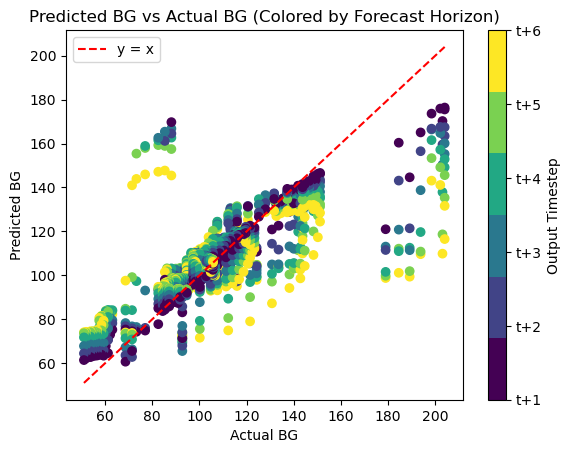


Running model for: id_35_data
Execution time: 14.837671756744385 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5698111057281494 seconds
Execution time: 0.0006809234619140625 seconds
Execution time: 0.00013899803161621094 seconds


Overall Train RMSE: 10.4951284132967 mg/DL
Overall Test RMSE: 7.072792424188039 mg/DL


Train RMSE at t+1: 5.84 mg/DL
Train RMSE at t+2: 8.18 mg/DL
Train RMSE at t+3: 9.56 mg/DL
Train RMSE at t+4: 11.18 mg/DL
Train RMSE at t+5: 12.49 mg/DL
Train RMSE at t+6: 13.70 mg/DL


Test RMSE at t+1: 3.32 mg/DL
Test RMSE at t+2: 5.15 mg/DL
Test RMSE at t+3: 6.42 mg/DL
Test RMSE at t+4: 7.66 mg/DL
Test RMSE at t+5: 8.73 mg/DL
Test RMSE at t+6: 9.31 mg/DL


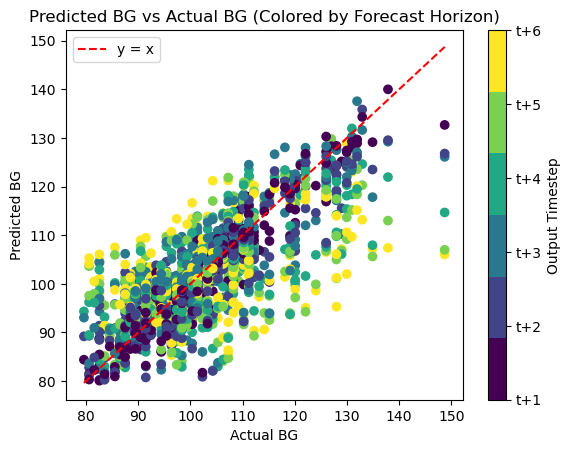


Running model for: id_36_data
Execution time: 15.311146020889282 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5746619701385498 seconds
Execution time: 0.0005519390106201172 seconds
Execution time: 8.130073547363281e-05 seconds


Overall Train RMSE: 13.173335843152879 mg/DL
Overall Test RMSE: 11.396888665296887 mg/DL


Train RMSE at t+1: 4.75 mg/DL
Train RMSE at t+2: 7.71 mg/DL
Train RMSE at t+3: 11.01 mg/DL
Train RMSE at t+4: 14.34 mg/DL
Train RMSE at t+5: 16.86 mg/DL
Train RMSE at t+6: 18.66 mg/DL


Test RMSE at t+1: 3.74 mg/DL
Test RMSE at t+2: 6.68 mg/DL
Test RMSE at t+3: 9.65 mg/DL
Test RMSE at t+4: 12.45 mg/DL
Test RMSE at t+5: 14.63 mg/DL
Test RMSE at t+6: 16.09 mg/DL


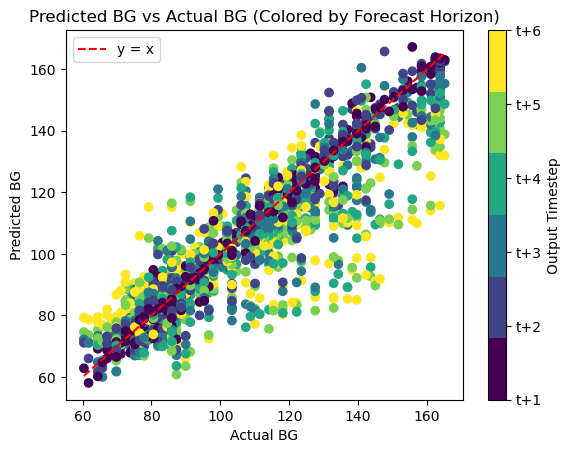


Running model for: id_37_data
Execution time: 15.00759506225586 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5502128601074219 seconds
Execution time: 0.0005786418914794922 seconds
Execution time: 8.487701416015625e-05 seconds


Overall Train RMSE: 6.682735534707092 mg/DL
Overall Test RMSE: 11.748827598880927 mg/DL


Train RMSE at t+1: 2.61 mg/DL
Train RMSE at t+2: 3.87 mg/DL
Train RMSE at t+3: 5.21 mg/DL
Train RMSE at t+4: 6.87 mg/DL
Train RMSE at t+5: 8.42 mg/DL
Train RMSE at t+6: 10.04 mg/DL


Test RMSE at t+1: 4.89 mg/DL
Test RMSE at t+2: 7.64 mg/DL
Test RMSE at t+3: 10.08 mg/DL
Test RMSE at t+4: 12.55 mg/DL
Test RMSE at t+5: 14.64 mg/DL
Test RMSE at t+6: 16.50 mg/DL


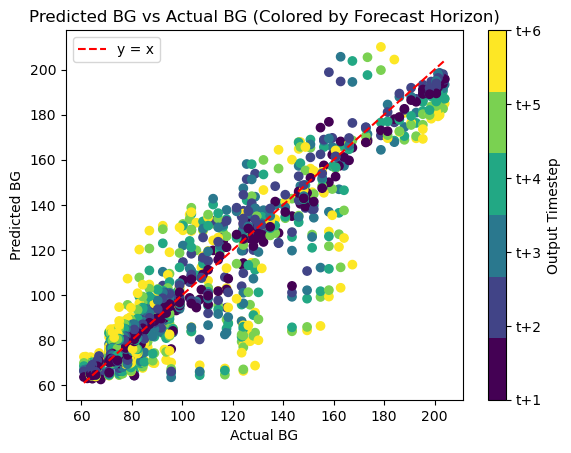


Running model for: id_38_data
Execution time: 14.566264152526855 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5615780353546143 seconds
Execution time: 0.0006620883941650391 seconds
Execution time: 8.702278137207031e-05 seconds


Overall Train RMSE: 10.799493725802774 mg/DL
Overall Test RMSE: 8.79763892711969 mg/DL


Train RMSE at t+1: 6.04 mg/DL
Train RMSE at t+2: 7.84 mg/DL
Train RMSE at t+3: 10.09 mg/DL
Train RMSE at t+4: 11.66 mg/DL
Train RMSE at t+5: 12.96 mg/DL
Train RMSE at t+6: 14.00 mg/DL


Test RMSE at t+1: 4.20 mg/DL
Test RMSE at t+2: 5.84 mg/DL
Test RMSE at t+3: 7.92 mg/DL
Test RMSE at t+4: 9.52 mg/DL
Test RMSE at t+5: 10.56 mg/DL
Test RMSE at t+6: 12.16 mg/DL


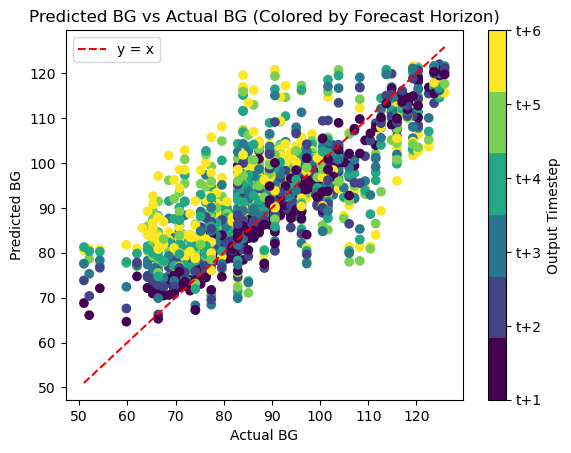


Running model for: id_39_data
Execution time: 15.405466079711914 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.5867290496826172 seconds
Execution time: 0.0005712509155273438 seconds
Execution time: 8.988380432128906e-05 seconds


Overall Train RMSE: 10.955677836144334 mg/DL
Overall Test RMSE: 13.680674936340518 mg/DL


Train RMSE at t+1: 3.86 mg/DL
Train RMSE at t+2: 6.54 mg/DL
Train RMSE at t+3: 9.10 mg/DL
Train RMSE at t+4: 11.45 mg/DL
Train RMSE at t+5: 13.74 mg/DL
Train RMSE at t+6: 16.12 mg/DL


Test RMSE at t+1: 4.40 mg/DL
Test RMSE at t+2: 7.79 mg/DL
Test RMSE at t+3: 11.10 mg/DL
Test RMSE at t+4: 14.34 mg/DL
Test RMSE at t+5: 17.32 mg/DL
Test RMSE at t+6: 20.34 mg/DL


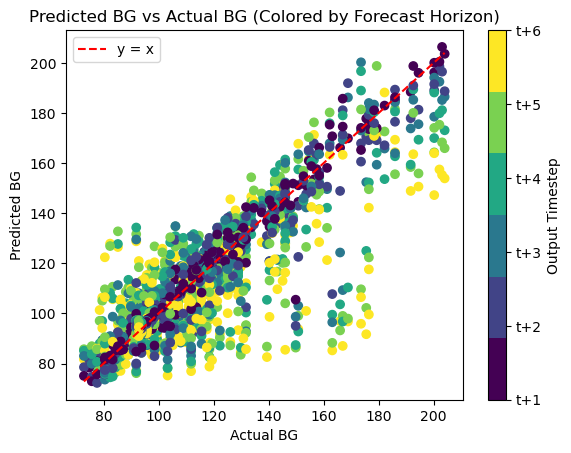


Running model for: id_40_data
Execution time: 13.21621298789978 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5731918811798096 seconds
Execution time: 0.0005509853363037109 seconds
Execution time: 8.487701416015625e-05 seconds


Overall Train RMSE: 8.81708237682556 mg/DL
Overall Test RMSE: 9.962081965200982 mg/DL


Train RMSE at t+1: 3.25 mg/DL
Train RMSE at t+2: 5.10 mg/DL
Train RMSE at t+3: 7.48 mg/DL
Train RMSE at t+4: 9.03 mg/DL
Train RMSE at t+5: 11.22 mg/DL
Train RMSE at t+6: 12.90 mg/DL


Test RMSE at t+1: 3.12 mg/DL
Test RMSE at t+2: 4.90 mg/DL
Test RMSE at t+3: 7.71 mg/DL
Test RMSE at t+4: 10.13 mg/DL
Test RMSE at t+5: 12.82 mg/DL
Test RMSE at t+6: 15.34 mg/DL


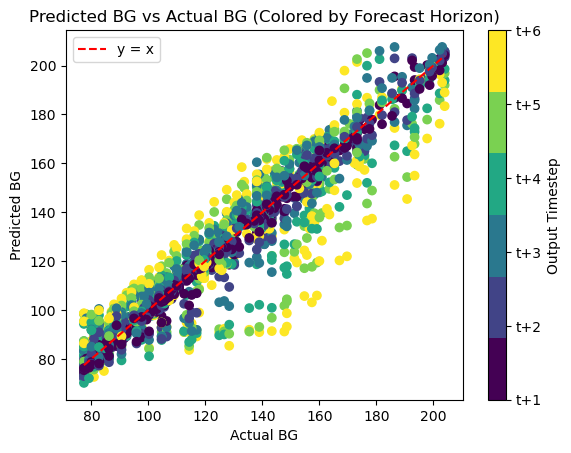


Running model for: id_41_data
Execution time: 18.611062049865723 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5498113632202148 seconds
Execution time: 0.0007121562957763672 seconds
Execution time: 9.179115295410156e-05 seconds


Overall Train RMSE: 10.21402792321149 mg/DL
Overall Test RMSE: 12.204469942466382 mg/DL


Train RMSE at t+1: 3.82 mg/DL
Train RMSE at t+2: 6.31 mg/DL
Train RMSE at t+3: 8.93 mg/DL
Train RMSE at t+4: 10.99 mg/DL
Train RMSE at t+5: 12.78 mg/DL
Train RMSE at t+6: 14.41 mg/DL


Test RMSE at t+1: 4.43 mg/DL
Test RMSE at t+2: 7.39 mg/DL
Test RMSE at t+3: 10.67 mg/DL
Test RMSE at t+4: 12.97 mg/DL
Test RMSE at t+5: 15.45 mg/DL
Test RMSE at t+6: 17.28 mg/DL


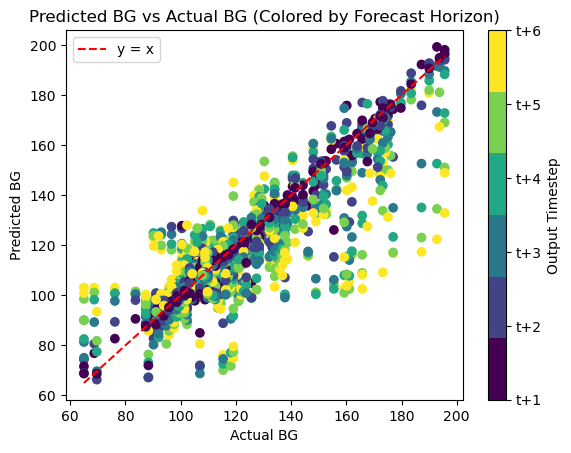


Running model for: id_42_data
Execution time: 14.880011081695557 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.570655107498169 seconds
Execution time: 0.0005698204040527344 seconds
Execution time: 0.00012636184692382812 seconds


Overall Train RMSE: 11.737406342818408 mg/DL
Overall Test RMSE: 12.22588155719847 mg/DL


Train RMSE at t+1: 5.36 mg/DL
Train RMSE at t+2: 8.09 mg/DL
Train RMSE at t+3: 10.57 mg/DL
Train RMSE at t+4: 13.02 mg/DL
Train RMSE at t+5: 14.43 mg/DL
Train RMSE at t+6: 15.59 mg/DL


Test RMSE at t+1: 5.37 mg/DL
Test RMSE at t+2: 8.25 mg/DL
Test RMSE at t+3: 10.77 mg/DL
Test RMSE at t+4: 13.31 mg/DL
Test RMSE at t+5: 15.10 mg/DL
Test RMSE at t+6: 16.69 mg/DL


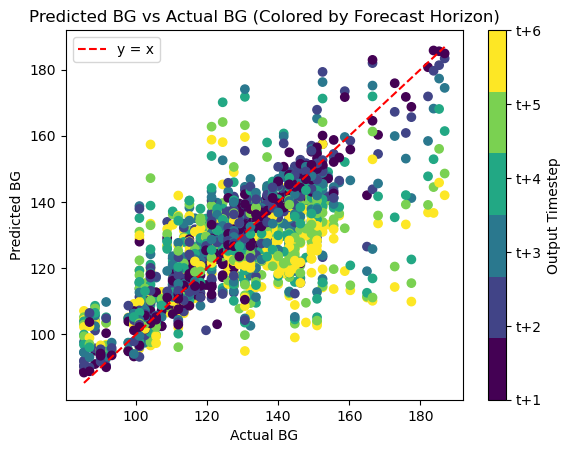


Running model for: id_43_data
Execution time: 14.906439065933228 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6545379161834717 seconds
Execution time: 0.0006039142608642578 seconds
Execution time: 8.797645568847656e-05 seconds


Overall Train RMSE: 10.390541596215526 mg/DL
Overall Test RMSE: 9.725297684358909 mg/DL


Train RMSE at t+1: 5.65 mg/DL
Train RMSE at t+2: 7.57 mg/DL
Train RMSE at t+3: 9.29 mg/DL
Train RMSE at t+4: 10.82 mg/DL
Train RMSE at t+5: 12.55 mg/DL
Train RMSE at t+6: 14.06 mg/DL


Test RMSE at t+1: 5.57 mg/DL
Test RMSE at t+2: 7.45 mg/DL
Test RMSE at t+3: 9.00 mg/DL
Test RMSE at t+4: 10.22 mg/DL
Test RMSE at t+5: 11.36 mg/DL
Test RMSE at t+6: 12.90 mg/DL


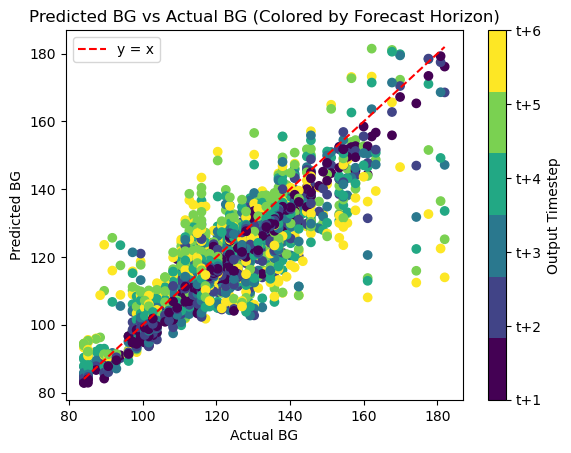


Running model for: id_44_data
Execution time: 15.22035002708435 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5532758235931396 seconds
Execution time: 0.0006961822509765625 seconds
Execution time: 0.0001468658447265625 seconds


Overall Train RMSE: 10.6624311584556 mg/DL
Overall Test RMSE: 7.491077592000704 mg/DL


Train RMSE at t+1: 5.78 mg/DL
Train RMSE at t+2: 7.96 mg/DL
Train RMSE at t+3: 9.87 mg/DL
Train RMSE at t+4: 11.55 mg/DL
Train RMSE at t+5: 12.97 mg/DL
Train RMSE at t+6: 13.66 mg/DL


Test RMSE at t+1: 4.03 mg/DL
Test RMSE at t+2: 5.50 mg/DL
Test RMSE at t+3: 6.93 mg/DL
Test RMSE at t+4: 8.20 mg/DL
Test RMSE at t+5: 9.06 mg/DL
Test RMSE at t+6: 9.64 mg/DL


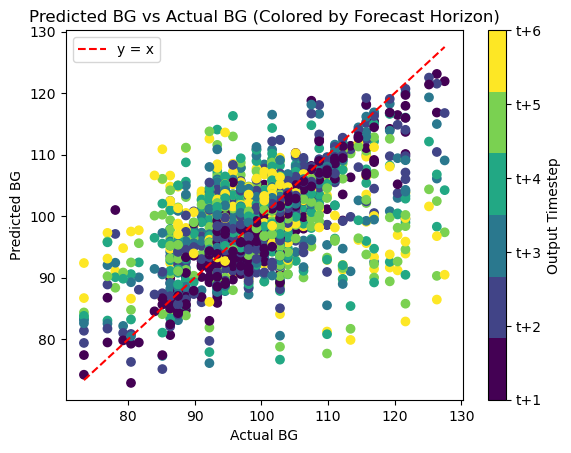


Running model for: id_45_data
Execution time: 15.090350151062012 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5666050910949707 seconds
Execution time: 0.0007071495056152344 seconds
Execution time: 9.894371032714844e-05 seconds


Overall Train RMSE: 11.945672776507537 mg/DL
Overall Test RMSE: 12.970472044681435 mg/DL


Train RMSE at t+1: 7.51 mg/DL
Train RMSE at t+2: 9.10 mg/DL
Train RMSE at t+3: 10.95 mg/DL
Train RMSE at t+4: 12.84 mg/DL
Train RMSE at t+5: 13.98 mg/DL
Train RMSE at t+6: 15.39 mg/DL


Test RMSE at t+1: 9.69 mg/DL
Test RMSE at t+2: 10.85 mg/DL
Test RMSE at t+3: 12.71 mg/DL
Test RMSE at t+4: 14.55 mg/DL
Test RMSE at t+5: 14.50 mg/DL
Test RMSE at t+6: 14.64 mg/DL


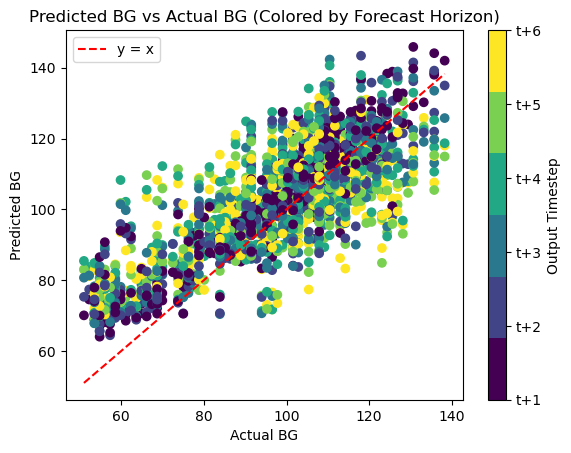


Running model for: id_46_data
Execution time: 14.873090028762817 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5599019527435303 seconds
Execution time: 0.0005679130554199219 seconds
Execution time: 8.916854858398438e-05 seconds


Overall Train RMSE: 10.042275741029668 mg/DL
Overall Test RMSE: 11.29374134209987 mg/DL


Train RMSE at t+1: 3.99 mg/DL
Train RMSE at t+2: 6.46 mg/DL
Train RMSE at t+3: 8.48 mg/DL
Train RMSE at t+4: 10.70 mg/DL
Train RMSE at t+5: 12.70 mg/DL
Train RMSE at t+6: 14.14 mg/DL


Test RMSE at t+1: 5.44 mg/DL
Test RMSE at t+2: 7.76 mg/DL
Test RMSE at t+3: 10.03 mg/DL
Test RMSE at t+4: 12.30 mg/DL
Test RMSE at t+5: 13.66 mg/DL
Test RMSE at t+6: 15.40 mg/DL


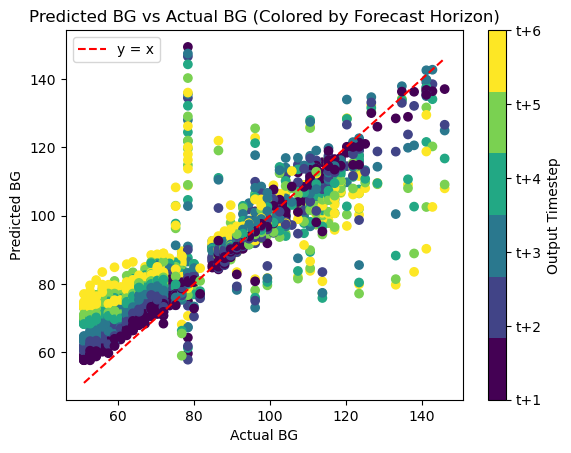


Running model for: id_47_data
Execution time: 15.390261173248291 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5535030364990234 seconds
Execution time: 0.0005881786346435547 seconds
Execution time: 0.00013709068298339844 seconds


Overall Train RMSE: 13.633887947273374 mg/DL
Overall Test RMSE: 9.120781730590846 mg/DL


Train RMSE at t+1: 5.96 mg/DL
Train RMSE at t+2: 9.74 mg/DL
Train RMSE at t+3: 12.55 mg/DL
Train RMSE at t+4: 14.82 mg/DL
Train RMSE at t+5: 16.73 mg/DL
Train RMSE at t+6: 18.11 mg/DL


Test RMSE at t+1: 4.50 mg/DL
Test RMSE at t+2: 6.87 mg/DL
Test RMSE at t+3: 8.23 mg/DL
Test RMSE at t+4: 9.70 mg/DL
Test RMSE at t+5: 11.12 mg/DL
Test RMSE at t+6: 12.09 mg/DL


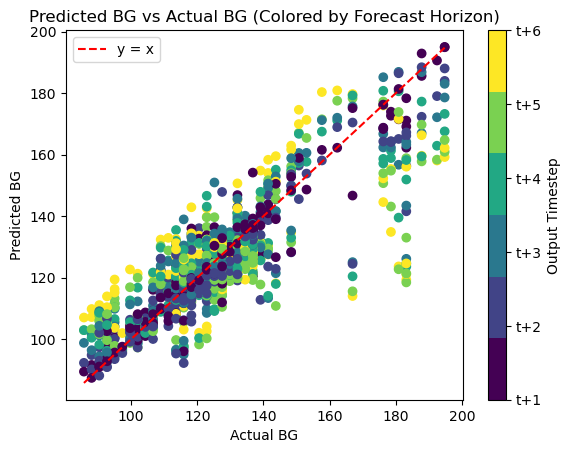


Running model for: id_48_data
Execution time: 14.413894176483154 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Execution time: 0.580664873123169 seconds
Execution time: 0.0005581378936767578 seconds
Execution time: 0.00013494491577148438 seconds


Overall Train RMSE: 12.063284117061512 mg/DL
Overall Test RMSE: 9.439227977463423 mg/DL


Train RMSE at t+1: 6.22 mg/DL
Train RMSE at t+2: 9.15 mg/DL
Train RMSE at t+3: 11.06 mg/DL
Train RMSE at t+4: 13.06 mg/DL
Train RMSE at t+5: 14.73 mg/DL
Train RMSE at t+6: 15.52 mg/DL


Test RMSE at t+1: 5.39 mg/DL
Test RMSE at t+2: 7.36 mg/DL
Test RMSE at t+3: 8.62 mg/DL
Test RMSE at t+4: 10.28 mg/DL
Test RMSE at t+5: 11.31 mg/DL
Test RMSE at t+6: 11.98 mg/DL


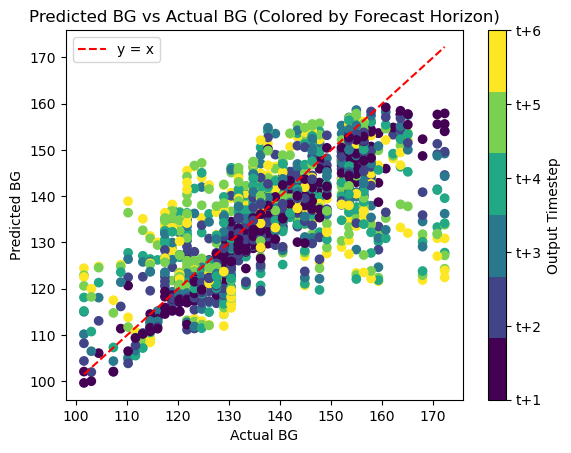


Running model for: id_49_data
Execution time: 16.0190851688385 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5645358562469482 seconds
Execution time: 0.0007429122924804688 seconds
Execution time: 0.00010704994201660156 seconds


Overall Train RMSE: 14.076998476891768 mg/DL
Overall Test RMSE: 15.42831888824054 mg/DL


Train RMSE at t+1: 5.40 mg/DL
Train RMSE at t+2: 10.08 mg/DL
Train RMSE at t+3: 12.26 mg/DL
Train RMSE at t+4: 15.60 mg/DL
Train RMSE at t+5: 17.09 mg/DL
Train RMSE at t+6: 19.30 mg/DL


Test RMSE at t+1: 6.41 mg/DL
Test RMSE at t+2: 10.93 mg/DL
Test RMSE at t+3: 13.17 mg/DL
Test RMSE at t+4: 16.69 mg/DL
Test RMSE at t+5: 18.78 mg/DL
Test RMSE at t+6: 21.52 mg/DL


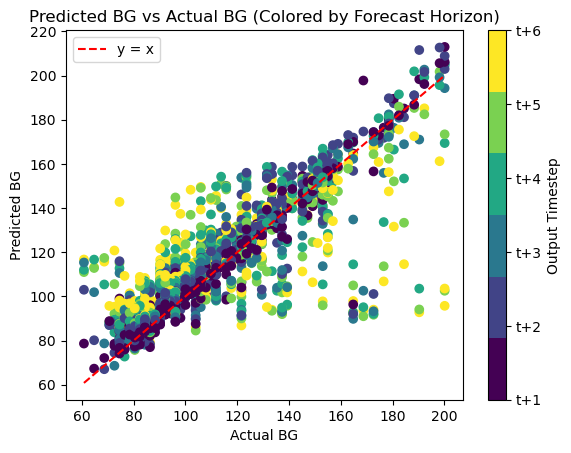


Running model for: id_50_data
Execution time: 15.977520942687988 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5846982002258301 seconds
Execution time: 0.0006289482116699219 seconds
Execution time: 0.00013589859008789062 seconds


Overall Train RMSE: 12.642068712394597 mg/DL
Overall Test RMSE: 13.193392278361443 mg/DL


Train RMSE at t+1: 5.39 mg/DL
Train RMSE at t+2: 8.74 mg/DL
Train RMSE at t+3: 11.93 mg/DL
Train RMSE at t+4: 13.78 mg/DL
Train RMSE at t+5: 15.51 mg/DL
Train RMSE at t+6: 16.76 mg/DL


Test RMSE at t+1: 4.96 mg/DL
Test RMSE at t+2: 8.51 mg/DL
Test RMSE at t+3: 12.70 mg/DL
Test RMSE at t+4: 14.51 mg/DL
Test RMSE at t+5: 16.44 mg/DL
Test RMSE at t+6: 17.48 mg/DL


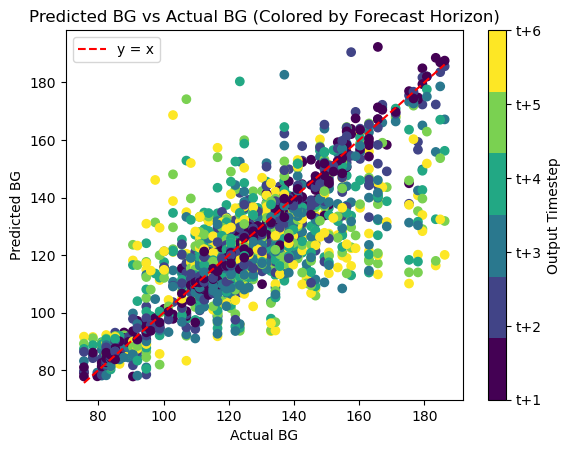


Running model for: id_51_data
Execution time: 15.904361963272095 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5649428367614746 seconds
Execution time: 0.0007007122039794922 seconds
Execution time: 9.202957153320312e-05 seconds


Overall Train RMSE: 9.951996376412707 mg/DL
Overall Test RMSE: 9.754434568423854 mg/DL


Train RMSE at t+1: 4.59 mg/DL
Train RMSE at t+2: 6.99 mg/DL
Train RMSE at t+3: 8.97 mg/DL
Train RMSE at t+4: 10.72 mg/DL
Train RMSE at t+5: 12.28 mg/DL
Train RMSE at t+6: 13.34 mg/DL


Test RMSE at t+1: 4.42 mg/DL
Test RMSE at t+2: 6.68 mg/DL
Test RMSE at t+3: 8.78 mg/DL
Test RMSE at t+4: 10.19 mg/DL
Test RMSE at t+5: 12.25 mg/DL
Test RMSE at t+6: 13.25 mg/DL


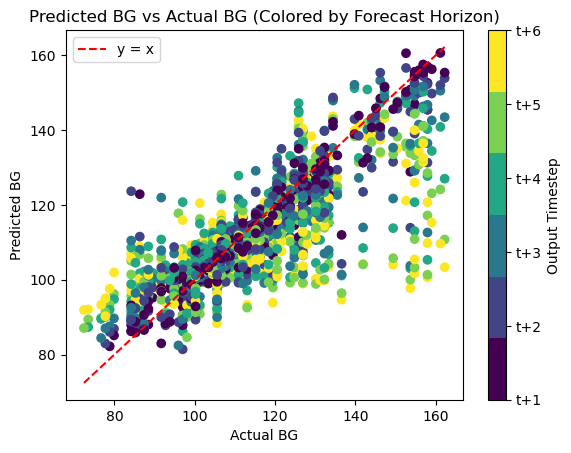


Running model for: id_52_data
Execution time: 15.761877059936523 seconds
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5840752124786377 seconds
Execution time: 0.0008192062377929688 seconds
Execution time: 0.0001971721649169922 seconds


Overall Train RMSE: 10.567264889008955 mg/DL
Overall Test RMSE: 12.996630233778388 mg/DL


Train RMSE at t+1: 5.34 mg/DL
Train RMSE at t+2: 6.80 mg/DL
Train RMSE at t+3: 9.28 mg/DL
Train RMSE at t+4: 11.22 mg/DL
Train RMSE at t+5: 13.00 mg/DL
Train RMSE at t+6: 14.64 mg/DL


Test RMSE at t+1: 5.06 mg/DL
Test RMSE at t+2: 7.05 mg/DL
Test RMSE at t+3: 10.47 mg/DL
Test RMSE at t+4: 13.58 mg/DL
Test RMSE at t+5: 16.66 mg/DL
Test RMSE at t+6: 19.14 mg/DL


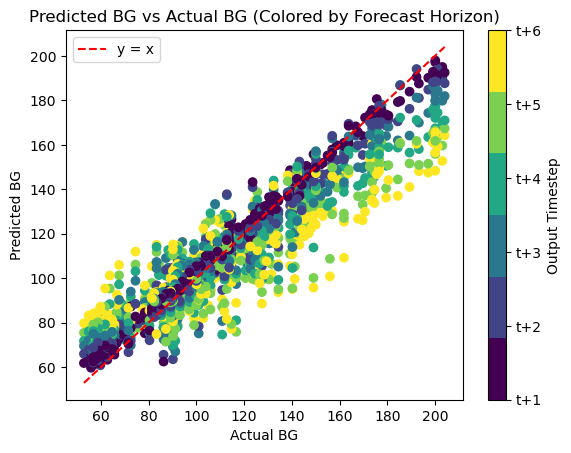


Running model for: id_53_data
Execution time: 15.220865726470947 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5509669780731201 seconds
Execution time: 0.0005738735198974609 seconds
Execution time: 9.918212890625e-05 seconds


Overall Train RMSE: 14.373776489286183 mg/DL
Overall Test RMSE: 12.932795941011719 mg/DL


Train RMSE at t+1: 5.70 mg/DL
Train RMSE at t+2: 9.08 mg/DL
Train RMSE at t+3: 12.79 mg/DL
Train RMSE at t+4: 15.81 mg/DL
Train RMSE at t+5: 18.03 mg/DL
Train RMSE at t+6: 19.64 mg/DL


Test RMSE at t+1: 5.24 mg/DL
Test RMSE at t+2: 8.10 mg/DL
Test RMSE at t+3: 11.62 mg/DL
Test RMSE at t+4: 14.36 mg/DL
Test RMSE at t+5: 16.24 mg/DL
Test RMSE at t+6: 17.47 mg/DL


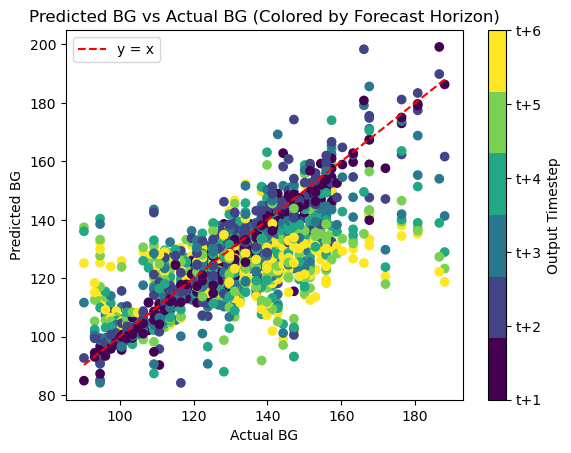


Running model for: id_54_data
Execution time: 14.686971187591553 seconds
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6178719997406006 seconds
Execution time: 0.0007271766662597656 seconds
Execution time: 0.0001990795135498047 seconds


Overall Train RMSE: 14.06645762940755 mg/DL
Overall Test RMSE: 12.911014134835463 mg/DL


Train RMSE at t+1: 7.64 mg/DL
Train RMSE at t+2: 10.61 mg/DL
Train RMSE at t+3: 12.49 mg/DL
Train RMSE at t+4: 15.20 mg/DL
Train RMSE at t+5: 17.01 mg/DL
Train RMSE at t+6: 18.44 mg/DL


Test RMSE at t+1: 7.46 mg/DL
Test RMSE at t+2: 9.98 mg/DL
Test RMSE at t+3: 11.13 mg/DL
Test RMSE at t+4: 13.63 mg/DL
Test RMSE at t+5: 15.56 mg/DL
Test RMSE at t+6: 17.13 mg/DL


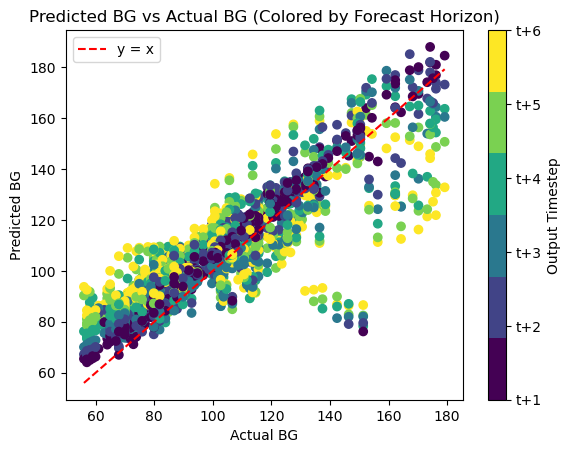


Running model for: id_55_data
Execution time: 15.223843097686768 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5644741058349609 seconds
Execution time: 0.0006949901580810547 seconds
Execution time: 9.179115295410156e-05 seconds


Overall Train RMSE: 10.37204358866913 mg/DL
Overall Test RMSE: 9.686436723630138 mg/DL


Train RMSE at t+1: 4.18 mg/DL
Train RMSE at t+2: 7.11 mg/DL
Train RMSE at t+3: 9.30 mg/DL
Train RMSE at t+4: 11.20 mg/DL
Train RMSE at t+5: 12.80 mg/DL
Train RMSE at t+6: 14.21 mg/DL


Test RMSE at t+1: 3.35 mg/DL
Test RMSE at t+2: 6.26 mg/DL
Test RMSE at t+3: 8.52 mg/DL
Test RMSE at t+4: 10.51 mg/DL
Test RMSE at t+5: 12.11 mg/DL
Test RMSE at t+6: 13.52 mg/DL


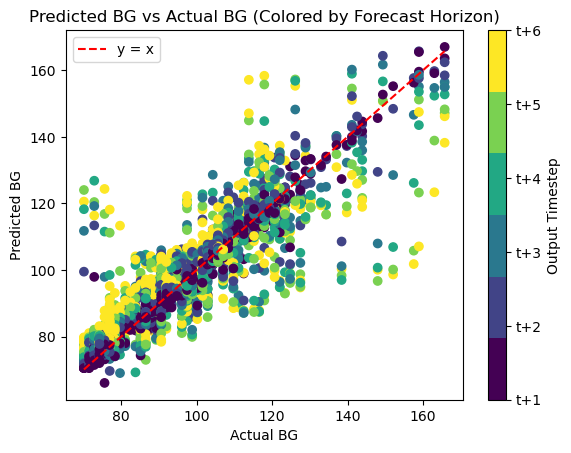


Running model for: id_56_data
Execution time: 15.055444955825806 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Execution time: 0.5754718780517578 seconds
Execution time: 0.0005309581756591797 seconds
Execution time: 0.00013494491577148438 seconds


Overall Train RMSE: 11.260059869006978 mg/DL
Overall Test RMSE: 11.832501651267918 mg/DL


Train RMSE at t+1: 5.79 mg/DL
Train RMSE at t+2: 7.38 mg/DL
Train RMSE at t+3: 10.21 mg/DL
Train RMSE at t+4: 12.03 mg/DL
Train RMSE at t+5: 13.93 mg/DL
Train RMSE at t+6: 15.15 mg/DL


Test RMSE at t+1: 5.38 mg/DL
Test RMSE at t+2: 7.29 mg/DL
Test RMSE at t+3: 10.48 mg/DL
Test RMSE at t+4: 12.80 mg/DL
Test RMSE at t+5: 14.87 mg/DL
Test RMSE at t+6: 16.22 mg/DL


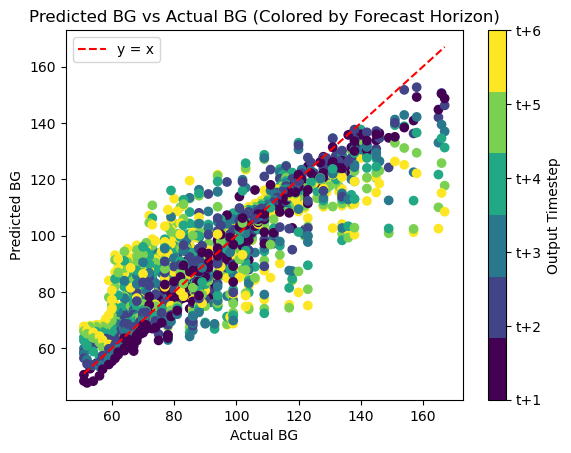

In [35]:
all_preds4 = []
all_truths4 = []
seq_length_in = 12
seq_length_out = 6
results4 = {}

for key, subset in normalized_data.items():
    print(f"\nRunning model for: {key}")
    
    try:
        preds, truths = RNN_indv(subset, seq_length_in, seq_length_out)
        all_preds4.append(preds)
        all_truths4.append(truths)
        results4[key] = (preds, truths)
    except Exception as e:
        print(f"Error for {key}: {e}")
        results4[key] = None


In [179]:
# Concatenate all predictions and truths
all_preds_concat4 = np.concatenate(all_preds4, axis=0).flatten()
all_truths_concat4 = np.concatenate(all_truths4, axis=0).flatten()

# Compute overall RMSE and MAE
combined_rmse4 = np.sqrt(mean_squared_error(all_truths_concat4, all_preds_concat4))
combined_mae4 = mean_absolute_error(all_truths_concat4, all_preds_concat4)

print(f"\nCombined RMSE across all IDs: {combined_rmse4:.2f} mg/dL")
print(f"Combined MAE  across all IDs: {combined_mae4:.2f} mg/dL\n")

# Lists to store RMSE and MAE per individual
rmse_per_individual = []
mae_per_individual = []

# Compute per-ID RMSE and MAE
for pred_array, true_array in zip(all_preds4, all_truths4):
    pred_flat = pred_array.flatten()
    true_flat = true_array.flatten()
    
    rmse = np.sqrt(mean_squared_error(true_flat, pred_flat))
    mae = mean_absolute_error(true_flat, pred_flat)
    
    rmse_per_individual.append(rmse)
    mae_per_individual.append(mae)

# Print all 56 RMSEs and MAEs
for i, (rmse, mae) in enumerate(zip(rmse_per_individual, mae_per_individual)):
    print(f"ID {i:2d}: RMSE = {rmse:.2f} mg/dL | MAE = {mae:.2f} mg/dL")

# Summary: min/max RMSE and MAE
print('\n')
print(f'The min RMSE is for ID {np.argmin(rmse_per_individual)} with a value of: {min(rmse_per_individual):.2f}')
print(f'The max RMSE is for ID {np.argmax(rmse_per_individual)} with a value of: {max(rmse_per_individual):.2f}')
print(f'The min MAE  is for ID {np.argmin(mae_per_individual)} with a value of: {min(mae_per_individual):.2f}')
print(f'The max MAE  is for ID {np.argmax(mae_per_individual)} with a value of: {max(mae_per_individual):.2f}')



Combined RMSE across all IDs: 12.26 mg/dL
Combined MAE  across all IDs: 8.01 mg/dL

ID  0: RMSE = 7.69 mg/dL | MAE = 5.37 mg/dL
ID  1: RMSE = 17.54 mg/dL | MAE = 11.07 mg/dL
ID  2: RMSE = 17.04 mg/dL | MAE = 10.27 mg/dL
ID  3: RMSE = 9.38 mg/dL | MAE = 7.10 mg/dL
ID  4: RMSE = 9.66 mg/dL | MAE = 6.51 mg/dL
ID  5: RMSE = 11.70 mg/dL | MAE = 8.43 mg/dL
ID  6: RMSE = 10.58 mg/dL | MAE = 6.83 mg/dL
ID  7: RMSE = 10.65 mg/dL | MAE = 8.22 mg/dL
ID  8: RMSE = 9.86 mg/dL | MAE = 7.07 mg/dL
ID  9: RMSE = 14.28 mg/dL | MAE = 8.79 mg/dL
ID 10: RMSE = 10.61 mg/dL | MAE = 7.36 mg/dL
ID 11: RMSE = 15.66 mg/dL | MAE = 9.88 mg/dL
ID 12: RMSE = 11.95 mg/dL | MAE = 9.13 mg/dL
ID 13: RMSE = 14.62 mg/dL | MAE = 11.11 mg/dL
ID 14: RMSE = 12.25 mg/dL | MAE = 8.70 mg/dL
ID 15: RMSE = 13.79 mg/dL | MAE = 10.05 mg/dL
ID 16: RMSE = 12.49 mg/dL | MAE = 8.29 mg/dL
ID 17: RMSE = 15.26 mg/dL | MAE = 10.92 mg/dL
ID 18: RMSE = 14.49 mg/dL | MAE = 9.91 mg/dL
ID 19: RMSE = 12.33 mg/dL | MAE = 8.94 mg/dL
ID 20: RMSE = 


Running model for: id_0_data
Execution time: 16.3315691947937 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.9667301177978516 seconds
Execution time: 0.003509044647216797 seconds
Execution time: 0.0002009868621826172 seconds


Overall Train RMSE: 10.162373546024325 mg/DL
Overall Test RMSE: 9.004995142803308 mg/DL


Train RMSE at t+1: 4.75 mg/DL
Train RMSE at t+2: 6.75 mg/DL
Train RMSE at t+3: 8.73 mg/DL
Train RMSE at t+4: 10.91 mg/DL
Train RMSE at t+5: 12.62 mg/DL
Train RMSE at t+6: 14.03 mg/DL


Test RMSE at t+1: 4.39 mg/DL
Test RMSE at t+2: 6.08 mg/DL
Test RMSE at t+3: 7.61 mg/DL
Test RMSE at t+4: 9.71 mg/DL
Test RMSE at t+5: 11.15 mg/DL
Test RMSE at t+6: 12.40 mg/DL


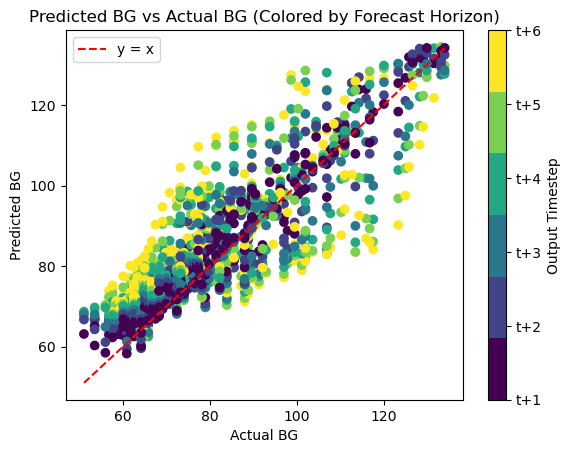


Running model for: id_1_data
Execution time: 12.848817825317383 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.7461161613464355 seconds
Execution time: 0.0007748603820800781 seconds
Execution time: 0.00017213821411132812 seconds


Overall Train RMSE: 14.45717534448805 mg/DL
Overall Test RMSE: 18.553859553929787 mg/DL


Train RMSE at t+1: 8.33 mg/DL
Train RMSE at t+2: 10.61 mg/DL
Train RMSE at t+3: 13.11 mg/DL
Train RMSE at t+4: 15.15 mg/DL
Train RMSE at t+5: 17.38 mg/DL
Train RMSE at t+6: 19.19 mg/DL


Test RMSE at t+1: 12.32 mg/DL
Test RMSE at t+2: 15.63 mg/DL
Test RMSE at t+3: 18.09 mg/DL
Test RMSE at t+4: 19.73 mg/DL
Test RMSE at t+5: 21.25 mg/DL
Test RMSE at t+6: 22.39 mg/DL


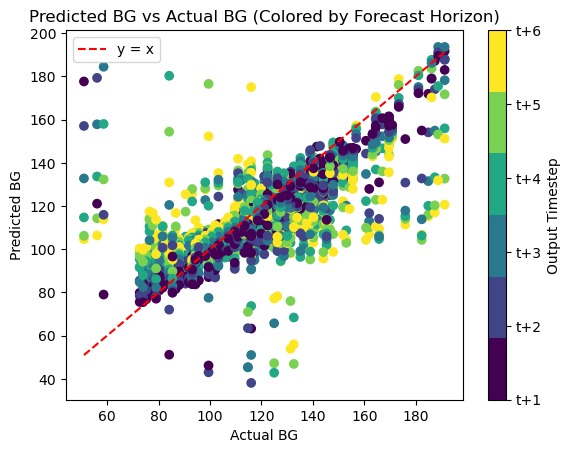


Running model for: id_2_data
Execution time: 12.239893913269043 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Execution time: 0.6825978755950928 seconds
Execution time: 0.0005660057067871094 seconds
Execution time: 0.00015687942504882812 seconds


Overall Train RMSE: 8.732570521405238 mg/DL
Overall Test RMSE: 23.152247138747644 mg/DL


Train RMSE at t+1: 5.22 mg/DL
Train RMSE at t+2: 6.91 mg/DL
Train RMSE at t+3: 8.44 mg/DL
Train RMSE at t+4: 9.46 mg/DL
Train RMSE at t+5: 10.28 mg/DL
Train RMSE at t+6: 10.77 mg/DL


Test RMSE at t+1: 17.58 mg/DL
Test RMSE at t+2: 20.00 mg/DL
Test RMSE at t+3: 23.06 mg/DL
Test RMSE at t+4: 24.64 mg/DL
Test RMSE at t+5: 25.89 mg/DL
Test RMSE at t+6: 26.42 mg/DL


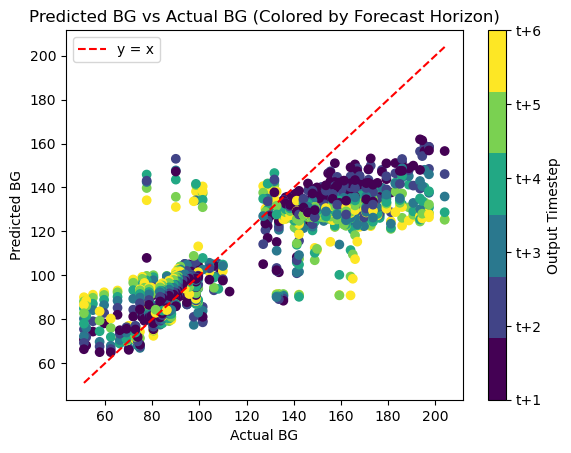


Running model for: id_3_data
Execution time: 12.378146171569824 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6128132343292236 seconds
Execution time: 0.0006279945373535156 seconds
Execution time: 0.00017905235290527344 seconds


Overall Train RMSE: 10.680856082882142 mg/DL
Overall Test RMSE: 9.417660362827649 mg/DL


Train RMSE at t+1: 5.59 mg/DL
Train RMSE at t+2: 8.00 mg/DL
Train RMSE at t+3: 9.92 mg/DL
Train RMSE at t+4: 11.71 mg/DL
Train RMSE at t+5: 12.80 mg/DL
Train RMSE at t+6: 13.78 mg/DL


Test RMSE at t+1: 5.51 mg/DL
Test RMSE at t+2: 7.56 mg/DL
Test RMSE at t+3: 8.83 mg/DL
Test RMSE at t+4: 10.07 mg/DL
Test RMSE at t+5: 11.07 mg/DL
Test RMSE at t+6: 11.94 mg/DL


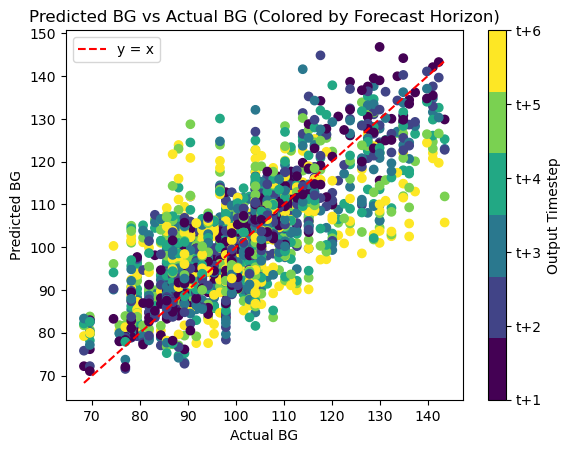


Running model for: id_4_data
Execution time: 12.945731163024902 seconds
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6345410346984863 seconds
Execution time: 0.0006730556488037109 seconds
Execution time: 0.00016498565673828125 seconds


Overall Train RMSE: 12.247248200733226 mg/DL
Overall Test RMSE: 10.37746386549608 mg/DL


Train RMSE at t+1: 6.18 mg/DL
Train RMSE at t+2: 8.67 mg/DL
Train RMSE at t+3: 11.19 mg/DL
Train RMSE at t+4: 13.01 mg/DL
Train RMSE at t+5: 15.14 mg/DL
Train RMSE at t+6: 16.22 mg/DL


Test RMSE at t+1: 5.32 mg/DL
Test RMSE at t+2: 7.79 mg/DL
Test RMSE at t+3: 9.52 mg/DL
Test RMSE at t+4: 11.45 mg/DL
Test RMSE at t+5: 12.23 mg/DL
Test RMSE at t+6: 13.64 mg/DL


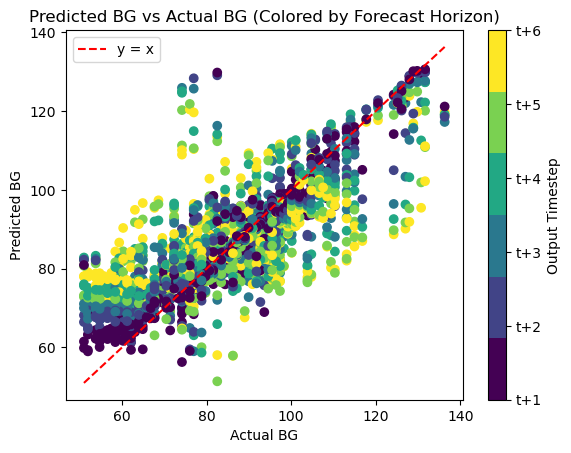


Running model for: id_5_data
Execution time: 14.139282941818237 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6419730186462402 seconds
Execution time: 0.0006330013275146484 seconds
Execution time: 0.00017404556274414062 seconds


Overall Train RMSE: 15.844616797101548 mg/DL
Overall Test RMSE: 12.289418232568279 mg/DL


Train RMSE at t+1: 8.32 mg/DL
Train RMSE at t+2: 11.98 mg/DL
Train RMSE at t+3: 14.40 mg/DL
Train RMSE at t+4: 17.52 mg/DL
Train RMSE at t+5: 19.23 mg/DL
Train RMSE at t+6: 20.23 mg/DL


Test RMSE at t+1: 7.81 mg/DL
Test RMSE at t+2: 10.42 mg/DL
Test RMSE at t+3: 11.73 mg/DL
Test RMSE at t+4: 13.60 mg/DL
Test RMSE at t+5: 14.25 mg/DL
Test RMSE at t+6: 14.53 mg/DL


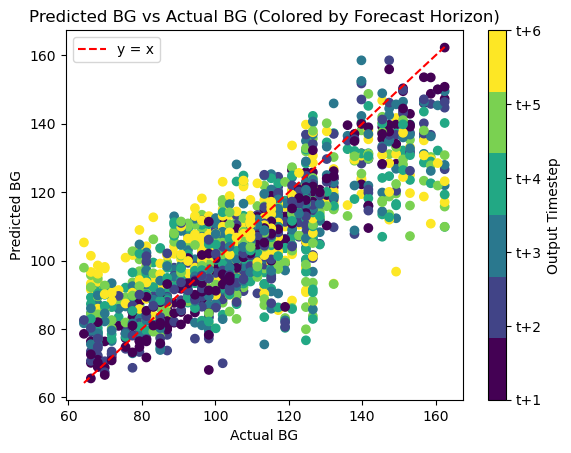


Running model for: id_6_data
Execution time: 12.699170112609863 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6079661846160889 seconds
Execution time: 0.0006499290466308594 seconds
Execution time: 0.00015997886657714844 seconds


Overall Train RMSE: 10.857564375137592 mg/DL
Overall Test RMSE: 10.696340381543386 mg/DL


Train RMSE at t+1: 5.37 mg/DL
Train RMSE at t+2: 7.49 mg/DL
Train RMSE at t+3: 9.73 mg/DL
Train RMSE at t+4: 11.67 mg/DL
Train RMSE at t+5: 13.26 mg/DL
Train RMSE at t+6: 14.69 mg/DL


Test RMSE at t+1: 6.03 mg/DL
Test RMSE at t+2: 8.31 mg/DL
Test RMSE at t+3: 10.25 mg/DL
Test RMSE at t+4: 11.70 mg/DL
Test RMSE at t+5: 12.66 mg/DL
Test RMSE at t+6: 13.37 mg/DL


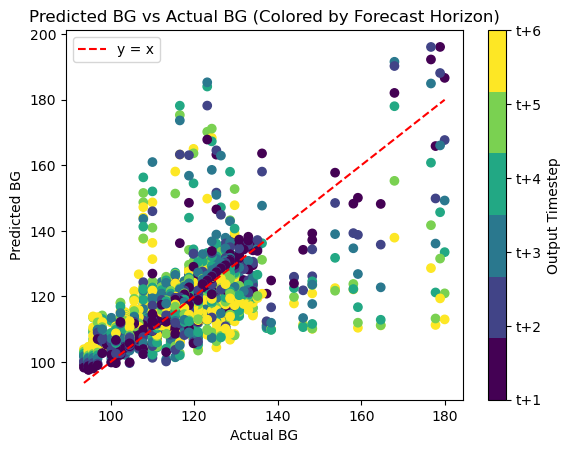


Running model for: id_7_data
Execution time: 12.041678190231323 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6337380409240723 seconds
Execution time: 0.0006451606750488281 seconds
Execution time: 9.989738464355469e-05 seconds


Overall Train RMSE: 13.61557154303043 mg/DL
Overall Test RMSE: 10.286485856677247 mg/DL


Train RMSE at t+1: 6.91 mg/DL
Train RMSE at t+2: 9.87 mg/DL
Train RMSE at t+3: 12.94 mg/DL
Train RMSE at t+4: 14.89 mg/DL
Train RMSE at t+5: 16.31 mg/DL
Train RMSE at t+6: 17.66 mg/DL


Test RMSE at t+1: 4.77 mg/DL
Test RMSE at t+2: 6.77 mg/DL
Test RMSE at t+3: 9.21 mg/DL
Test RMSE at t+4: 11.11 mg/DL
Test RMSE at t+5: 12.90 mg/DL
Test RMSE at t+6: 13.85 mg/DL


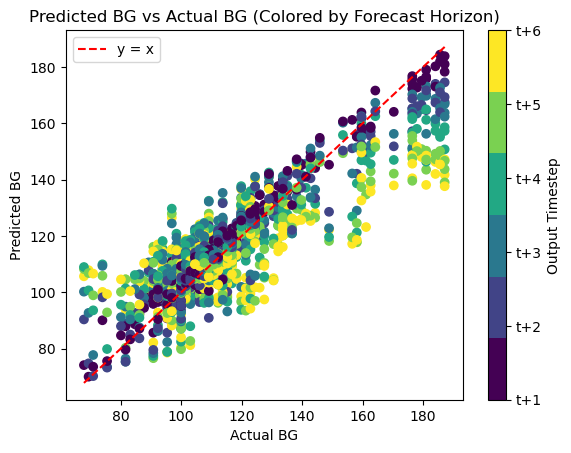


Running model for: id_8_data
Execution time: 13.344414949417114 seconds
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.7971079349517822 seconds
Execution time: 0.0007562637329101562 seconds
Execution time: 0.0001010894775390625 seconds


Overall Train RMSE: 12.659784491209242 mg/DL
Overall Test RMSE: 11.445635786814297 mg/DL


Train RMSE at t+1: 7.08 mg/DL
Train RMSE at t+2: 9.43 mg/DL
Train RMSE at t+3: 11.51 mg/DL
Train RMSE at t+4: 13.78 mg/DL
Train RMSE at t+5: 15.25 mg/DL
Train RMSE at t+6: 16.37 mg/DL


Test RMSE at t+1: 6.91 mg/DL
Test RMSE at t+2: 8.87 mg/DL
Test RMSE at t+3: 10.61 mg/DL
Test RMSE at t+4: 12.60 mg/DL
Test RMSE at t+5: 13.61 mg/DL
Test RMSE at t+6: 14.24 mg/DL


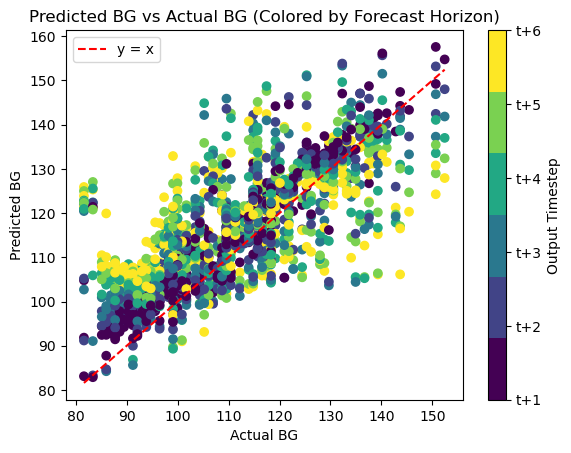


Running model for: id_9_data
Execution time: 12.930803775787354 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.7145299911499023 seconds
Execution time: 0.0007588863372802734 seconds
Execution time: 0.00017714500427246094 seconds


Overall Train RMSE: 13.220797532122814 mg/DL
Overall Test RMSE: 15.677843151335841 mg/DL


Train RMSE at t+1: 8.61 mg/DL
Train RMSE at t+2: 10.23 mg/DL
Train RMSE at t+3: 12.12 mg/DL
Train RMSE at t+4: 13.88 mg/DL
Train RMSE at t+5: 15.51 mg/DL
Train RMSE at t+6: 17.03 mg/DL


Test RMSE at t+1: 10.34 mg/DL
Test RMSE at t+2: 12.69 mg/DL
Test RMSE at t+3: 14.50 mg/DL
Test RMSE at t+4: 16.45 mg/DL
Test RMSE at t+5: 18.30 mg/DL
Test RMSE at t+6: 19.79 mg/DL


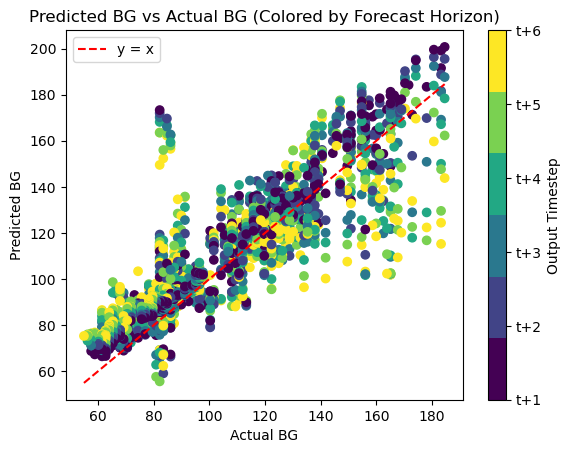


Running model for: id_10_data
Execution time: 13.048318147659302 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6958060264587402 seconds
Execution time: 0.0008070468902587891 seconds
Execution time: 0.00018167495727539062 seconds


Overall Train RMSE: 12.789231630841382 mg/DL
Overall Test RMSE: 11.642534057848176 mg/DL


Train RMSE at t+1: 6.47 mg/DL
Train RMSE at t+2: 9.08 mg/DL
Train RMSE at t+3: 11.70 mg/DL
Train RMSE at t+4: 13.93 mg/DL
Train RMSE at t+5: 15.39 mg/DL
Train RMSE at t+6: 17.01 mg/DL


Test RMSE at t+1: 5.01 mg/DL
Test RMSE at t+2: 7.35 mg/DL
Test RMSE at t+3: 9.92 mg/DL
Test RMSE at t+4: 12.38 mg/DL
Test RMSE at t+5: 14.48 mg/DL
Test RMSE at t+6: 16.52 mg/DL


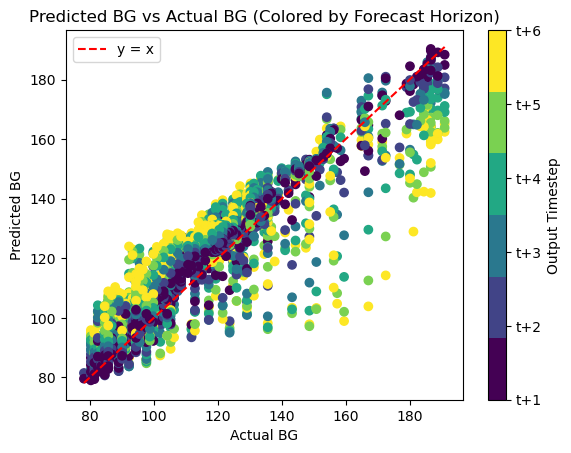


Running model for: id_11_data
Execution time: 12.662611246109009 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6659121513366699 seconds
Execution time: 0.0006561279296875 seconds
Execution time: 0.00013494491577148438 seconds


Overall Train RMSE: 10.793318299830023 mg/DL
Overall Test RMSE: 16.20827771429605 mg/DL


Train RMSE at t+1: 6.74 mg/DL
Train RMSE at t+2: 8.42 mg/DL
Train RMSE at t+3: 9.97 mg/DL
Train RMSE at t+4: 11.38 mg/DL
Train RMSE at t+5: 12.71 mg/DL
Train RMSE at t+6: 13.86 mg/DL


Test RMSE at t+1: 9.28 mg/DL
Test RMSE at t+2: 12.29 mg/DL
Test RMSE at t+3: 15.05 mg/DL
Test RMSE at t+4: 17.11 mg/DL
Test RMSE at t+5: 19.49 mg/DL
Test RMSE at t+6: 20.98 mg/DL


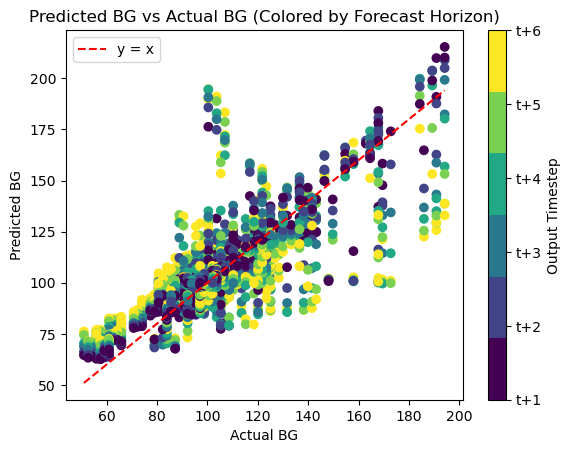


Running model for: id_12_data
Execution time: 13.007905006408691 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6621010303497314 seconds
Execution time: 0.0007328987121582031 seconds
Execution time: 0.00017786026000976562 seconds


Overall Train RMSE: 10.405250748336261 mg/DL
Overall Test RMSE: 12.882409295902574 mg/DL


Train RMSE at t+1: 6.51 mg/DL
Train RMSE at t+2: 8.48 mg/DL
Train RMSE at t+3: 9.97 mg/DL
Train RMSE at t+4: 11.10 mg/DL
Train RMSE at t+5: 12.11 mg/DL
Train RMSE at t+6: 12.89 mg/DL


Test RMSE at t+1: 9.14 mg/DL
Test RMSE at t+2: 10.94 mg/DL
Test RMSE at t+3: 12.29 mg/DL
Test RMSE at t+4: 13.34 mg/DL
Test RMSE at t+5: 14.55 mg/DL
Test RMSE at t+6: 15.86 mg/DL


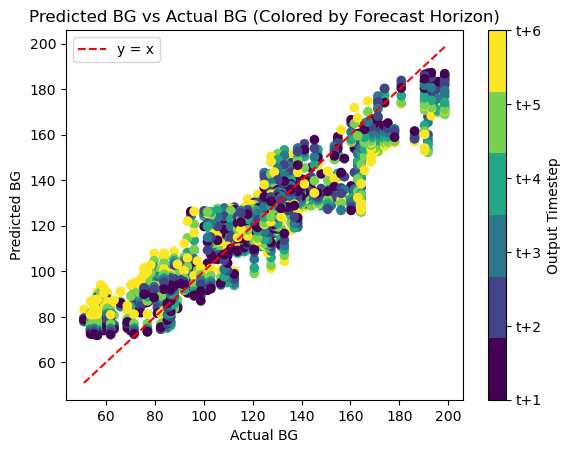


Running model for: id_13_data
Execution time: 13.35985016822815 seconds
59/59 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.7256908416748047 seconds
Execution time: 0.0011241436004638672 seconds
Execution time: 0.00029015541076660156 seconds


Overall Train RMSE: 13.520682644653162 mg/DL
Overall Test RMSE: 14.456167139513617 mg/DL


Train RMSE at t+1: 6.21 mg/DL
Train RMSE at t+2: 9.67 mg/DL
Train RMSE at t+3: 12.41 mg/DL
Train RMSE at t+4: 14.69 mg/DL
Train RMSE at t+5: 16.50 mg/DL
Train RMSE at t+6: 17.96 mg/DL


Test RMSE at t+1: 6.46 mg/DL
Test RMSE at t+2: 10.08 mg/DL
Test RMSE at t+3: 12.97 mg/DL
Test RMSE at t+4: 15.18 mg/DL
Test RMSE at t+5: 17.81 mg/DL
Test RMSE at t+6: 19.87 mg/DL


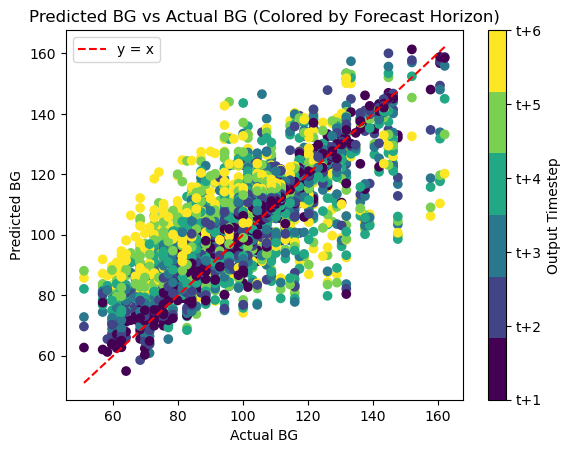


Running model for: id_14_data
Execution time: 12.122077941894531 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6886200904846191 seconds
Execution time: 0.0007789134979248047 seconds
Execution time: 0.0001990795135498047 seconds


Overall Train RMSE: 11.894435481897562 mg/DL
Overall Test RMSE: 12.66953180936325 mg/DL


Train RMSE at t+1: 6.98 mg/DL
Train RMSE at t+2: 9.50 mg/DL
Train RMSE at t+3: 11.39 mg/DL
Train RMSE at t+4: 12.42 mg/DL
Train RMSE at t+5: 13.98 mg/DL
Train RMSE at t+6: 15.18 mg/DL


Test RMSE at t+1: 6.69 mg/DL
Test RMSE at t+2: 9.36 mg/DL
Test RMSE at t+3: 11.57 mg/DL
Test RMSE at t+4: 13.17 mg/DL
Test RMSE at t+5: 15.17 mg/DL
Test RMSE at t+6: 17.12 mg/DL


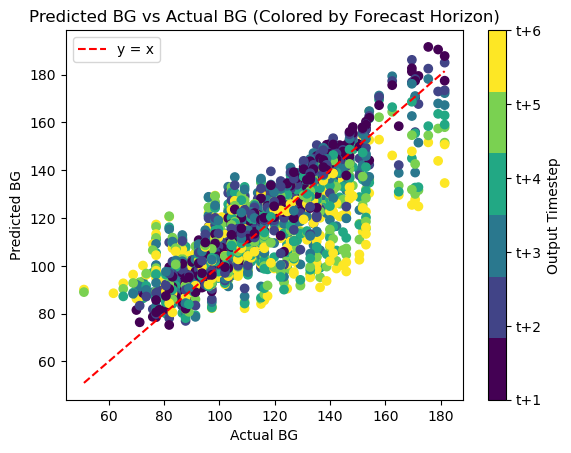


Running model for: id_15_data
Execution time: 12.851656198501587 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6328060626983643 seconds
Execution time: 0.0009601116180419922 seconds
Execution time: 0.00018596649169921875 seconds


Overall Train RMSE: 12.029940765020207 mg/DL
Overall Test RMSE: 13.702167785548184 mg/DL


Train RMSE at t+1: 7.75 mg/DL
Train RMSE at t+2: 10.32 mg/DL
Train RMSE at t+3: 11.78 mg/DL
Train RMSE at t+4: 13.06 mg/DL
Train RMSE at t+5: 13.79 mg/DL
Train RMSE at t+6: 14.22 mg/DL


Test RMSE at t+1: 8.17 mg/DL
Test RMSE at t+2: 11.27 mg/DL
Test RMSE at t+3: 13.37 mg/DL
Test RMSE at t+4: 14.99 mg/DL
Test RMSE at t+5: 16.01 mg/DL
Test RMSE at t+6: 16.53 mg/DL


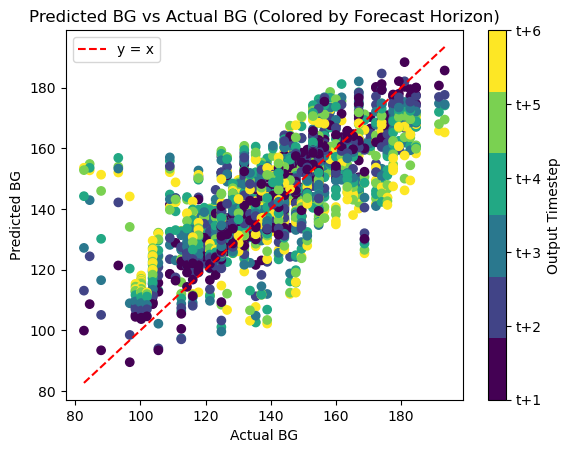


Running model for: id_16_data
Execution time: 32.28647303581238 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.7545619010925293 seconds
Execution time: 0.0015749931335449219 seconds
Execution time: 0.00014209747314453125 seconds


Overall Train RMSE: 14.324541744972269 mg/DL
Overall Test RMSE: 12.166211670868947 mg/DL


Train RMSE at t+1: 6.02 mg/DL
Train RMSE at t+2: 9.81 mg/DL
Train RMSE at t+3: 13.18 mg/DL
Train RMSE at t+4: 15.77 mg/DL
Train RMSE at t+5: 17.74 mg/DL
Train RMSE at t+6: 19.01 mg/DL


Test RMSE at t+1: 4.80 mg/DL
Test RMSE at t+2: 8.09 mg/DL
Test RMSE at t+3: 11.13 mg/DL
Test RMSE at t+4: 13.39 mg/DL
Test RMSE at t+5: 15.12 mg/DL
Test RMSE at t+6: 16.37 mg/DL


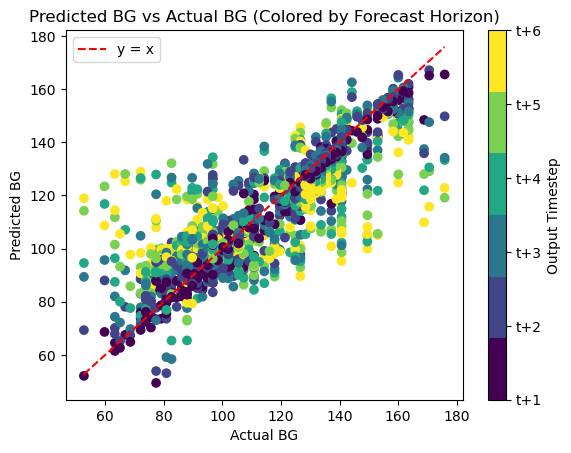


Running model for: id_17_data
Execution time: 13.408091068267822 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6953690052032471 seconds
Execution time: 0.0006680488586425781 seconds
Execution time: 0.0001919269561767578 seconds


Overall Train RMSE: 13.422039768435925 mg/DL
Overall Test RMSE: 15.461797770822034 mg/DL


Train RMSE at t+1: 6.33 mg/DL
Train RMSE at t+2: 9.90 mg/DL
Train RMSE at t+3: 12.55 mg/DL
Train RMSE at t+4: 14.69 mg/DL
Train RMSE at t+5: 16.27 mg/DL
Train RMSE at t+6: 17.46 mg/DL


Test RMSE at t+1: 8.57 mg/DL
Test RMSE at t+2: 12.14 mg/DL
Test RMSE at t+3: 14.85 mg/DL
Test RMSE at t+4: 17.11 mg/DL
Test RMSE at t+5: 18.28 mg/DL
Test RMSE at t+6: 19.13 mg/DL


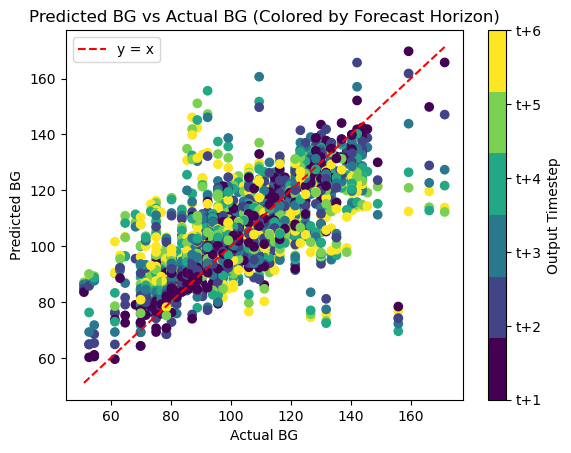


Running model for: id_18_data
Execution time: 14.531817197799683 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.8108310699462891 seconds
Execution time: 0.0012187957763671875 seconds
Execution time: 0.00010013580322265625 seconds


Overall Train RMSE: 15.173463752717323 mg/DL
Overall Test RMSE: 15.31538151905273 mg/DL


Train RMSE at t+1: 7.53 mg/DL
Train RMSE at t+2: 10.62 mg/DL
Train RMSE at t+3: 13.79 mg/DL
Train RMSE at t+4: 16.61 mg/DL
Train RMSE at t+5: 18.62 mg/DL
Train RMSE at t+6: 19.98 mg/DL


Test RMSE at t+1: 7.26 mg/DL
Test RMSE at t+2: 10.78 mg/DL
Test RMSE at t+3: 14.07 mg/DL
Test RMSE at t+4: 16.60 mg/DL
Test RMSE at t+5: 18.75 mg/DL
Test RMSE at t+6: 20.33 mg/DL


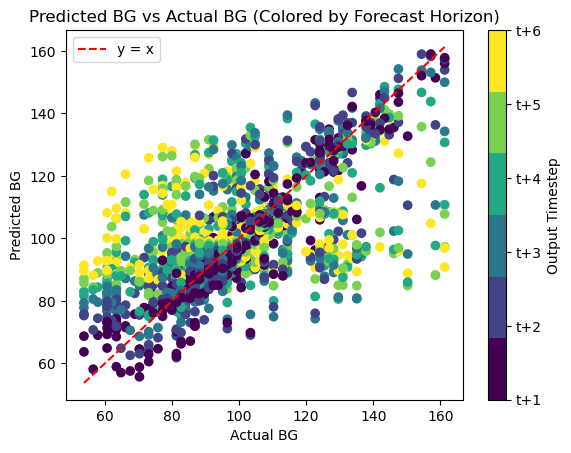


Running model for: id_19_data
Execution time: 13.048899173736572 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6413497924804688 seconds
Execution time: 0.0006902217864990234 seconds
Execution time: 0.00021409988403320312 seconds


Overall Train RMSE: 15.297125041227766 mg/DL
Overall Test RMSE: 12.211284544913392 mg/DL


Train RMSE at t+1: 6.08 mg/DL
Train RMSE at t+2: 9.90 mg/DL
Train RMSE at t+3: 14.08 mg/DL
Train RMSE at t+4: 16.82 mg/DL
Train RMSE at t+5: 19.05 mg/DL
Train RMSE at t+6: 20.62 mg/DL


Test RMSE at t+1: 5.63 mg/DL
Test RMSE at t+2: 8.77 mg/DL
Test RMSE at t+3: 11.85 mg/DL
Test RMSE at t+4: 13.36 mg/DL
Test RMSE at t+5: 14.81 mg/DL
Test RMSE at t+6: 15.74 mg/DL


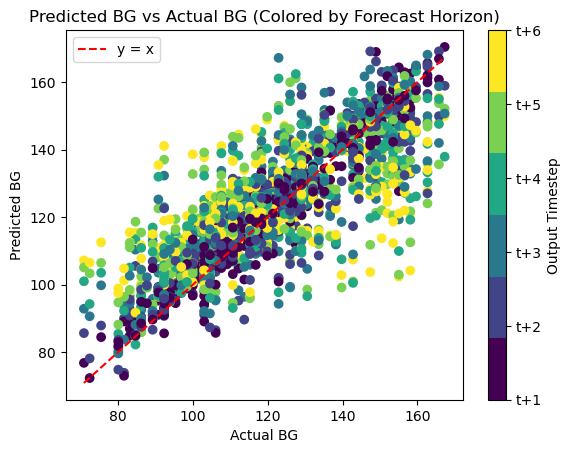


Running model for: id_20_data
Execution time: 11.600959300994873 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5920257568359375 seconds
Execution time: 0.0005588531494140625 seconds
Execution time: 0.000164031982421875 seconds


Overall Train RMSE: 10.292776677677606 mg/DL
Overall Test RMSE: 13.878487518200643 mg/DL


Train RMSE at t+1: 4.94 mg/DL
Train RMSE at t+2: 7.35 mg/DL
Train RMSE at t+3: 9.37 mg/DL
Train RMSE at t+4: 11.17 mg/DL
Train RMSE at t+5: 12.54 mg/DL
Train RMSE at t+6: 13.69 mg/DL


Test RMSE at t+1: 5.72 mg/DL
Test RMSE at t+2: 9.01 mg/DL
Test RMSE at t+3: 11.92 mg/DL
Test RMSE at t+4: 14.96 mg/DL
Test RMSE at t+5: 17.22 mg/DL
Test RMSE at t+6: 19.48 mg/DL


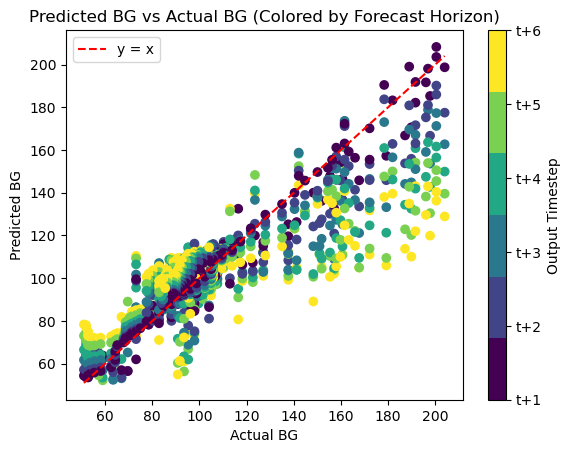


Running model for: id_21_data
Execution time: 11.426743030548096 seconds
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5882308483123779 seconds
Execution time: 0.0005953311920166016 seconds
Execution time: 0.00013589859008789062 seconds


Overall Train RMSE: 9.691433339444673 mg/DL
Overall Test RMSE: 11.250185777117867 mg/DL


Train RMSE at t+1: 4.65 mg/DL
Train RMSE at t+2: 7.05 mg/DL
Train RMSE at t+3: 8.30 mg/DL
Train RMSE at t+4: 10.13 mg/DL
Train RMSE at t+5: 12.18 mg/DL
Train RMSE at t+6: 13.13 mg/DL


Test RMSE at t+1: 5.00 mg/DL
Test RMSE at t+2: 7.61 mg/DL
Test RMSE at t+3: 9.58 mg/DL
Test RMSE at t+4: 11.77 mg/DL
Test RMSE at t+5: 14.17 mg/DL
Test RMSE at t+6: 15.66 mg/DL


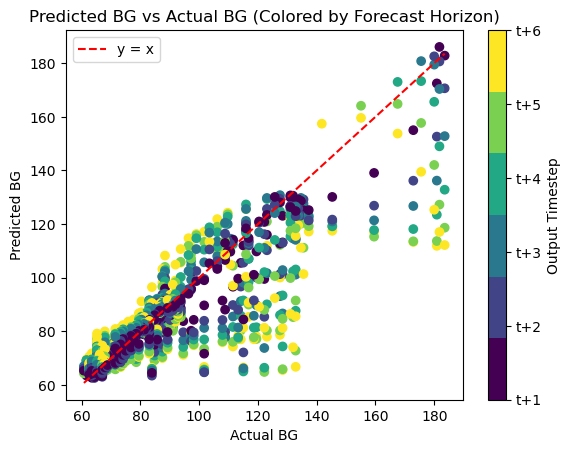


Running model for: id_22_data
Execution time: 11.177963972091675 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5954699516296387 seconds
Execution time: 0.0005669593811035156 seconds
Execution time: 8.606910705566406e-05 seconds


Overall Train RMSE: 13.30575702995723 mg/DL
Overall Test RMSE: 10.600596512728606 mg/DL


Train RMSE at t+1: 4.48 mg/DL
Train RMSE at t+2: 7.55 mg/DL
Train RMSE at t+3: 11.13 mg/DL
Train RMSE at t+4: 14.04 mg/DL
Train RMSE at t+5: 17.05 mg/DL
Train RMSE at t+6: 19.32 mg/DL


Test RMSE at t+1: 3.50 mg/DL
Test RMSE at t+2: 5.82 mg/DL
Test RMSE at t+3: 8.99 mg/DL
Test RMSE at t+4: 11.01 mg/DL
Test RMSE at t+5: 13.60 mg/DL
Test RMSE at t+6: 15.53 mg/DL


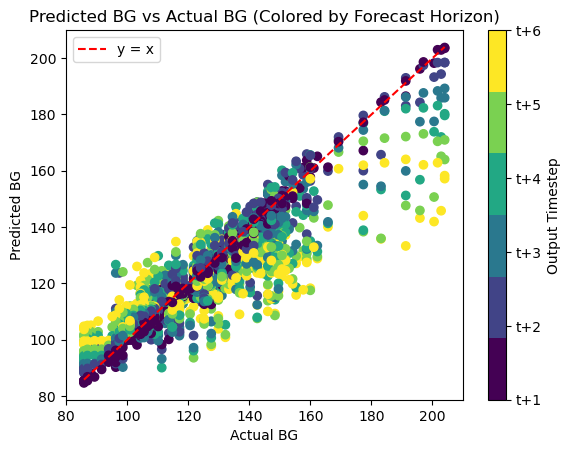


Running model for: id_23_data
Execution time: 11.27222990989685 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.5897459983825684 seconds
Execution time: 0.0005431175231933594 seconds
Execution time: 0.00013184547424316406 seconds


Overall Train RMSE: 6.876167880212372 mg/DL
Overall Test RMSE: 17.08647048247252 mg/DL


Train RMSE at t+1: 3.73 mg/DL
Train RMSE at t+2: 5.15 mg/DL
Train RMSE at t+3: 6.36 mg/DL
Train RMSE at t+4: 7.40 mg/DL
Train RMSE at t+5: 8.29 mg/DL
Train RMSE at t+6: 8.91 mg/DL


Test RMSE at t+1: 11.80 mg/DL
Test RMSE at t+2: 15.41 mg/DL
Test RMSE at t+3: 16.90 mg/DL
Test RMSE at t+4: 18.16 mg/DL
Test RMSE at t+5: 18.78 mg/DL
Test RMSE at t+6: 20.17 mg/DL


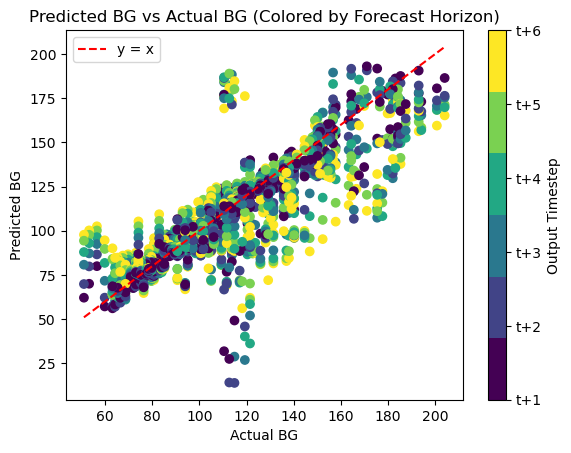


Running model for: id_24_data
Execution time: 10.93854308128357 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Execution time: 0.5814950466156006 seconds
Execution time: 0.0005528926849365234 seconds
Execution time: 0.0001342296600341797 seconds


Overall Train RMSE: 10.49131098886649 mg/DL
Overall Test RMSE: 13.434860653707412 mg/DL


Train RMSE at t+1: 4.94 mg/DL
Train RMSE at t+2: 7.39 mg/DL
Train RMSE at t+3: 9.63 mg/DL
Train RMSE at t+4: 11.31 mg/DL
Train RMSE at t+5: 12.85 mg/DL
Train RMSE at t+6: 13.98 mg/DL


Test RMSE at t+1: 5.12 mg/DL
Test RMSE at t+2: 8.18 mg/DL
Test RMSE at t+3: 11.56 mg/DL
Test RMSE at t+4: 14.30 mg/DL
Test RMSE at t+5: 16.85 mg/DL
Test RMSE at t+6: 19.18 mg/DL


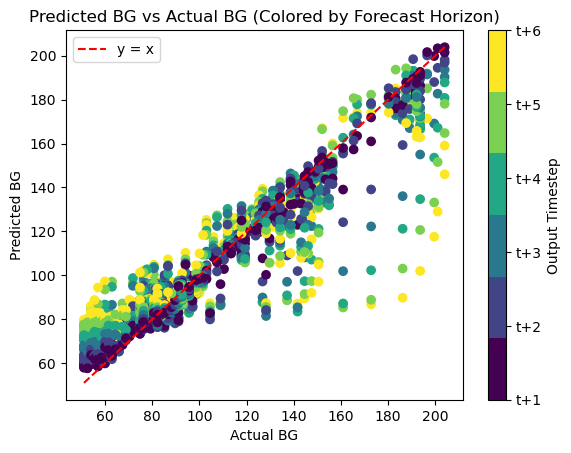


Running model for: id_25_data
Execution time: 12.899423837661743 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.7845799922943115 seconds
Execution time: 0.0006158351898193359 seconds
Execution time: 0.00019097328186035156 seconds


Overall Train RMSE: 12.617625037017369 mg/DL
Overall Test RMSE: 10.941567812644145 mg/DL


Train RMSE at t+1: 4.09 mg/DL
Train RMSE at t+2: 7.60 mg/DL
Train RMSE at t+3: 10.76 mg/DL
Train RMSE at t+4: 13.46 mg/DL
Train RMSE at t+5: 15.98 mg/DL
Train RMSE at t+6: 18.12 mg/DL


Test RMSE at t+1: 3.22 mg/DL
Test RMSE at t+2: 6.59 mg/DL
Test RMSE at t+3: 9.52 mg/DL
Test RMSE at t+4: 11.84 mg/DL
Test RMSE at t+5: 13.90 mg/DL
Test RMSE at t+6: 15.51 mg/DL


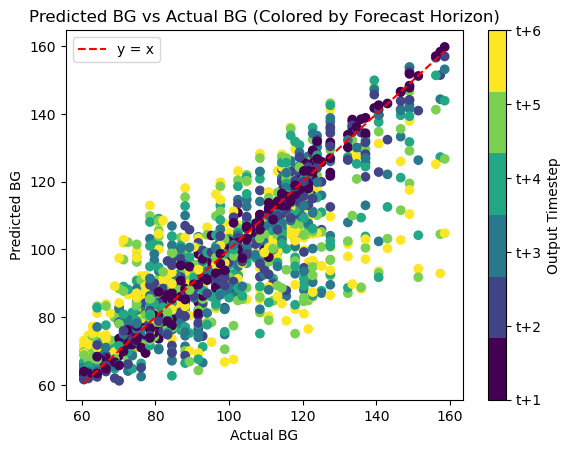


Running model for: id_26_data
Execution time: 15.706967115402222 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.8474709987640381 seconds
Execution time: 0.0009751319885253906 seconds
Execution time: 0.0001780986785888672 seconds


Overall Train RMSE: 7.61820000193985 mg/DL
Overall Test RMSE: 6.512467494218358 mg/DL


Train RMSE at t+1: 4.11 mg/DL
Train RMSE at t+2: 5.05 mg/DL
Train RMSE at t+3: 6.71 mg/DL
Train RMSE at t+4: 8.01 mg/DL
Train RMSE at t+5: 9.27 mg/DL
Train RMSE at t+6: 10.52 mg/DL


Test RMSE at t+1: 4.36 mg/DL
Test RMSE at t+2: 4.97 mg/DL
Test RMSE at t+3: 6.19 mg/DL
Test RMSE at t+4: 6.86 mg/DL
Test RMSE at t+5: 7.52 mg/DL
Test RMSE at t+6: 8.30 mg/DL


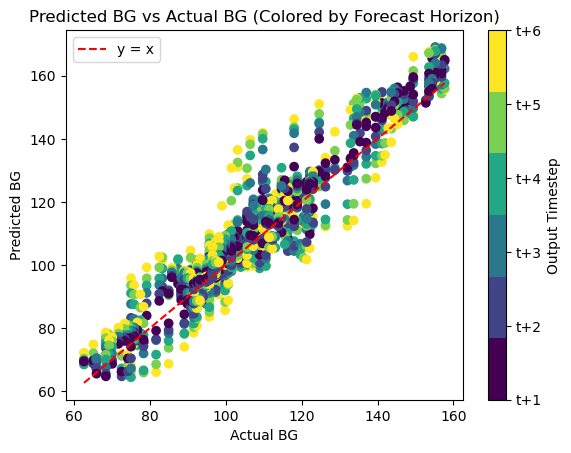


Running model for: id_27_data
Execution time: 15.07922887802124 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.7386300563812256 seconds
Execution time: 0.0007610321044921875 seconds
Execution time: 0.00017881393432617188 seconds


Overall Train RMSE: 13.648395955773703 mg/DL
Overall Test RMSE: 13.974257543837405 mg/DL


Train RMSE at t+1: 7.98 mg/DL
Train RMSE at t+2: 10.07 mg/DL
Train RMSE at t+3: 12.33 mg/DL
Train RMSE at t+4: 14.49 mg/DL
Train RMSE at t+5: 16.39 mg/DL
Train RMSE at t+6: 17.95 mg/DL


Test RMSE at t+1: 7.88 mg/DL
Test RMSE at t+2: 9.64 mg/DL
Test RMSE at t+3: 12.45 mg/DL
Test RMSE at t+4: 15.15 mg/DL
Test RMSE at t+5: 17.14 mg/DL
Test RMSE at t+6: 18.40 mg/DL


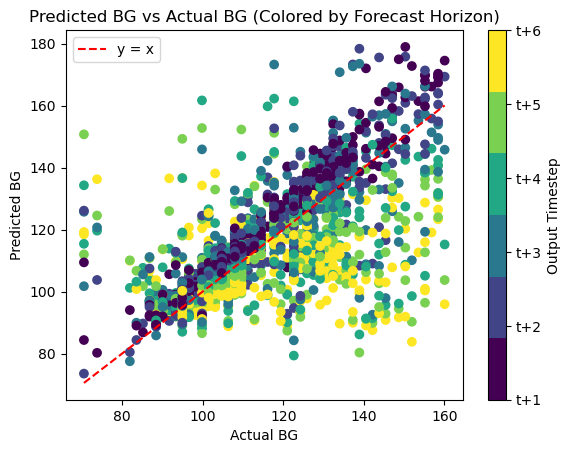


Running model for: id_28_data
Execution time: 13.82480788230896 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6701900959014893 seconds
Execution time: 0.0007419586181640625 seconds
Execution time: 0.00019621849060058594 seconds


Overall Train RMSE: 11.821111145251018 mg/DL
Overall Test RMSE: 10.260407040198222 mg/DL


Train RMSE at t+1: 5.30 mg/DL
Train RMSE at t+2: 8.40 mg/DL
Train RMSE at t+3: 10.88 mg/DL
Train RMSE at t+4: 12.77 mg/DL
Train RMSE at t+5: 14.80 mg/DL
Train RMSE at t+6: 15.47 mg/DL


Test RMSE at t+1: 4.24 mg/DL
Test RMSE at t+2: 6.86 mg/DL
Test RMSE at t+3: 9.09 mg/DL
Test RMSE at t+4: 10.95 mg/DL
Test RMSE at t+5: 13.08 mg/DL
Test RMSE at t+6: 13.88 mg/DL


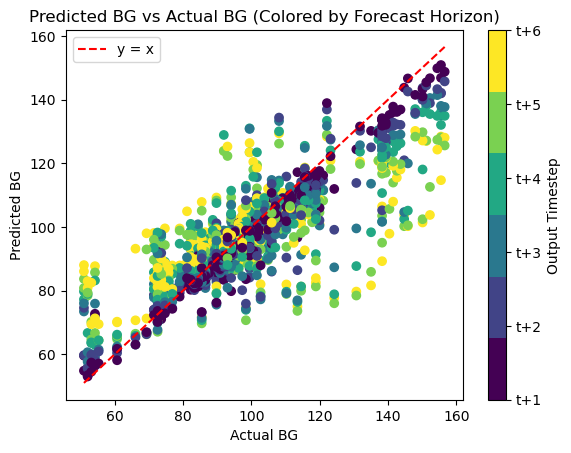


Running model for: id_29_data
Execution time: 12.839212656021118 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6347537040710449 seconds
Execution time: 0.0006499290466308594 seconds
Execution time: 0.00019407272338867188 seconds


Overall Train RMSE: 14.417941689690737 mg/DL
Overall Test RMSE: 14.606161259621203 mg/DL


Train RMSE at t+1: 7.33 mg/DL
Train RMSE at t+2: 10.77 mg/DL
Train RMSE at t+3: 13.80 mg/DL
Train RMSE at t+4: 15.74 mg/DL
Train RMSE at t+5: 17.37 mg/DL
Train RMSE at t+6: 18.38 mg/DL


Test RMSE at t+1: 5.66 mg/DL
Test RMSE at t+2: 9.32 mg/DL
Test RMSE at t+3: 13.23 mg/DL
Test RMSE at t+4: 16.05 mg/DL
Test RMSE at t+5: 18.34 mg/DL
Test RMSE at t+6: 19.81 mg/DL


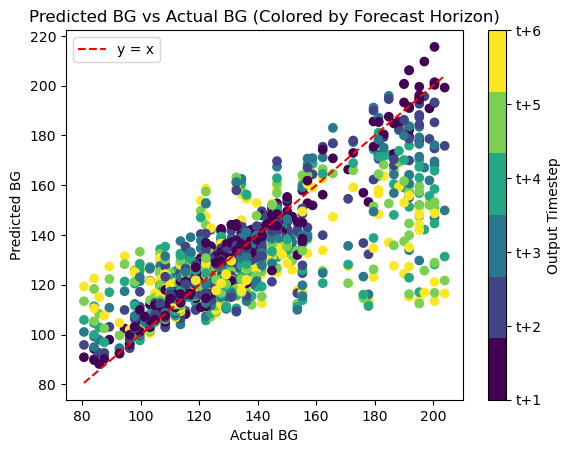


Running model for: id_30_data
Execution time: 12.86907410621643 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6434011459350586 seconds
Execution time: 0.0006270408630371094 seconds
Execution time: 9.703636169433594e-05 seconds


Overall Train RMSE: 12.983140695991992 mg/DL
Overall Test RMSE: 11.32407492272186 mg/DL


Train RMSE at t+1: 6.93 mg/DL
Train RMSE at t+2: 9.02 mg/DL
Train RMSE at t+3: 11.83 mg/DL
Train RMSE at t+4: 13.93 mg/DL
Train RMSE at t+5: 15.70 mg/DL
Train RMSE at t+6: 17.36 mg/DL


Test RMSE at t+1: 6.13 mg/DL
Test RMSE at t+2: 7.67 mg/DL
Test RMSE at t+3: 9.87 mg/DL
Test RMSE at t+4: 11.91 mg/DL
Test RMSE at t+5: 13.82 mg/DL
Test RMSE at t+6: 15.59 mg/DL


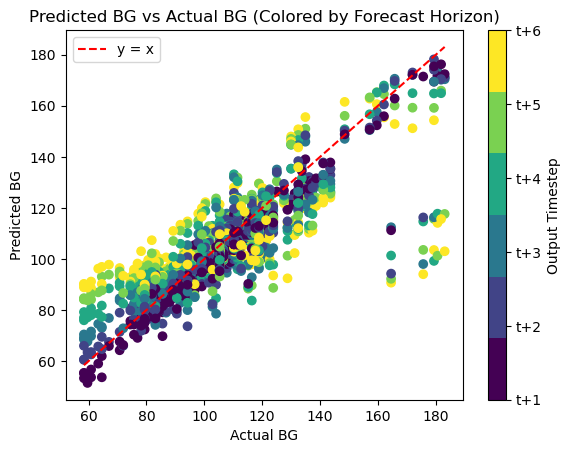


Running model for: id_31_data
Execution time: 12.563863039016724 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6756911277770996 seconds
Execution time: 0.0007009506225585938 seconds
Execution time: 0.0001800060272216797 seconds


Overall Train RMSE: 17.19769155840935 mg/DL
Overall Test RMSE: 10.724005318379005 mg/DL


Train RMSE at t+1: 8.51 mg/DL
Train RMSE at t+2: 12.91 mg/DL
Train RMSE at t+3: 16.24 mg/DL
Train RMSE at t+4: 19.05 mg/DL
Train RMSE at t+5: 20.73 mg/DL
Train RMSE at t+6: 21.90 mg/DL


Test RMSE at t+1: 6.15 mg/DL
Test RMSE at t+2: 8.36 mg/DL
Test RMSE at t+3: 10.13 mg/DL
Test RMSE at t+4: 11.64 mg/DL
Test RMSE at t+5: 12.78 mg/DL
Test RMSE at t+6: 13.44 mg/DL


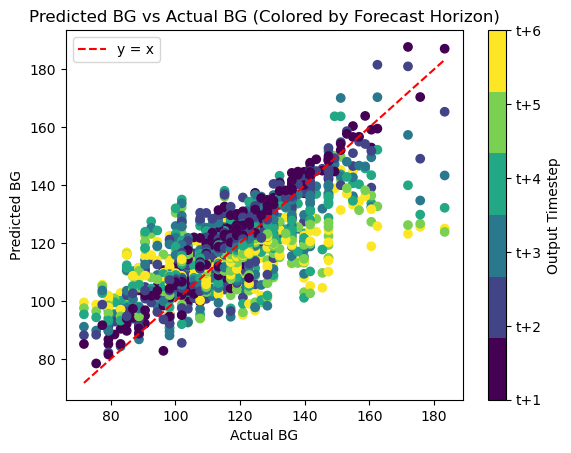


Running model for: id_32_data
Execution time: 13.105037212371826 seconds
48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6968159675598145 seconds
Execution time: 0.0009679794311523438 seconds
Execution time: 0.00027489662170410156 seconds


Overall Train RMSE: 9.204105919902961 mg/DL
Overall Test RMSE: 13.726795848393285 mg/DL


Train RMSE at t+1: 4.59 mg/DL
Train RMSE at t+2: 6.49 mg/DL
Train RMSE at t+3: 8.23 mg/DL
Train RMSE at t+4: 9.90 mg/DL
Train RMSE at t+5: 11.48 mg/DL
Train RMSE at t+6: 12.14 mg/DL


Test RMSE at t+1: 9.57 mg/DL
Test RMSE at t+2: 9.63 mg/DL
Test RMSE at t+3: 11.28 mg/DL
Test RMSE at t+4: 14.60 mg/DL
Test RMSE at t+5: 16.26 mg/DL
Test RMSE at t+6: 18.48 mg/DL


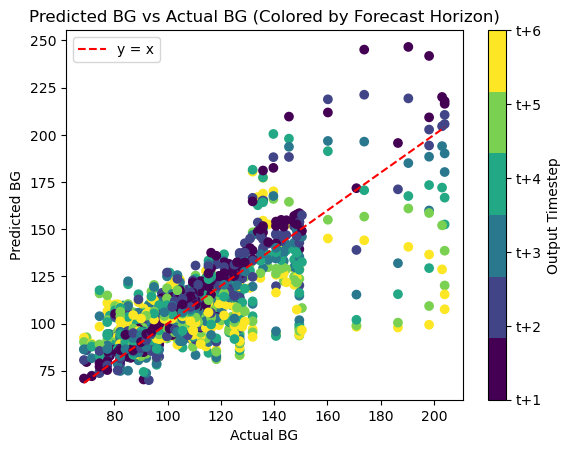


Running model for: id_33_data
Execution time: 18.30658197402954 seconds
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.8696868419647217 seconds
Execution time: 0.0009000301361083984 seconds
Execution time: 0.00023126602172851562 seconds


Overall Train RMSE: 14.254125781473382 mg/DL
Overall Test RMSE: 15.107404039097213 mg/DL


Train RMSE at t+1: 5.63 mg/DL
Train RMSE at t+2: 9.46 mg/DL
Train RMSE at t+3: 12.57 mg/DL
Train RMSE at t+4: 15.52 mg/DL
Train RMSE at t+5: 18.02 mg/DL
Train RMSE at t+6: 19.35 mg/DL


Test RMSE at t+1: 7.10 mg/DL
Test RMSE at t+2: 11.08 mg/DL
Test RMSE at t+3: 14.36 mg/DL
Test RMSE at t+4: 16.69 mg/DL
Test RMSE at t+5: 18.33 mg/DL
Test RMSE at t+6: 19.38 mg/DL


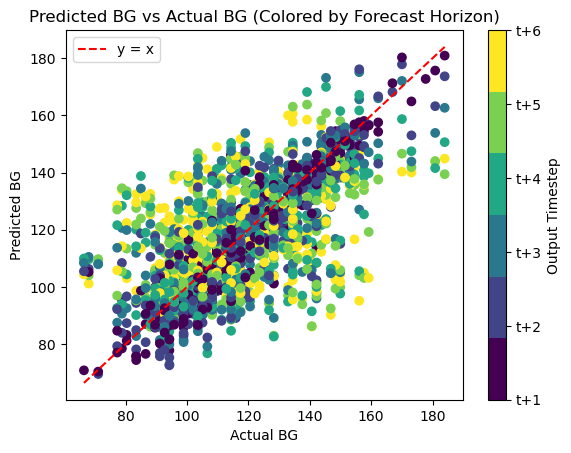


Running model for: id_34_data
Execution time: 17.660018920898438 seconds
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.9484241008758545 seconds
Execution time: 0.0008592605590820312 seconds
Execution time: 0.00019884109497070312 seconds


Overall Train RMSE: 8.82929182315029 mg/DL
Overall Test RMSE: 15.381647533972107 mg/DL


Train RMSE at t+1: 5.59 mg/DL
Train RMSE at t+2: 7.24 mg/DL
Train RMSE at t+3: 7.94 mg/DL
Train RMSE at t+4: 9.49 mg/DL
Train RMSE at t+5: 10.31 mg/DL
Train RMSE at t+6: 11.16 mg/DL


Test RMSE at t+1: 9.32 mg/DL
Test RMSE at t+2: 12.03 mg/DL
Test RMSE at t+3: 14.25 mg/DL
Test RMSE at t+4: 16.35 mg/DL
Test RMSE at t+5: 18.14 mg/DL
Test RMSE at t+6: 19.72 mg/DL


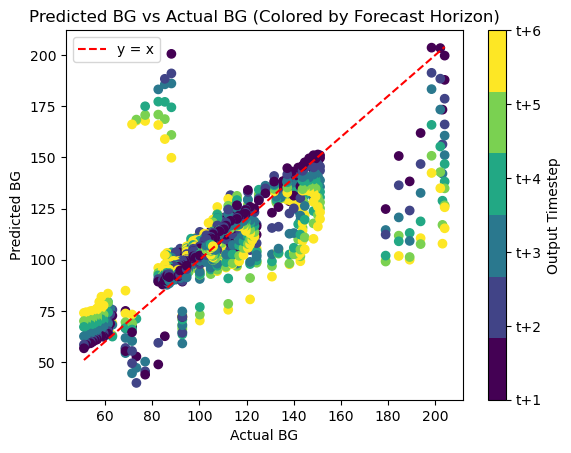


Running model for: id_35_data
Execution time: 23.148170948028564 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 1.0989658832550049 seconds
Execution time: 0.0009560585021972656 seconds
Execution time: 0.000225067138671875 seconds


Overall Train RMSE: 11.472441995686944 mg/DL
Overall Test RMSE: 7.662307152947918 mg/DL


Train RMSE at t+1: 7.36 mg/DL
Train RMSE at t+2: 9.31 mg/DL
Train RMSE at t+3: 10.83 mg/DL
Train RMSE at t+4: 12.25 mg/DL
Train RMSE at t+5: 13.23 mg/DL
Train RMSE at t+6: 14.38 mg/DL


Test RMSE at t+1: 5.54 mg/DL
Test RMSE at t+2: 6.36 mg/DL
Test RMSE at t+3: 7.15 mg/DL
Test RMSE at t+4: 8.18 mg/DL
Test RMSE at t+5: 8.74 mg/DL
Test RMSE at t+6: 9.31 mg/DL


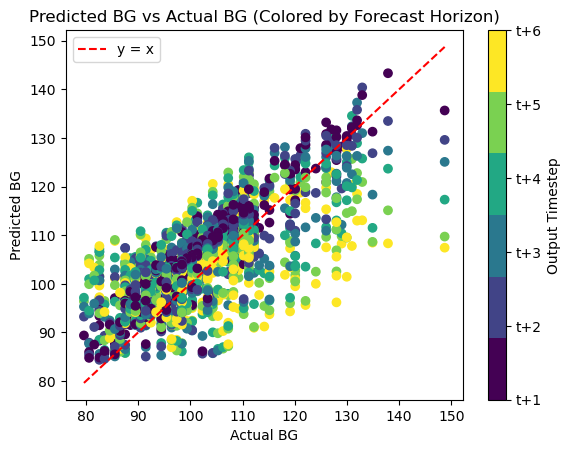


Running model for: id_36_data
Execution time: 23.067800760269165 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
Execution time: 0.9939498901367188 seconds
Execution time: 0.0009148120880126953 seconds
Execution time: 0.00012683868408203125 seconds


Overall Train RMSE: 14.32459356495105 mg/DL
Overall Test RMSE: 12.139251350343093 mg/DL


Train RMSE at t+1: 6.93 mg/DL
Train RMSE at t+2: 9.88 mg/DL
Train RMSE at t+3: 12.90 mg/DL
Train RMSE at t+4: 15.28 mg/DL
Train RMSE at t+5: 17.53 mg/DL
Train RMSE at t+6: 19.45 mg/DL


Test RMSE at t+1: 5.94 mg/DL
Test RMSE at t+2: 8.39 mg/DL
Test RMSE at t+3: 10.94 mg/DL
Test RMSE at t+4: 12.80 mg/DL
Test RMSE at t+5: 14.76 mg/DL
Test RMSE at t+6: 16.65 mg/DL


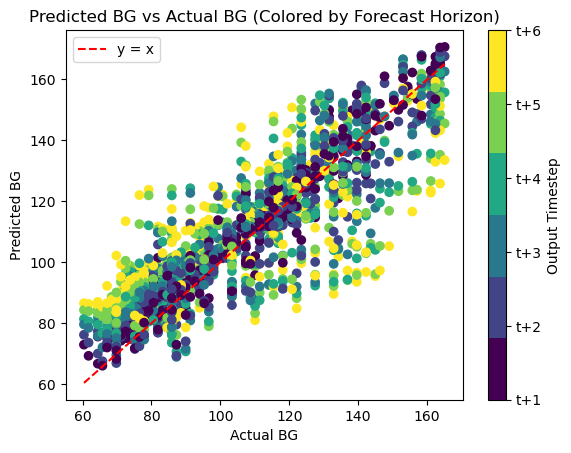


Running model for: id_37_data
Execution time: 19.53843402862549 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.9567461013793945 seconds
Execution time: 0.0007579326629638672 seconds
Execution time: 0.0002048015594482422 seconds


Overall Train RMSE: 8.05714036605988 mg/DL
Overall Test RMSE: 13.250240477907658 mg/DL


Train RMSE at t+1: 3.61 mg/DL
Train RMSE at t+2: 5.36 mg/DL
Train RMSE at t+3: 6.98 mg/DL
Train RMSE at t+4: 8.50 mg/DL
Train RMSE at t+5: 9.95 mg/DL
Train RMSE at t+6: 11.30 mg/DL


Test RMSE at t+1: 5.94 mg/DL
Test RMSE at t+2: 9.03 mg/DL
Test RMSE at t+3: 11.84 mg/DL
Test RMSE at t+4: 14.34 mg/DL
Test RMSE at t+5: 16.39 mg/DL
Test RMSE at t+6: 17.95 mg/DL


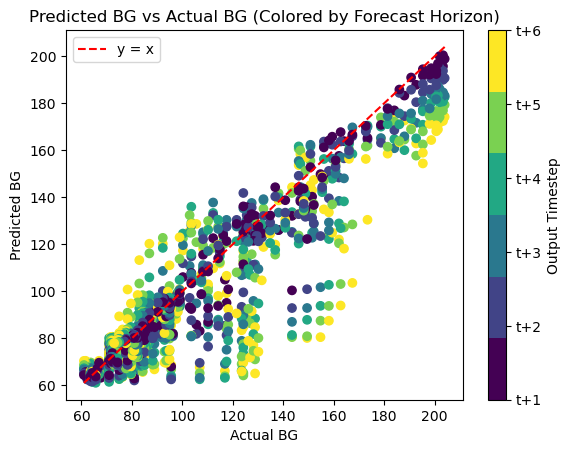


Running model for: id_38_data
Execution time: 17.16921091079712 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.890998125076294 seconds
Execution time: 0.0012509822845458984 seconds
Execution time: 0.0002582073211669922 seconds


Overall Train RMSE: 11.220942154420262 mg/DL
Overall Test RMSE: 9.517250844965407 mg/DL


Train RMSE at t+1: 5.10 mg/DL
Train RMSE at t+2: 7.91 mg/DL
Train RMSE at t+3: 10.34 mg/DL
Train RMSE at t+4: 12.23 mg/DL
Train RMSE at t+5: 13.76 mg/DL
Train RMSE at t+6: 14.88 mg/DL


Test RMSE at t+1: 4.26 mg/DL
Test RMSE at t+2: 6.47 mg/DL
Test RMSE at t+3: 8.47 mg/DL
Test RMSE at t+4: 10.17 mg/DL
Test RMSE at t+5: 11.75 mg/DL
Test RMSE at t+6: 13.05 mg/DL


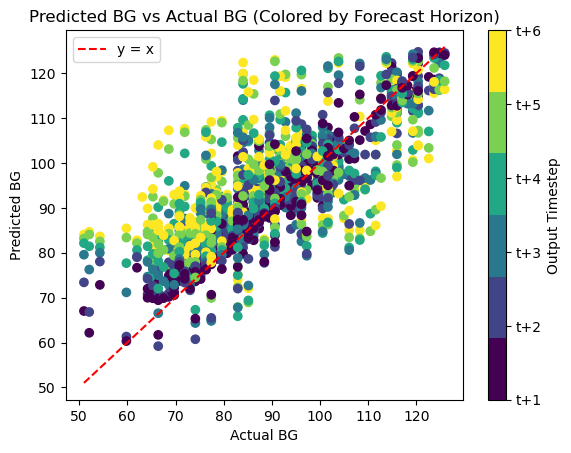


Running model for: id_39_data
Execution time: 16.00519609451294 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.7779457569122314 seconds
Execution time: 0.0009021759033203125 seconds
Execution time: 0.0002009868621826172 seconds


Overall Train RMSE: 11.66035287025497 mg/DL
Overall Test RMSE: 14.269764198522132 mg/DL


Train RMSE at t+1: 4.92 mg/DL
Train RMSE at t+2: 7.49 mg/DL
Train RMSE at t+3: 10.03 mg/DL
Train RMSE at t+4: 12.28 mg/DL
Train RMSE at t+5: 14.44 mg/DL
Train RMSE at t+6: 16.60 mg/DL


Test RMSE at t+1: 5.67 mg/DL
Test RMSE at t+2: 8.86 mg/DL
Test RMSE at t+3: 12.06 mg/DL
Test RMSE at t+4: 15.01 mg/DL
Test RMSE at t+5: 17.80 mg/DL
Test RMSE at t+6: 20.58 mg/DL


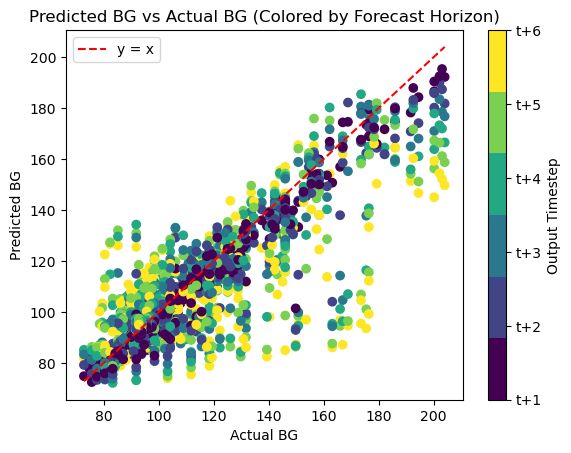


Running model for: id_40_data
Execution time: 15.189710140228271 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
Execution time: 0.758098840713501 seconds
Execution time: 0.0007102489471435547 seconds
Execution time: 0.0001678466796875 seconds


Overall Train RMSE: 9.932603593749263 mg/DL
Overall Test RMSE: 11.65355250073914 mg/DL


Train RMSE at t+1: 4.33 mg/DL
Train RMSE at t+2: 6.31 mg/DL
Train RMSE at t+3: 8.34 mg/DL
Train RMSE at t+4: 10.41 mg/DL
Train RMSE at t+5: 12.41 mg/DL
Train RMSE at t+6: 14.20 mg/DL


Test RMSE at t+1: 4.49 mg/DL
Test RMSE at t+2: 6.76 mg/DL
Test RMSE at t+3: 9.36 mg/DL
Test RMSE at t+4: 12.11 mg/DL
Test RMSE at t+5: 14.84 mg/DL
Test RMSE at t+6: 17.16 mg/DL


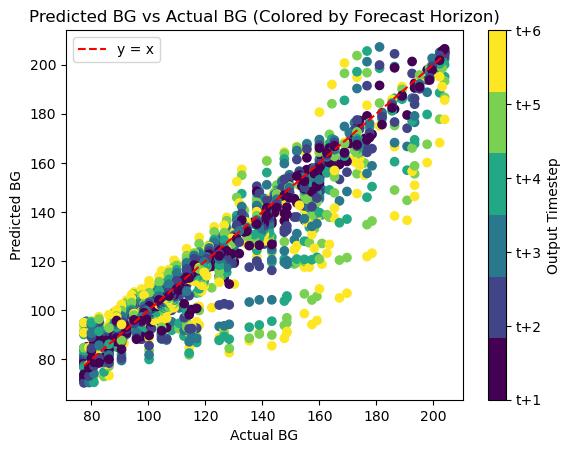


Running model for: id_41_data
Execution time: 13.035712003707886 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.7296459674835205 seconds
Execution time: 0.0009326934814453125 seconds
Execution time: 0.00017213821411132812 seconds


Overall Train RMSE: 11.412098805226027 mg/DL
Overall Test RMSE: 13.85094908121622 mg/DL


Train RMSE at t+1: 5.76 mg/DL
Train RMSE at t+2: 7.95 mg/DL
Train RMSE at t+3: 10.22 mg/DL
Train RMSE at t+4: 12.21 mg/DL
Train RMSE at t+5: 13.89 mg/DL
Train RMSE at t+6: 15.45 mg/DL


Test RMSE at t+1: 6.81 mg/DL
Test RMSE at t+2: 9.40 mg/DL
Test RMSE at t+3: 12.27 mg/DL
Test RMSE at t+4: 14.79 mg/DL
Test RMSE at t+5: 16.92 mg/DL
Test RMSE at t+6: 18.99 mg/DL


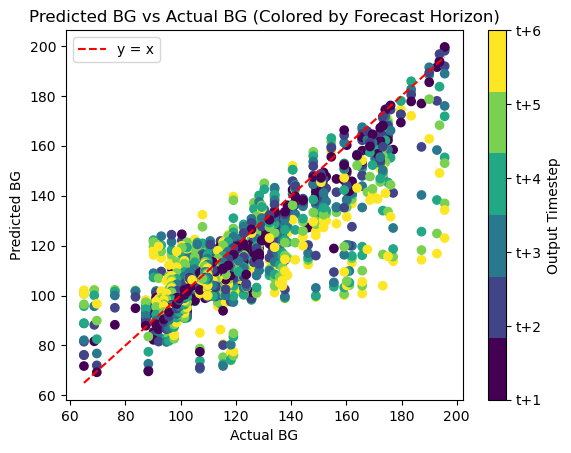


Running model for: id_42_data
Execution time: 15.040705680847168 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.7194602489471436 seconds
Execution time: 0.00080108642578125 seconds
Execution time: 0.00020313262939453125 seconds


Overall Train RMSE: 12.59012112647568 mg/DL
Overall Test RMSE: 13.610335340770874 mg/DL


Train RMSE at t+1: 6.55 mg/DL
Train RMSE at t+2: 9.15 mg/DL
Train RMSE at t+3: 11.67 mg/DL
Train RMSE at t+4: 13.82 mg/DL
Train RMSE at t+5: 15.22 mg/DL
Train RMSE at t+6: 16.29 mg/DL


Test RMSE at t+1: 7.26 mg/DL
Test RMSE at t+2: 9.80 mg/DL
Test RMSE at t+3: 12.55 mg/DL
Test RMSE at t+4: 14.94 mg/DL
Test RMSE at t+5: 16.48 mg/DL
Test RMSE at t+6: 17.63 mg/DL


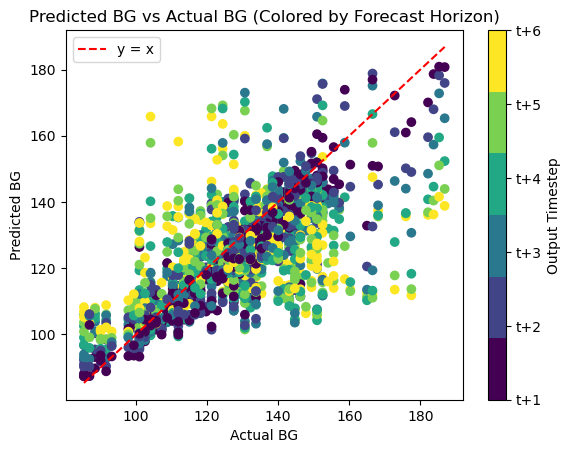


Running model for: id_43_data
Execution time: 15.826463222503662 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.8225827217102051 seconds
Execution time: 0.0009191036224365234 seconds
Execution time: 0.00016570091247558594 seconds


Overall Train RMSE: 10.690118666489212 mg/DL
Overall Test RMSE: 9.90518541993114 mg/DL


Train RMSE at t+1: 5.21 mg/DL
Train RMSE at t+2: 7.49 mg/DL
Train RMSE at t+3: 9.57 mg/DL
Train RMSE at t+4: 11.37 mg/DL
Train RMSE at t+5: 13.10 mg/DL
Train RMSE at t+6: 14.49 mg/DL


Test RMSE at t+1: 4.45 mg/DL
Test RMSE at t+2: 6.78 mg/DL
Test RMSE at t+3: 8.84 mg/DL
Test RMSE at t+4: 10.59 mg/DL
Test RMSE at t+5: 12.48 mg/DL
Test RMSE at t+6: 13.30 mg/DL


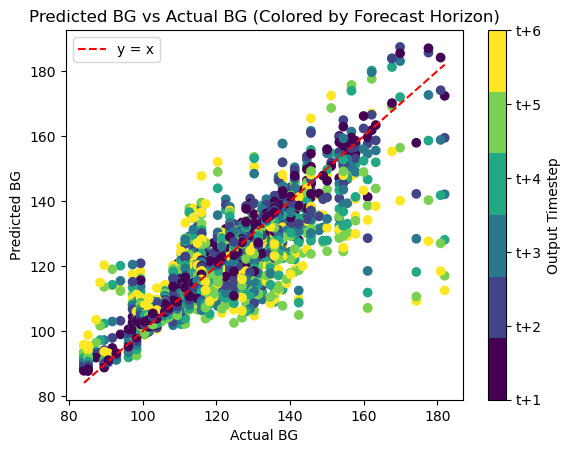


Running model for: id_44_data
Execution time: 14.686668872833252 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6995482444763184 seconds
Execution time: 0.0007998943328857422 seconds
Execution time: 0.00021910667419433594 seconds


Overall Train RMSE: 11.392841643941674 mg/DL
Overall Test RMSE: 7.942332474576556 mg/DL


Train RMSE at t+1: 6.11 mg/DL
Train RMSE at t+2: 8.95 mg/DL
Train RMSE at t+3: 10.73 mg/DL
Train RMSE at t+4: 12.24 mg/DL
Train RMSE at t+5: 13.87 mg/DL
Train RMSE at t+6: 14.29 mg/DL


Test RMSE at t+1: 4.33 mg/DL
Test RMSE at t+2: 6.36 mg/DL
Test RMSE at t+3: 7.52 mg/DL
Test RMSE at t+4: 8.55 mg/DL
Test RMSE at t+5: 9.63 mg/DL
Test RMSE at t+6: 9.84 mg/DL


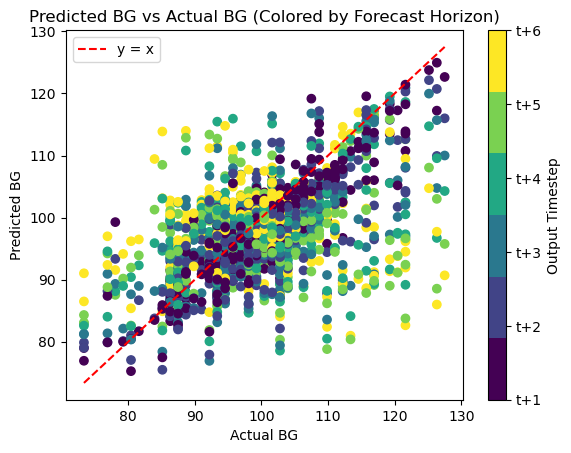


Running model for: id_45_data
Execution time: 13.585029125213623 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.66668701171875 seconds
Execution time: 0.0007319450378417969 seconds
Execution time: 9.918212890625e-05 seconds


Overall Train RMSE: 11.961144996672116 mg/DL
Overall Test RMSE: 10.852816548599423 mg/DL


Train RMSE at t+1: 6.00 mg/DL
Train RMSE at t+2: 8.75 mg/DL
Train RMSE at t+3: 11.00 mg/DL
Train RMSE at t+4: 12.88 mg/DL
Train RMSE at t+5: 14.47 mg/DL
Train RMSE at t+6: 15.81 mg/DL


Test RMSE at t+1: 6.49 mg/DL
Test RMSE at t+2: 8.84 mg/DL
Test RMSE at t+3: 10.53 mg/DL
Test RMSE at t+4: 11.82 mg/DL
Test RMSE at t+5: 12.66 mg/DL
Test RMSE at t+6: 13.25 mg/DL


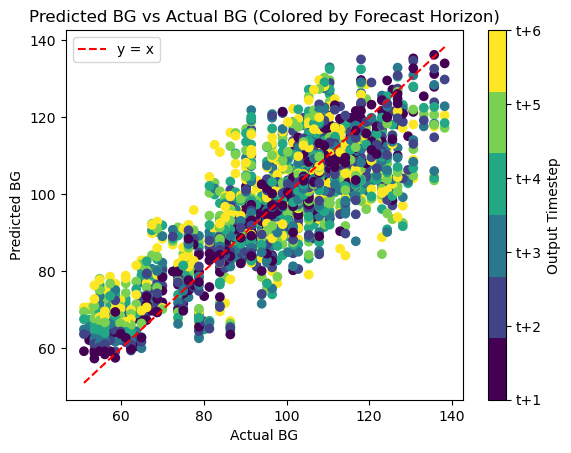


Running model for: id_46_data
Execution time: 14.472308874130249 seconds
49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.7735919952392578 seconds
Execution time: 0.0007319450378417969 seconds
Execution time: 0.00019216537475585938 seconds


Overall Train RMSE: 11.555828472981219 mg/DL
Overall Test RMSE: 12.018928115025231 mg/DL


Train RMSE at t+1: 6.52 mg/DL
Train RMSE at t+2: 8.59 mg/DL
Train RMSE at t+3: 10.51 mg/DL
Train RMSE at t+4: 12.31 mg/DL
Train RMSE at t+5: 13.92 mg/DL
Train RMSE at t+6: 15.14 mg/DL


Test RMSE at t+1: 6.55 mg/DL
Test RMSE at t+2: 8.51 mg/DL
Test RMSE at t+3: 10.44 mg/DL
Test RMSE at t+4: 12.42 mg/DL
Test RMSE at t+5: 14.43 mg/DL
Test RMSE at t+6: 16.73 mg/DL


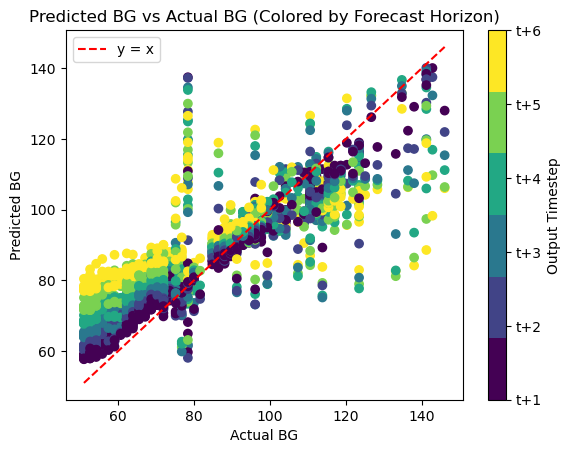


Running model for: id_47_data
Execution time: 14.905638694763184 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.7377059459686279 seconds
Execution time: 0.0007507801055908203 seconds
Execution time: 0.0001938343048095703 seconds


Overall Train RMSE: 14.31178233373274 mg/DL
Overall Test RMSE: 10.776795591596072 mg/DL


Train RMSE at t+1: 9.08 mg/DL
Train RMSE at t+2: 10.95 mg/DL
Train RMSE at t+3: 13.35 mg/DL
Train RMSE at t+4: 15.35 mg/DL
Train RMSE at t+5: 16.94 mg/DL
Train RMSE at t+6: 18.05 mg/DL


Test RMSE at t+1: 8.53 mg/DL
Test RMSE at t+2: 9.08 mg/DL
Test RMSE at t+3: 10.26 mg/DL
Test RMSE at t+4: 11.26 mg/DL
Test RMSE at t+5: 12.01 mg/DL
Test RMSE at t+6: 12.86 mg/DL


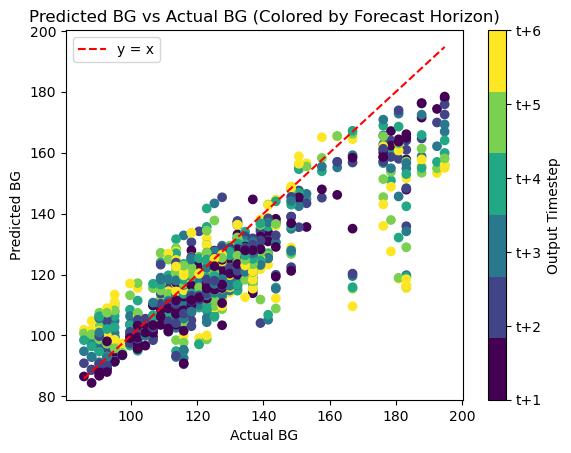


Running model for: id_48_data
Execution time: 14.260228157043457 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.7078568935394287 seconds
Execution time: 0.0006799697875976562 seconds
Execution time: 0.00010204315185546875 seconds


Overall Train RMSE: 12.88872552058559 mg/DL
Overall Test RMSE: 9.058292322908914 mg/DL


Train RMSE at t+1: 6.55 mg/DL
Train RMSE at t+2: 9.55 mg/DL
Train RMSE at t+3: 11.97 mg/DL
Train RMSE at t+4: 14.17 mg/DL
Train RMSE at t+5: 15.66 mg/DL
Train RMSE at t+6: 16.54 mg/DL


Test RMSE at t+1: 4.69 mg/DL
Test RMSE at t+2: 6.37 mg/DL
Test RMSE at t+3: 8.05 mg/DL
Test RMSE at t+4: 9.78 mg/DL
Test RMSE at t+5: 11.17 mg/DL
Test RMSE at t+6: 12.03 mg/DL


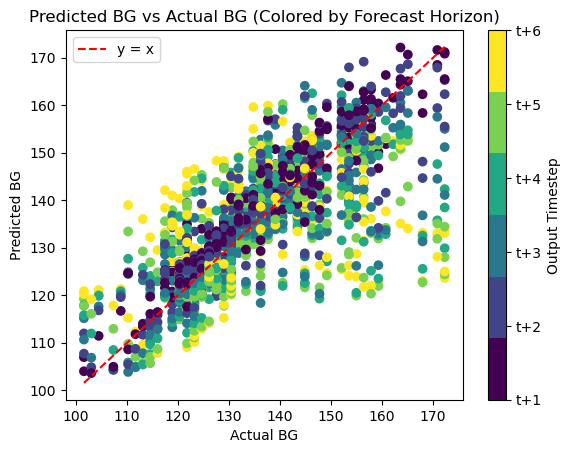


Running model for: id_49_data
Execution time: 14.052041053771973 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6558859348297119 seconds
Execution time: 0.0006079673767089844 seconds
Execution time: 0.0001780986785888672 seconds


Overall Train RMSE: 14.416516025484588 mg/DL
Overall Test RMSE: 15.978014152612568 mg/DL


Train RMSE at t+1: 6.39 mg/DL
Train RMSE at t+2: 10.16 mg/DL
Train RMSE at t+3: 12.39 mg/DL
Train RMSE at t+4: 15.60 mg/DL
Train RMSE at t+5: 17.83 mg/DL
Train RMSE at t+6: 19.70 mg/DL


Test RMSE at t+1: 7.16 mg/DL
Test RMSE at t+2: 11.15 mg/DL
Test RMSE at t+3: 13.61 mg/DL
Test RMSE at t+4: 17.07 mg/DL
Test RMSE at t+5: 19.75 mg/DL
Test RMSE at t+6: 22.12 mg/DL


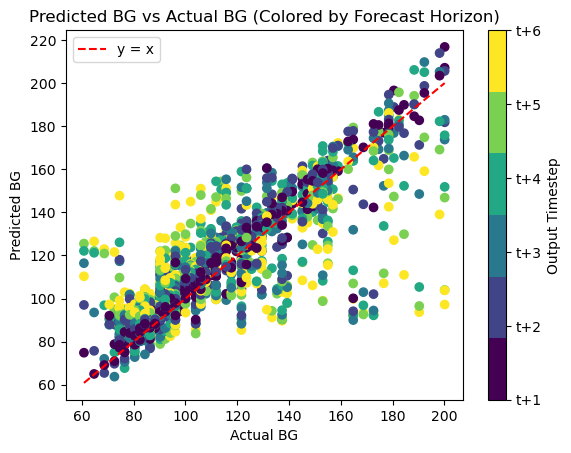


Running model for: id_50_data
Execution time: 11.927549839019775 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Execution time: 0.5979130268096924 seconds
Execution time: 0.0006320476531982422 seconds
Execution time: 0.00017213821411132812 seconds


Overall Train RMSE: 13.93002768278286 mg/DL
Overall Test RMSE: 13.36884705480152 mg/DL


Train RMSE at t+1: 6.32 mg/DL
Train RMSE at t+2: 10.54 mg/DL
Train RMSE at t+3: 12.59 mg/DL
Train RMSE at t+4: 15.01 mg/DL
Train RMSE at t+5: 17.13 mg/DL
Train RMSE at t+6: 18.33 mg/DL


Test RMSE at t+1: 5.61 mg/DL
Test RMSE at t+2: 9.79 mg/DL
Test RMSE at t+3: 12.27 mg/DL
Test RMSE at t+4: 14.72 mg/DL
Test RMSE at t+5: 16.57 mg/DL
Test RMSE at t+6: 17.42 mg/DL


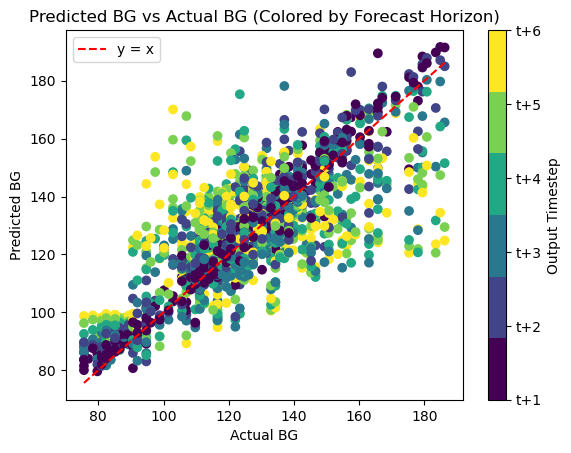


Running model for: id_51_data
Execution time: 11.525397062301636 seconds
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Execution time: 0.5894289016723633 seconds
Execution time: 0.0006549358367919922 seconds
Execution time: 0.00015401840209960938 seconds


Overall Train RMSE: 11.7082962807577 mg/DL
Overall Test RMSE: 10.578116486471837 mg/DL


Train RMSE at t+1: 8.44 mg/DL
Train RMSE at t+2: 9.47 mg/DL
Train RMSE at t+3: 10.95 mg/DL
Train RMSE at t+4: 12.11 mg/DL
Train RMSE at t+5: 13.49 mg/DL
Train RMSE at t+6: 14.60 mg/DL


Test RMSE at t+1: 7.74 mg/DL
Test RMSE at t+2: 8.56 mg/DL
Test RMSE at t+3: 9.87 mg/DL
Test RMSE at t+4: 11.06 mg/DL
Test RMSE at t+5: 12.16 mg/DL
Test RMSE at t+6: 13.07 mg/DL


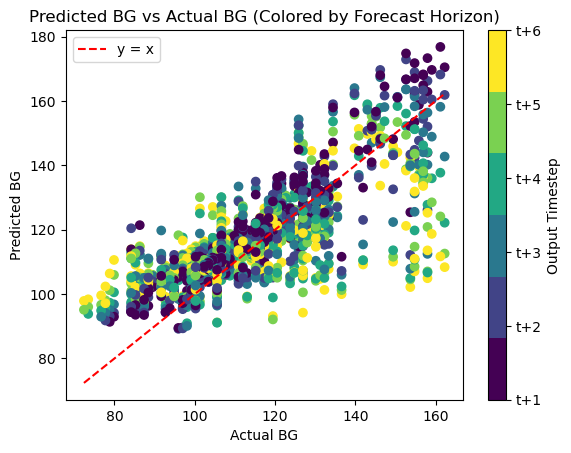


Running model for: id_52_data
Execution time: 11.537739038467407 seconds
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Execution time: 0.5828959941864014 seconds
Execution time: 0.00067138671875 seconds
Execution time: 0.00018787384033203125 seconds


Overall Train RMSE: 10.825659205793006 mg/DL
Overall Test RMSE: 12.561309936683251 mg/DL


Train RMSE at t+1: 4.81 mg/DL
Train RMSE at t+2: 7.19 mg/DL
Train RMSE at t+3: 9.47 mg/DL
Train RMSE at t+4: 11.53 mg/DL
Train RMSE at t+5: 13.35 mg/DL
Train RMSE at t+6: 15.08 mg/DL


Test RMSE at t+1: 4.49 mg/DL
Test RMSE at t+2: 7.14 mg/DL
Test RMSE at t+3: 9.91 mg/DL
Test RMSE at t+4: 12.65 mg/DL
Test RMSE at t+5: 15.84 mg/DL
Test RMSE at t+6: 19.15 mg/DL


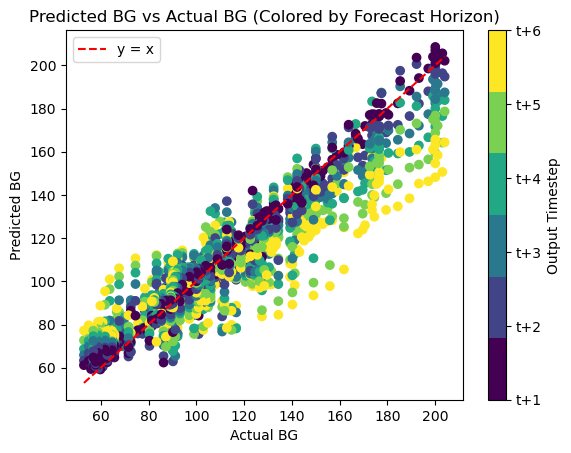


Running model for: id_53_data
Execution time: 11.623011112213135 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Execution time: 0.6016478538513184 seconds
Execution time: 0.0006110668182373047 seconds
Execution time: 8.487701416015625e-05 seconds


Overall Train RMSE: 15.346497347822183 mg/DL
Overall Test RMSE: 13.576325259457766 mg/DL


Train RMSE at t+1: 7.03 mg/DL
Train RMSE at t+2: 10.44 mg/DL
Train RMSE at t+3: 13.71 mg/DL
Train RMSE at t+4: 16.71 mg/DL
Train RMSE at t+5: 19.10 mg/DL
Train RMSE at t+6: 20.56 mg/DL


Test RMSE at t+1: 7.25 mg/DL
Test RMSE at t+2: 10.30 mg/DL
Test RMSE at t+3: 12.55 mg/DL
Test RMSE at t+4: 15.01 mg/DL
Test RMSE at t+5: 16.16 mg/DL
Test RMSE at t+6: 17.41 mg/DL


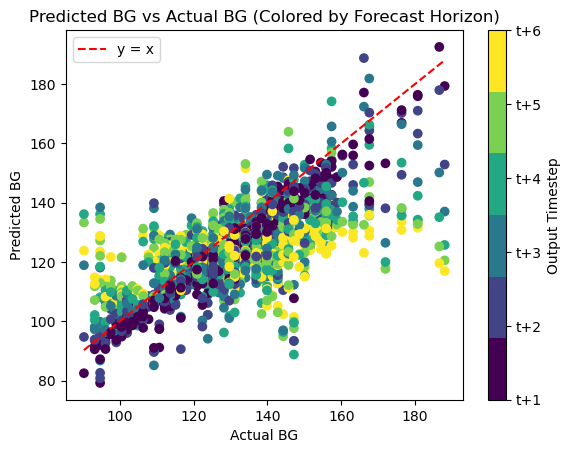


Running model for: id_54_data
Execution time: 10.30054521560669 seconds
51/51 ━━━━━━━━━━━━━━━━━━━━ 14s 274ms/step
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 14.047811031341553 seconds
Execution time: 0.0008981227874755859 seconds
Execution time: 0.00022125244140625 seconds


Overall Train RMSE: 13.79392002506936 mg/DL
Overall Test RMSE: 12.72781251753477 mg/DL


Train RMSE at t+1: 6.57 mg/DL
Train RMSE at t+2: 9.97 mg/DL
Train RMSE at t+3: 12.73 mg/DL
Train RMSE at t+4: 14.89 mg/DL
Train RMSE at t+5: 16.83 mg/DL
Train RMSE at t+6: 18.22 mg/DL


Test RMSE at t+1: 6.65 mg/DL
Test RMSE at t+2: 9.46 mg/DL
Test RMSE at t+3: 11.69 mg/DL
Test RMSE at t+4: 13.43 mg/DL
Test RMSE at t+5: 15.40 mg/DL
Test RMSE at t+6: 16.86 mg/DL


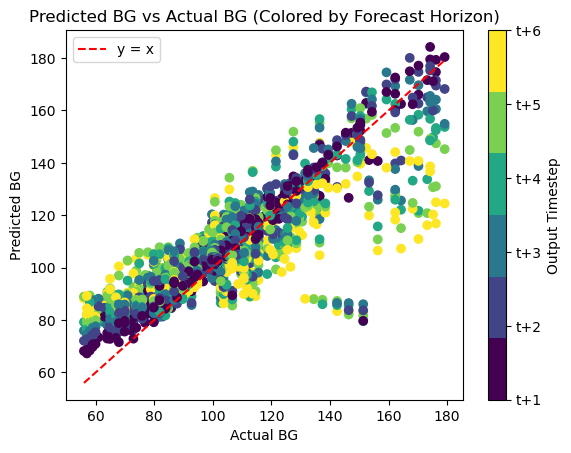


Running model for: id_55_data
Execution time: 10.193797826766968 seconds
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
Execution time: 0.6145310401916504 seconds
Execution time: 0.0005931854248046875 seconds
Execution time: 0.00012612342834472656 seconds


Overall Train RMSE: 11.597057806568763 mg/DL
Overall Test RMSE: 11.190106104388219 mg/DL


Train RMSE at t+1: 5.98 mg/DL
Train RMSE at t+2: 8.21 mg/DL
Train RMSE at t+3: 10.72 mg/DL
Train RMSE at t+4: 12.47 mg/DL
Train RMSE at t+5: 14.04 mg/DL
Train RMSE at t+6: 15.37 mg/DL


Test RMSE at t+1: 5.38 mg/DL
Test RMSE at t+2: 7.76 mg/DL
Test RMSE at t+3: 10.41 mg/DL
Test RMSE at t+4: 12.14 mg/DL
Test RMSE at t+5: 13.66 mg/DL
Test RMSE at t+6: 14.84 mg/DL


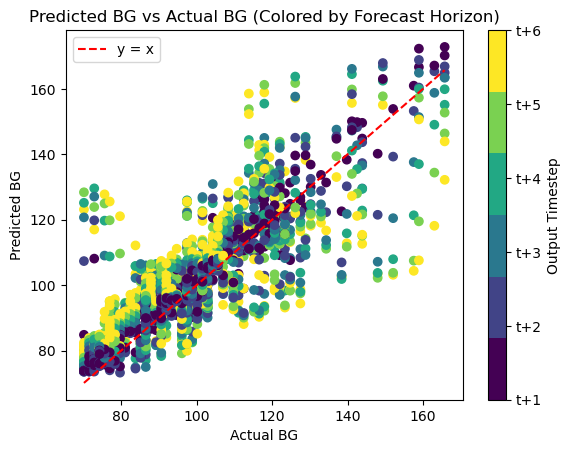


Running model for: id_56_data
Execution time: 11.281704187393188 seconds
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
Execution time: 0.576103925704956 seconds
Execution time: 0.0011739730834960938 seconds
Execution time: 0.00018310546875 seconds


Overall Train RMSE: 11.120810447989518 mg/DL
Overall Test RMSE: 13.058438649353736 mg/DL


Train RMSE at t+1: 5.42 mg/DL
Train RMSE at t+2: 8.07 mg/DL
Train RMSE at t+3: 10.26 mg/DL
Train RMSE at t+4: 12.16 mg/DL
Train RMSE at t+5: 13.58 mg/DL
Train RMSE at t+6: 14.50 mg/DL


Test RMSE at t+1: 5.91 mg/DL
Test RMSE at t+2: 9.04 mg/DL
Test RMSE at t+3: 11.83 mg/DL
Test RMSE at t+4: 14.43 mg/DL
Test RMSE at t+5: 16.00 mg/DL
Test RMSE at t+6: 17.39 mg/DL


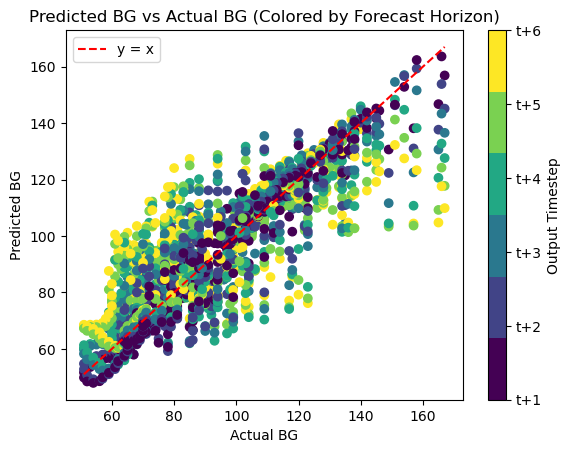

In [162]:
all_preds5 = []
all_truths5 = []
seq_length_in = 6
seq_length_out = 6
results5 = {}

for key, subset in normalized_data.items():
    print(f"\nRunning model for: {key}")
    
    try:
        preds, truths = RNN_indv(subset, seq_length_in, seq_length_out)
        all_preds5.append(preds)
        all_truths5.append(truths)
        results5[key] = (preds, truths)
    except Exception as e:
        print(f"Error for {key}: {e}")
        results5[key] = None


In [178]:
# Concatenate all predictions and truths
all_preds_concat1 = np.concatenate(all_preds5, axis=0).flatten()
all_truths_concat1 = np.concatenate(all_truths5, axis=0).flatten()

# Compute overall RMSE and MAE
combined_rmse5 = np.sqrt(mean_squared_error(all_truths_concat5, all_preds_concat1))
combined_mae5 = mean_absolute_error(all_truths_concat5, all_preds_concat1)

print(f"\nCombined RMSE across all IDs: {combined_rmse5:.2f} mg/dL")
print(f"Combined MAE  across all IDs: {combined_mae5:.2f} mg/dL\n")

# Lists to store RMSE and MAE per individual
rmse_per_individual = []
mae_per_individual = []

# Compute per-ID RMSE and MAE
for pred_array, true_array in zip(all_preds5, all_truths5):
    pred_flat = pred_array.flatten()
    true_flat = true_array.flatten()
    
    rmse = np.sqrt(mean_squared_error(true_flat, pred_flat))
    mae = mean_absolute_error(true_flat, pred_flat)
    
    rmse_per_individual.append(rmse)
    mae_per_individual.append(mae)

# Print all 56 RMSEs and MAEs
for i, (rmse, mae) in enumerate(zip(rmse_per_individual, mae_per_individual)):
    print(f"ID {i:2d}: RMSE = {rmse:.2f} mg/dL | MAE = {mae:.2f} mg/dL")

# Summary: min/max RMSE and MAE
print('\n')
print(f'The min RMSE is for ID {np.argmin(rmse_per_individual)} with a value of: {min(rmse_per_individual):.2f}')
print(f'The max RMSE is for ID {np.argmax(rmse_per_individual)} with a value of: {max(rmse_per_individual):.2f}')
print(f'The min MAE  is for ID {np.argmin(mae_per_individual)} with a value of: {min(mae_per_individual):.2f}')
print(f'The max MAE  is for ID {np.argmax(mae_per_individual)} with a value of: {max(mae_per_individual):.2f}')



Combined RMSE across all IDs: 12.87 mg/dL
Combined MAE  across all IDs: 8.53 mg/dL

ID  0: RMSE = 9.00 mg/dL | MAE = 7.11 mg/dL
ID  1: RMSE = 18.55 mg/dL | MAE = 12.26 mg/dL
ID  2: RMSE = 23.15 mg/dL | MAE = 17.47 mg/dL
ID  3: RMSE = 9.42 mg/dL | MAE = 7.14 mg/dL
ID  4: RMSE = 10.38 mg/dL | MAE = 7.15 mg/dL
ID  5: RMSE = 12.29 mg/dL | MAE = 9.10 mg/dL
ID  6: RMSE = 10.70 mg/dL | MAE = 6.33 mg/dL
ID  7: RMSE = 10.29 mg/dL | MAE = 7.09 mg/dL
ID  8: RMSE = 11.45 mg/dL | MAE = 8.78 mg/dL
ID  9: RMSE = 15.68 mg/dL | MAE = 10.99 mg/dL
ID 10: RMSE = 11.64 mg/dL | MAE = 8.69 mg/dL
ID 11: RMSE = 16.21 mg/dL | MAE = 10.59 mg/dL
ID 12: RMSE = 12.88 mg/dL | MAE = 9.93 mg/dL
ID 13: RMSE = 14.46 mg/dL | MAE = 10.78 mg/dL
ID 14: RMSE = 12.67 mg/dL | MAE = 9.31 mg/dL
ID 15: RMSE = 13.70 mg/dL | MAE = 10.21 mg/dL
ID 16: RMSE = 12.17 mg/dL | MAE = 7.80 mg/dL
ID 17: RMSE = 15.46 mg/dL | MAE = 11.02 mg/dL
ID 18: RMSE = 15.32 mg/dL | MAE = 10.00 mg/dL
ID 19: RMSE = 12.21 mg/dL | MAE = 8.87 mg/dL
ID 20: RM

In [172]:
# Flatten individual model predictions and truths
preds1 = np.concatenate(all_preds1, axis=0)
preds2 = np.concatenate(all_preds2, axis=0)
preds3 = np.concatenate(all_preds3, axis=0)
preds4 = np.concatenate(all_preds4, axis=0)
preds5 = np.concatenate(all_preds5, axis=0)

truths1 = np.concatenate(all_truths1, axis=0)
truths2 = np.concatenate(all_truths2, axis=0)
truths3 = np.concatenate(all_truths3, axis=0)
truths4 = np.concatenate(all_truths4, axis=0)
truths5 = np.concatenate(all_truths5, axis=0)

# Now combine across all models
all_preds_total = np.concatenate([preds1, preds2, preds3, preds4, preds5], axis=0).flatten()
all_truths_total = np.concatenate([truths1, truths2, truths3, truths4, truths5], axis=0).flatten()

# Compute RMSE
combined_mod_rmse = np.sqrt(mean_squared_error(all_truths_total, all_preds_total))
print(f"\nCombined RMSE across all IDs and models: {combined_mod_rmse:.2f} mg/dL")


Combined RMSE across all IDs and models: 12.70 mg/dL


Exploring the individuals that are significant IDs (for RMSE): 26 (min for all), 2 (min max for training of 70), 1 (max for training of 60 and 12), and 20 (max for training of 24).

For MAE: ID 35 (min for 1), 13 (max for 1) and 18 (max for 1)

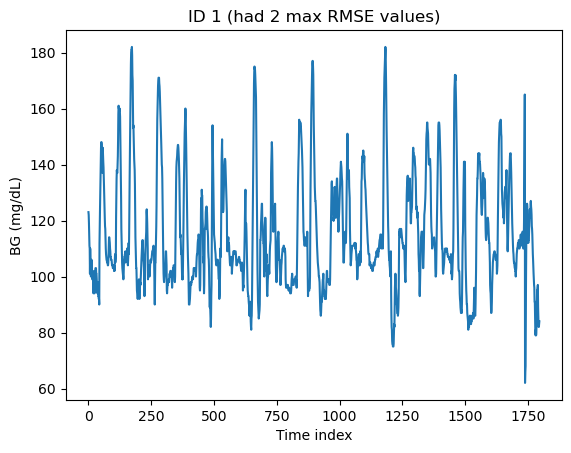

In [161]:
plt.plot(list(range(len(grouped_data['id_1_data']))), list(grouped_data['id_1_data']['gl']))
plt.title('ID 1 (had 2 max RMSE values)')
plt.xlabel('Time index')
plt.ylabel('BG (mg/dL)');

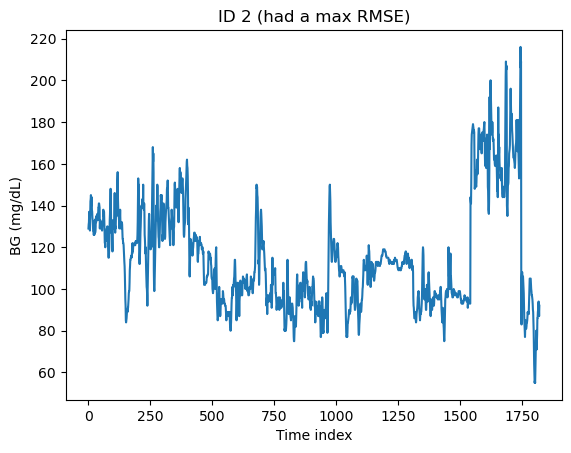

In [160]:
plt.plot(list(range(len(grouped_data['id_2_data']))), list(grouped_data['id_2_data']['gl']))
plt.title('ID 2 (had a max RMSE)')
plt.xlabel('Time index')
plt.ylabel('BG (mg/dL)');

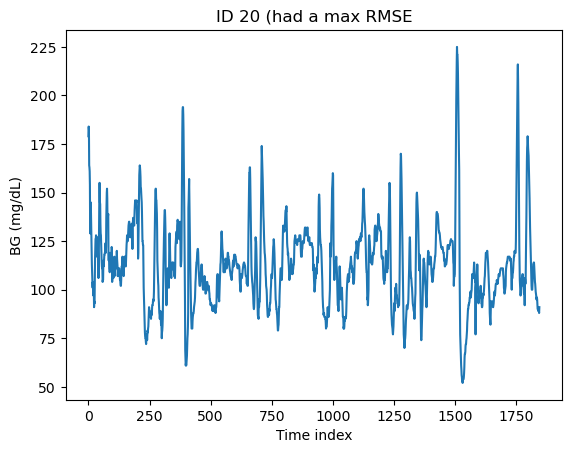

In [159]:
plt.plot(list(range(len(grouped_data['id_20_data']))), list(grouped_data['id_20_data']['gl']))
plt.title('ID 20 (had a max RMSE')
plt.xlabel('Time index')
plt.ylabel('BG (mg/dL)');

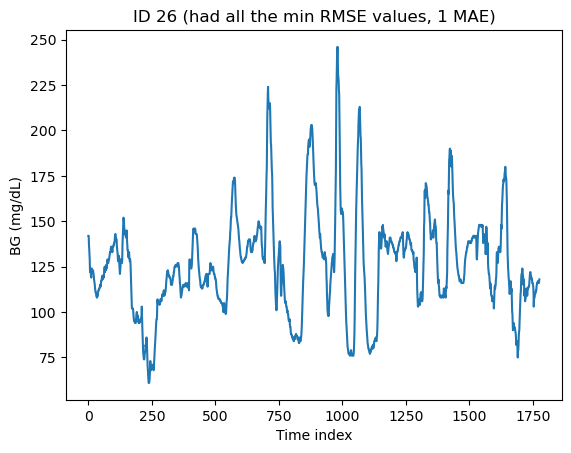

In [173]:
plt.plot(list(range(len(grouped_data['id_26_data']))), list(grouped_data['id_26_data']['gl']))
plt.title('ID 26 (had all the min RMSE values, 1 MAE)')
plt.xlabel('Time index')
plt.ylabel('BG (mg/dL)');

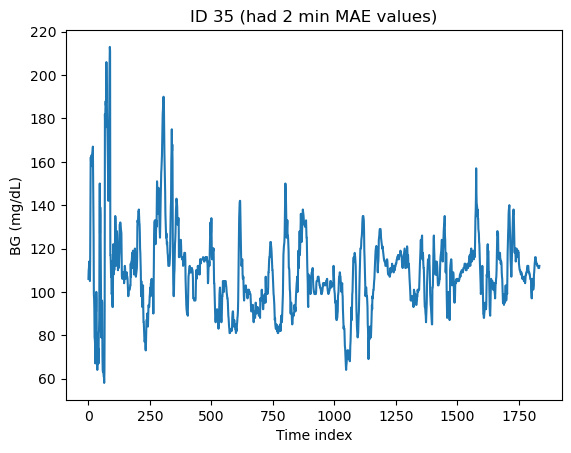

In [174]:
plt.plot(list(range(len(grouped_data['id_35_data']))), list(grouped_data['id_35_data']['gl']))
plt.title('ID 35 (had 2 min MAE values)')
plt.xlabel('Time index')
plt.ylabel('BG (mg/dL)');

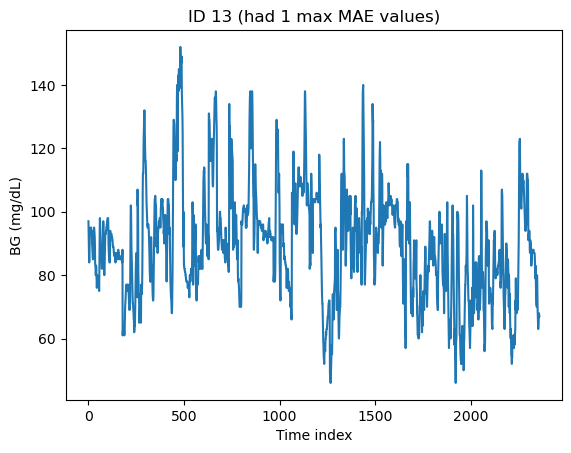

In [175]:
plt.plot(list(range(len(grouped_data['id_13_data']))), list(grouped_data['id_13_data']['gl']))
plt.title('ID 13 (had 1 max MAE values)')
plt.xlabel('Time index')
plt.ylabel('BG (mg/dL)');

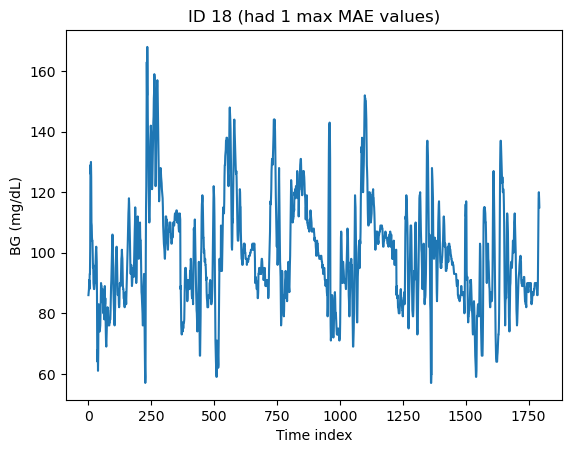

In [176]:
plt.plot(list(range(len(grouped_data['id_18_data']))), list(grouped_data['id_18_data']['gl']))
plt.title('ID 18 (had 1 max MAE values)')
plt.xlabel('Time index')
plt.ylabel('BG (mg/dL)');